# Machine Learning for Additive Manufacturing

Load in relevant modules


python package dependencies: ```mendeleev, matplotlib, pandas, numpy, pylab, pprint, sklearn, scipy, os```



In [1]:
from sklearn.preprocessing import OneHotEncoder

In [2]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
from mpl_toolkits import mplot3d
import os
from pprint import pprint
from scipy.interpolate import griddata
from pylab import * # For adjusting frame width only
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

os.getcwd()

'/media/cmu/DATA1/francis/Previous Projects/AdditiveNet/CNN_AM_Project/AdditiveNet'

In [3]:
import sklearn.gaussian_process as gp 
import sklearn.model_selection as ms
from sklearn.svm import SVR, SVC
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier
from sklearn.ensemble import GradientBoostingRegressor, GradientBoostingClassifier
from sklearn.model_selection import cross_validate
from sklearn.linear_model import Lasso, LogisticRegression
from sklearn.utils import shuffle
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import Ridge 
from sklearn.model_selection import KFold
from sklearn.preprocessing import scale
from sklearn.neural_network import MLPRegressor, MLPClassifier
from sklearn import svm
from sklearn import metrics
%matplotlib inline

In [4]:
from plotting_utils import frame_tick, legend, savefig
dpi = 300

## Change style of figures

In [4]:
'''
Make frame thicker, make tick pointing inside, make tick thicker
default frame width is 2, default tick width is 1.5
'''
def frame_tick(frame_width = 2, tick_width = 1.5):
    ax = gca()
    for axis in ['top','bottom','left','right']:
        ax.spines[axis].set_linewidth(frame_width)
    plt.tick_params(direction = 'in', 
                    width = tick_width)

'''
legend:
default location : upper left
default fontsize: 8
Frame is always off
'''
def legend(location = 'upper left', fontsize = 8):
    plt.legend(loc = location, fontsize = fontsize, frameon = False)
    
'''
savefig:
bbox_inches is always tight
'''
def savefig(filename):
    plt.savefig(filename, bbox_inches = 'tight')
    


# Load in data, perform basic analysis

In [5]:
# Load in the csv data, download from Google Sheets and store in directory
print("Current directory: ", os.getcwd())
csv = pd.read_csv('meltpoolgeometry.csv') 
csv1 = pd.read_csv('meltpoolgeometry.csv')
csv2 = pd.read_csv('meltpoolclassification.csv')
regressioncsv =  csv1
class_csv = csv1.append(csv2)

Current directory:  /home/cmu/CNN_AM_Project


In [1]:
csv2[['Power', 'Velocity']]

NameError: name 'csv2' is not defined

In [7]:

all_depths = csv['depth of meltpool']
all_velocity = csv['Velocity']
all_power = csv['Power']
print(len(csv))
csv = csv[all_velocity < 3000][all_power < 3000]
print(len(csv))

1806
1766


/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """


Text(0.5, 1.0, 'Entire dataset')

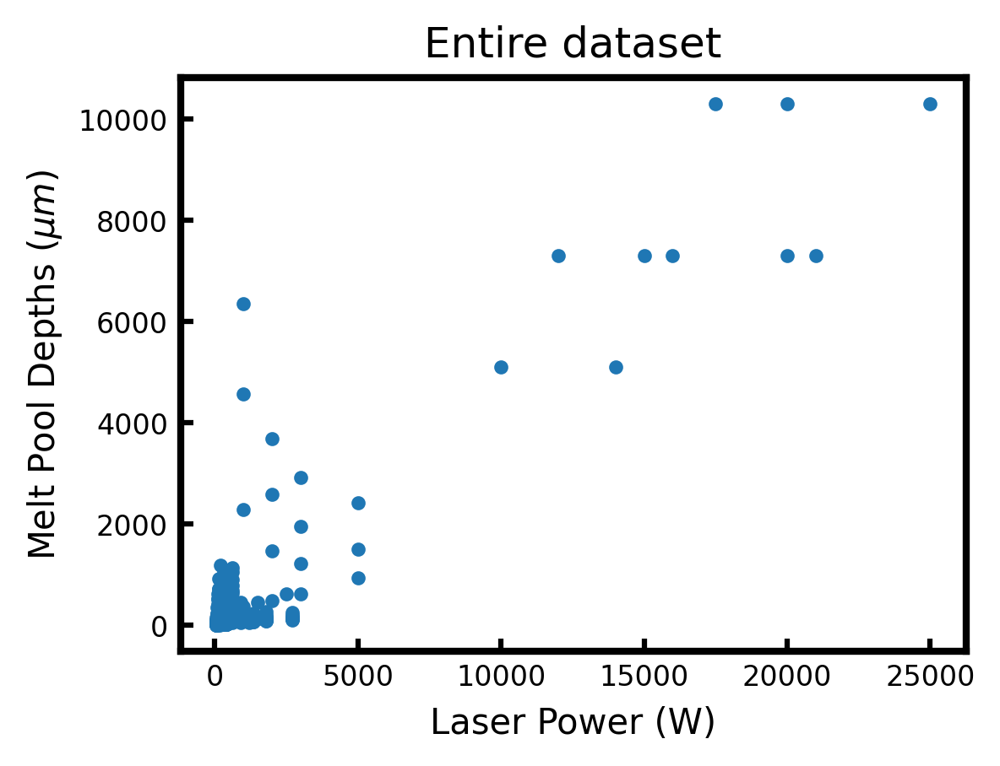

In [8]:

dpi = 300
fig = plt.figure(figsize = [4,3], dpi = dpi)
plt.plot(all_power, all_depths, '.')

plt.xticks(fontsize = 8)
plt.yticks(fontsize = 8)
frame_tick()
plt.xlabel(r'Laser Power (W)')
plt.ylabel(r'Melt Pool Depths ($\mu m$)')
plt.title('Entire dataset')

Text(0.5, 1.0, 'Entire dataset')

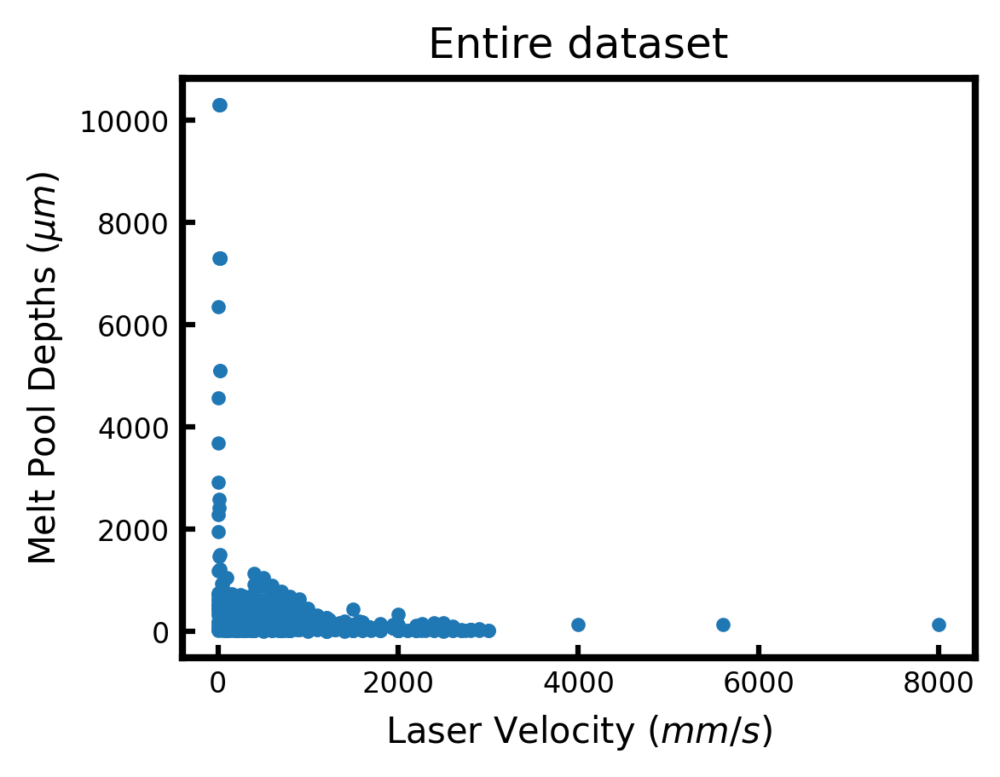

In [9]:
fig = plt.figure(figsize = [4,3], dpi = dpi)
plt.plot(all_velocity, all_depths, '.')

plt.xticks(fontsize = 8)
plt.yticks(fontsize = 8)
frame_tick()
plt.xlabel(r'Laser Velocity ($mm/s$)')
plt.ylabel(r'Melt Pool Depths ($\mu m$)')
plt.title('Entire dataset')

Text(0.5, 1.0, 'Entire dataset')

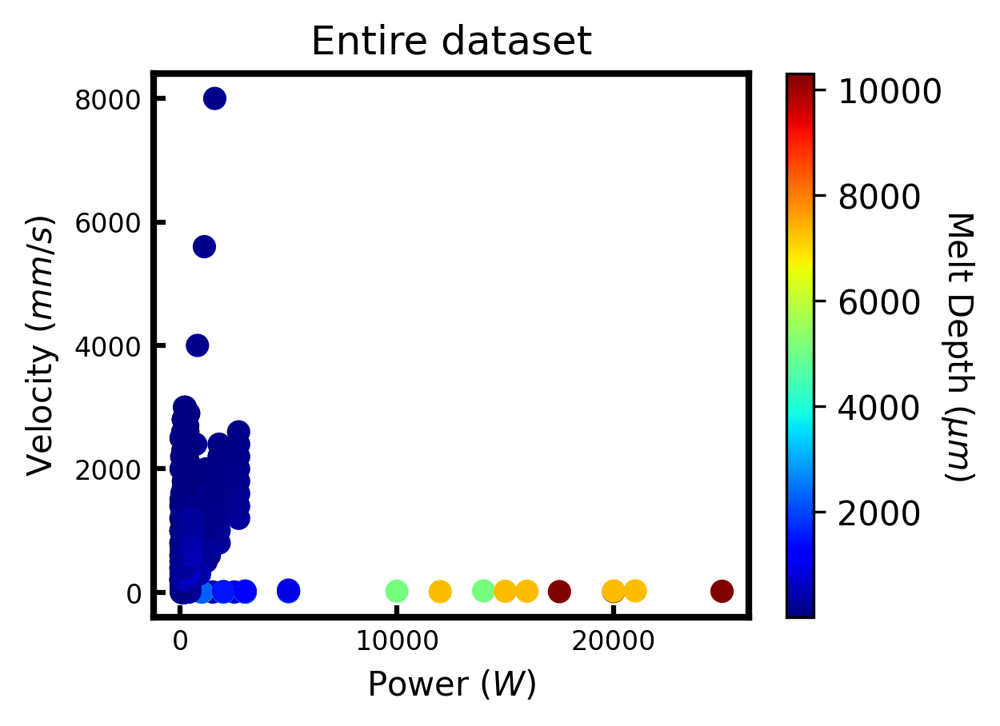

In [10]:
# Plot power vs velocity, color by melt pool depths

fig = plt.figure(figsize = [4,3], dpi = dpi)
plt.scatter(all_power, all_velocity, c = all_depths, cmap = 'jet')
plt.xticks(fontsize = 8)
plt.yticks(fontsize = 8)
frame_tick()
plt.xlabel(r'Power ($W$)')
plt.ylabel(r'Velocity ($mm/s$)')
cbar =plt.colorbar()
cbar.ax.set_ylabel(r'Melt Depth ($\mu m$)', rotation=270, labelpad=10)
plt.title('Entire dataset')




Text(0, 0.5, 'Occurence')

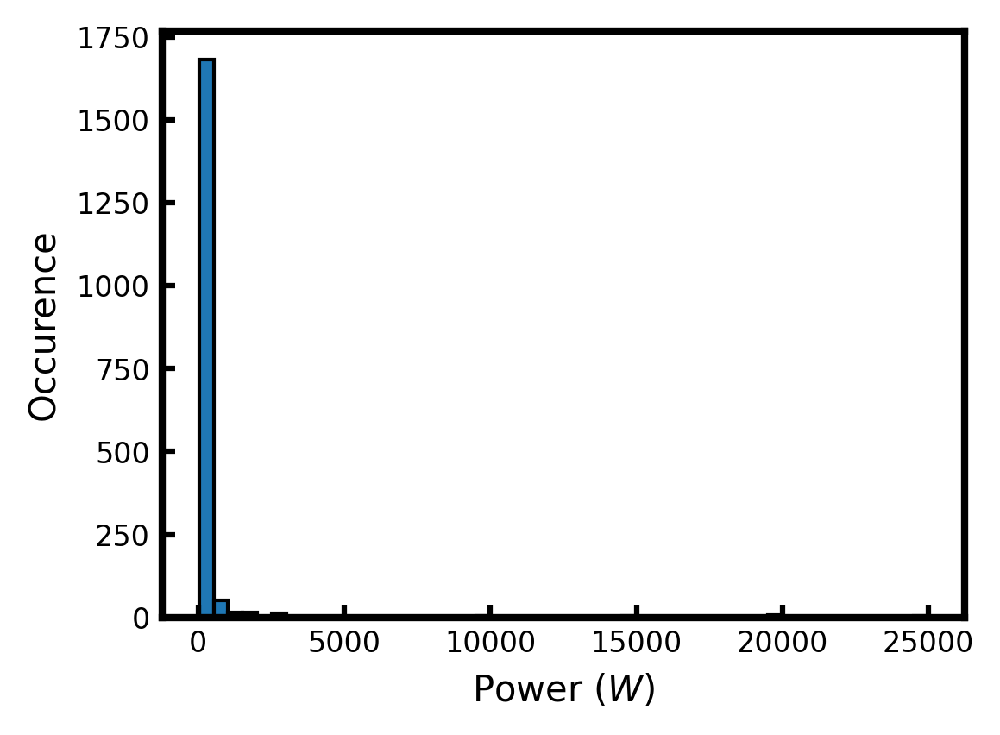

In [11]:

fig = plt.figure(figsize = [4,3], dpi = dpi)
plt.hist(all_power, edgecolor = 'k', bins = 50)
plt.xticks(fontsize = 8)
plt.yticks(fontsize = 8)
frame_tick()
plt.xlabel(r'Power ($W$)')
plt.ylabel(r'Occurence')


Text(0, 0.5, 'Occurence')

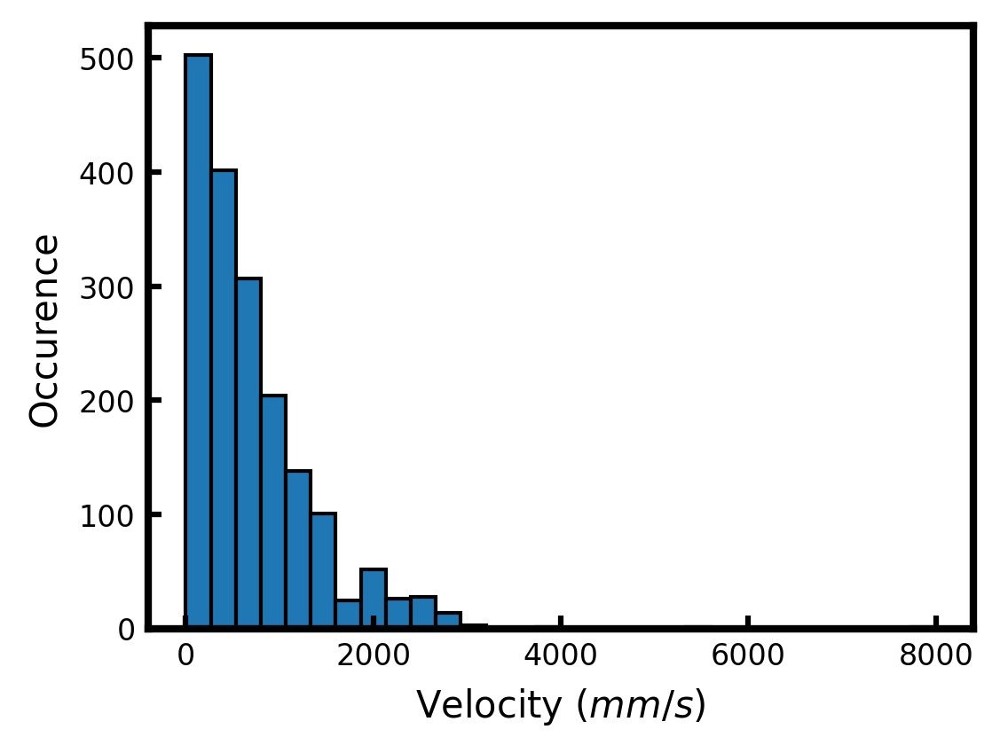

In [12]:
fig = plt.figure(figsize = [4,3], dpi = dpi)
plt.hist(all_velocity, edgecolor = 'k', bins = 30)
plt.xticks(fontsize = 8)
plt.yticks(fontsize = 8)
frame_tick()
plt.xlabel(r'Velocity ($mm/s$)')
plt.ylabel(r'Occurence')

In [13]:
# Examine features present in the dataset

unique, counts = np.unique(csv['Material'], return_counts = True)
pprint(set(zip(unique, counts)))
print("Features: ")
for col in csv.columns:
    print(col)

{('4140 steel', 3),
 ('AA7075', 2),
 ('Al-2.5Fe', 25),
 ('Al-C-Co-Fe-Mn-Ni', 24),
 ('AlSi10Mg', 29),
 ('CMSX-4', 9),
 ('Cu10Sn', 35),
 ('HCP Cu', 19),
 ('Hastelloy X', 41),
 ('IN625', 96),
 ('IN718', 147),
 ('IN738LC', 50),
 ('Invar36', 18),
 ('K403 superalloy', 4),
 ('MS1-', 12),
 ('SS17-4PH', 103),
 ('SS304', 16),
 ('SS304L', 6),
 ('SS316L', 637),
 ('Ti-45Al', 4),
 ('Ti-49Al-2Cr-2Nb', 20),
 ('Ti-6Al-4V', 416),
 ('Ti6242', 6),
 ('TiC/Inconel 718', 8),
 ('Tungsten', 24),
 ('WE43', 12)}
Features: 
Material
Process
Sub-process
Power
Velocity
Hatch spacing
depth of meltpool
width of melt pool
length of melt pool
d/l
d/w
l/w
E (J/mm)
E (J/mm3)
layer thickness
beam D
absorption coefficient
absorption coefficient 2
density
Cp
k
melting T
minimal absorptivity
meltpool shape
spatter
Y (wt%)
Zn (wt%)
Mg (wt%)
Si (wt%)
Al (wt%)
Sn (wt%)
Zr (wt%)
W (wt%)
Ti (wt%)
V (wt%)
Co (wt%)
Cu (wt%)
Ta (wt%)
Nb (wt%)
Ni  (wt.%)
Cr  (wt.%)
Fe (wt.%)
Mn (wt%)
Mo (wt.%)
D10
D50
D90
paper ID
paper
porosity
rela

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25]


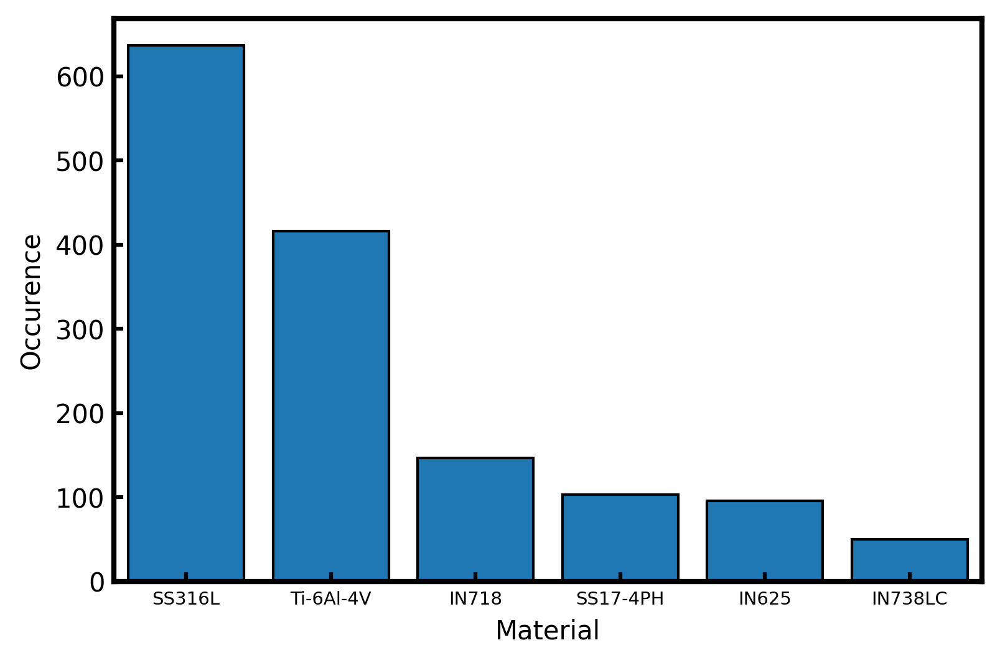

In [14]:
fig = plt.figure(dpi = 300)
materials = csv['Material'].value_counts()
dir(materials)
materials.keys()
#breakpoint()
y_pos = np.arange(len(materials.keys()))
y_pos_str = np.array([key for key  in materials.keys()], dtype = 'object')
print(y_pos)
#plt.bar(y_pos, materials)
plt.xticks(y_pos, y_pos_str, fontsize = 7)
plt.xlim(-0.5, 5.5)
plt.bar(y_pos, materials, edgecolor = 'k')

plt.ylabel("Occurence")
plt.xlabel("Material")
frame_tick()


In [15]:
materials = csv['Material'].value_counts()
materials.keys()
#len(materials.keys())

Index(['SS316L', 'Ti-6Al-4V', 'IN718', 'SS17-4PH', 'IN625', 'IN738LC',
       'Hastelloy X', 'Cu10Sn', 'AlSi10Mg', 'Al-2.5Fe', 'Al-C-Co-Fe-Mn-Ni',
       'Tungsten', 'Ti-49Al-2Cr-2Nb', 'HCP Cu', 'Invar36', 'SS304', 'WE43',
       'MS1-', 'CMSX-4', 'TiC/Inconel 718', 'Ti6242', 'SS304L',
       'K403 superalloy', 'Ti-45Al', '4140 steel', 'AA7075'],
      dtype='object')

In [16]:
for i,j in zip(y_pos, materials.keys()):
    print(i, j)

0 SS316L
1 Ti-6Al-4V
2 IN718
3 SS17-4PH
4 IN625
5 IN738LC
6 Hastelloy X
7 Cu10Sn
8 AlSi10Mg
9 Al-2.5Fe
10 Al-C-Co-Fe-Mn-Ni
11 Tungsten
12 Ti-49Al-2Cr-2Nb
13 HCP Cu
14 Invar36
15 SS304
16 WE43
17 MS1-
18 CMSX-4
19 TiC/Inconel 718
20 Ti6242
21 SS304L
22 K403 superalloy
23 Ti-45Al
24 4140 steel
25 AA7075


In [17]:
# Examine data categories

print('Process')
unique, counts = np.unique(csv['Process'], return_counts = True)
pprint(set(zip(unique, counts)))
print('Material')

unique, counts = np.unique(csv['Material'], return_counts = True)
pprint(set(zip(unique, counts)))
print('paper ID')

unique, counts = np.unique(csv['paper ID'], return_counts = True)
pprint(set(zip(unique, counts)))

shape = np.array(csv['meltpool shape'], dtype = 'str')

unique, counts = np.unique(shape, return_counts = True)
pprint(set(zip(unique, counts)))


Process
{('DED', 68), ('PBF', 1698)}
Material
{('4140 steel', 3),
 ('AA7075', 2),
 ('Al-2.5Fe', 25),
 ('Al-C-Co-Fe-Mn-Ni', 24),
 ('AlSi10Mg', 29),
 ('CMSX-4', 9),
 ('Cu10Sn', 35),
 ('HCP Cu', 19),
 ('Hastelloy X', 41),
 ('IN625', 96),
 ('IN718', 147),
 ('IN738LC', 50),
 ('Invar36', 18),
 ('K403 superalloy', 4),
 ('MS1-', 12),
 ('SS17-4PH', 103),
 ('SS304', 16),
 ('SS304L', 6),
 ('SS316L', 637),
 ('Ti-45Al', 4),
 ('Ti-49Al-2Cr-2Nb', 20),
 ('Ti-6Al-4V', 416),
 ('Ti6242', 6),
 ('TiC/Inconel 718', 8),
 ('Tungsten', 24),
 ('WE43', 12)}
paper ID
{('1', 12),
 ('10', 9),
 ('11', 12),
 ('12', 14),
 ('13', 64),
 ('14', 11),
 ('15', 49),
 ('16', 6),
 ('17', 17),
 ('18', 3),
 ('19', 75),
 ('2', 16),
 ('20', 48),
 ('21', 8),
 ('22', 15),
 ('23', 4),
 ('24', 5),
 ('25', 70),
 ('26', 4),
 ('27', 3),
 ('28', 24),
 ('29', 3),
 ('3', 6),
 ('30', 25),
 ('31', 5),
 ('33', 12),
 ('34', 70),
 ('35', 3),
 ('36', 19),
 ('37', 25),
 ('38', 11),
 ('39', 6),
 ('4', 4),
 ('40', 3),
 ('41', 25),
 ('42', 8),
 ('43'

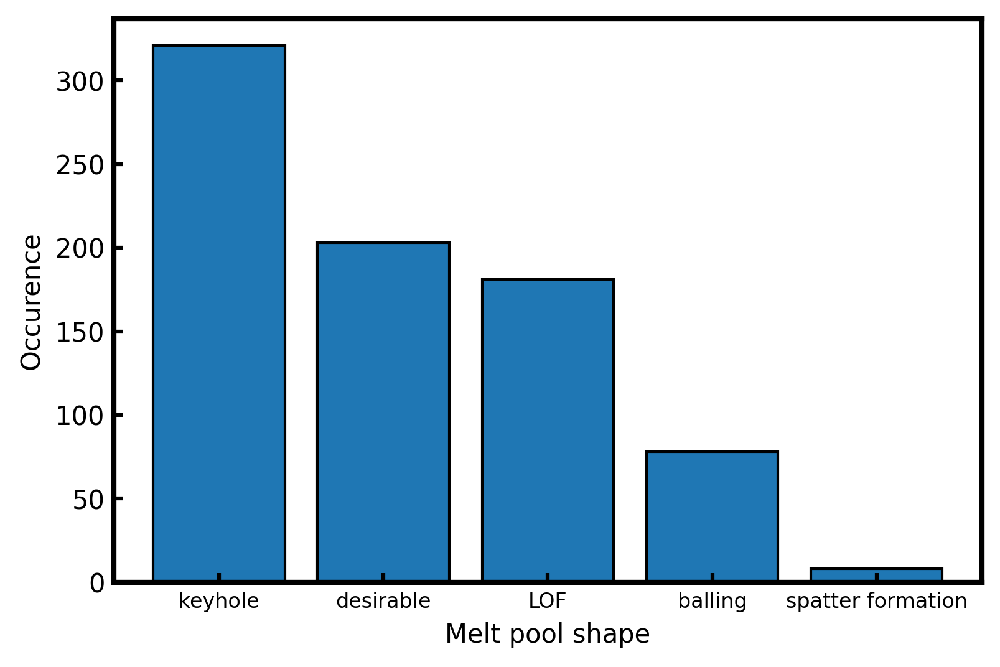

In [18]:
fig = plt.figure(dpi = 300)
defects = csv['meltpool shape'].value_counts()
dir(materials)
materials.keys()
defects_pos = np.arange(len(defects.keys()))
plt.bar(defects_pos, defects, edgecolor = 'k')
plt.xticks(defects_pos, defects.keys(), fontsize=8)
plt.ylabel("Occurence")
plt.xlabel("Melt pool shape")
frame_tick()


In [19]:
# Examine distribution of features
for col in csv.columns:
    values = csv[col]
    num_present = len([value for value in values if not pd.isnull(value)])
    total = len(values)
    parameter = col
    print('{:.1f} % samples has '.format(100*num_present/total) + parameter + ' value')

100.0 % samples has Material value
100.0 % samples has Process value
100.0 % samples has Sub-process value
100.0 % samples has Power value
100.0 % samples has Velocity value
24.2 % samples has Hatch spacing value
81.0 % samples has depth of meltpool value
63.8 % samples has width of melt pool value
17.9 % samples has length of melt pool value
65.4 % samples has d/l value
49.5 % samples has d/w value
34.7 % samples has l/w value
93.9 % samples has E (J/mm) value
20.8 % samples has E (J/mm3) value
81.2 % samples has layer thickness value
83.4 % samples has beam D value
60.6 % samples has absorption coefficient value
63.4 % samples has absorption coefficient 2 value
97.2 % samples has density value
97.2 % samples has Cp value
97.0 % samples has k value
100.0 % samples has melting T value
72.0 % samples has minimal absorptivity value
44.8 % samples has meltpool shape value
0.5 % samples has spatter value
100.0 % samples has Y (wt%) value
100.0 % samples has Zn (wt%) value
100.0 % samples h

In [20]:
atomic_features = []
for col in csv.columns:
   # print('%' in col)
    if '%' in col:
        atomic_features.append(col)
atomic_features

['Y (wt%)',
 'Zn (wt%)',
 'Mg (wt%)',
 'Si (wt%)',
 'Al (wt%)',
 'Sn (wt%)',
 'Zr (wt%)',
 'W (wt%)',
 'Ti (wt%)',
 'V (wt%)',
 'Co (wt%)',
 'Cu (wt%)',
 'Ta (wt%)',
 'Nb (wt%)',
 'Ni  (wt.%)',
 'Cr  (wt.%)',
 'Fe (wt.%)',
 'Mn (wt%)',
 'Mo (wt.%)']

In [21]:

#one_hot_encoding
materials_ohe = [np.zeros(len(csv)) for key in materials.keys()]
len(materials_ohe)
materials_ohe = np.array(materials_ohe).T
#breakpoint()
#materials.keys()
print(len(materials_ohe))
material_pos = np.arange(len(materials.keys()))
for idx in range(len(csv)):
    for j_idx in range(len(material_pos)):
      #  breakpoint()
        if csv['Material'].iloc[idx] == materials.keys()[j_idx]:
            
            materials_ohe[idx,j_idx] = 1 
            #pass
# for i,j in zip(y_pos, materials.keys()):
    
#     print(i, j)
#breakpoint()
print(np.argmax(materials_ohe, axis = 1))
#breakpoint()

1766
[1 1 1 ... 1 1 1]


In [22]:
csv.keys()

Index(['Material', 'Process', 'Sub-process', 'Power', 'Velocity',
       'Hatch spacing', 'depth of meltpool', 'width of melt pool',
       'length of melt pool', 'd/l', 'd/w', 'l/w', 'E (J/mm)', 'E (J/mm3)',
       'layer thickness', 'beam D', 'absorption coefficient',
       'absorption coefficient 2', 'density', 'Cp', 'k', 'melting T',
       'minimal absorptivity', 'meltpool shape', 'spatter', 'Y (wt%)',
       'Zn (wt%)', 'Mg (wt%)', 'Si (wt%)', 'Al (wt%)', 'Sn (wt%)', 'Zr (wt%)',
       'W (wt%)', 'Ti (wt%)', 'V (wt%)', 'Co (wt%)', 'Cu (wt%)', 'Ta (wt%)',
       'Nb (wt%)', 'Ni  (wt.%)', 'Cr  (wt.%)', 'Fe (wt.%)', 'Mn (wt%)',
       'Mo (wt.%)', 'D10', 'D50', 'D90', 'paper ID', 'paper', 'porosity',
       'relative density', 'comment', 'Unnamed: 52'],
      dtype='object')

# Machine Learning

## Helper functions for selecting data

In [23]:
# select subset of data containing material, process, etc
# select_subset generalizes this for any feature
def select_material(csv, material):
    material_csv = csv.loc[csv['Material'] == material]

    return material_csv

def select_process(csv, process):
    process_csv = csv.loc[csv['Process'] == process]
    return process_csv

def select_subset(csv, feature, value):
    select_csv = csv.loc[csv[feature] == value]
    return select_csv

False
False
False
False
False
False
False
True
True
False
True
True
False
False
False
False
False
True
False
False
False
False
False
False
True
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
True
True
True
False
False
True
True
True
False
True
True
True
True
True


In [24]:
def select_parameters(new_csv, parameter_list, label_col):
    '''
    Select data with valid values for each parameter in parameter_list, and
    select the feature in label_col as the prediction feature
    
    Arguments:
    new_csv: data csv to be processed (Pandas DataFrame)
    parameter_list: list of strings corresponding to feature names
    label_col: string corresponding to feature name
    
    Returns:
    X: n x m numpy array of data features with n samples and m features
    y: n x 1 numpy array of data labels
    '''
    data_list = []
    label_list = []
    for i in range(len(new_csv)):
        success, features, label = extract_features(new_csv.iloc[i], parameter_list, label_col)
        
        if success < 0:
            continue
        else:
            data_list.append(features)
            label_list.append(label)
    X = np.array(np.squeeze(data_list))  
    
    y = np.array(label_list)
    
    return(X, y)

In [63]:

new_csv = select_subset(class_csv, 'Sub-process','SLM')
parameter_list = ['Power', 'Velocity', 'layer thickness']
label_col = 'meltpool shape'
X, y = select_parameters(new_csv, parameter_list, label_col)


In [69]:
#new_csv.iloc[3,:]
# np.array(test)
# for j in range(X.shape[0]):
#     for i in range(len(test)):
#         test = X[j,:]
#         print(np.isnan(test[i]))
test_csv = new_csv[['Power', "Velocity", "layer thickness"]]
# test_csv
for j in range(test_csv.shape[0]):
    for i in range(len(test)):
        test = test_csv.iloc[j,:]
        print(pd.isnull(test[i]), j)

False 0
False 0
False 0
False 1
False 1
False 1
False 2
False 2
False 2
False 3
False 3
False 3
False 4
False 4
False 4
False 5
False 5
False 5
False 6
False 6
False 6
False 7
False 7
False 7
False 8
False 8
False 8
False 9
False 9
False 9
False 10
False 10
False 10
False 11
False 11
False 11
False 12
False 12
False 12
False 13
False 13
False 13
False 14
False 14
False 14
False 15
False 15
False 15
False 16
False 16
False 16
False 17
False 17
False 17
False 18
False 18
False 18
False 19
False 19
False 19
False 20
False 20
False 20
False 21
False 21
False 21
False 22
False 22
False 22
False 23
False 23
False 23
False 24
False 24
False 24
False 25
False 25
False 25
False 26
False 26
False 26
False 27
False 27
False 27
False 28
False 28
False 28
False 29
False 29
False 29
False 30
False 30
False 30
False 31
False 31
False 31
False 32
False 32
False 32
False 33
False 33
False 33
False 34
False 34
False 34
False 35
False 35
False 35
False 36
False 36
False 36
False 37
False 37
False 37
Fals

False 330
False 331
False 331
False 331
False 332
False 332
False 332
False 333
False 333
False 333
False 334
False 334
False 334
False 335
False 335
False 335
False 336
False 336
False 336
False 337
False 337
False 337
False 338
False 338
False 338
False 339
False 339
False 339
False 340
False 340
False 340
False 341
False 341
False 341
False 342
False 342
False 342
False 343
False 343
False 343
False 344
False 344
False 344
False 345
False 345
False 345
False 346
False 346
False 346
False 347
False 347
False 347
False 348
False 348
False 348
False 349
False 349
False 349
False 350
False 350
False 350
False 351
False 351
False 351
False 352
False 352
False 352
False 353
False 353
False 353
False 354
False 354
False 354
False 355
False 355
False 355
False 356
False 356
False 356
False 357
False 357
False 357
False 358
False 358
False 358
False 359
False 359
False 359
False 360
False 360
False 360
False 361
False 361
False 361
False 362
False 362
False 362
False 363
False 363
False 363


False 668
False 668
False 669
False 669
False 669
False 670
False 670
False 670
False 671
False 671
False 671
False 672
False 672
False 672
False 673
False 673
False 673
False 674
False 674
False 674
False 675
False 675
False 675
False 676
False 676
False 676
False 677
False 677
False 677
False 678
False 678
False 678
False 679
False 679
False 679
False 680
False 680
False 680
False 681
False 681
False 681
False 682
False 682
True 682
False 683
False 683
True 683
False 684
False 684
True 684
False 685
False 685
True 685
False 686
False 686
True 686
False 687
False 687
True 687
False 688
False 688
True 688
False 689
False 689
True 689
False 690
False 690
True 690
False 691
False 691
True 691
False 692
False 692
True 692
False 693
False 693
False 693
False 694
False 694
False 694
False 695
False 695
False 695
False 696
False 696
False 696
False 697
False 697
False 697
False 698
False 698
False 698
False 699
False 699
False 699
False 700
False 700
False 700
False 701
False 701
False 701
F

True 1003
False 1004
False 1004
True 1004
False 1005
False 1005
True 1005
False 1006
False 1006
True 1006
False 1007
False 1007
False 1007
False 1008
False 1008
False 1008
False 1009
False 1009
False 1009
False 1010
False 1010
False 1010
False 1011
False 1011
False 1011
False 1012
False 1012
False 1012
False 1013
False 1013
True 1013
False 1014
False 1014
True 1014
False 1015
False 1015
True 1015
False 1016
False 1016
True 1016
False 1017
False 1017
True 1017
False 1018
False 1018
True 1018
False 1019
False 1019
True 1019
False 1020
False 1020
True 1020
False 1021
False 1021
True 1021
False 1022
False 1022
True 1022
False 1023
False 1023
True 1023
False 1024
False 1024
True 1024
False 1025
False 1025
True 1025
False 1026
False 1026
False 1026
False 1027
False 1027
False 1027
False 1028
False 1028
False 1028
False 1029
False 1029
False 1029
False 1030
False 1030
False 1030
False 1031
False 1031
False 1031
False 1032
False 1032
False 1032
False 1033
False 1033
False 1033
False 1034
False

False 1323
False 1323
False 1323
False 1324
False 1324
False 1324
False 1325
False 1325
False 1325
False 1326
False 1326
False 1326
False 1327
False 1327
False 1327
False 1328
False 1328
False 1328
False 1329
False 1329
False 1329
False 1330
False 1330
False 1330
False 1331
False 1331
False 1331
False 1332
False 1332
False 1332
False 1333
False 1333
False 1333
False 1334
False 1334
False 1334
False 1335
False 1335
False 1335
False 1336
False 1336
False 1336
False 1337
False 1337
False 1337
False 1338
False 1338
False 1338
False 1339
False 1339
False 1339
False 1340
False 1340
False 1340
False 1341
False 1341
False 1341
False 1342
False 1342
False 1342
False 1343
False 1343
False 1343
False 1344
False 1344
False 1344
False 1345
False 1345
False 1345
False 1346
False 1346
False 1346
False 1347
False 1347
False 1347
False 1348
False 1348
False 1348
False 1349
False 1349
False 1349
False 1350
False 1350
False 1350
False 1351
False 1351
False 1351
False 1352
False 1352
False 1352
False 1353

In [25]:
def extract_features(data_point, parameters, label):
    '''
    Given a sample in the dataset, determine if it has all of the features listed in parameters and a valid label
    If it does, return the data point as a single sample, if not, return -1
    
    Arguments:
    data_point: row of Pandas DataFrame
    parameters: list of strings
    label: string
    
    Returns:
    success: -1 if not all parameters found, 1 if all parameters found
    features: list of floats if all parameters found
    data_point[label]: float corresponding to the label of the datapoint
    '''
    
    features = []
    success = 0
    for parameter in parameters:
        
        if pd.isnull(data_point[parameter]) or pd.isnull(data_point[label]):
            success = -1
            return success, features, data_point[label]
        else:
            success = 1
            try:
                features.append(float(data_point[parameter]))
            except:
                success = -1
                return success, features, data_point[label]
    return success, features, data_point[label]
        
    

## Initialize Elemental Features

In [26]:
import numpy as np
import re
from mendeleev import element as elem
import pandas as pd

print("Creating list of elements from periodic table...")
elements = [elem(i+1).symbol for i in range(117)]
print("Done")

orbitals = {"s1": 0, "s2": 1, "p1": 2, "p2": 3, "p3": 4, "p4": 5, "p5": 6, "p6": 7, "d1": 8, "d2": 9, "d3": 10, "d4": 11,
            "d5": 12, "d6": 13, "d7": 14, "d8": 15, "d9": 16, "d10": 17, "f1": 18, "f2": 19, "f3": 20, "f4": 21,
            "f5": 22, "f6": 23, "f7": 24, "f8": 25, "f9": 26, "f10": 27, "f11": 28, "f12": 29, "f13": 30, "f14": 31}

groups = ['IA', 'IIA', 'IIIB', 'IVB', 'VB', 'VIB', 'VIIB', 'VIIIB',
          'IB', 'IIB', 'IIIA', 'IVA', 'VA', 'VIA', 'VIIA', 'VIIIA']

group_dict = {}
k = 0
for group in groups:
    group_dict[group] = k
    k += 1
#print(orbitals)
hv = np.zeros(shape=(32, 1))
hvs = {}

for key in elements:
    element = key
    hv = np.zeros(shape=(32, 1))
    #hvs[element] = hv
    #print('-----')

    #print(key)
    
    if element != 'H':
        s = elem(element).ec.get_valence().to_str()
    #print("S:",s)

    
    #print("SP:",sp)
    if key == "H":
        hv[0] = 1
    if key != "H":
        sp = (re.split('(\s+)', s))
        for j in range(0, len(sp)):
            if sp[j] != ' ' and sp[j]!= '':
                #a = re.findall('.{1,2}', sp[j])
                n = sp[j][:1]
                orb = sp[j][1:]
                #print(n,orb)
                hv[orbitals[orb]] = 1
    hvs[element] = hv

    
def barcode(element):
     # Calculate orbital features

    s_orbital = np.reshape(hvs[element][:2], len(hvs[element][:2]))
    p_orbital = np.reshape(hvs[element][2:8], len(hvs[element][2:8]))
    d_orbital = np.reshape(hvs[element][8:18], len(hvs[element][8:18]))
    f_orbital = np.reshape(hvs[element][18:], len(hvs[element][18:]))

    orbitals = [s_orbital, p_orbital, d_orbital, f_orbital]
    orbital_info = []
    for orbital in orbitals:
        if np.sum(orbital) < 1:
            # if empty, put 0
            sum_orbital = 0
            orbital_info.append(sum_orbital)
        else:
            sum_orbital = np.where(orbital > 0)[0][0]
            orbital_info.append(sum_orbital)
    return orbital_info


csv = pd.read_csv('meltpoolgeometry.csv')
atomic_features = []
for col in csv.columns:
   # print('%' in col)
    if '%' in col:
        atomic_features.append(col)
# atomic_features
barcode(element)
element_list = [atom.split(' (')[0].split(' ')[0] for atom in atomic_features]


def element_from_feature(feature):
    return feature.split(' (')[0].split(' ')[0]


def atomic_featurize(element_list, element_comps):
    # takes in list of elements, produces features for each element
    result = []
    group_avg = 0
    period_avg = 0
    atomic_number_avg = 0
    eneg_avg = 0
    ele_avg = 0
    ionenergy_avg = 0
    orbits_avg = [0, 0, 0, 0]
    fusion_heat_avg = 0
    electron_affin_avg = 0
    rad_avg = 0
    atom_vol_avg = 0
    sum_comp = 0
    idx = 0
    for element in element_list:
        
        #composition
        comp = element_comps[idx]
        sum_comp += comp * 0.01
        
        # Define element object in mendeleev
        el_obj = elem(element)

        atomic_number = el_obj.atomic_number * comp * 0.01

        eneg = el_obj.electronegativity(scale='pauling')  * comp * 0.01      

        ele = el_obj.electrons * comp * 0.01

        # get first ionization energy
        key = np.min([key for key in el_obj.ionenergies.keys()])
        ionenergy = el_obj.ionenergies[key] * comp * 0.01
        
        # Heat of fusion
        fusion_heat = el_obj.fusion_heat * comp * 0.01

        # Electron affinity
        electron_affin = el_obj.electron_affinity
        if electron_affin is None:
           # breakpoint()
            electron_affin = 0
        else:
            electron_affin = electron_affin * comp * 0.01

        
        # Metalic radius
        rad = el_obj.metallic_radius * comp * 0.01
        
        # Atomic volume
        atom_vol = el_obj.atomic_volume * comp * 0.01

        idx = idx + 1
        
        atomic_number_avg += atomic_number
        eneg_avg += eneg
        ele_avg += ele
        ionenergy_avg += ionenergy
        fusion_heat_avg += fusion_heat
        electron_affin_avg += electron_affin
        rad_avg += rad
        atom_vol_avg += atom_vol 
   
    result.extend([atomic_number_avg, eneg_avg, rad_avg, ele_avg,
                   atom_vol_avg, electron_affin_avg, ionenergy_avg, fusion_heat_avg])
    
    # divided by the sum of composition
    for i in range(len(result)):
        result[i] = result[i] / sum_comp

    return result

def test_csv():
    # get features for the entire dataset
    all_atomic_features = []
    length_alloys = []
    for i in range(len(csv)):

        # iterate over datapoints
        elem_names = []
        elem_comps = []
        for feature in atomic_features:
            # iterate over elements to find non-zero entries
            comp = csv.iloc[i][feature]

            try:
                alloy_elem = float(comp)
            except:

                alloy_elem = 0
            if alloy_elem > 0:
                elem_names.append(feature)
                elem_comps.append(alloy_elem)

        # sort by composition
        elem_sort_idx = np.argsort(elem_comps)[::-1][:6]
        elem_sort_names = np.array(elem_names, dtype='object')[elem_sort_idx]
        elem_sort_comps = np.array(elem_comps)[elem_sort_idx]
        length_alloys.append(len(elem_comps))
        # get features for each of the three elements
        elem_features = [element_from_feature(el) for el in elem_sort_names]
        features = atomic_featurize(elem_features, elem_sort_comps)
        if i % 100 == 0:
            print("sample feature ", atomic_featurize(elem_features, elem_sort_comps))

        all_atomic_features.append(features)
    return np.array(all_atomic_features)

def featurize_datapoint(csv, index):
    # get features for a single data point
    elem_names = []
    elem_comps = []
    
    for feature in atomic_features:
        # iterate over elements to find non-zero entries
        comp = csv.iloc[index][feature]

        try:
            alloy_elem = float(comp)
        except:

            alloy_elem = 0
        if alloy_elem > 0:
            elem_names.append(feature)
            elem_comps.append(alloy_elem)

    #print(len(elem_comps))
    # sort by composition
    elem_sort_idx = np.argsort(elem_comps)[::-1][:6]
    
    elem_sort_names = np.array(elem_names, dtype='object')[elem_sort_idx]
    elem_sort_comps = np.array(elem_comps)[elem_sort_idx]

    # get features for each of the three elements
    elem_features = [element_from_feature(el) for el in elem_sort_names]
    all_features = atomic_featurize(elem_features, elem_sort_comps)

    return all_features

Creating list of elements from periodic table...
Done


## Replace Thermodynamic parameters by each element

In [27]:
def atomic_featurize_rp(element_list, element_comps):
    # takes in list of elements, produces features for each element
    result = []
    den_avg = 0
    meltT_avg = 0
    specheat_avg = 0
    k_avg = 0
    sum_comp = 0
    idx = 0
    for element in element_list:
        
        #composition
        comp = element_comps[idx]
        sum_comp += comp * 0.01
        # Define element object in mendeleev
        el_obj = elem(element)
        
        # Density
        den = el_obj.density * comp * 0.01
        # melting temperature
        meltT = el_obj.melting_point * comp * 0.01

        # Specific heat
        specheat = el_obj.specific_heat * comp * 0.01
        
        # Thermal conductivity
        k = el_obj.thermal_conductivity
        if k == None:
            k = 0
        else:
            k = k * comp * 0.01
        
        
        den_avg += den
        meltT_avg += meltT
        specheat_avg += specheat
        k_avg += k
        
    result.extend([den_avg, meltT_avg, specheat_avg, k_avg])
    
    for i in range(len(result)):
        result[i] = result[i] / sum_comp

    return result

def featurize_datapoint_rp(csv, index):
    # get features for a single data point
    elem_names = []
    elem_comps = []
    
    for feature in atomic_features:
        # iterate over elements to find non-zero entries
        comp = csv.iloc[index][feature]

        try:
            alloy_elem = float(comp)
        except:

            alloy_elem = 0
        if alloy_elem > 0:
            elem_names.append(feature)
            elem_comps.append(alloy_elem)

    #print(len(elem_comps))
    # sort by composition
    elem_sort_idx = np.argsort(elem_comps)[::-1][:6]
    
    elem_sort_names = np.array(elem_names, dtype='object')[elem_sort_idx]
    elem_sort_comps = np.array(elem_comps)[elem_sort_idx]

    # get features for each of the three elements
    elem_features = [element_from_feature(el) for el in elem_sort_names]
    all_features = atomic_featurize_rp(elem_features, elem_sort_comps)

    return all_features

### ***Define bins for binned features

In [28]:
def atomic_featurize_rp(element_list, element_comps):
    # takes in list of elements, produces features for each element
    result = []
    den_avg = 0
    meltT_avg = 0
    specheat_avg = 0
    k_avg = 0
    sum_comp = 0
    idx = 0
    for element in element_list:
        
        #composition
        comp = element_comps[idx]
        sum_comp += comp * 0.01
        # Define element object in mendeleev
        el_obj = elem(element)
        
        # Density
        den = el_obj.density * comp * 0.01
        # melting temperature
        meltT = el_obj.melting_point * comp * 0.01

        # Specific heat
        specheat = el_obj.specific_heat * comp * 0.01
        
        # Thermal conductivity
        k = el_obj.thermal_conductivity
        if k == None:
            k = 0
        else:
            k = k * comp * 0.01
        
        
        den_avg += den
        meltT_avg += meltT
        specheat_avg += specheat
        k_avg += k
        
    result.extend([den_avg, meltT_avg, specheat_avg, k_avg])
    
    for i in range(len(result)):
        result[i] = result[i] / sum_comp

    return result

def featurize_datapoint_rp(csv, index):
    # get features for a single data point
    elem_names = []
    elem_comps = []
    
    for feature in atomic_features:
        # iterate over elements to find non-zero entries
        comp = csv.iloc[index][feature]

        try:
            alloy_elem = float(comp)
        except:

            alloy_elem = 0
        if alloy_elem > 0:
            elem_names.append(feature)
            elem_comps.append(alloy_elem)

    #print(len(elem_comps))
    # sort by composition
    elem_sort_idx = np.argsort(elem_comps)[::-1][:6]
    
    elem_sort_names = np.array(elem_names, dtype='object')[elem_sort_idx]
    elem_sort_comps = np.array(elem_comps)[elem_sort_idx]

    # get features for each of the three elements
    elem_features = [element_from_feature(el) for el in elem_sort_names]
    all_features = atomic_featurize_rp(elem_features, elem_sort_comps)
#     if i % 100 == 0:
#         print(atomic_featurize(elem_features, elem_sort_comps))
    return all_features

In [29]:
csv.keys()

Index(['Material', 'Process', 'Sub-process', 'Power', 'Velocity',
       'Hatch spacing', 'depth of meltpool', 'width of melt pool',
       'length of melt pool', 'd/l', 'd/w', 'l/w', 'E (J/mm)', 'E (J/mm3)',
       'layer thickness', 'beam D', 'absorption coefficient',
       'absorption coefficient 2', 'density', 'Cp', 'k', 'melting T',
       'minimal absorptivity', 'meltpool shape', 'spatter', 'Y (wt%)',
       'Zn (wt%)', 'Mg (wt%)', 'Si (wt%)', 'Al (wt%)', 'Sn (wt%)', 'Zr (wt%)',
       'W (wt%)', 'Ti (wt%)', 'V (wt%)', 'Co (wt%)', 'Cu (wt%)', 'Ta (wt%)',
       'Nb (wt%)', 'Ni  (wt.%)', 'Cr  (wt.%)', 'Fe (wt.%)', 'Mn (wt%)',
       'Mo (wt.%)', 'D10', 'D50', 'D90', 'paper ID', 'paper', 'porosity',
       'relative density', 'comment', 'Unnamed: 52'],
      dtype='object')

## Regression Task

Predicts the melt pool depth based on features of the build process, iterating over the algorithms:


- Random Forests 'RF'


- Gaussian Process Regression 'GPR'


- Support Vector Regression 'SVR'


- Ridge Linear Regression 'Ridge'


- Lasso Linear Regression  'Lasso'


- Gradient Boosted Random Forest 'GB'



- Neural Network 'NN'

Base ML case considers process and thermodynamic parameters, and later cells add one-hot-encoding and elemental features


In [30]:
%matplotlib inline 

def learn(data, depth, material = None, parameters = None, title = None, plot = False, materials_ohe = None, paper_ID= None, elemental_features = None):
    
    '''
    
    
    Iterate over the models, performing training/cross-validation and plotting regression results

    
    Arguments:
    data: Matrix array of data, n samples x m features, numpy array
    depth: vector of depth values, n samples x 1 feature, numpy array
    
    (Optional, only displayed on figure)
    material: Material that is trained on (string)
    parameters: parameters contained in data (list of strings)
    title: Any additional information (e.g. process, paper ID) to be specified (string)
    plot: Whether to produce plots
    
    Returns:
    fit_models: List of fit models
    train_accuracy: List of CV Pearson R^2
    train_accuracy_std: List of standard deviation of Pearson R^2
    test_accuracy: List of test Pearson R^2
    test_accuracy_std: List of standard deviation of Pearson R^2
   
    
    
    '''
    
    labels = depth

    params = { #'font.family'      : 'serif',
               'font.size'        : 12,
               'xtick.labelsize'  : 'small',
               'ytick.labelsize'  : 'small',
               #'axes.labelsize'   : 'large',
               'axes.linewidth'   : 1.3 }
    plt.rcParams.update(params)


    y  = labels
    X = data
    
    # transpose if shape of label and data do not match
    if len(X) != len(labels):
        X = X.T
        print(len(labels), len(X))
        print('transposed to ' + str(X.shape[0]) + ', ' + str(X.shape[1]))
        
    # If elemental feautures are provided, append it
    if elemental_features is not None:
        try:
            X = np.hstack((X, elemental_features))
            
        except:
            breakpoint()  
    idx_normalize = len(X[0])
    # If material one hot encoding info is provided, append it
    if materials_ohe is not None:
        X = np.hstack((X, materials_ohe))
    
            
        
    fit_models = []
    train_accuracy = []
    train_accuracy_std = []
    test_accuracy = []
    test_accuracy_std = []
    
    
    # Iterate over implemented models
    for modeltoggle in ['RF', 'GPR', 'SVR', 'Ridge', 'Lasso', 'GB', 'NN']:
        if modeltoggle == 'RF':
            model = RandomForestRegressor(n_estimators = 500,random_state = 0)
            
        elif modeltoggle == 'GPR':
            kernel = gp.kernels.ConstantKernel(1.0, (1e-1, 1e3))*gp.kernels.RBF(1.0, (1e-3, 1e3))
            
            model = gp.GaussianProcessRegressor(kernel = kernel, n_restarts_optimizer = 10, alpha = 0.5, normalize_y = True)
            
        elif modeltoggle == 'SVR':
            model = SVR()
        elif modeltoggle == 'Ridge':
            model = Ridge(alpha = 0.1)

        elif modeltoggle == 'Lasso':
            model = Lasso(alpha = 0.1)
            #model = Lasso()
        elif modeltoggle == 'GB':
            model = GradientBoostingRegressor()
        elif modeltoggle == 'NN':
             model = MLPRegressor(hidden_layer_sizes=(256, 256, 512), activation='relu', solver='adam', alpha=0.002, max_iter = 20000)
       
        
        # Perform cross validation for each model
        kf = KFold(n_splits=5)
        trains = []
        tests = []
        train_maes = []
        test_maes = []
        # Perform cross validation for each model
        
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)
        for train, test in kf.split(X_train):
            
            
            # Shuffle data points before prediction
            X_shuffle, y_shuffle = shuffle(X_train, y_train, random_state=0)

            X_cv_train_before = X_shuffle[train]
            X_cv_test_before = X_shuffle[test]
            y_cv_train_before = y_shuffle[train]
            y_cv_test_before = y_shuffle[test]
            
            
            # Rescale the data to fit standard normal distribution
            # data is rescaled on indices before idx_normalize because indices after may include one-hot-encoded data
            X_train_cv_firsthalf = (X_cv_train_before[:,:idx_normalize] - np.mean(X_cv_train_before[:,:idx_normalize], axis = 0))/(np.std(X_cv_train_before[:,:idx_normalize], axis = 0) + 1e-10)
            X_test_cv_firsthalf = (X_cv_test_before[:,:idx_normalize] - np.mean(X_cv_train_before[:,:idx_normalize], axis = 0))/(np.std(X_cv_train_before[:,:idx_normalize], axis = 0) + 1e-10)
            y_train_cv = (y_cv_train_before - np.mean(y_cv_train_before))/(np.std(y_cv_train_before) + 1e-10)
            y_test_cv = (y_cv_test_before - np.mean(y_cv_train_before))/(np.std(y_cv_train_before) + 1e-10)
            
            # put normalized numerical data with categorical data if present
            X_train_cv = np.hstack((X_train_cv_firsthalf, X_cv_train_before[:, idx_normalize:]))
            X_test_cv = np.hstack((X_test_cv_firsthalf, X_cv_test_before[:, idx_normalize:]))
                
            model.fit(X_train_cv, y_train_cv)
            
            # Calculate MAE and R^2
            
            y_predtrain = model.predict(X_train_cv)
            y_predtest = model.predict(X_test_cv)

            trains.append(model.score(X_train_cv, y_train_cv))
            tests.append(model.score(X_test_cv, y_test_cv))

            
            y_test_pred = model.predict(X_test_cv)
            y_original_scaled = y_test_cv*np.std(y_cv_train_before)+np.mean(y_cv_train_before)
            pred_original_scaled = y_predtest*np.std(y_cv_train_before)+np.mean(y_cv_train_before)
            mae_test = metrics.mean_absolute_error(y_original_scaled, pred_original_scaled)

            y_train_pred = model.predict(X_train_cv)
            train_y_original_scaled = y_train_cv*np.std(y_cv_train_before)+np.mean(y_cv_train_before)
            train_pred_original_scaled = y_predtrain*np.std(y_cv_train_before)+np.mean(y_cv_train_before)
            
            
            mae_train = metrics.mean_absolute_error(train_y_original_scaled, train_pred_original_scaled)
            train_maes.append(mae_train)
            test_maes.append(mae_test)
            
        # Aggregate information
        trains = np.array(trains)
        tests = np.array(tests)
        train_maes = np.array(train_maes)
        test_maes = np.array(test_maes)
        r2_mean = tests.mean()
        r2_std = tests.std()
        r2_train_mean = trains.mean()
        r2_train_std =  trains.std()
        
        
        
        mae_mean_train = train_maes.mean()
        mae_mean_test = test_maes.mean()
        
        mae_mean_train_std = train_maes.std()
        mae_mean_test_std = test_maes.std()
        
        train_accuracy.append(r2_train_mean)
        test_accuracy_std.append(r2_std)
        test_accuracy.append(r2_mean)
        train_accuracy_std.append(r2_train_std)
     
        print(modeltoggle, ' Train R^2: {:.5f} ± {:.5f}, Test R^2: {:.5f} ± {:.5f}'.
                format( r2_train_mean, r2_train_std, r2_mean, r2_std))

        # Plot results: everything scaled back to original values by multiplying by std and adding mean of training labels
        if plot:
            fig = plt.figure(figsize = [4,3], dpi = dpi)
            plt.plot(np.sort(y_test_cv)*np.std(y_cv_train_before)+np.mean(y_cv_train_before), y_predtest[np.argsort(y_test_cv)]*np.std(y_cv_train_before)+np.mean(y_cv_train_before), 'r.', ms = 6)
            plt.plot(np.arange(-4*np.std(y_cv_train_before)+np.mean(y_cv_train_before), 4*np.std(y_cv_train_before)+np.mean(y_cv_train_before)), np.arange(-4*np.std(y_cv_train_before)+np.mean(y_cv_train_before),4*np.std(y_cv_train_before)+np.mean(y_cv_train_before)), 'k-')
            plt.xticks(fontsize = 8)
            plt.yticks(fontsize = 8)
        
        
# Uncomment this to display parameters on figure
#         if material is None:
#             label = "Parameters: " + '\n'
#             for parameter in parameters:
#                 paramstring = "•" + parameter+ '\n'
#                 label += paramstring
       
            plt.title(modeltoggle + " - Test Set: "+ str(title))
            plt.xlabel("Actual Melt Pool Depth")
            plt.ylabel("Predicted Melt Pool Depth")
            s_cv =  'Test CV $R^2$: {:.3f} ± {:.3f}'.format(r2_mean, r2_std)
            plt.text(50, 2*np.std(y_cv_train_before)+np.mean(y_cv_train_before), s_cv, fontsize=8)
            s =  'Test $MAE$: {:.3f}'.format(mae_mean_test)
            plt.text(50, 2.5*np.std(y_cv_train_before)+np.mean(y_cv_train_before), s, fontsize=10)

            plt.ylim(0, 3*np.std(y_cv_train_before)+np.mean(y_cv_train_before))
            plt.xlim(0, 3*np.std(y_cv_train_before)+np.mean(y_cv_train_before))

            plt.gca().set_aspect('equal')
            frame_tick()
           # savefig(title+modeltoggle + "test"+".png")
            plt.show()
            plt.clf()

            fig = plt.figure(figsize = [4,3], dpi = dpi)
            plt.plot(np.sort(train_y_original_scaled), train_pred_original_scaled[np.argsort(train_y_original_scaled)], 'r.', ms = 6)
            plt.plot(np.arange(-4*np.std(y_cv_train_before)+np.mean(y_cv_train_before), 4*np.std(y_cv_train_before)+np.mean(y_cv_train_before)), np.arange(-4*np.std(y_cv_train_before)+np.mean(y_cv_train_before),4*np.std(y_cv_train_before)+np.mean(y_cv_train_before)), 'k-')
            plt.xlabel("Actual Melt Pool Depth")
            plt.ylabel("Predicted Melt Pool Depth")
            plt.title(modeltoggle + " - Train Set: "+ str(title))
            s_cv =  'Train CV $R^2$: {:.3f} ± {:.3f}'.format(r2_train_mean, r2_train_std)
            plt.text(50, 2*np.std(y_cv_train_before)+np.mean(y_cv_train_before), s_cv, fontsize=8)

            
# Uncomment this to display parameters on figure           
            
#         if material is None:
#             label = "Parameters: " + '\n'
#             for parameter in parameters:
#                 paramstring = "•" + parameter+ '\n'
#                 label += paramstring
        #plt.text(1, -2.5, label, fontsize = 6)
    
     
            r2_train = model.score(X_train_cv, y_train_cv)
            s =  'Train $MAE$: {:.3f}'.format(mae_mean_train)
            plt.ylim(0, 3*np.std(y_cv_train_before)+np.mean(y_cv_train_before))
            plt.xlim(0, 3*np.std(y_cv_train_before)+np.mean(y_cv_train_before))
            plt.text(50, 2.5*np.std(y_cv_train_before)+np.mean(y_cv_train_before), s, fontsize=10)


            plt.gca().set_aspect('equal')
            frame_tick()

          #  savefig(title+modeltoggle + "train"+".png")
            plt.show()
            plt.clf()
        fit_models.append(model)
    return fit_models, train_accuracy, train_accuracy_std, test_accuracy, test_accuracy_std 


### Plotting Regression Decision Boundaries based on Power and Velocity

RF  Train R^2: 0.96077 ± 0.00311, Test R^2: 0.72432 ± 0.11799
GPR  Train R^2: 0.73555 ± 0.01512, Test R^2: 0.63501 ± 0.14415
SVR  Train R^2: 0.65705 ± 0.01085, Test R^2: 0.59119 ± 0.07255
Ridge  Train R^2: 0.59849 ± 0.00841, Test R^2: 0.49158 ± 0.16491
Lasso  Train R^2: 0.54356 ± 0.01542, Test R^2: 0.43279 ± 0.12160
GB  Train R^2: 0.94944 ± 0.00732, Test R^2: 0.78362 ± 0.09013
NN  Train R^2: 0.92221 ± 0.00949, Test R^2: 0.57898 ± 0.19085


/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:59: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.


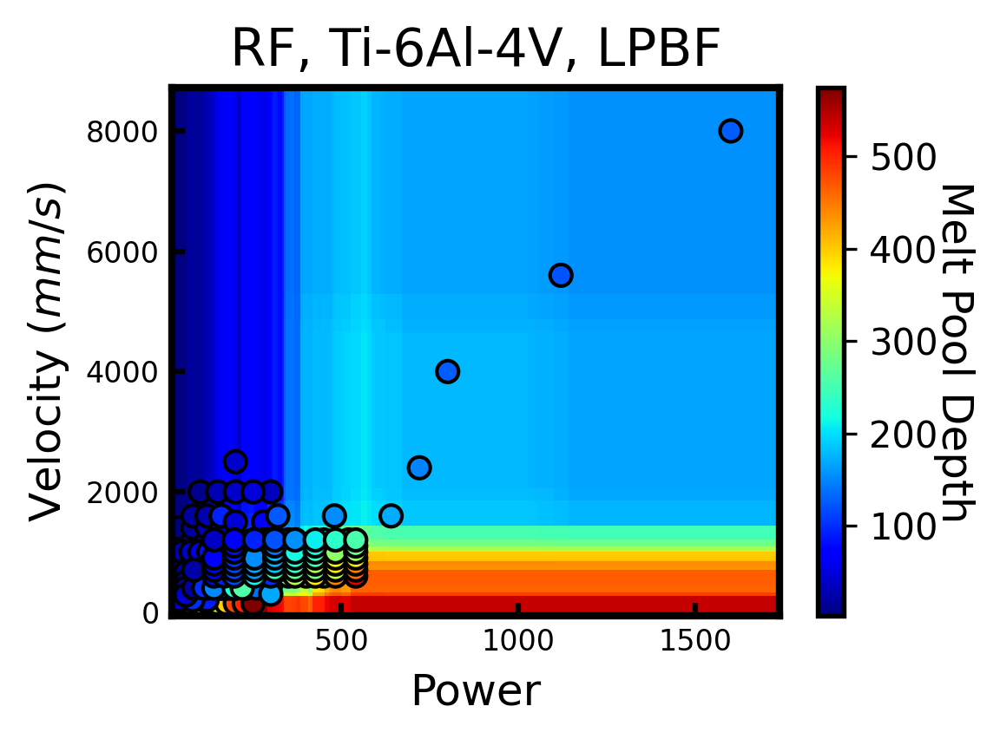

/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:59: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.


<Figure size 432x288 with 0 Axes>

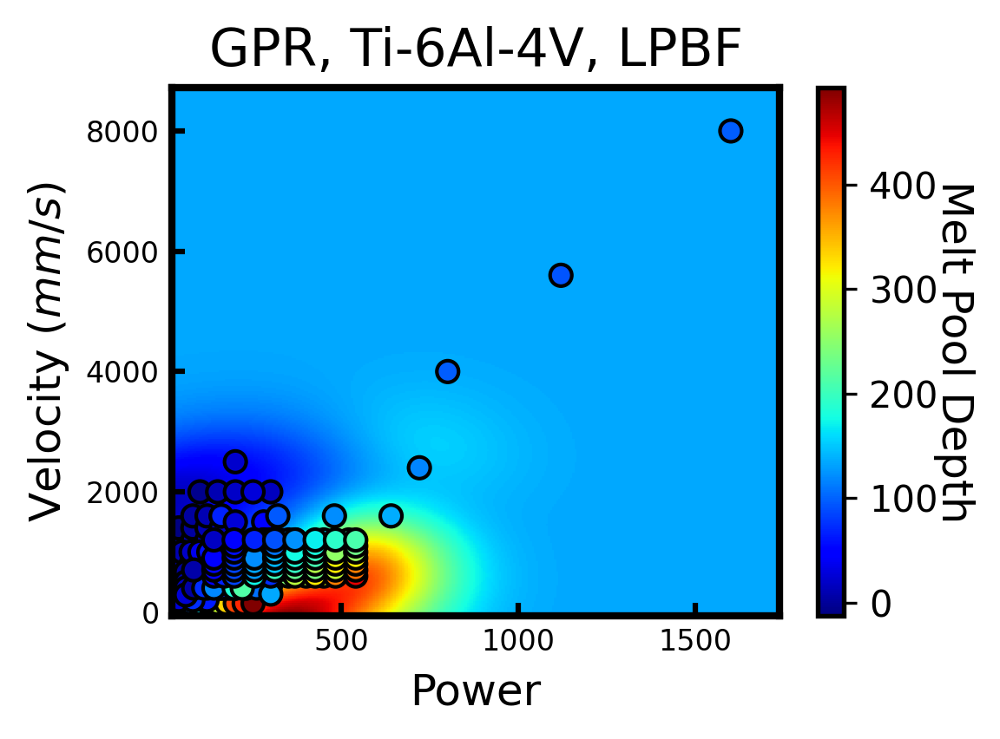

/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:59: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.


<Figure size 432x288 with 0 Axes>

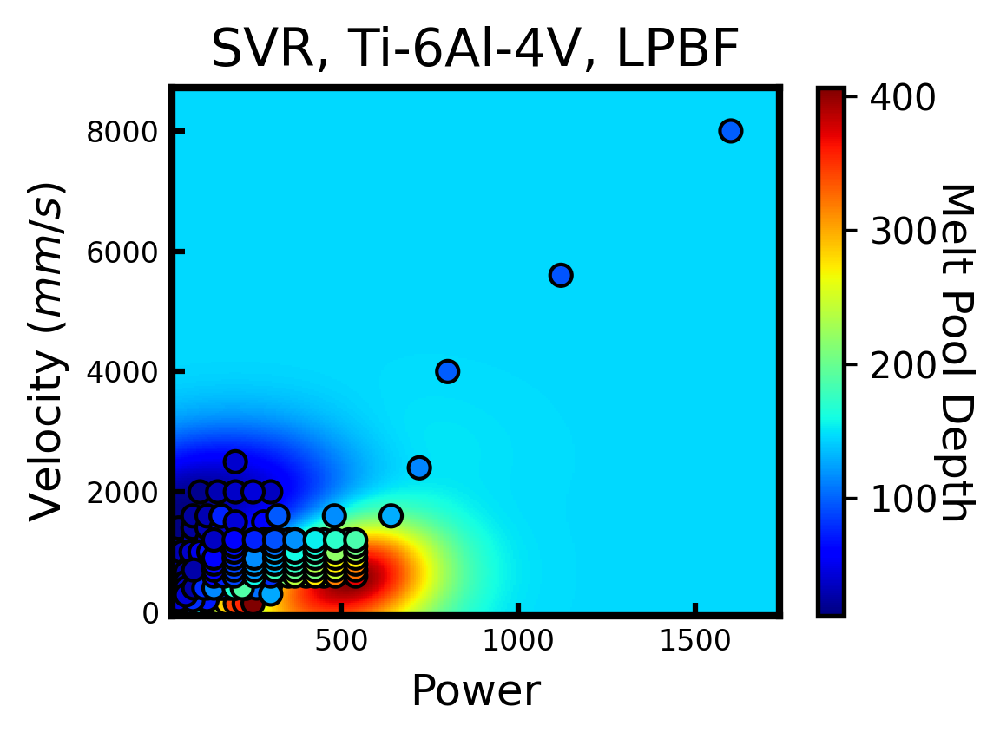

/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:59: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.


<Figure size 432x288 with 0 Axes>

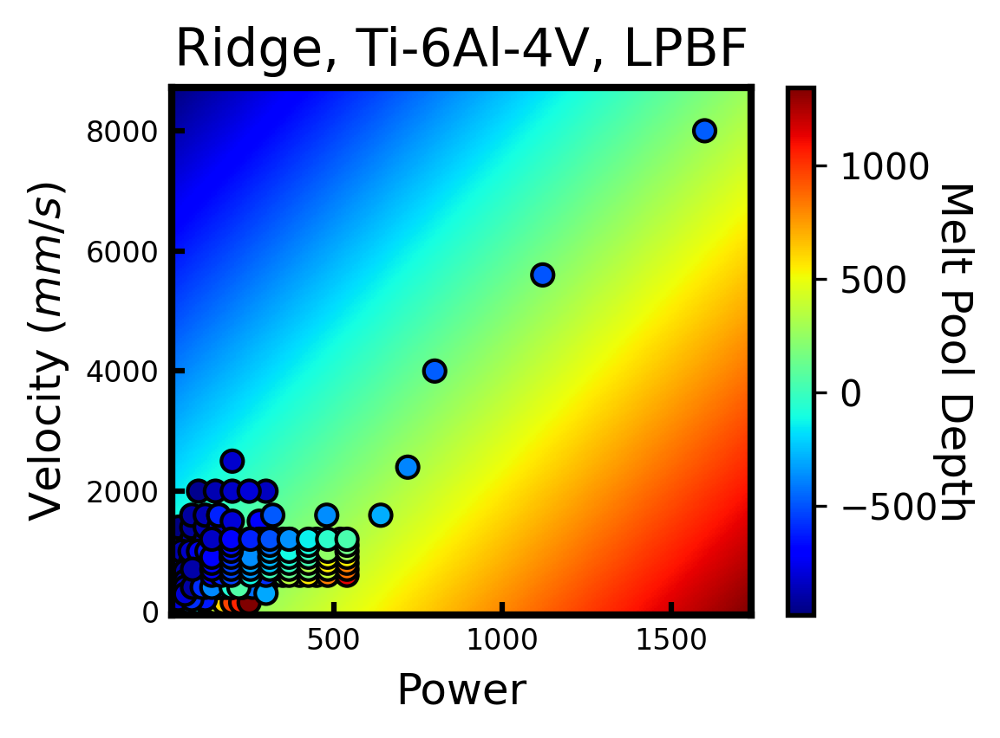

/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:59: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.


<Figure size 432x288 with 0 Axes>

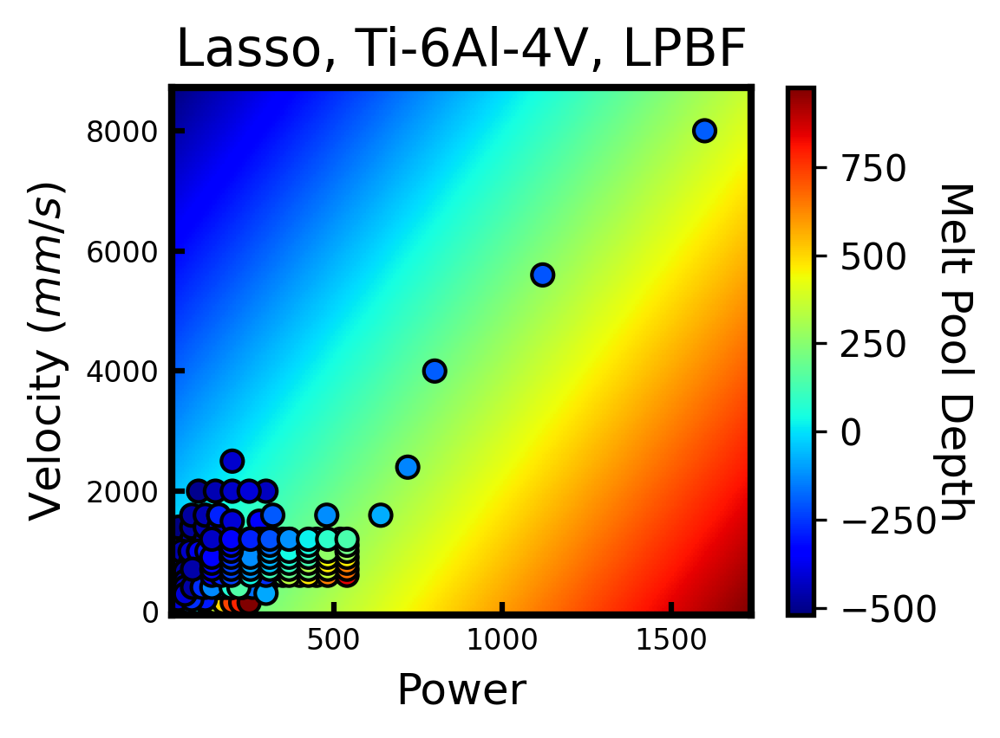

/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:59: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.


<Figure size 432x288 with 0 Axes>

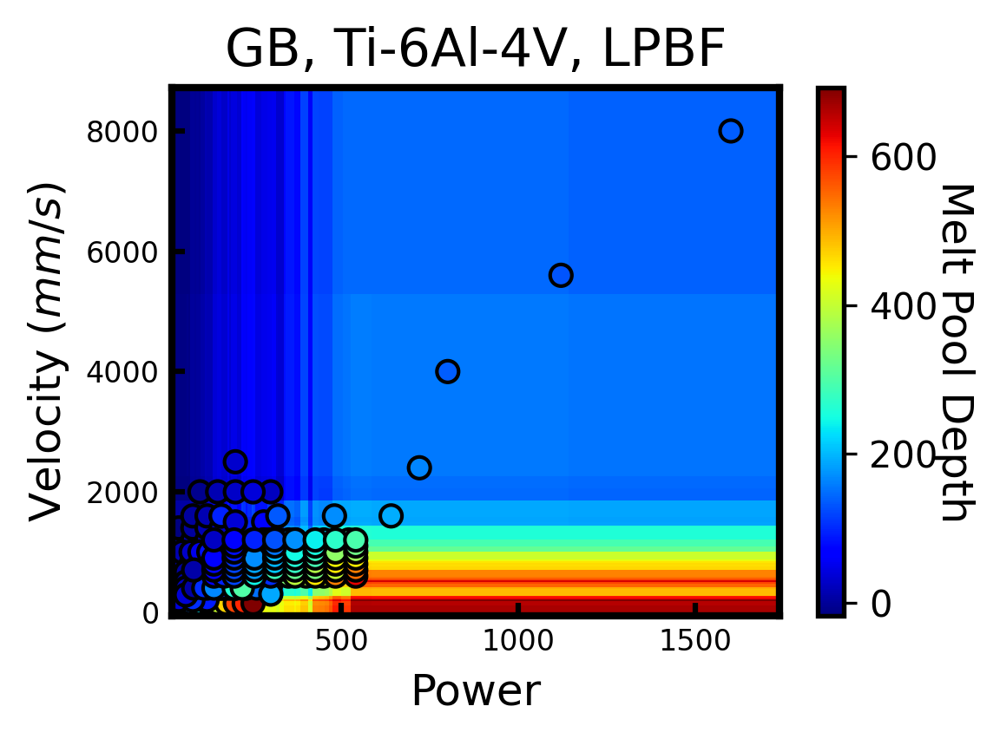

/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:59: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.


<Figure size 432x288 with 0 Axes>

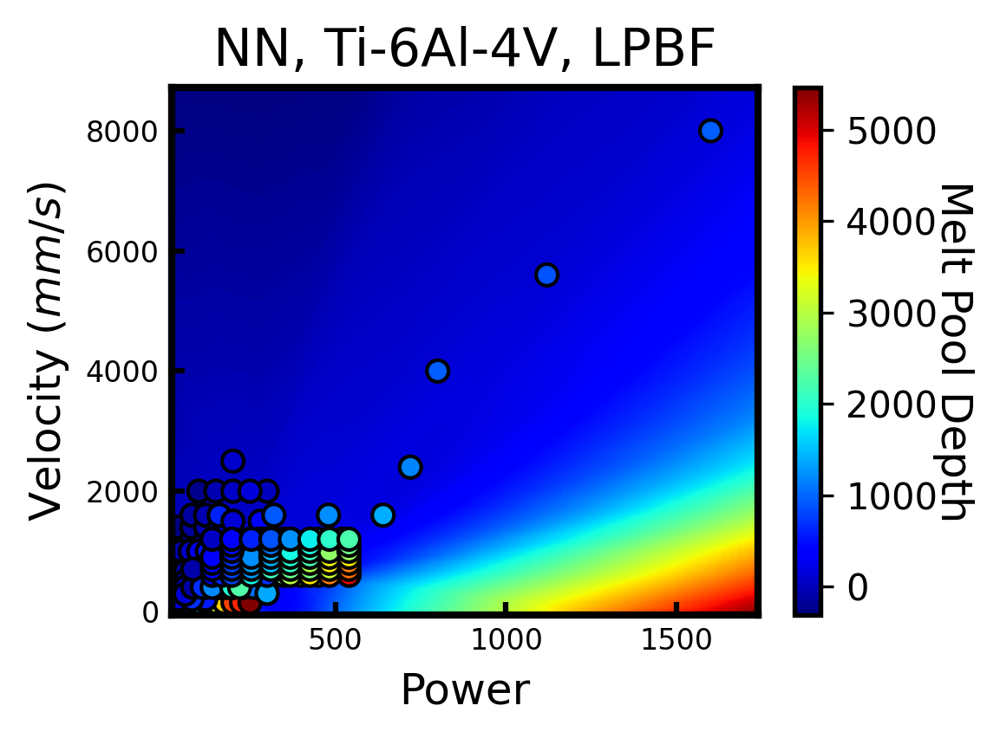

<Figure size 432x288 with 0 Axes>

In [30]:
%matplotlib inline
# Define parameters that models will be trained on and value to be predicted
parameter_list = ['Power', 'Velocity']
label_col = 'depth of meltpool'


# Form dataset array from dataframe, given parameter_list, label_col
# function select_parameters() does this as well
data_list = []
label_list = []
new_csv = select_subset(regressioncsv, 'Sub-process','SLM')

new_csv = select_material(new_csv, 'Ti-6Al-4V')
for i in range(len(new_csv)):
    success, features, label = extract_features(new_csv.iloc[i], parameter_list, label_col)
    if success < 0:
        continue
    else:
        data_list.append(features)
        label_list.append(label)
    
        
X = np.array(np.squeeze(data_list))  

y = np.array(label_list)


fit_models, train_accuracy, train_accuracy_std, test_accuracy, test_accuracy_std  = learn(X.reshape(-1, len(parameter_list)), y, parameters = parameter_list, title = 'SLM')

scaler = StandardScaler()
scaler.fit(X)
X_rescale = scaler.transform(X)
mean = np.mean(y)
std = np.std(y)
ynorm = (y - mean)/std
nx = 300
ny = 300

xs = np.linspace(1.1*np.min(X_rescale[:,0]), 1.1*np.max(X_rescale[:,0]), nx)
ys = np.linspace(1.1*np.min(X_rescale[:,1]), 1.1*np.max(X_rescale[:,1]), ny)

xx, yy = np.meshgrid(xs, ys)
cm_bright = "hsv"
for idx,model in enumerate(fit_models):
    fig = plt.figure(figsize = [4,3], dpi = dpi)
   
    xx, yy = np.meshgrid(xs, ys)
    W = model.predict(np.c_[xx.ravel(), yy.ravel()])
    
    xx_unscaled = scaler.inverse_transform(np.c_[xx.ravel(), yy.ravel()])
    xx = xx_unscaled[:,0].reshape(xx.shape)
    yy = xx_unscaled[:, 1].reshape(yy.shape)
    
    #Z = np.argmax(W, axis = 1)
    Z = W
    
    Z = Z.reshape(xx.shape)
    ax = plt.subplot(111)
    plt.pcolormesh(xx, yy, (Z*std+mean), cmap = 'jet')

    
    cbar = plt.colorbar()
    cbar.ax.set_ylabel('Melt Pool Depth', rotation = 270, labelpad = 10)
    ax.set_xlim(xx.min(), xx.max())
    ax.set_ylim(yy.min(), yy.max())
    plt.title(['RF', 'GPR', 'SVR', 'Ridge', 'Lasso', 'GB', 'NN'][idx] + ', Ti-6Al-4V' + ', LPBF')
    str_model = ['RF', 'GPR', 'SVR', 'Ridge', 'Lasso', 'GB', 'NN'][idx]
    
    
    
    title = 'Ti-6Al-4V_lpbf' + '_decbound'
    plt.xticks(fontsize = 8)
    plt.yticks(fontsize = 8)
    frame_tick()
    plt.ylabel(r'Velocity ($mm/s$)')
    plt.xlabel(r'Power')
    plt.tight_layout()
    #savefig(title+str_model + "nopoints"+".png")
    plt.scatter(X[:,0], X[:, 1], c = y, edgecolor = 'k', cmap = 'jet')
    plt.tight_layout()
    #savefig(title+str_model + "datapoints"+".png")
    plt.show()
    plt.clf()


### Regression task with all inputs

601 length of X
RF  Train R^2: 0.97754 ± 0.00256, Test R^2: 0.84504 ± 0.01915


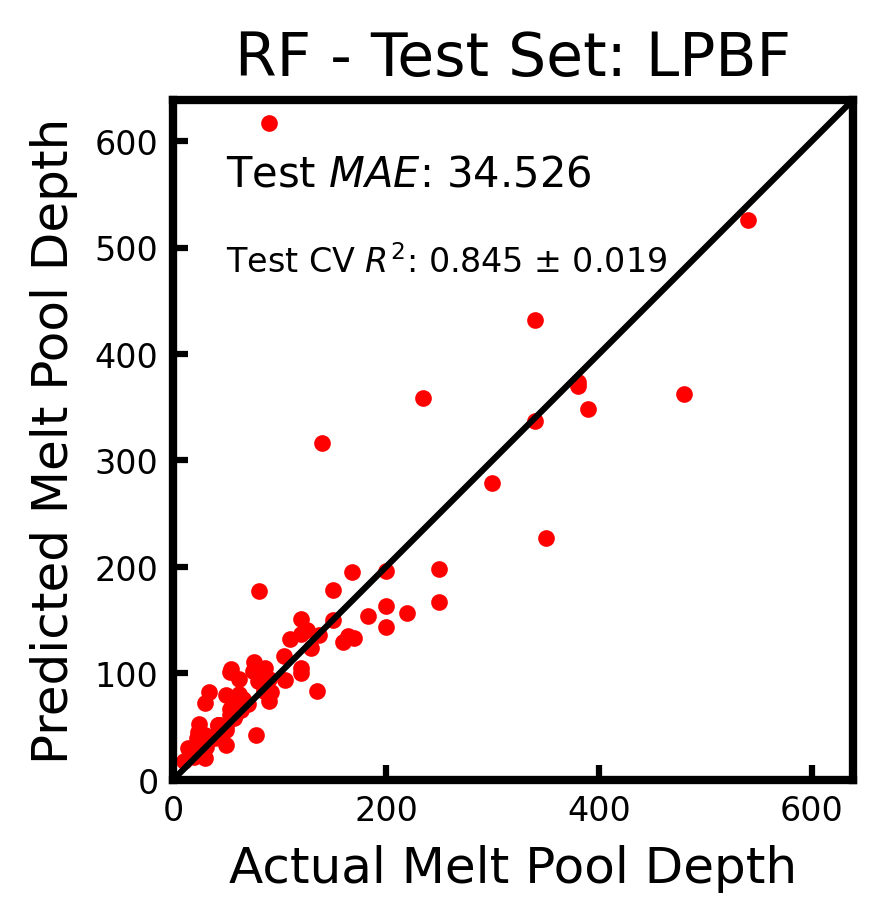

<Figure size 432x288 with 0 Axes>

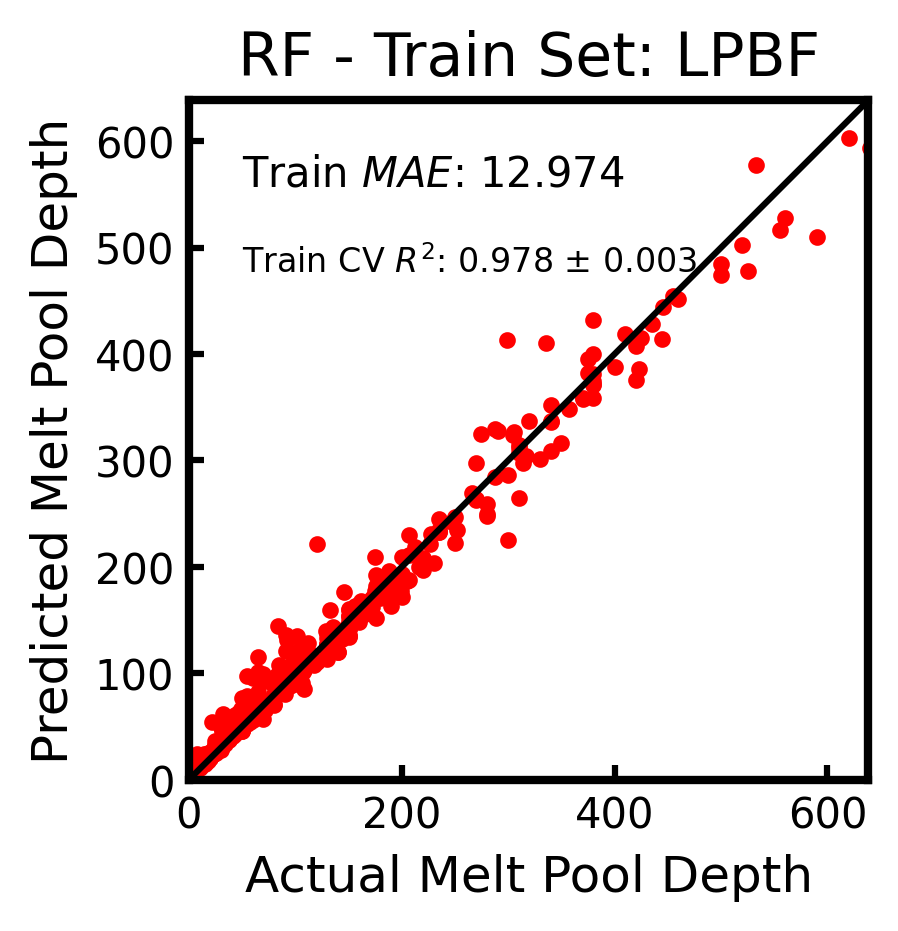

GPR  Train R^2: 0.86053 ± 0.00350, Test R^2: 0.80835 ± 0.02536


<Figure size 432x288 with 0 Axes>

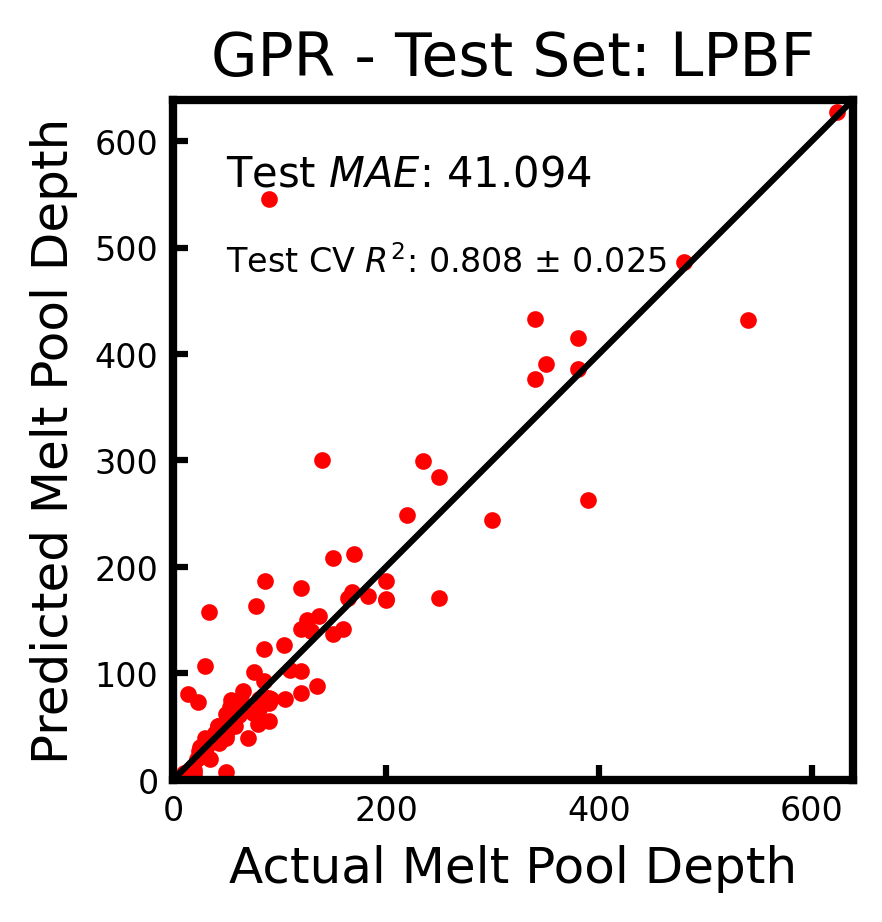

<Figure size 432x288 with 0 Axes>

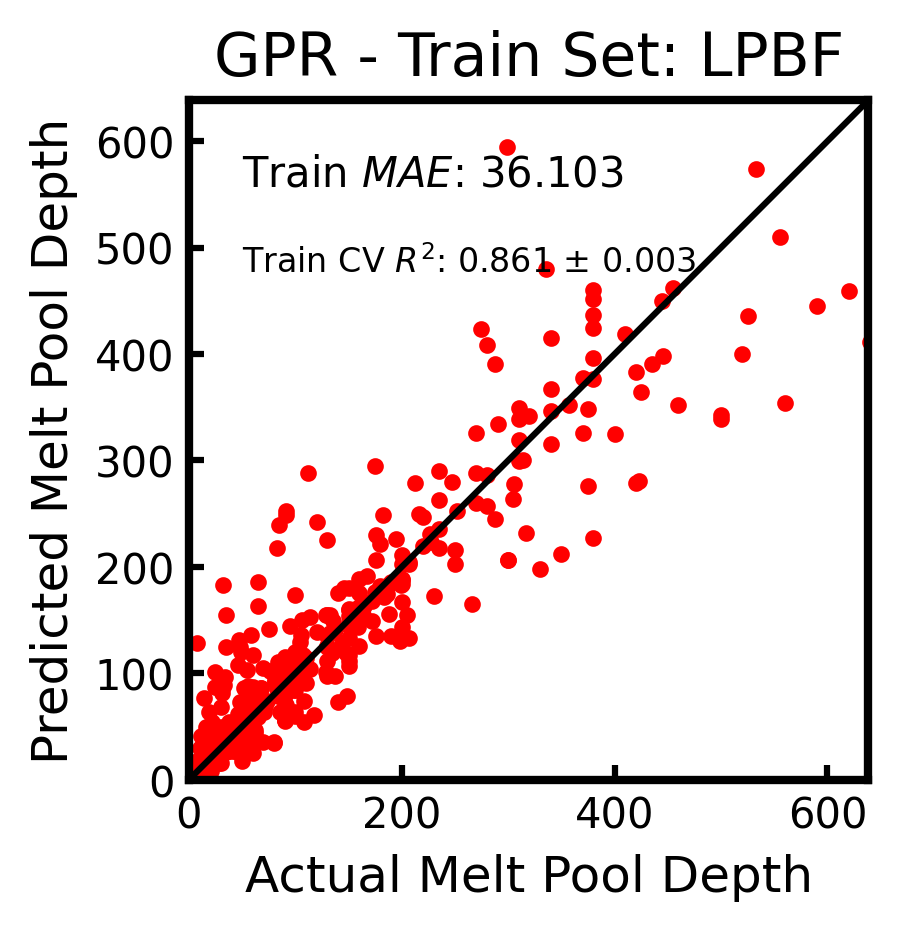

SVR  Train R^2: 0.75870 ± 0.01207, Test R^2: 0.72712 ± 0.04119


<Figure size 432x288 with 0 Axes>

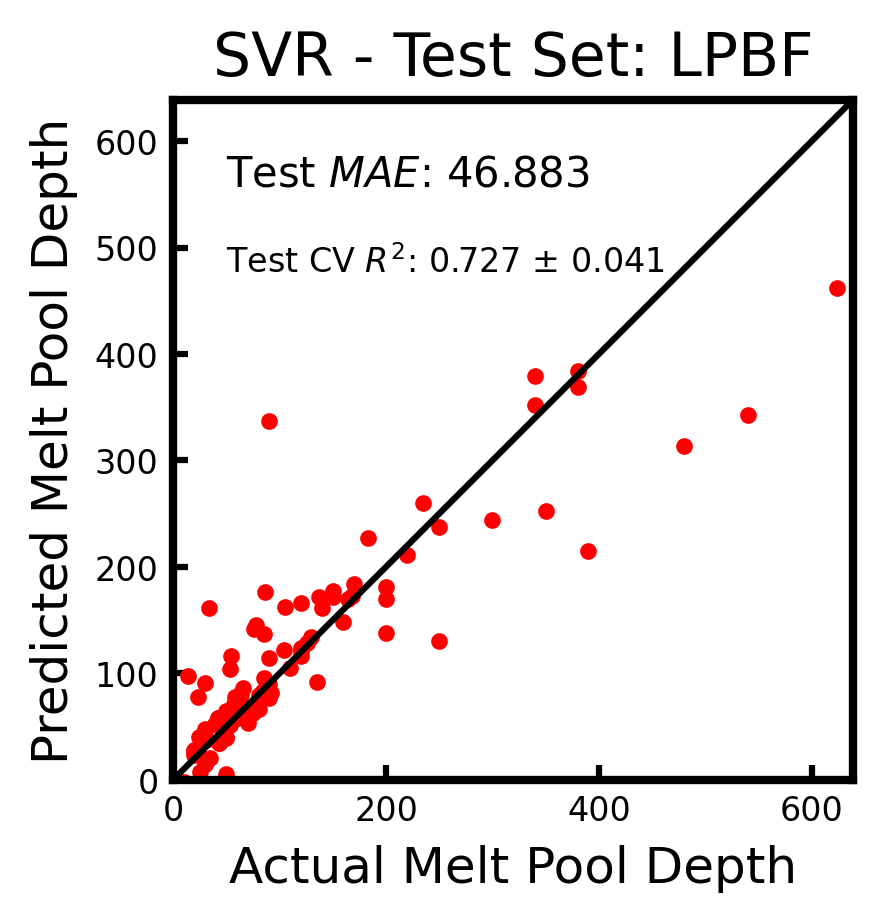

<Figure size 432x288 with 0 Axes>

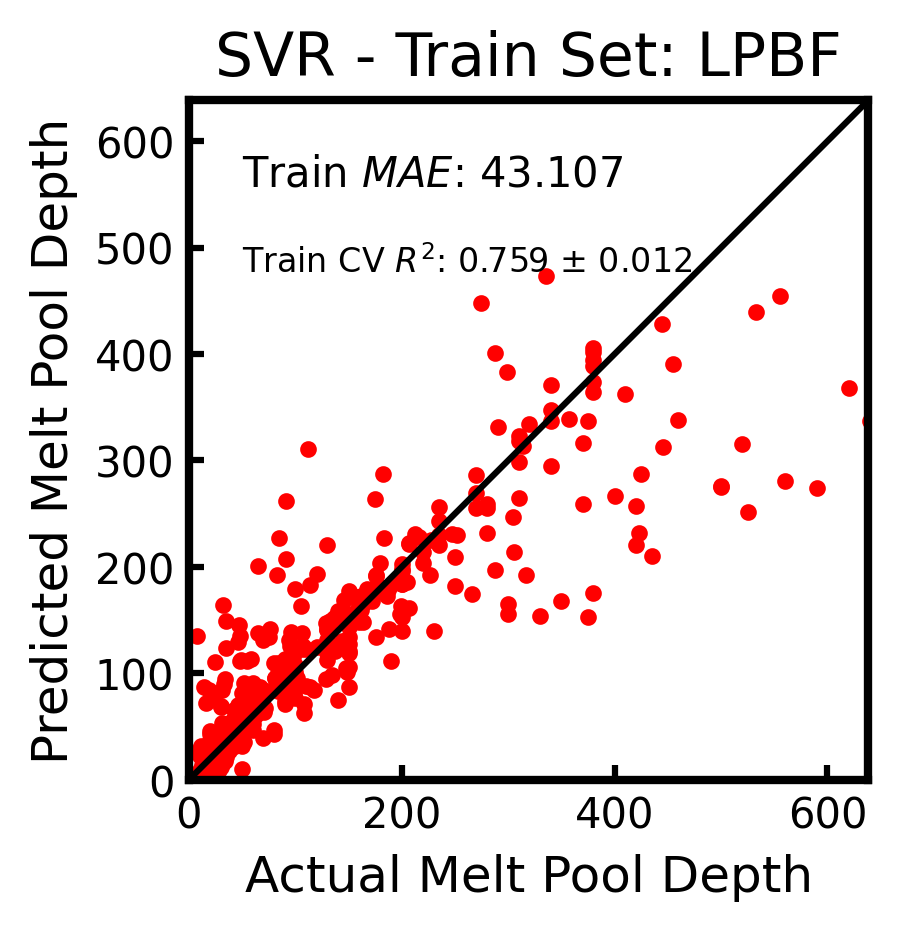

Ridge  Train R^2: 0.62372 ± 0.00876, Test R^2: 0.57147 ± 0.04983


<Figure size 432x288 with 0 Axes>

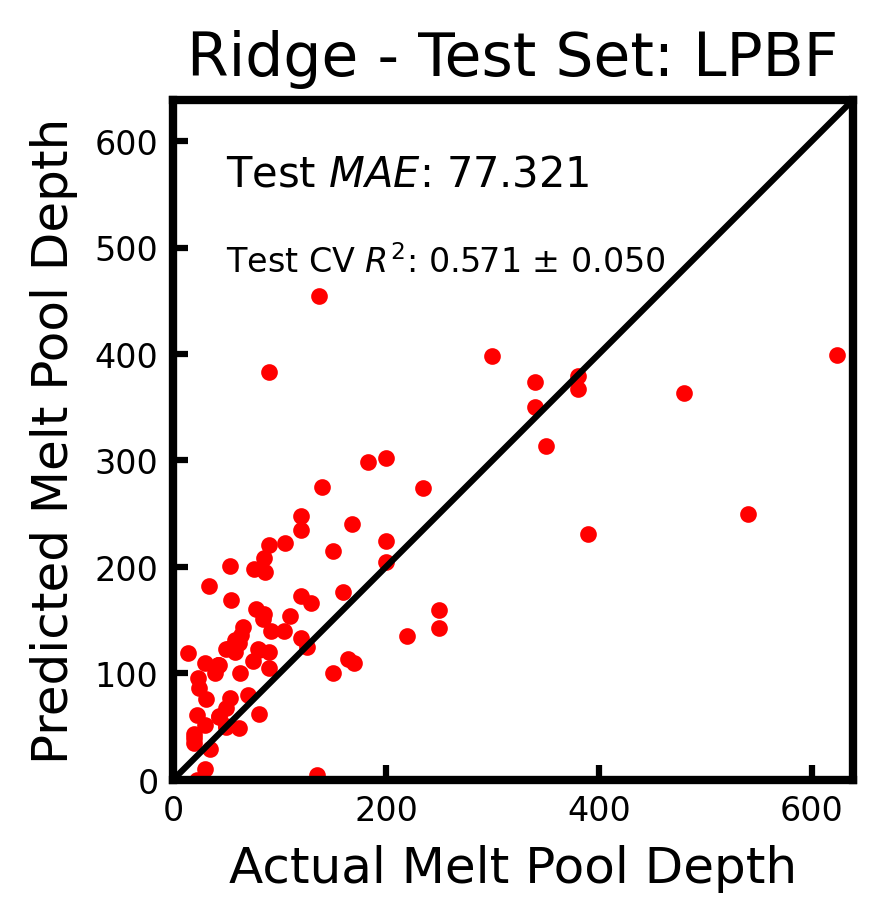

<Figure size 432x288 with 0 Axes>

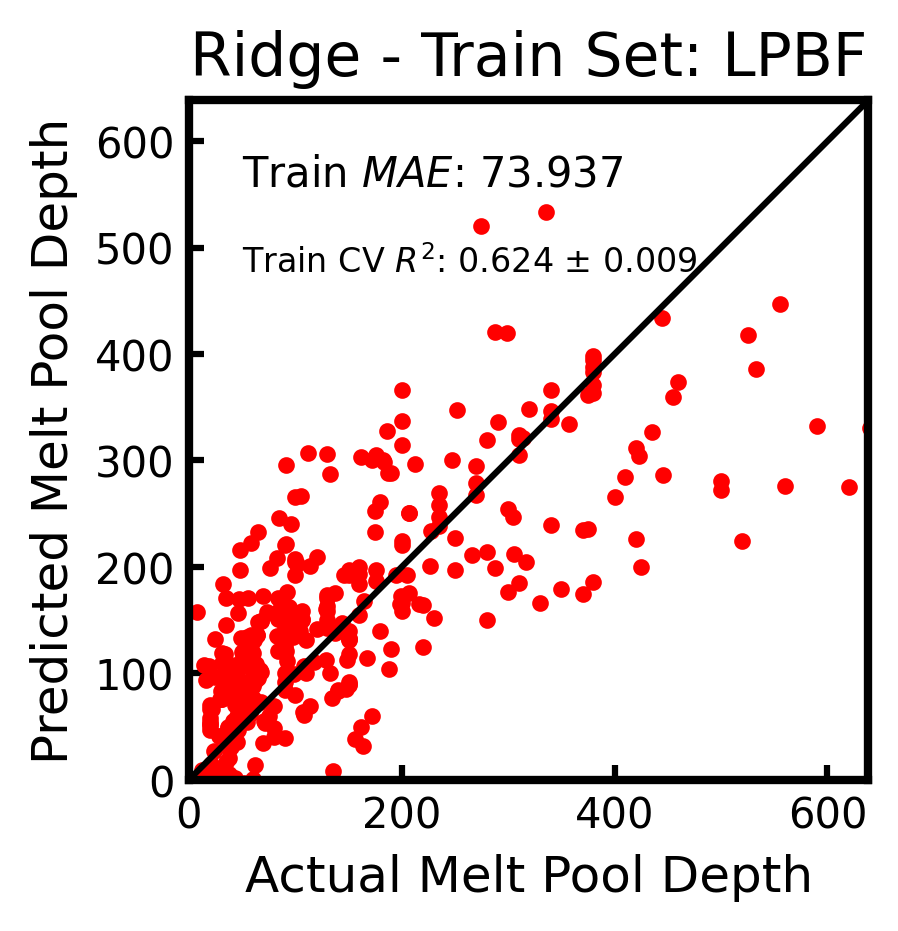

Lasso  Train R^2: 0.48139 ± 0.01014, Test R^2: 0.46866 ± 0.04517


<Figure size 432x288 with 0 Axes>

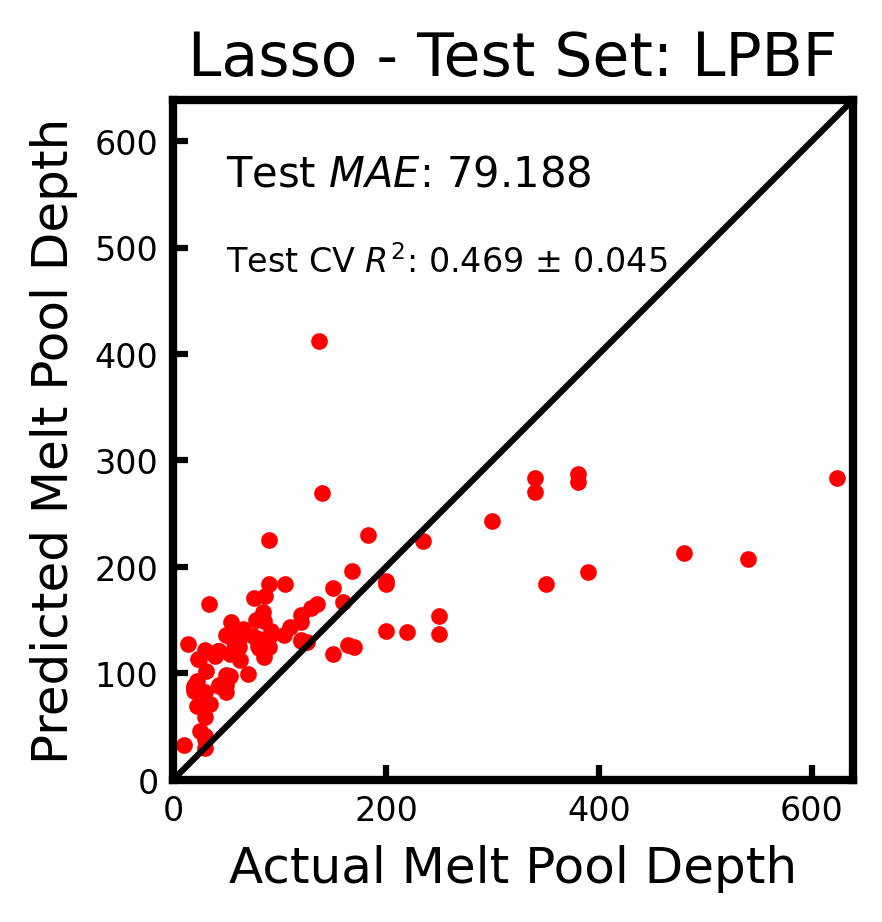

<Figure size 432x288 with 0 Axes>

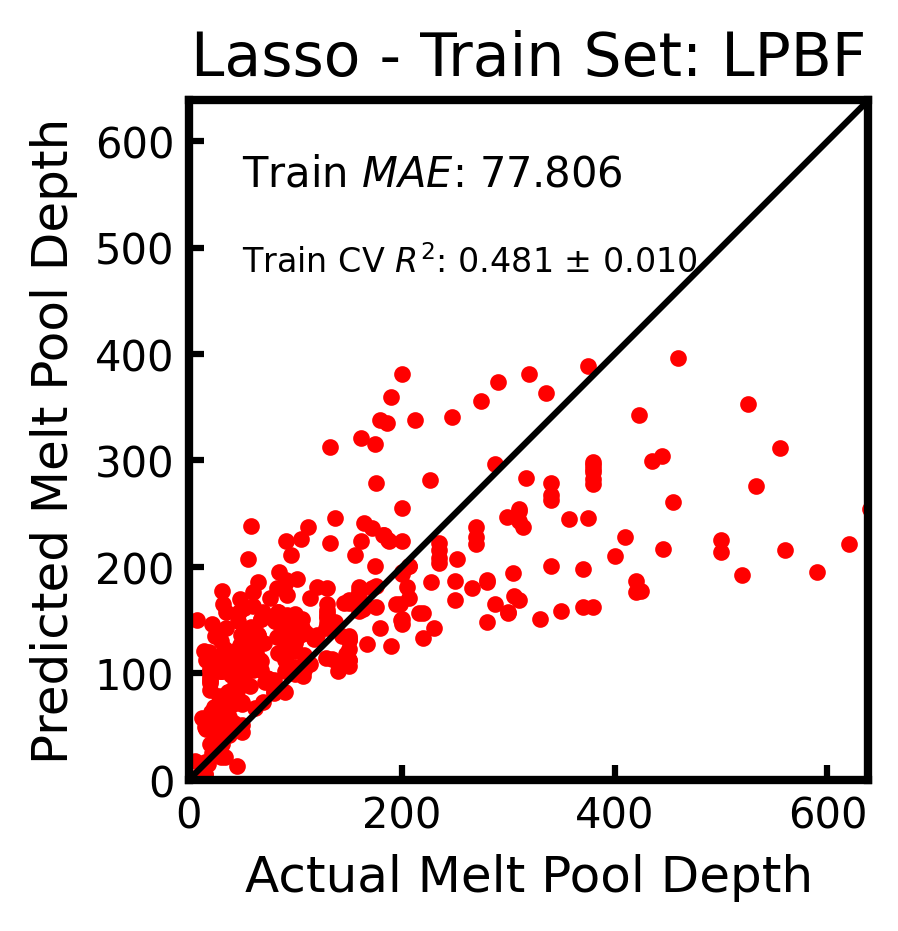

GB  Train R^2: 0.96730 ± 0.00306, Test R^2: 0.83538 ± 0.04224


<Figure size 432x288 with 0 Axes>

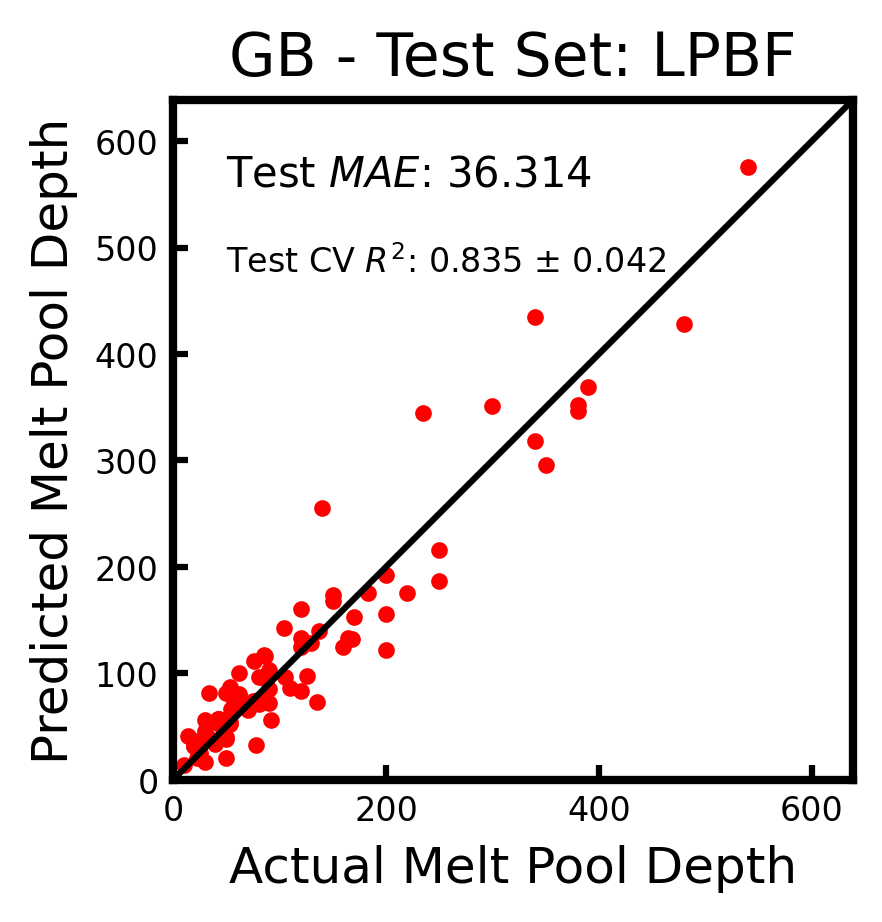

<Figure size 432x288 with 0 Axes>

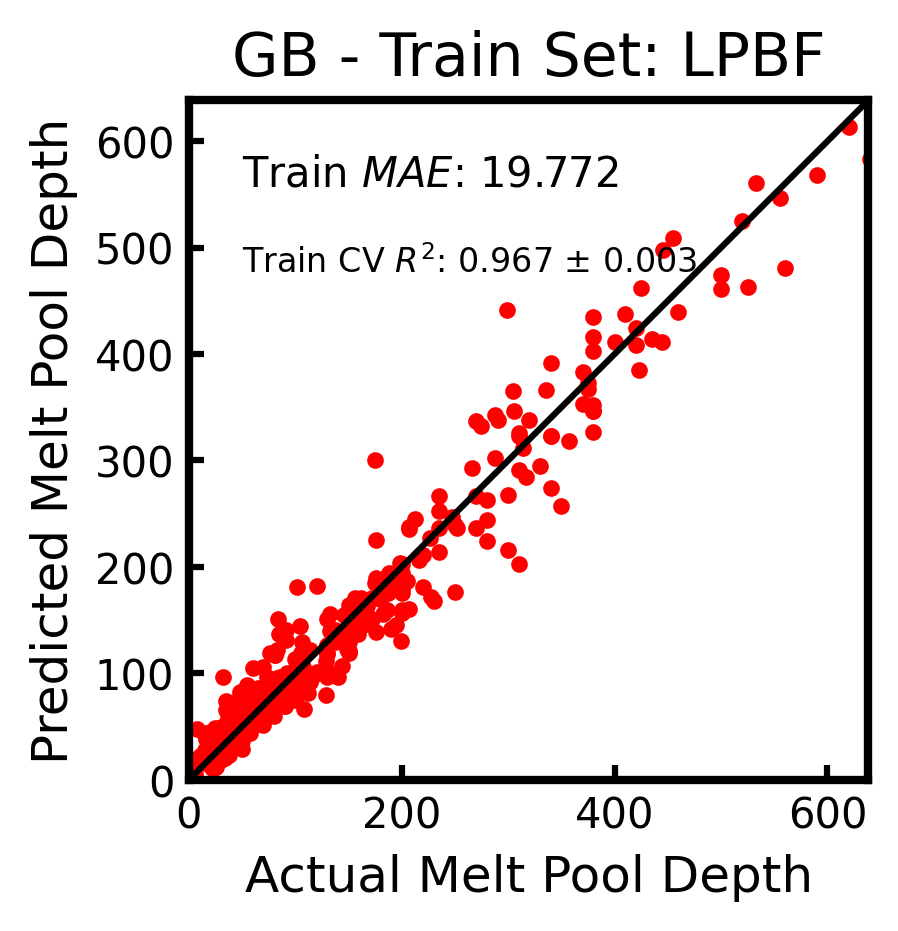

NN  Train R^2: 0.95329 ± 0.01304, Test R^2: 0.86818 ± 0.02725


<Figure size 432x288 with 0 Axes>

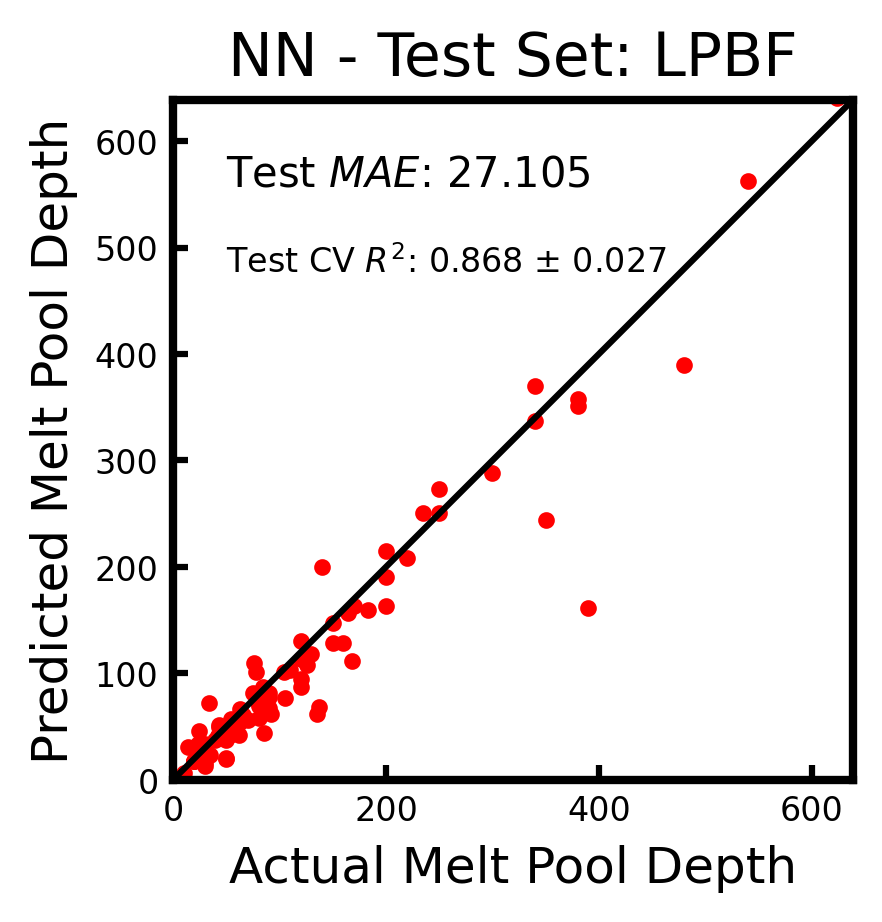

<Figure size 432x288 with 0 Axes>

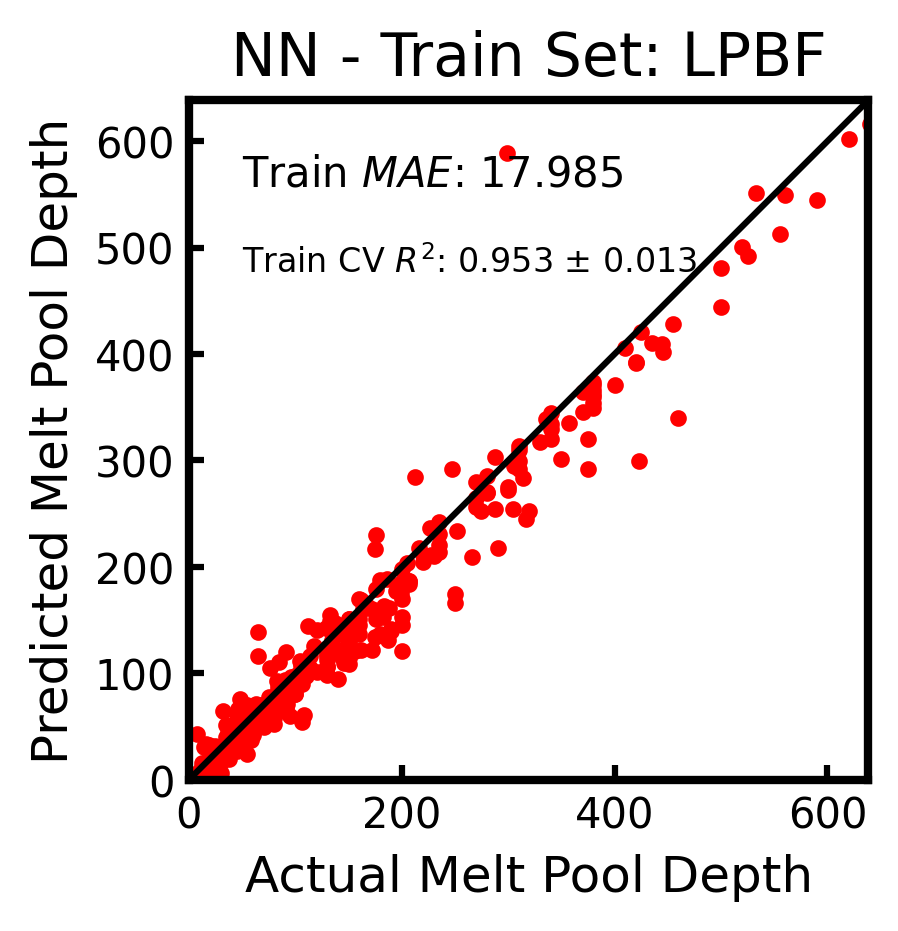

<Figure size 432x288 with 0 Axes>

In [31]:
%matplotlib inline
# Define parameters that models will be trained on and value to be predicted

parameter_list = ['Power', 'Velocity', 'density', 'Cp', 'k' , 'beam D', 'melting T' , 'layer thickness', 'absorption coefficient']
label_col = 'depth of meltpool'

# Form dataset array from dataframe, given parameter_list, label_col
# function select_parameters() does this as well

data_list = []
label_list = []

new_csv = select_subset(regressioncsv, 'Sub-process','SLM')
materials_present = []

for i in range(len(new_csv)):
    success, features, label = extract_features(new_csv.iloc[i], parameter_list, label_col)
    #breakpoint()
    if success < 0 or  new_csv['paper ID'].iloc[i] in [34]:
        
        continue
    else:
        
        data_list.append(features)
        label_list.append(label)
        materials_present.append(new_csv['Material'].iloc[i])
    materials_ohe = [np.zeros(len(materials_present)) for key in materials.keys()]
    len(materials_ohe)
    materials_ohe = np.array(materials_ohe).T
    material_pos = np.arange(len(materials.keys()))
    
    for idx in range(len(materials_present)):
        for j_idx in range(len(material_pos)):
            if materials_present[idx] == materials.keys()[j_idx]:

                materials_ohe[idx,j_idx] = 1 
X = np.array(np.squeeze(data_list))  

y = np.array(label_list)
print(len(X), 'length of X')

fit_models, train_accuracy, train_accuracy_std, test_accuracy, test_accuracy_std  = learn(X.reshape(-1, len(parameter_list)), y, parameters = parameter_list, plot = True, title = 'LPBF')



### Adding in One Hot Encoding to dataset

RF  Train R^2: 0.97758 ± 0.00267, Test R^2: 0.84550 ± 0.01837


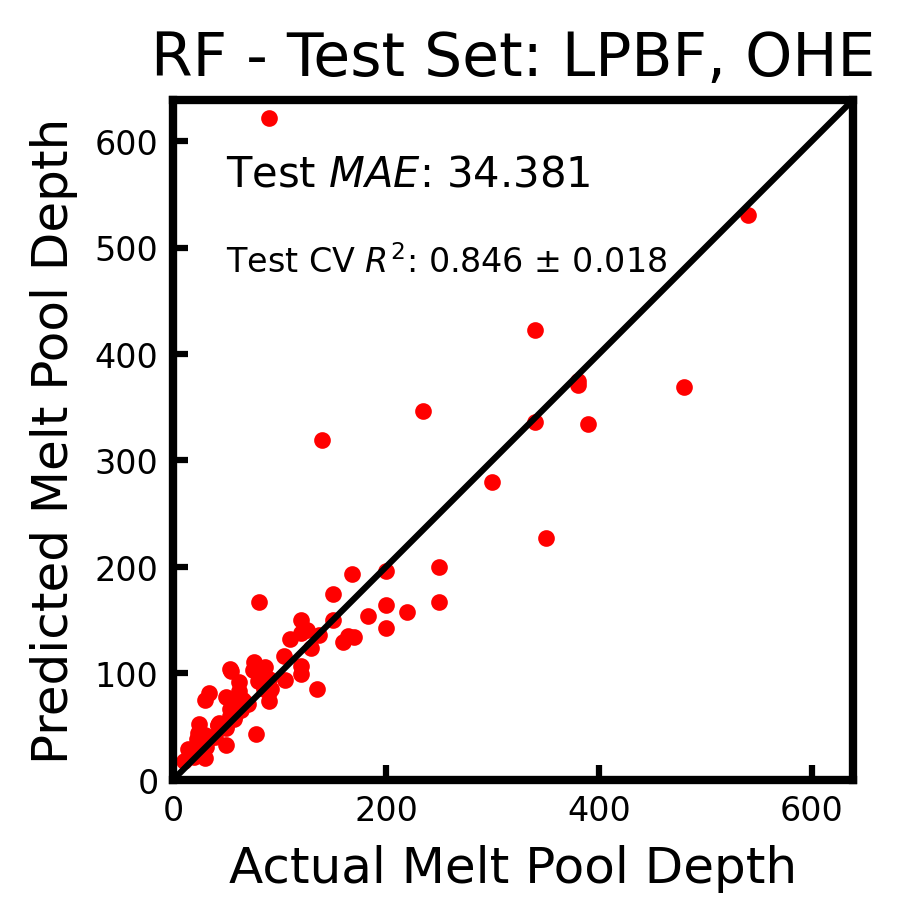

<Figure size 432x288 with 0 Axes>

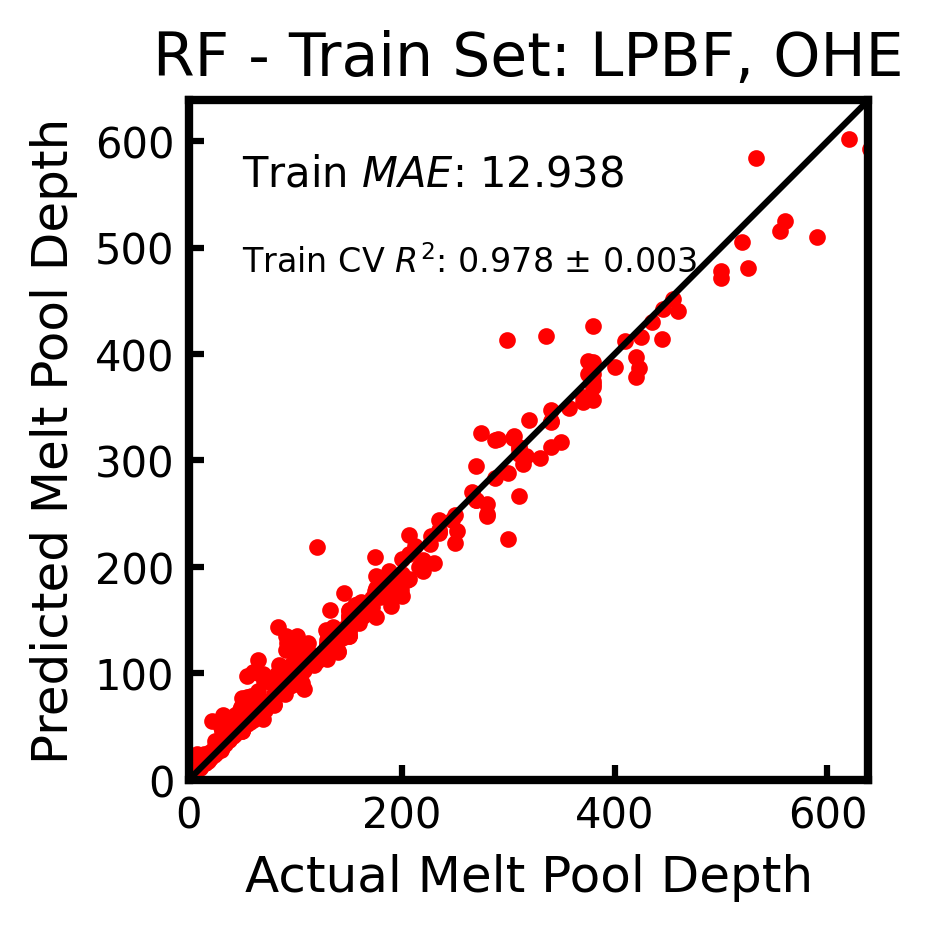

GPR  Train R^2: 0.85721 ± 0.00363, Test R^2: 0.80521 ± 0.02344


<Figure size 432x288 with 0 Axes>

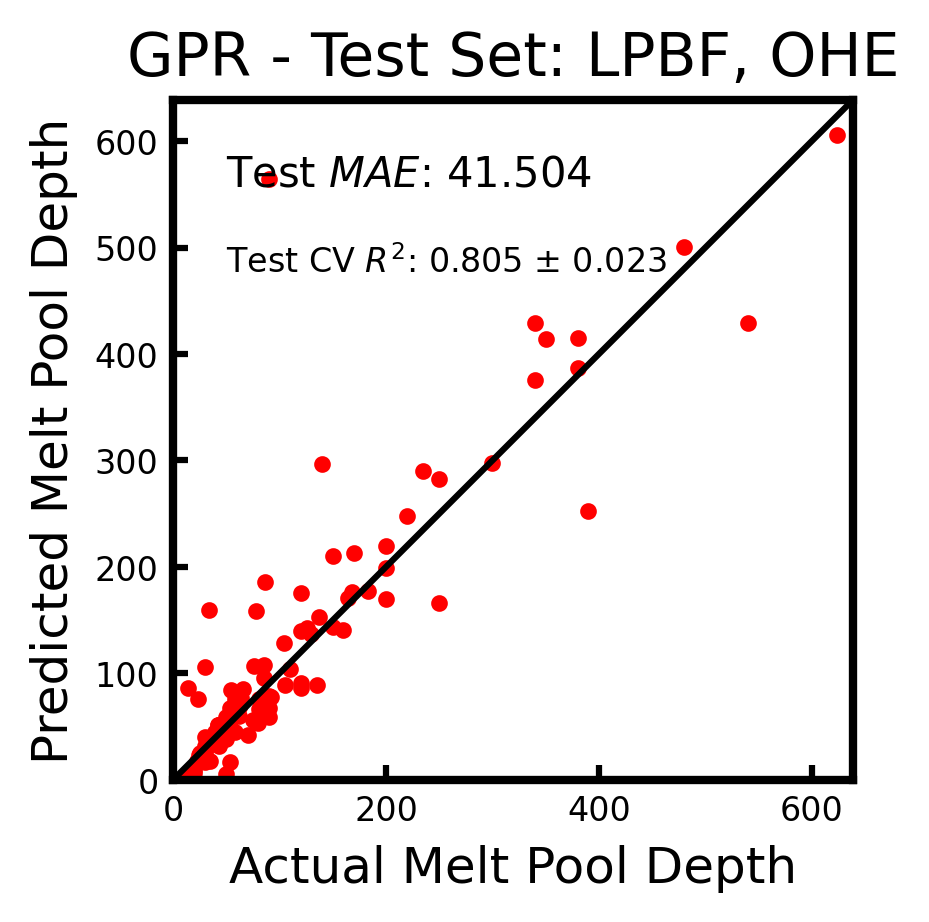

<Figure size 432x288 with 0 Axes>

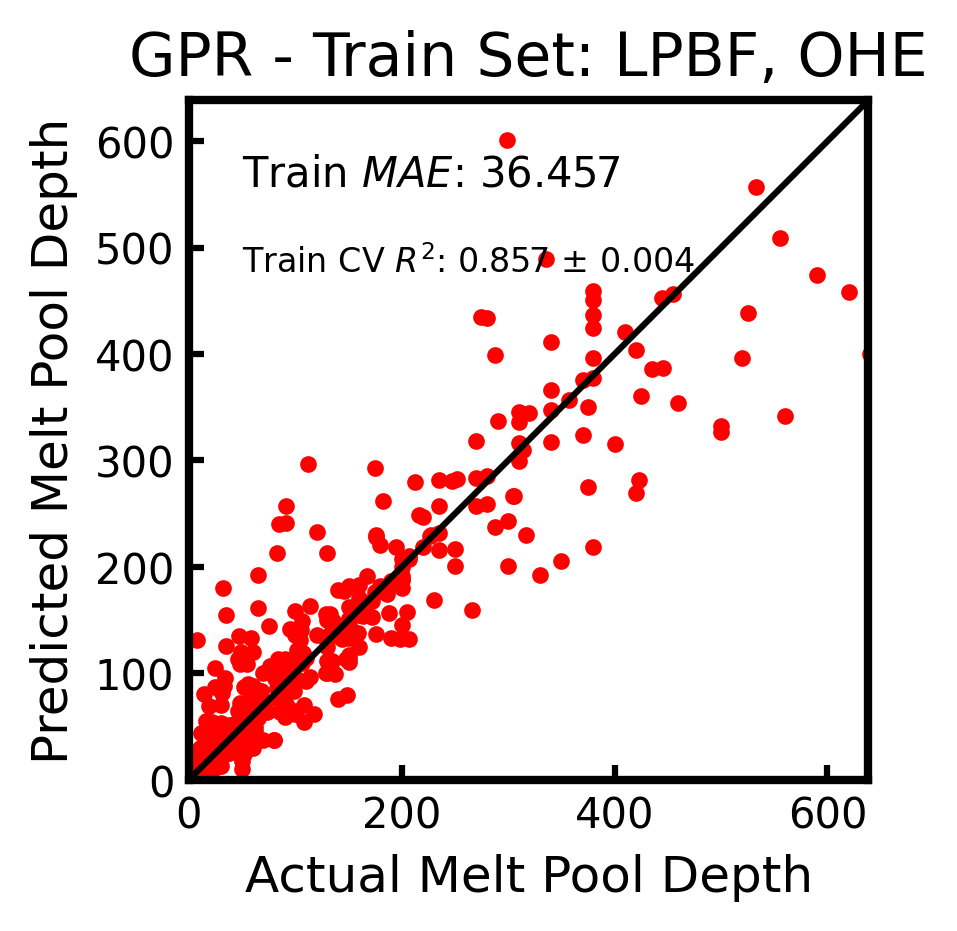

SVR  Train R^2: 0.75599 ± 0.01246, Test R^2: 0.72908 ± 0.04262


<Figure size 432x288 with 0 Axes>

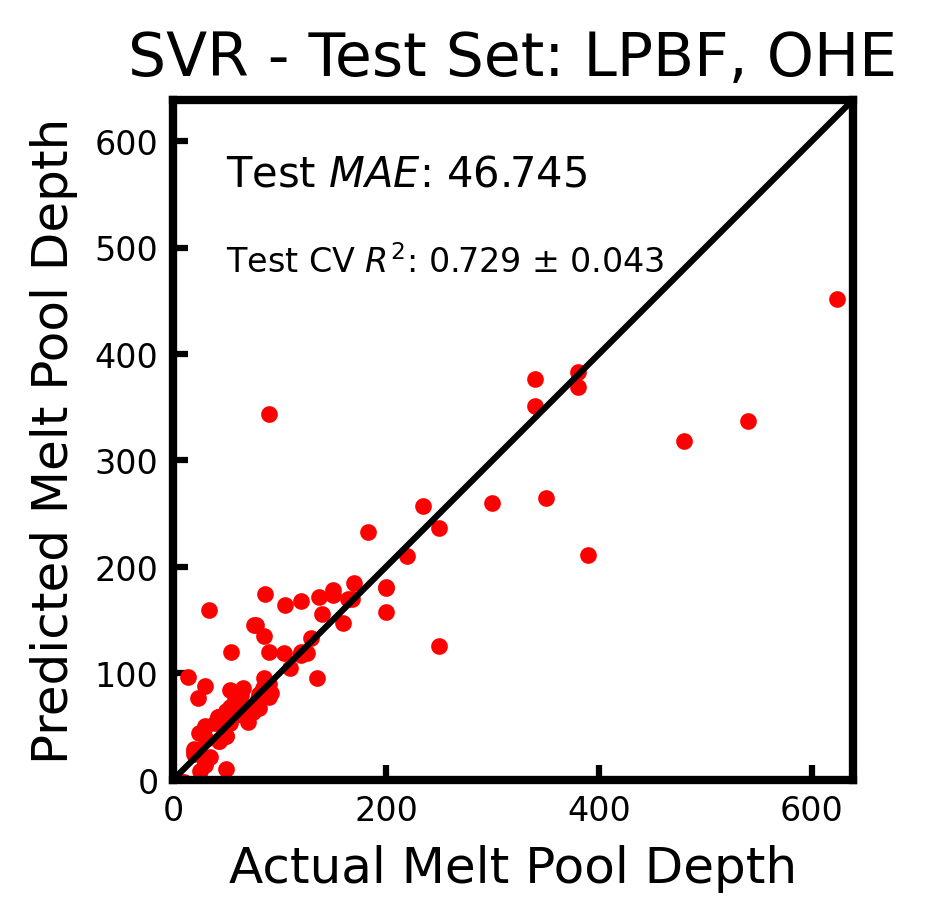

<Figure size 432x288 with 0 Axes>

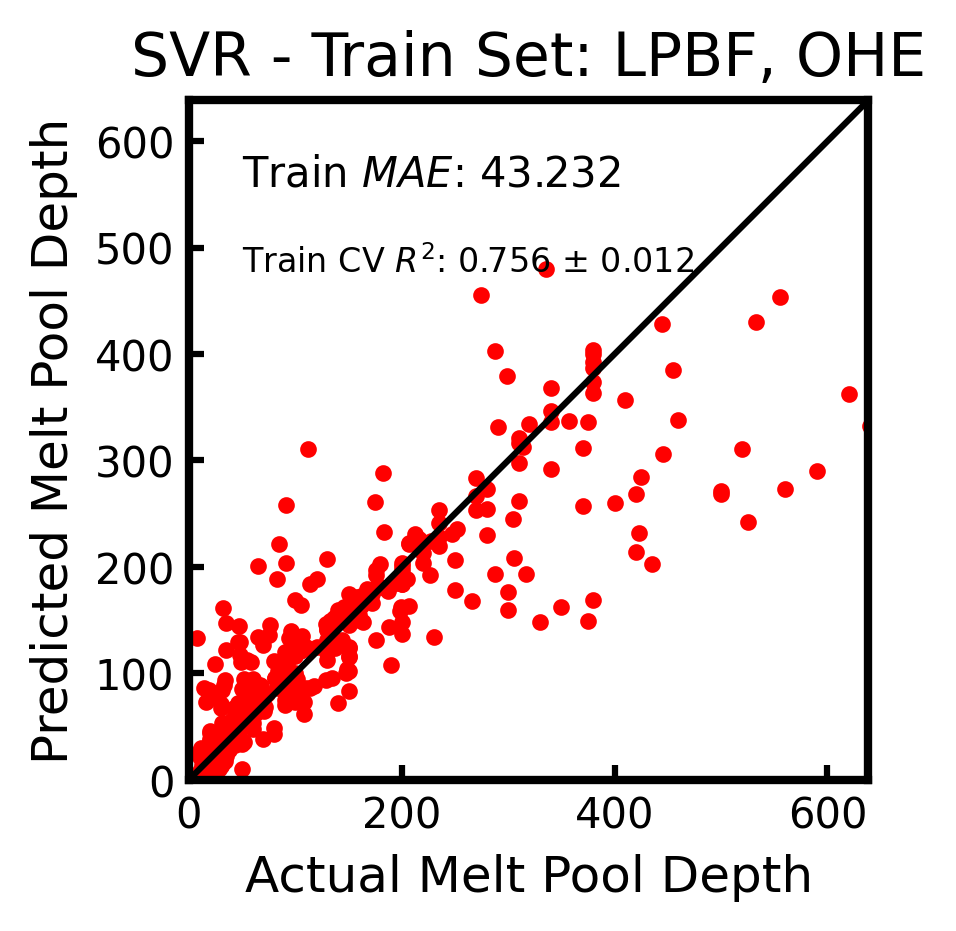

Ridge  Train R^2: 0.62674 ± 0.00916, Test R^2: 0.57393 ± 0.05313


<Figure size 432x288 with 0 Axes>

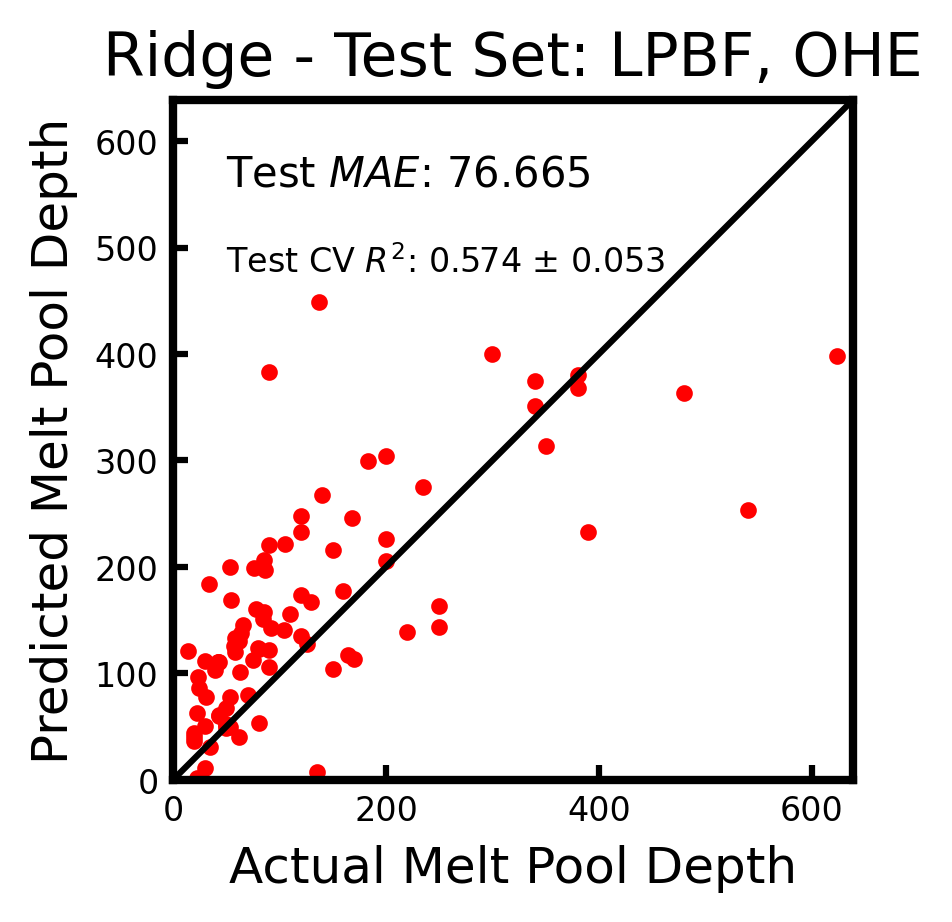

<Figure size 432x288 with 0 Axes>

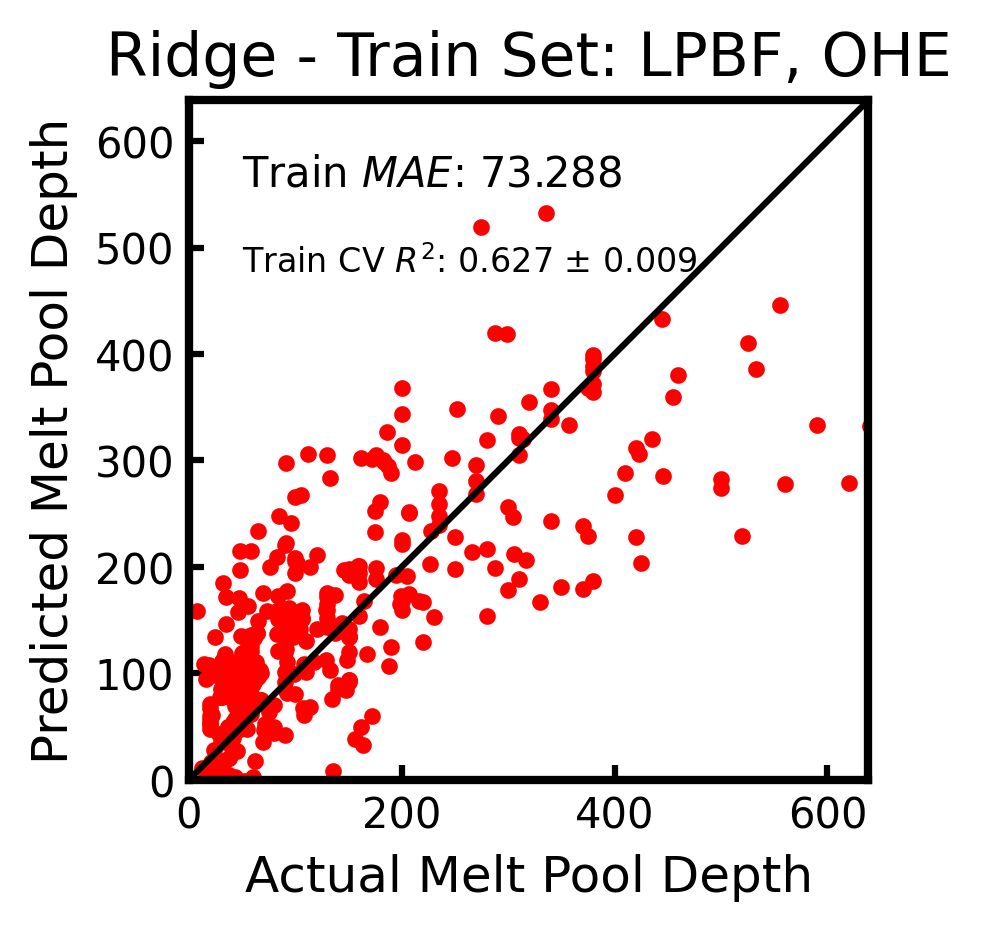

Lasso  Train R^2: 0.48139 ± 0.01014, Test R^2: 0.46866 ± 0.04517


<Figure size 432x288 with 0 Axes>

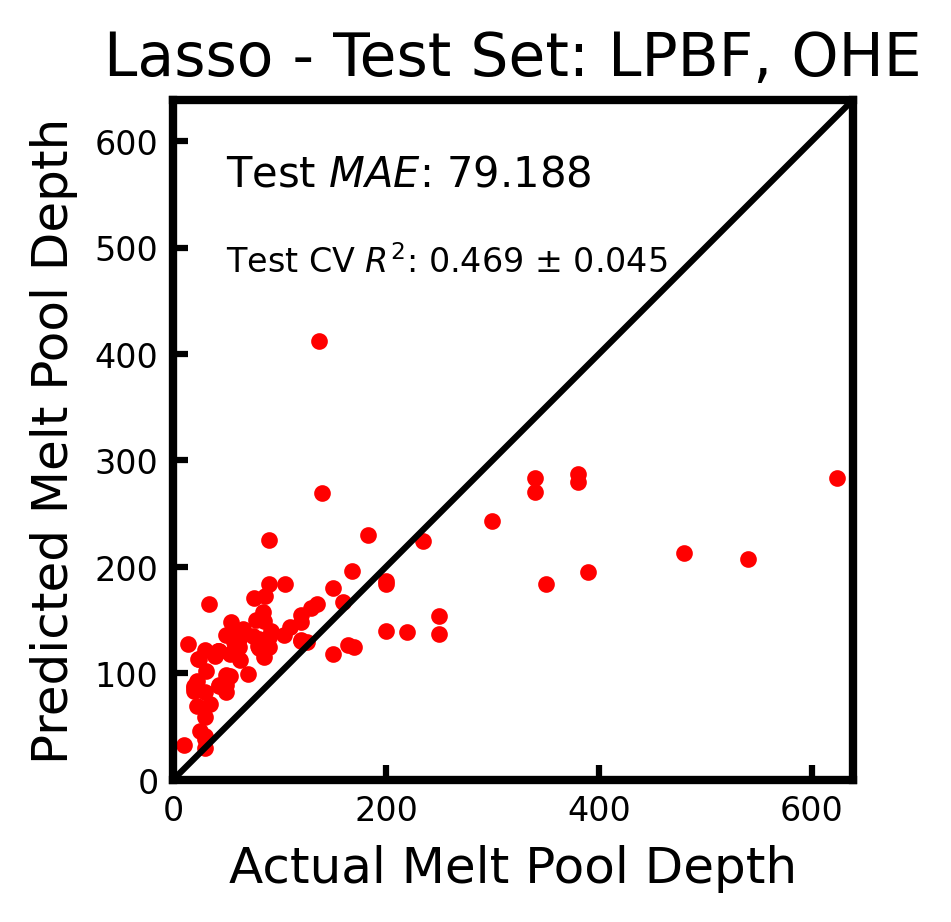

<Figure size 432x288 with 0 Axes>

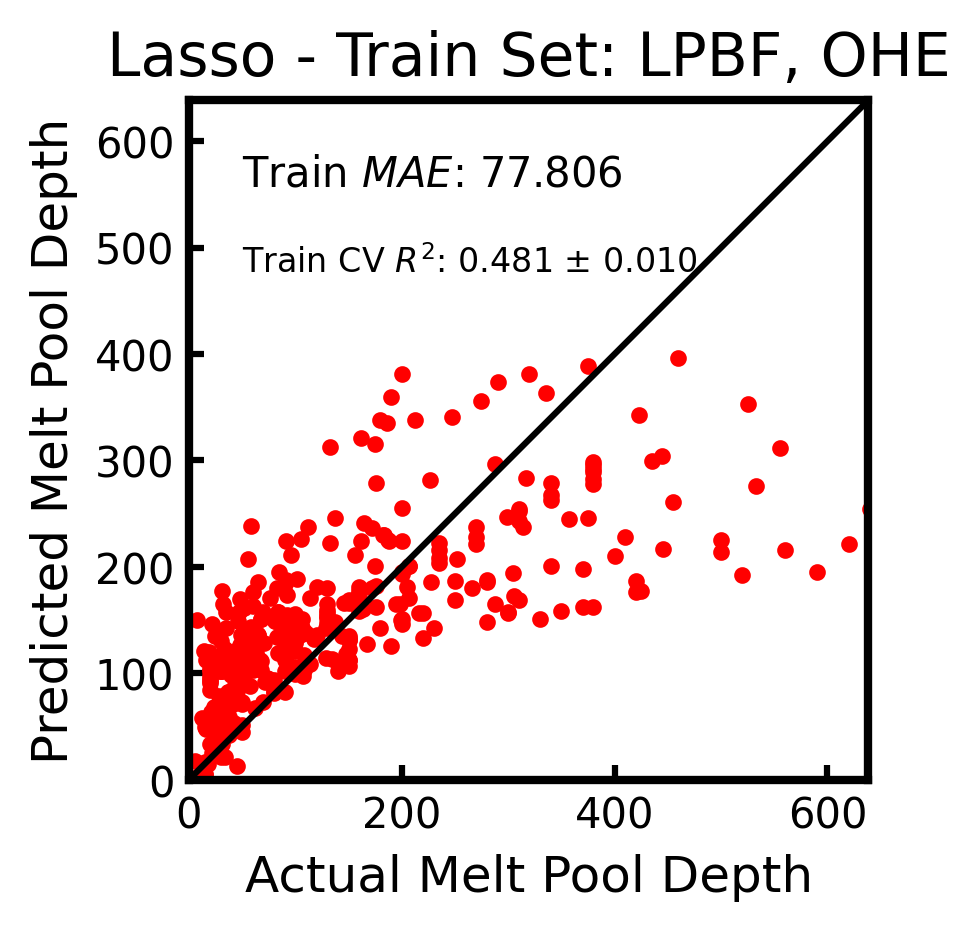

GB  Train R^2: 0.96549 ± 0.00430, Test R^2: 0.83361 ± 0.04557


<Figure size 432x288 with 0 Axes>

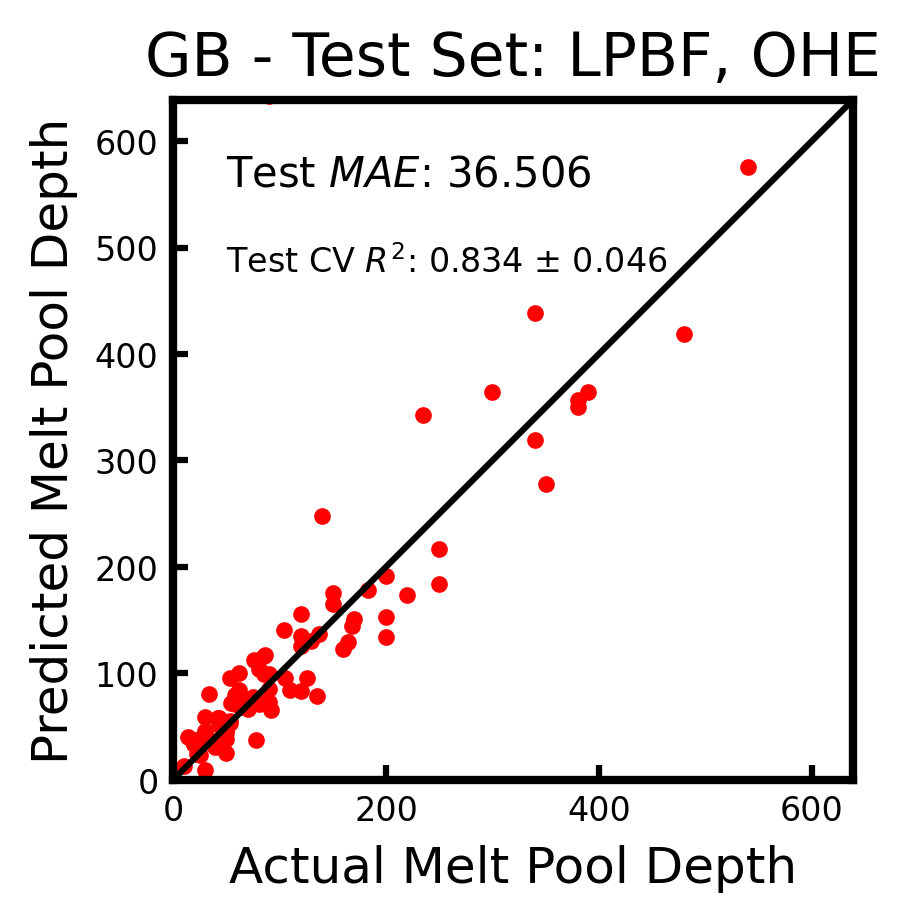

<Figure size 432x288 with 0 Axes>

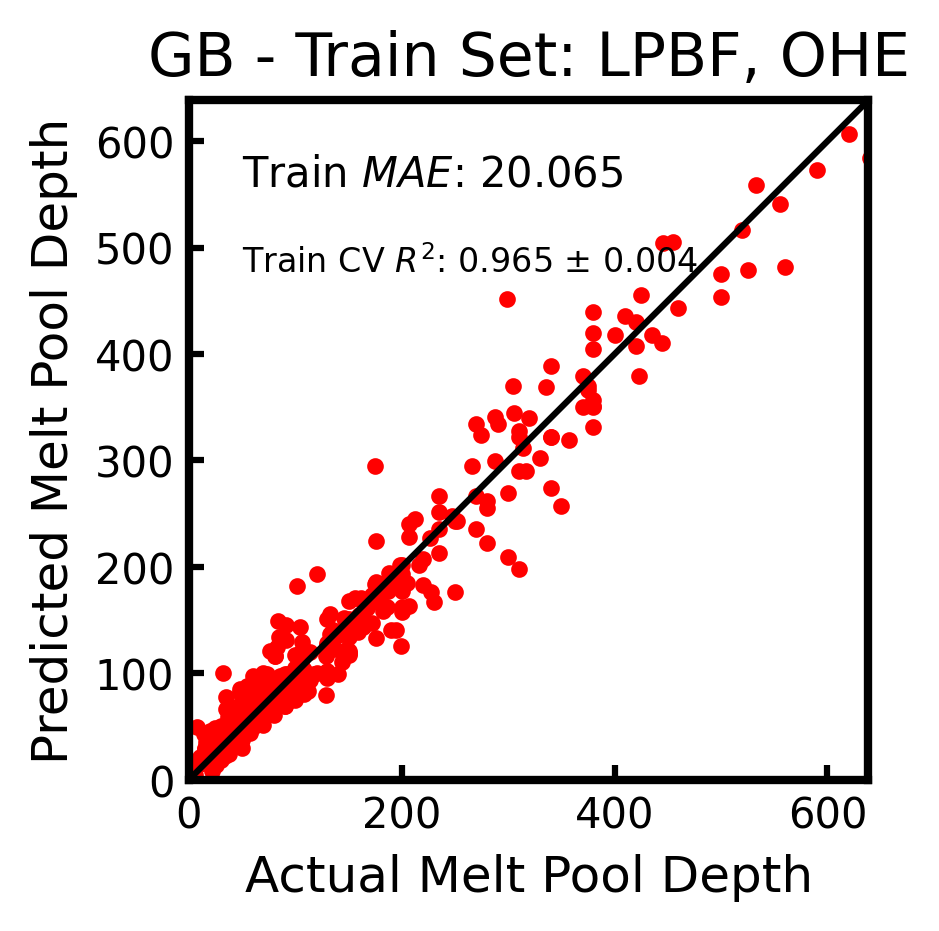

NN  Train R^2: 0.94773 ± 0.01300, Test R^2: 0.87065 ± 0.01733


<Figure size 432x288 with 0 Axes>

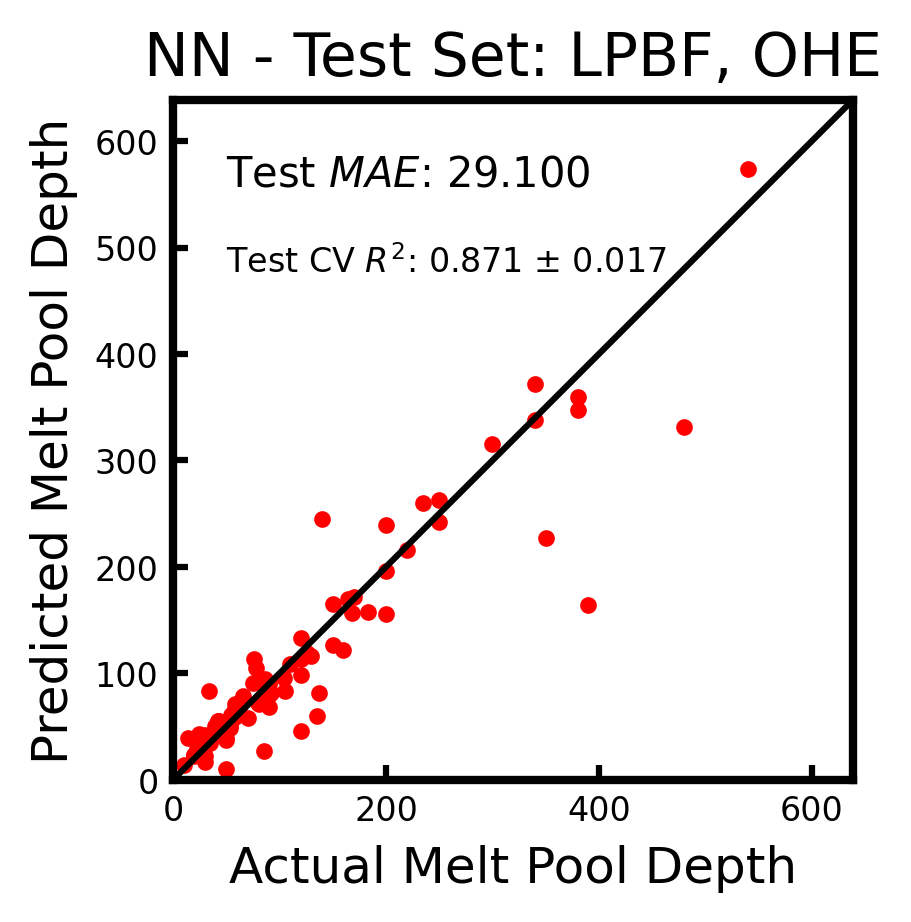

<Figure size 432x288 with 0 Axes>

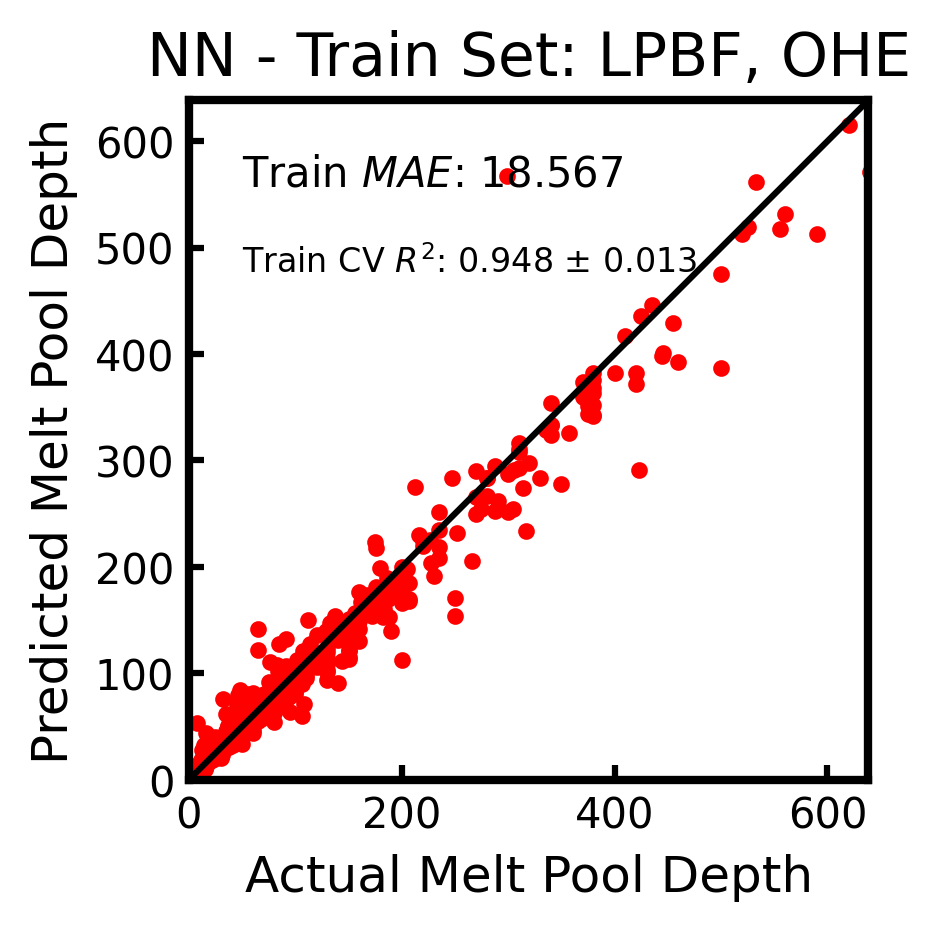

<Figure size 432x288 with 0 Axes>

In [32]:
%matplotlib inline
# Define parameters that models will be trained on and value to be predicted

parameter_list = ['Power', 'Velocity', 'density', 'Cp', 'k' , 'beam D', 'melting T', 'layer thickness', 'absorption coefficient']#, 'absorption coefficent 2
label_col = 'depth of meltpool'



# Form dataset array from dataframe, given parameter_list, label_col
# function select_parameters() does this as well

data_list = []
label_list = []
materials_present = []
new_csv = select_subset(regressioncsv, 'Sub-process','SLM')

for i in range(len(new_csv)):
    success, features, label = extract_features(new_csv.iloc[i], parameter_list, label_col)
    if success < 0:
        continue
    else:
        data_list.append(features)
        label_list.append(label)
        materials_present.append(new_csv['Material'].iloc[i])
        

# Add one hot encoding of materials to the dataset  

materials_ohe = [np.zeros(len(materials_present)) for key in materials.keys()]
materials_ohe = np.array(materials_ohe).T

material_pos = np.arange(len(materials.keys()))
for idx in range(len(materials_present)):
    for j_idx in range(len(material_pos)):
        if materials_present[idx] == materials.keys()[j_idx]:
            
            materials_ohe[idx,j_idx] = 1 

    
        
X = np.array(np.squeeze(data_list))  

y = np.array(label_list)

fit_models, train_accuracy_ohe, train_accuracy_std_ohe, test_accuracy_ohe, test_accuracy_std_ohe  = learn(X.reshape(-1, len(parameter_list)), y, parameters = parameter_list, plot = True, title = 'LPBF, OHE', materials_ohe = materials_ohe)


 ### Including atomic features and One-Hot Encoding: Regression (to-do)

12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
94
95
96
97
98
99
100
101
138
140
141
142
145
182
183
184
185
186
187
188
189
190
191
192
193
194
195
260
261
262
263
264
265
271
272
273
274
275
276
277
278
279
280
281
282
283
284
285
286
287
288
289
290
291
292
293
294
295
296
297
298
299
300
301
302
303
304
305
306
307
308
309
310
311
312
313
314
315
316
317
318
319
320
321
322
323
324
325
346
347
348
349
350
351
352
353
354
355
356
357
358
359
360
361
362
363
364
365
366
367
368
369
370
371
372
373
374
375
376
377
378
379
380
381
382
383
384
385
386
387
388
389
390
391
392
393
394
395
396
397
398
399
400
401
402
403
404
405
406
407
408
409
410
411
412
413
414
415
416
417
418
419
420
421
422
423
424
425
426
427
428
429
430
431
432
433
434
435
436
437
438
439
440
441
442
443
444
445
446
447
448
449
450
451
452
453
454
455
456
457
458
459
460
461
462
463
464
465
466
467
468
477
478
479
480
481
482
483
484
485
486
487
488
489
490
491
736
737
738
739
740
741
742
743
744


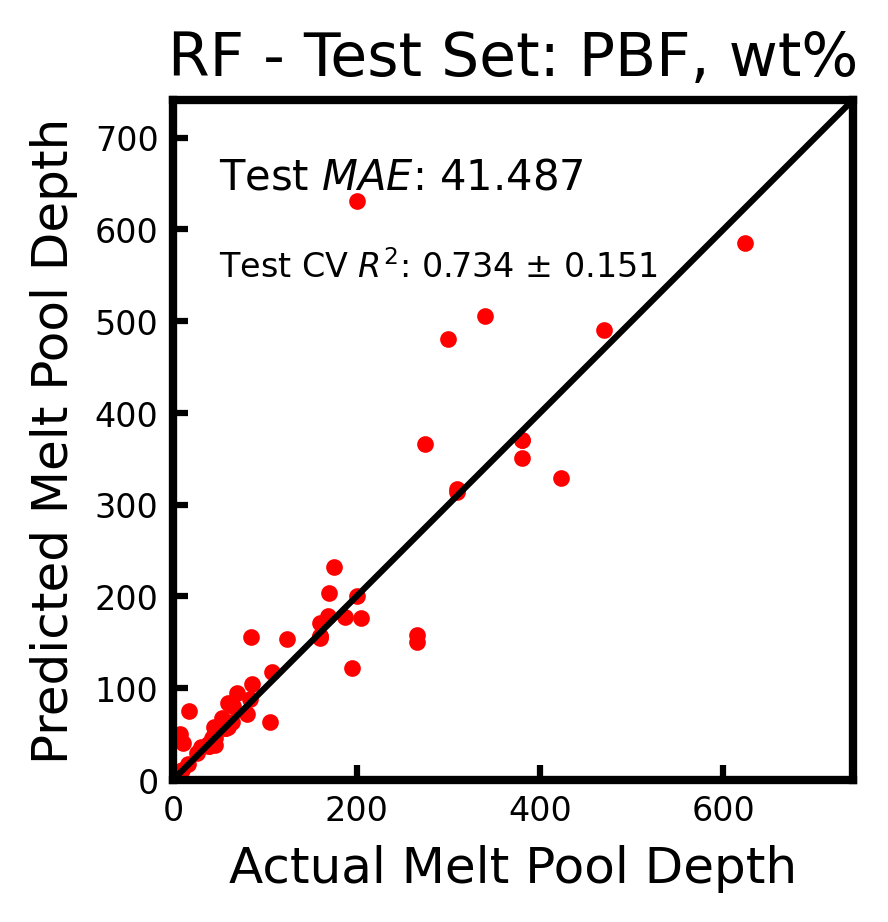

<Figure size 432x288 with 0 Axes>

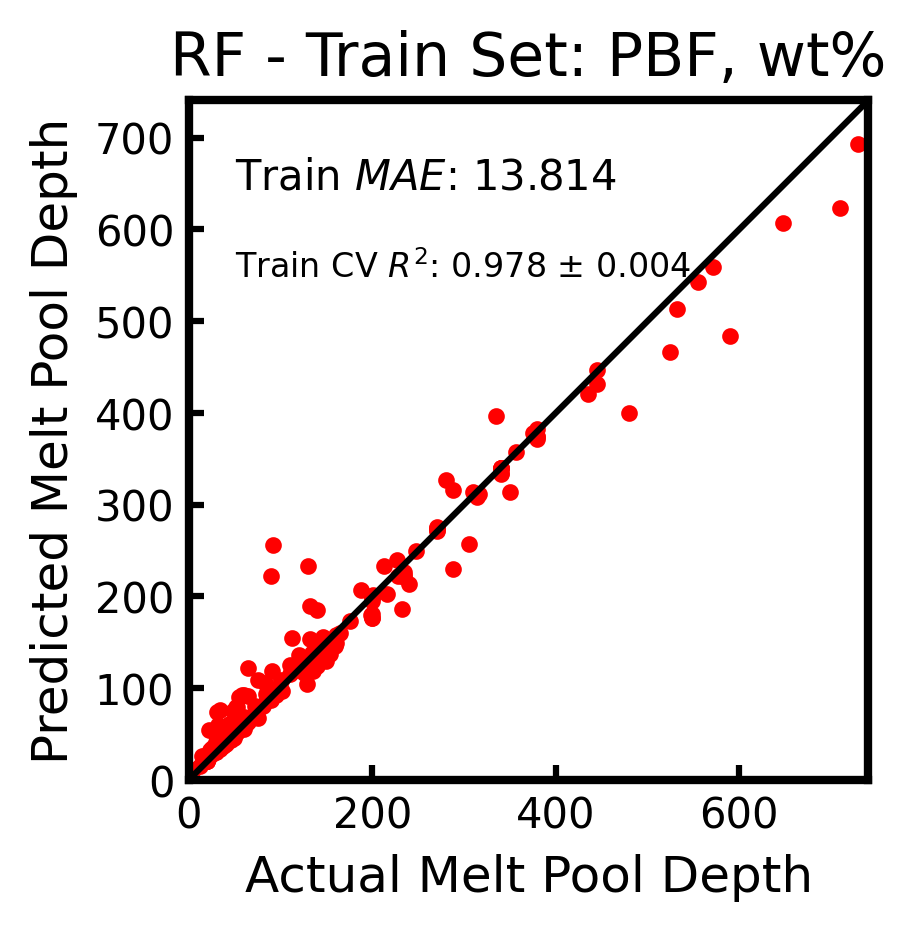

GPR  Train R^2: 0.91435 ± 0.00722, Test R^2: 0.79413 ± 0.10094


<Figure size 432x288 with 0 Axes>

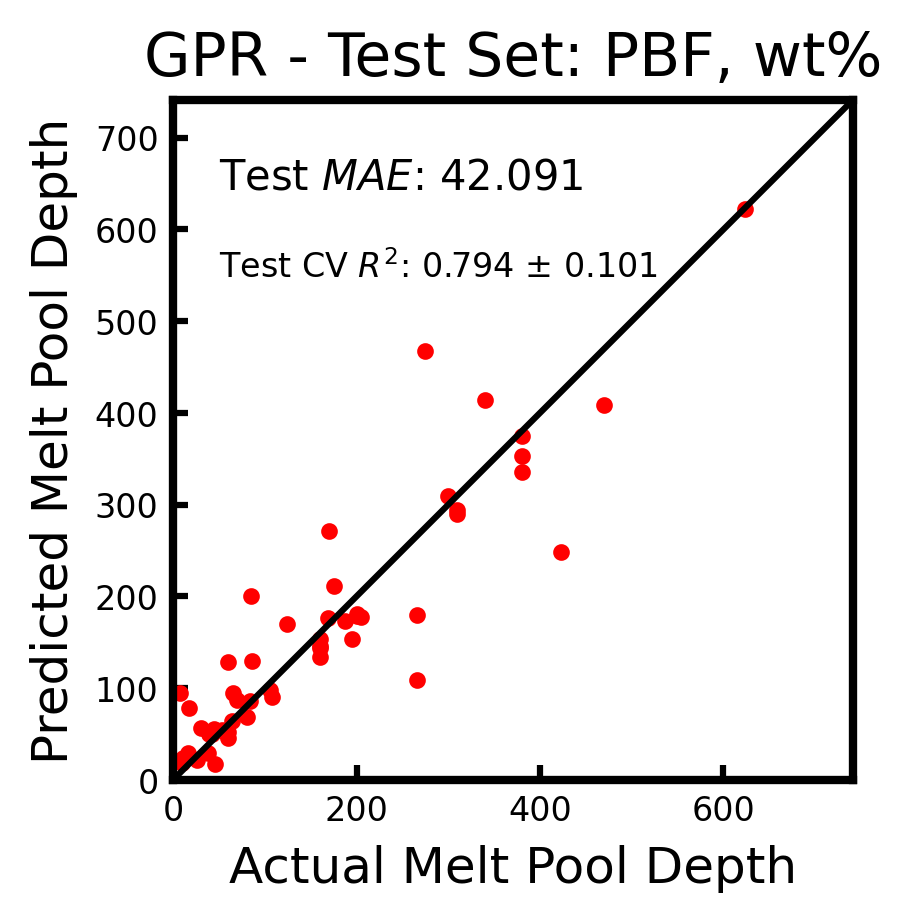

<Figure size 432x288 with 0 Axes>

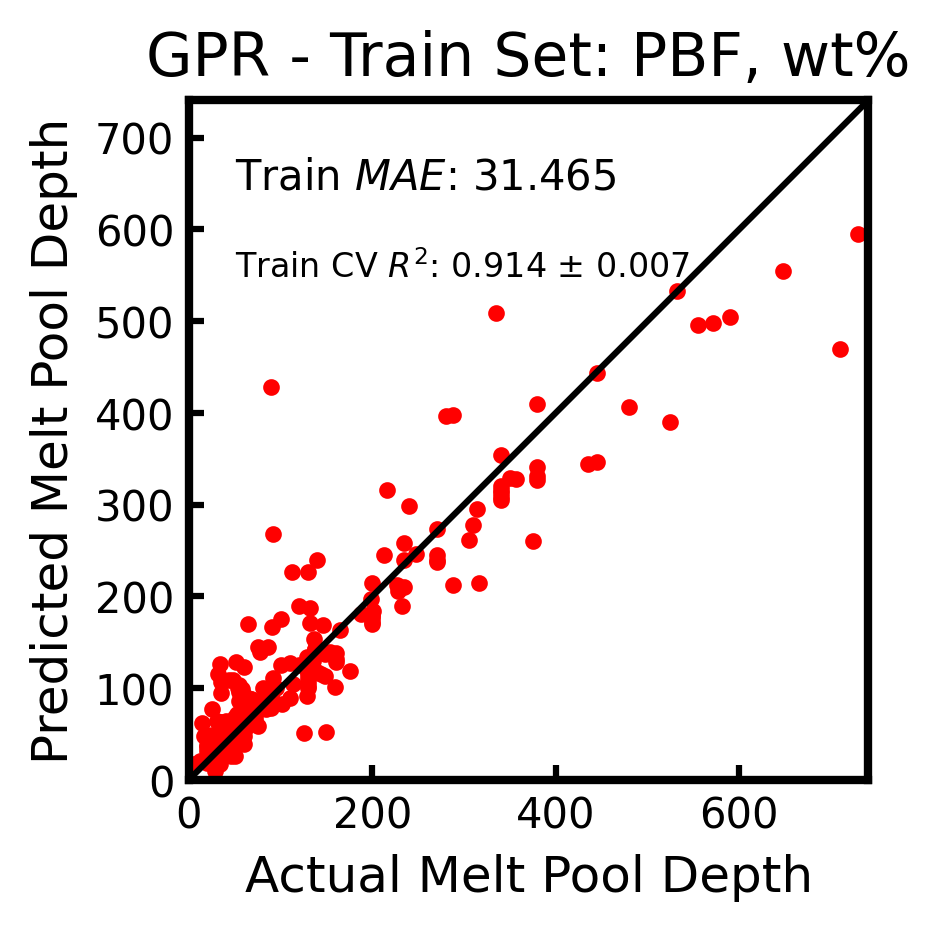

SVR  Train R^2: 0.77076 ± 0.05073, Test R^2: 0.68899 ± 0.12596


<Figure size 432x288 with 0 Axes>

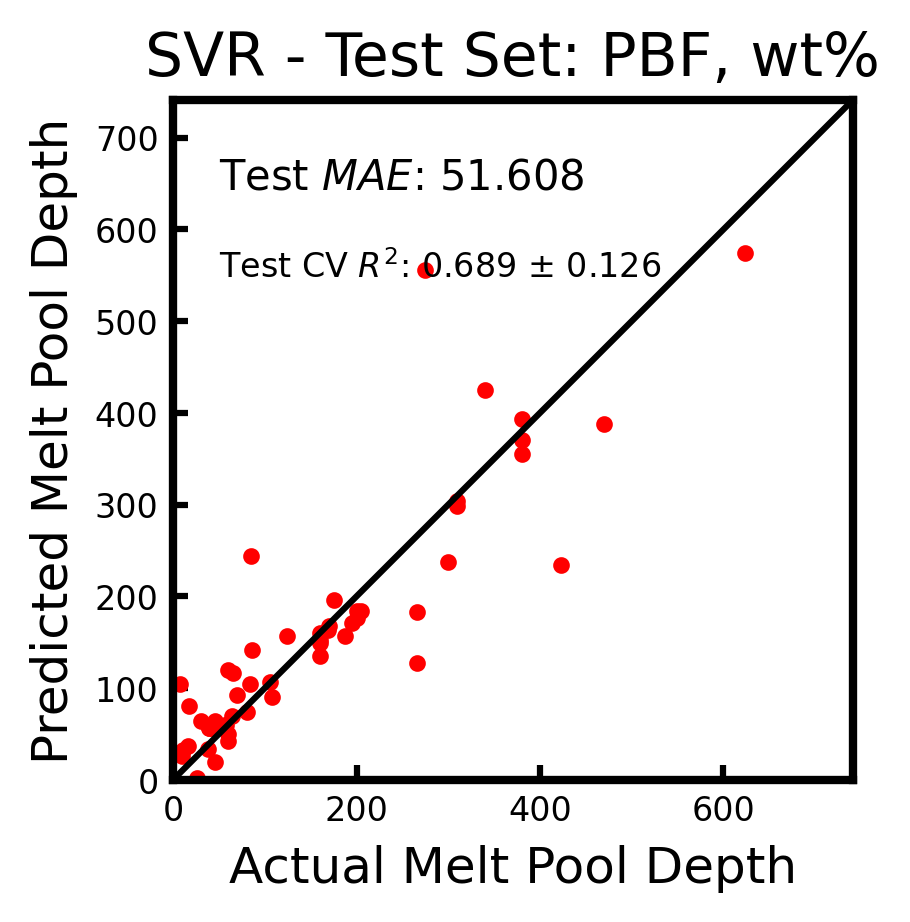

<Figure size 432x288 with 0 Axes>

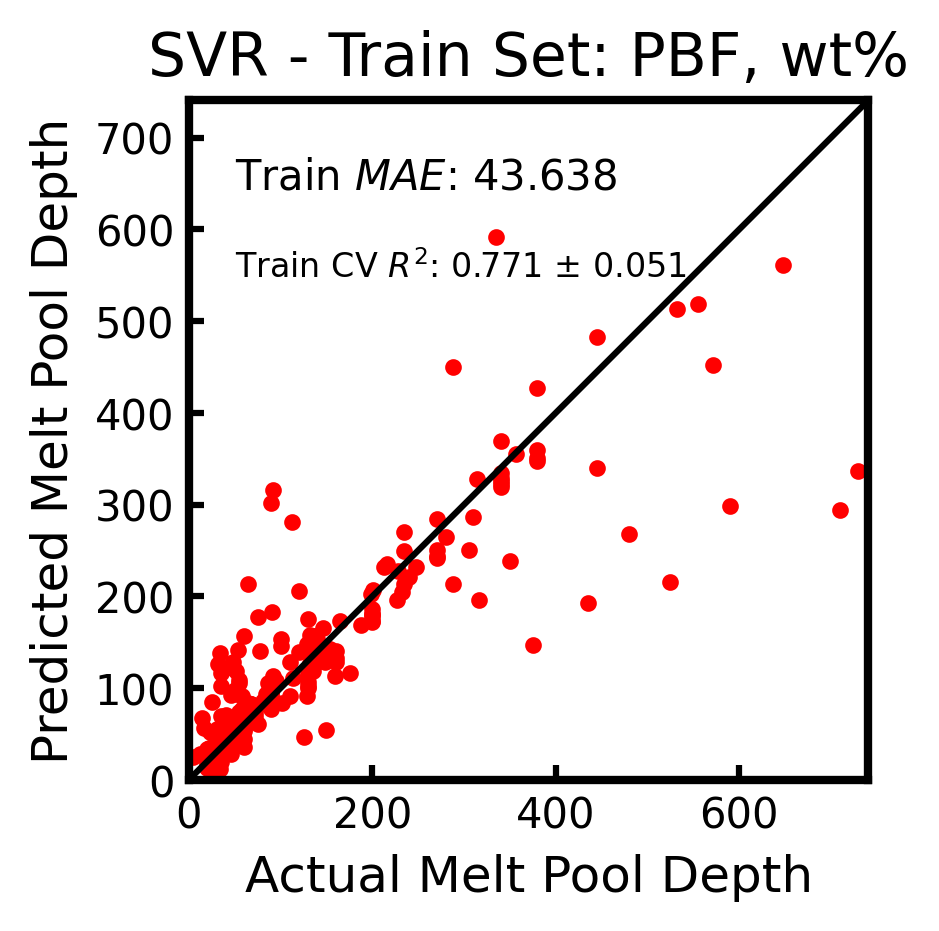

Ridge  Train R^2: 0.76104 ± 0.02736, Test R^2: 0.61530 ± 0.19341


<Figure size 432x288 with 0 Axes>

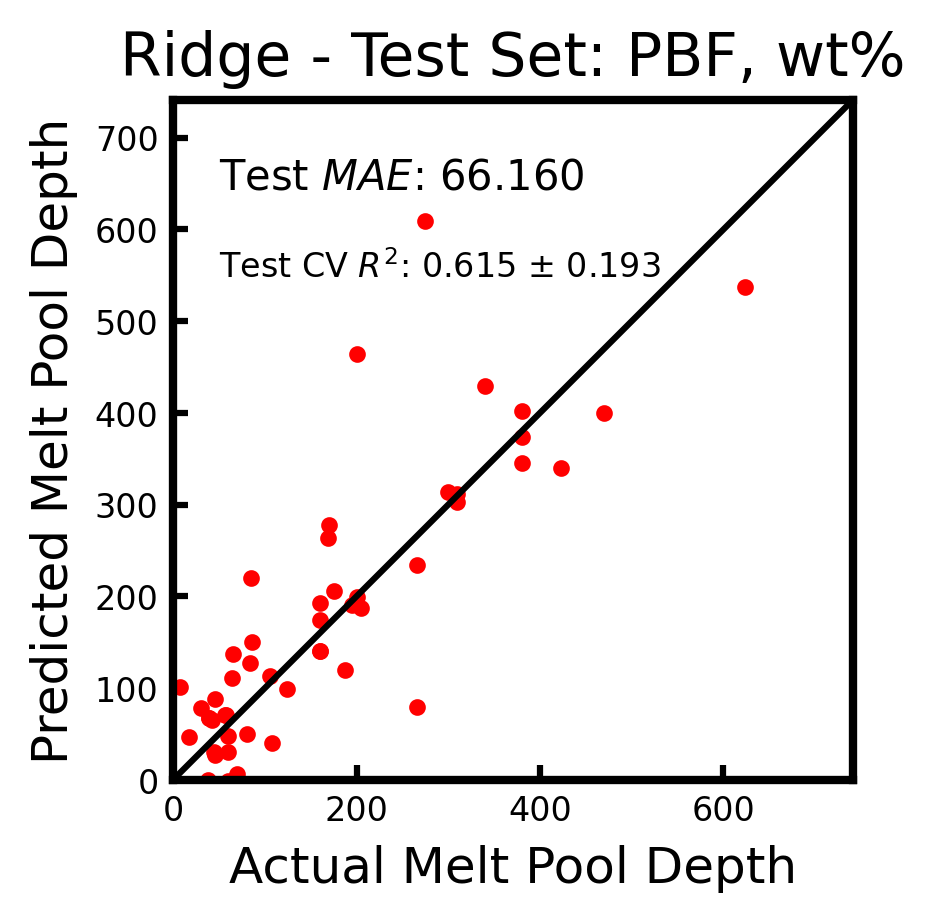

<Figure size 432x288 with 0 Axes>

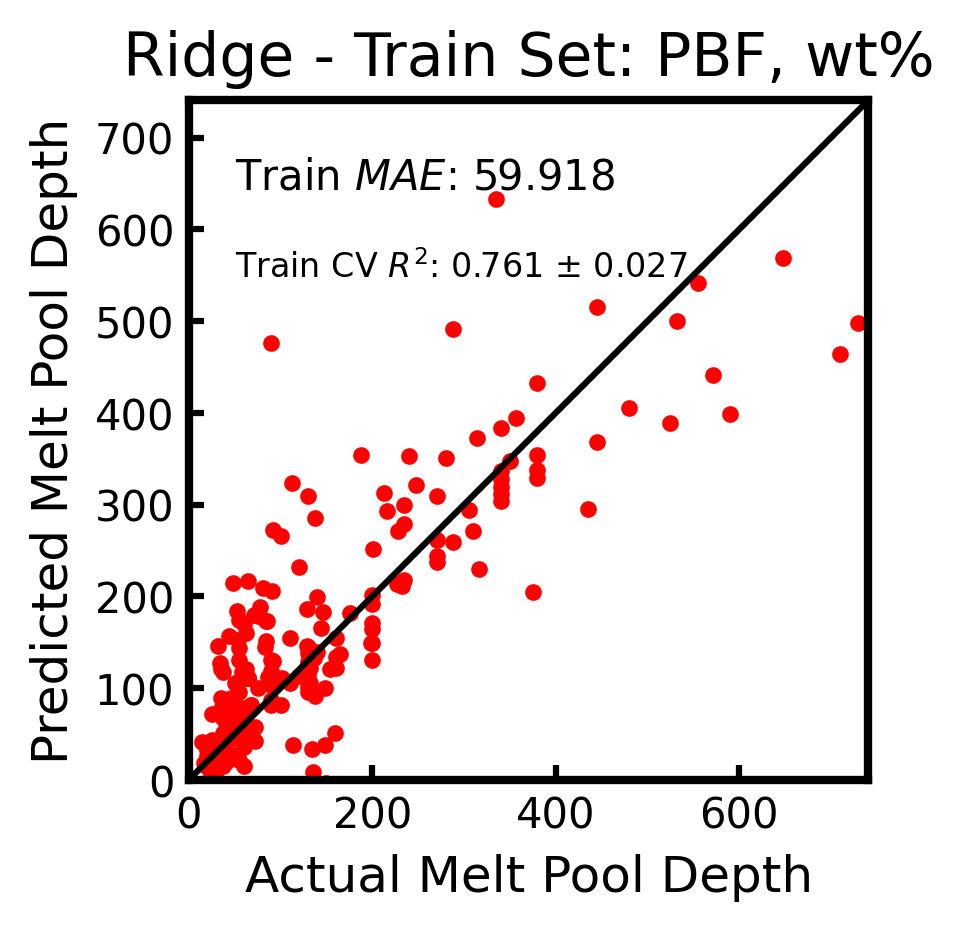

Lasso  Train R^2: 0.62134 ± 0.03672, Test R^2: 0.32591 ± 0.48926


<Figure size 432x288 with 0 Axes>

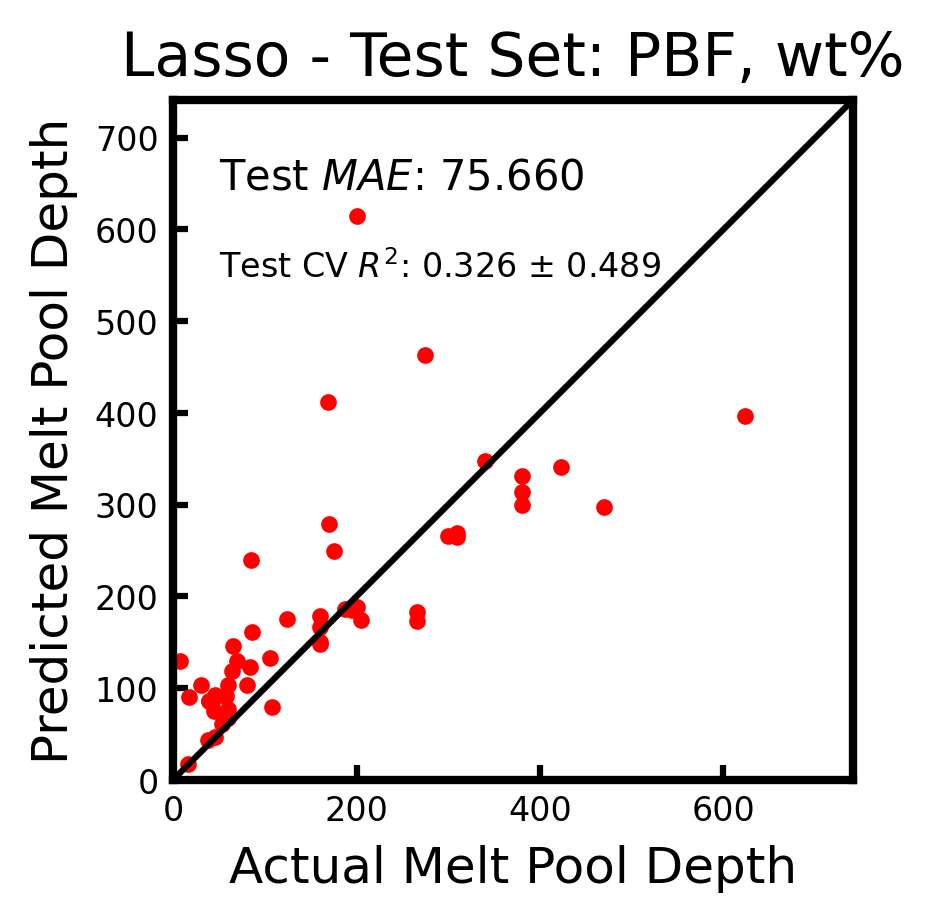

<Figure size 432x288 with 0 Axes>

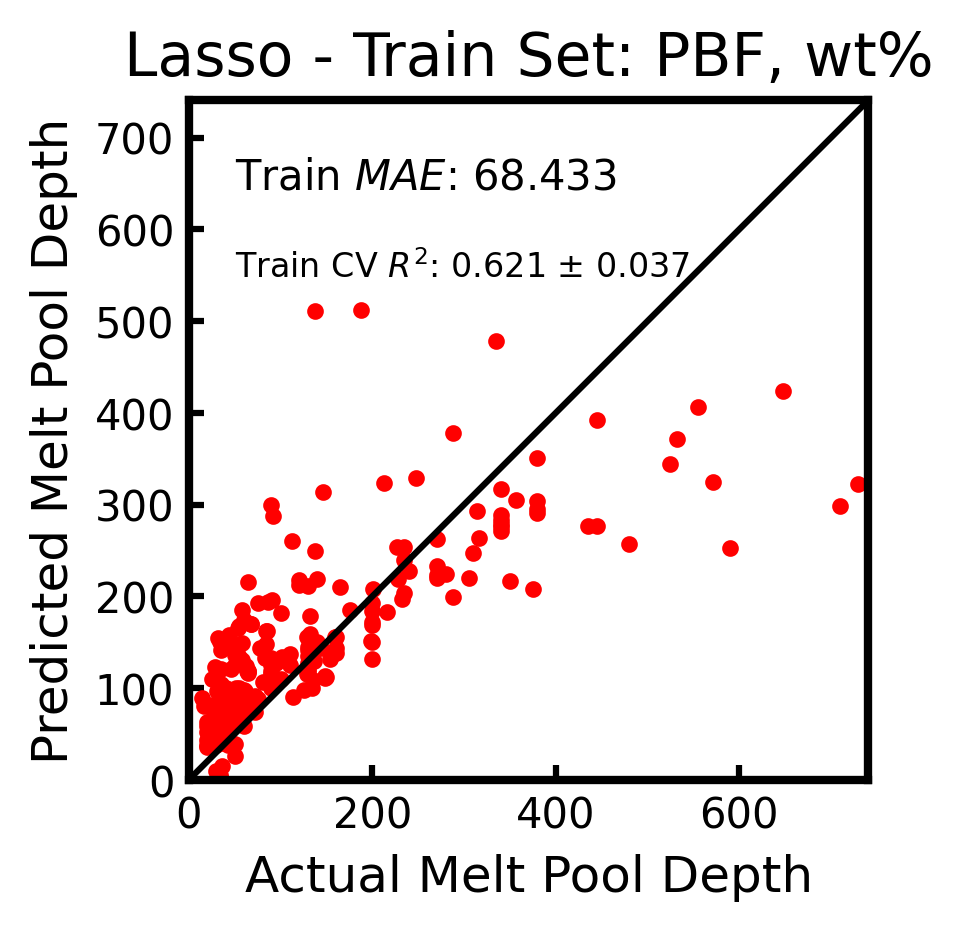

GB  Train R^2: 0.99028 ± 0.00221, Test R^2: 0.82423 ± 0.08818


<Figure size 432x288 with 0 Axes>

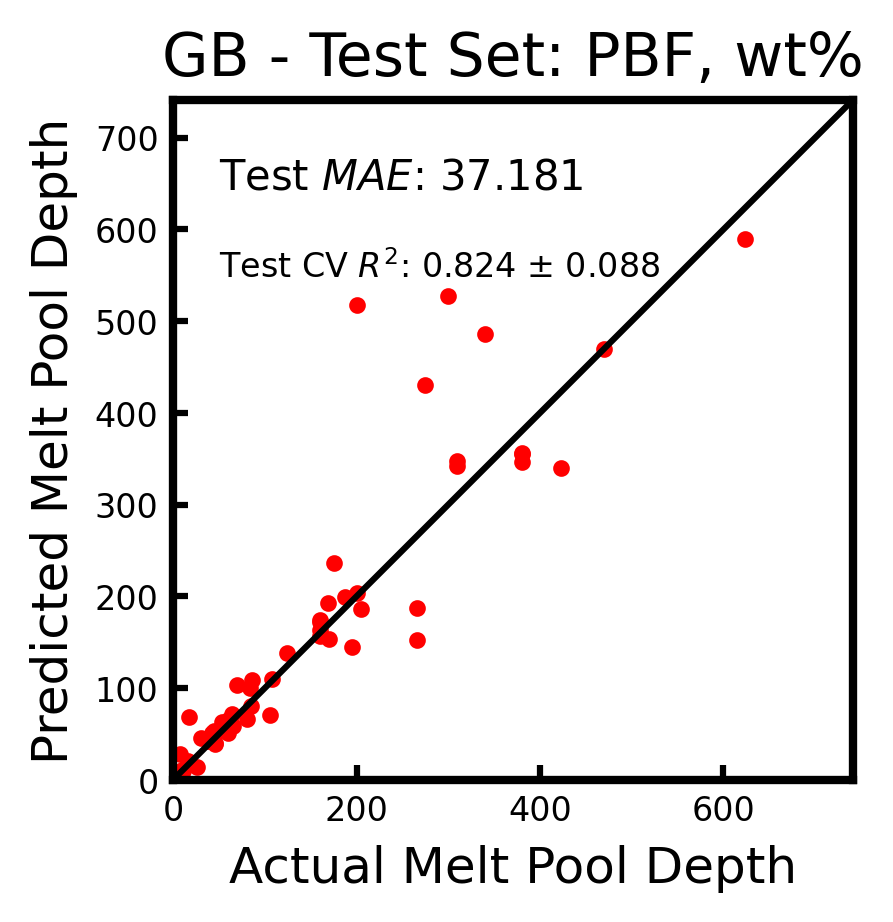

<Figure size 432x288 with 0 Axes>

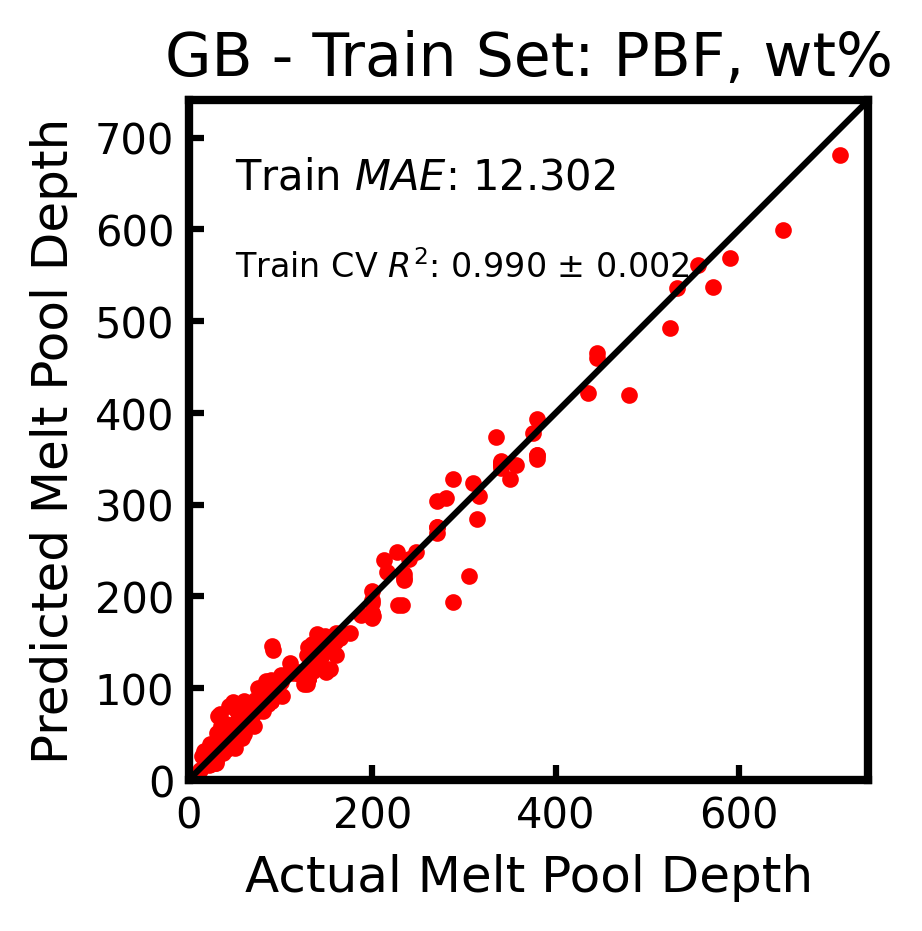

NN  Train R^2: 0.98470 ± 0.00362, Test R^2: 0.91101 ± 0.06075


<Figure size 432x288 with 0 Axes>

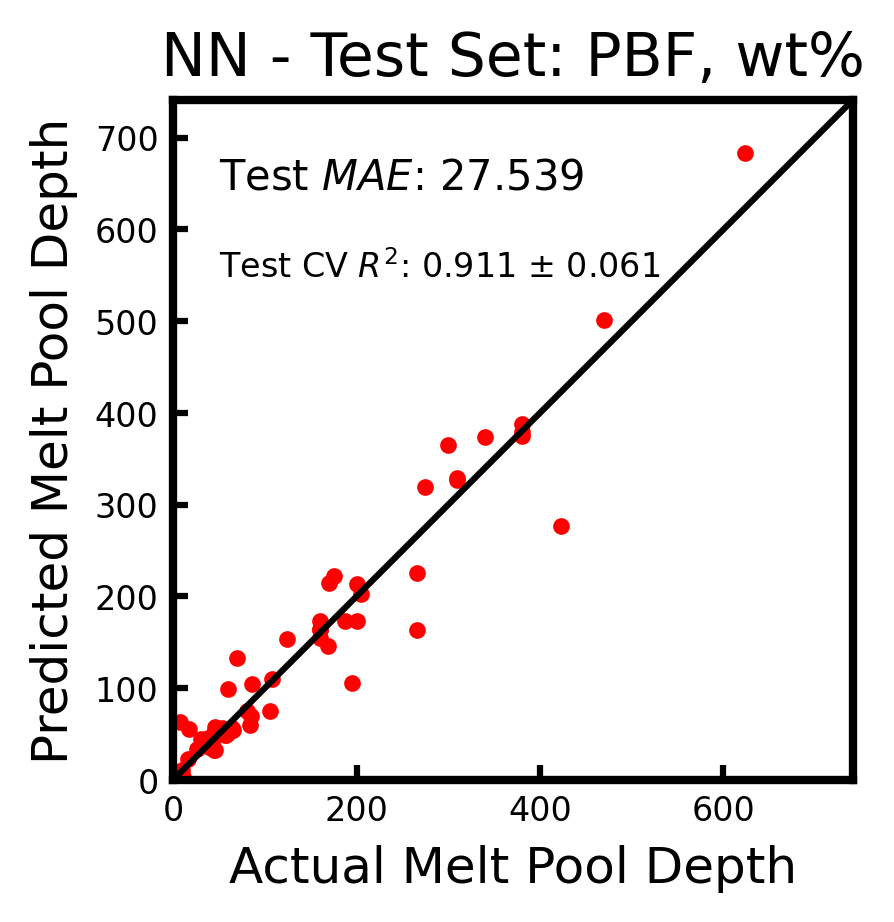

<Figure size 432x288 with 0 Axes>

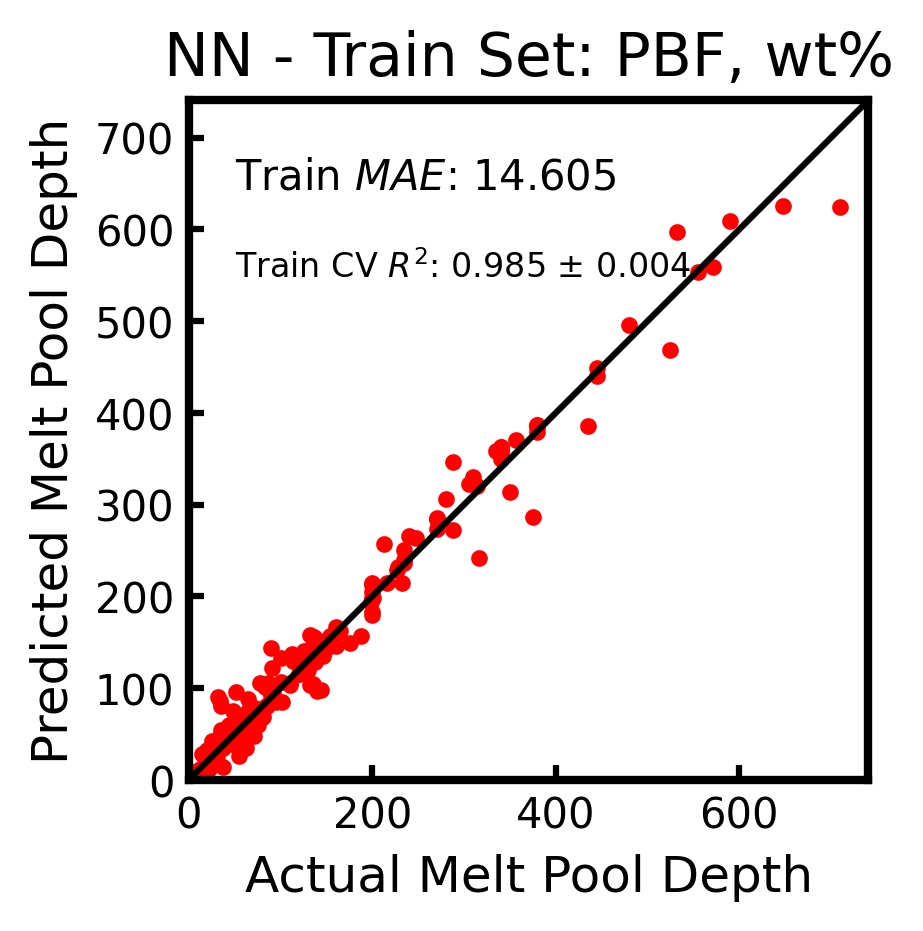

<Figure size 432x288 with 0 Axes>

In [33]:
%matplotlib inline
# Define parameters that models will be trained on and value to be predicted

parameter_list = ['Power', 'Velocity', 'density', 'Cp', 'k' , 'beam D', 'melting T', 'layer thickness',
                  'absorption coefficient', 'absorption coefficient 2']

# extend the parameter_list with atomic_features
parameter_list.extend(atomic_features)
#breakpoint()
label_col = 'depth of meltpool'

# Form dataset array from dataframe, given parameter_list, label_col
# function select_parameters() does this as well
data_list = []
label_list = []
new_csv = select_process(csv, 'PBF')
count = 0
for i in range(len(new_csv)):
    success, features, label = extract_features(new_csv.iloc[i], parameter_list, label_col)
    if success < 0:
        continue
    else:
        print(i)
        data_list.append(features)
        label_list.append(label)
        count += 1
print('length in PBF data: ', len(new_csv))
print('Used data points: ', count)    
        
X = np.array(np.squeeze(data_list))  

y = np.array(label_list)


fit_models, train_accuracy_atomicwt, train_accuracy_std_atomicwt, test_accuracy_atomicwt, test_accuracy_std_atomicwt  = learn(X.reshape(-1, len(parameter_list)), y, parameters = parameter_list, plot = True, title = 'PBF, wt%')


###  Regression tasks including P/D and OHE

12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
94
95
96
97
98
99
100
101
138
140
141
142
145
182
183
184
185
186
187
188
189
190
191
192
193
194
195
260
261
262
263
264
265
271
272
273
274
275
276
277
278
279
280
281
282
283
284
285
286
287
288
289
290
291
292
293
294
295
296
297
298
299
300
301
302
303
304
305
306
307
308
309
310
311
312
313
314
315
316
317
318
319
320
321
322
323
324
325
346
347
348
349
350
351
352
353
354
355
356
357
358
359
360
361
362
363
364
365
366
367
368
369
370
371
372
373
374
375
376
377
378
379
380
381
382
383
384
385
386
387
388
389
390
391
392
393
394
395
396
397
398
399
400
401
402
403
404
405
406
407
408
409
410
411
412
413
414
415
416
417
418
419
420
421
422
423
424
425
426
427
428
429
430
431
432
433
434
435
436
437
438
439
440
441
442
443
444
445
446
447
448
449
450
451
452
453
454
455
456
457
458
459
460
461
462
463
464
465
466
467
468
477
478
479
480
481
482
483
484
485
486
487
488
489
490
491
736
737
738
739
740
741
742
743
744


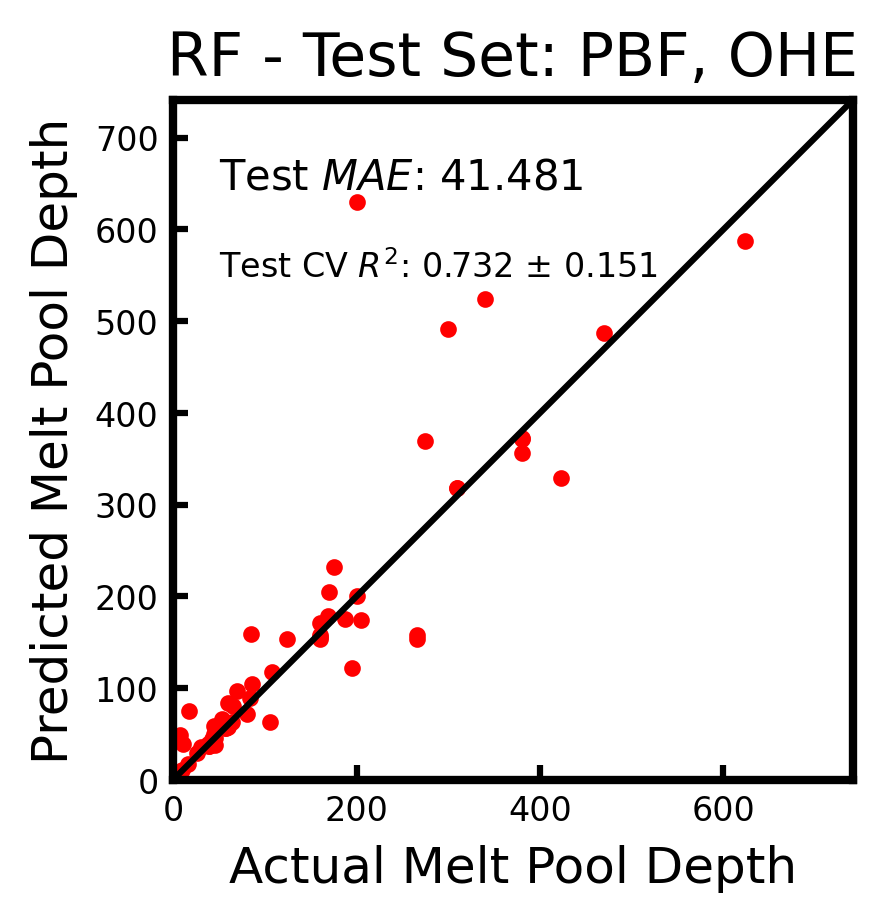

<Figure size 432x288 with 0 Axes>

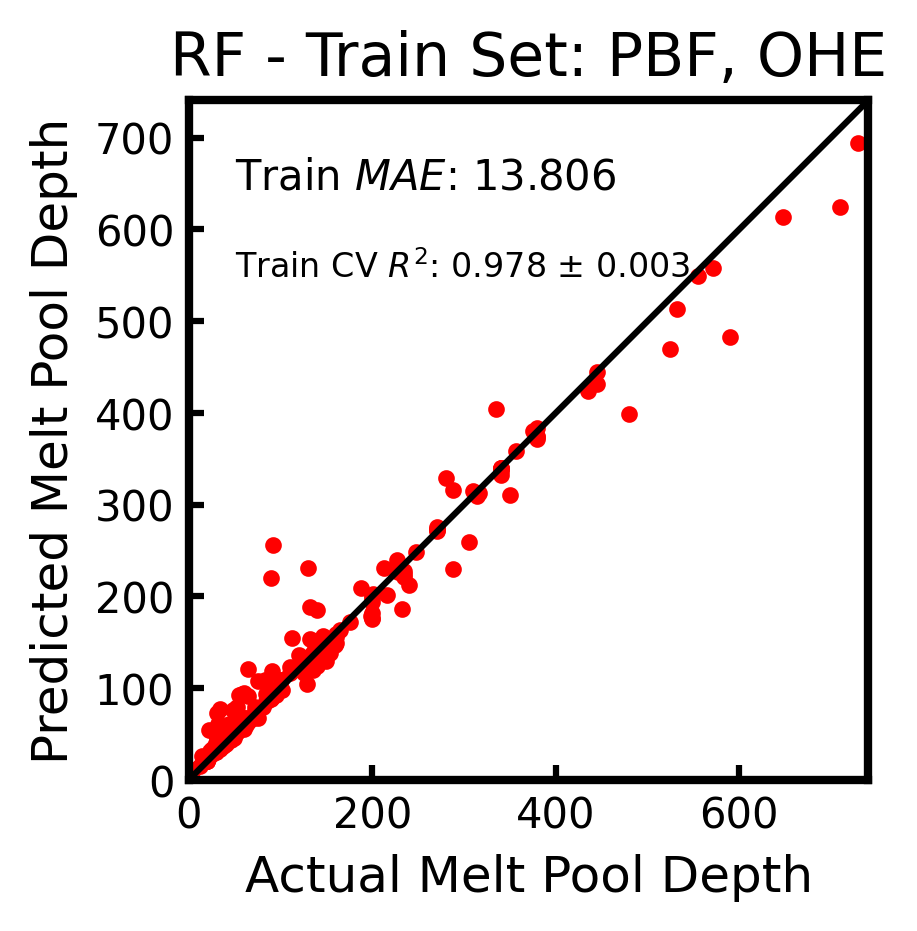

GPR  Train R^2: 0.90270 ± 0.00697, Test R^2: 0.79618 ± 0.09261


<Figure size 432x288 with 0 Axes>

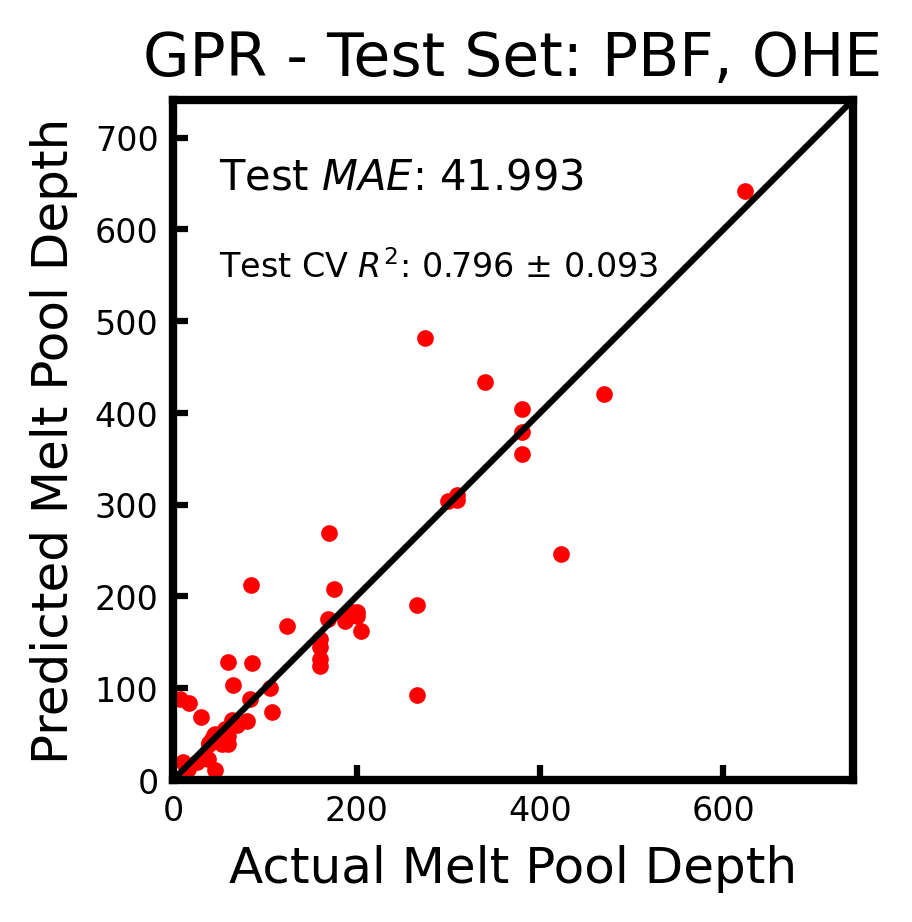

<Figure size 432x288 with 0 Axes>

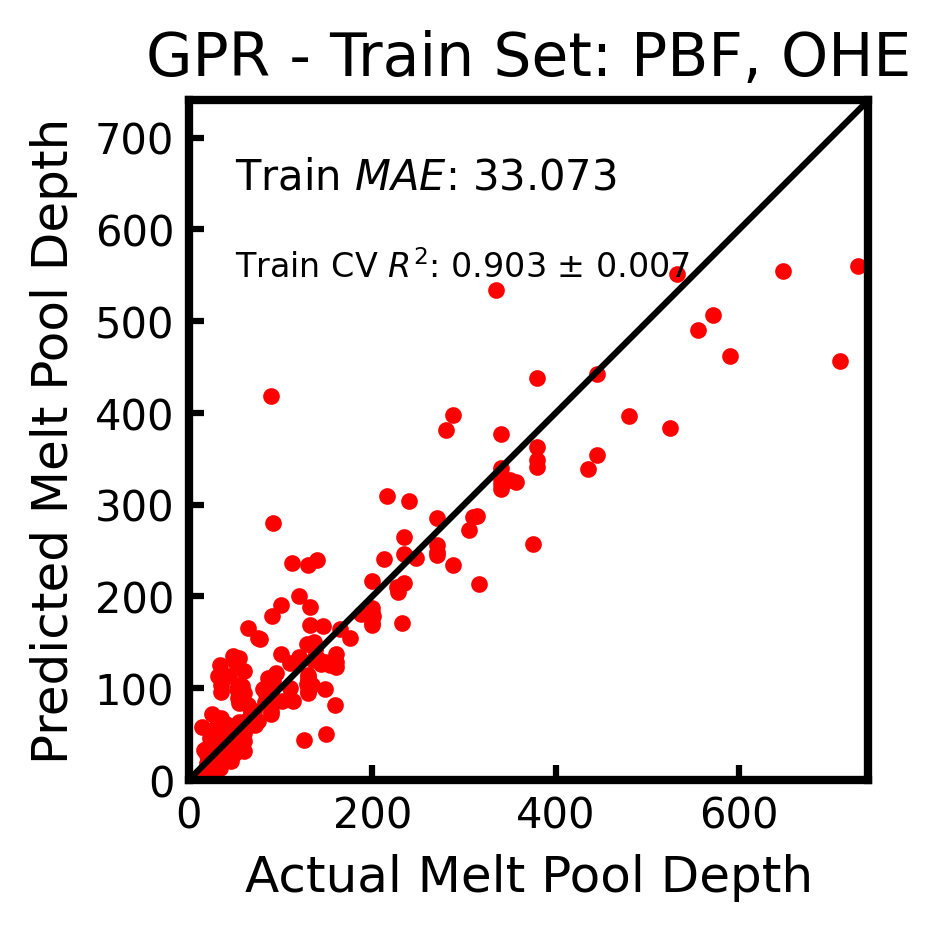

SVR  Train R^2: 0.83413 ± 0.03921, Test R^2: 0.75904 ± 0.09703


<Figure size 432x288 with 0 Axes>

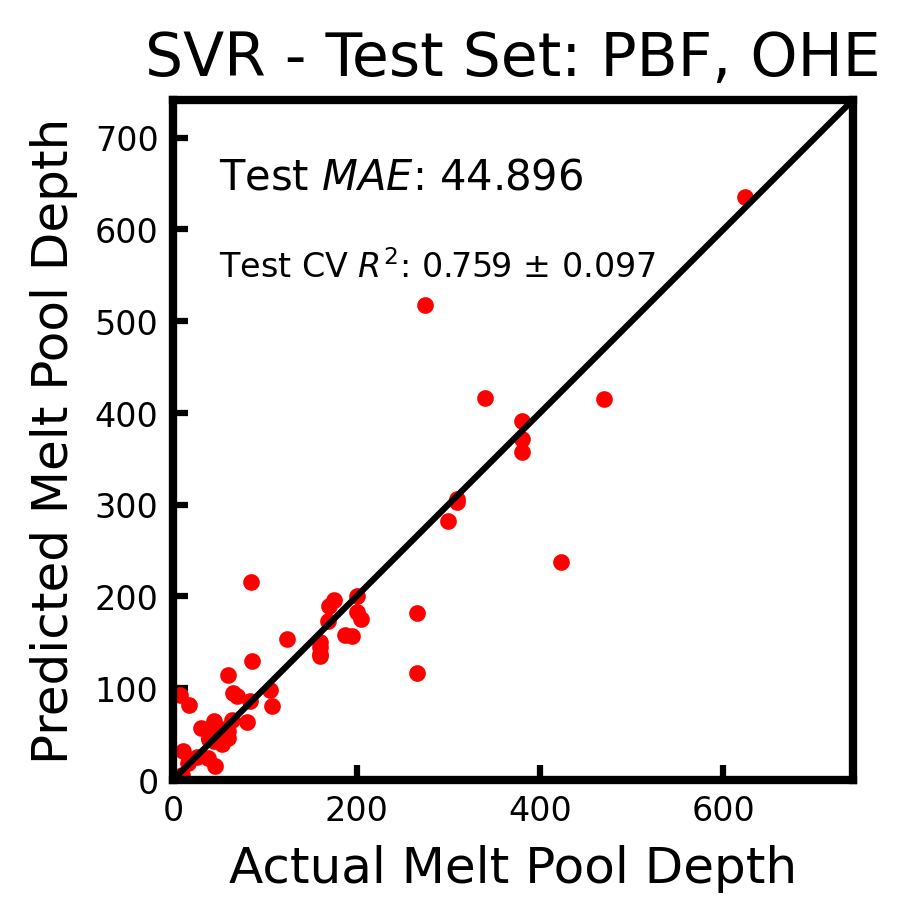

<Figure size 432x288 with 0 Axes>

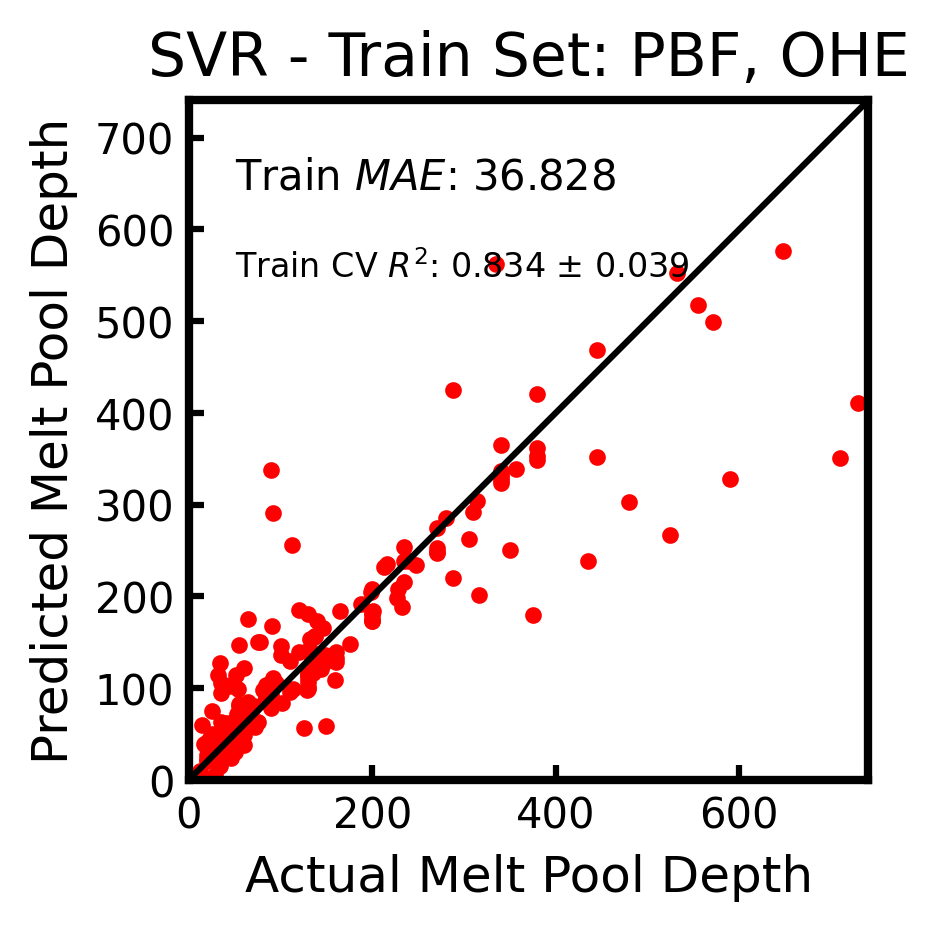

Ridge  Train R^2: 0.76104 ± 0.02736, Test R^2: 0.61536 ± 0.19342


<Figure size 432x288 with 0 Axes>

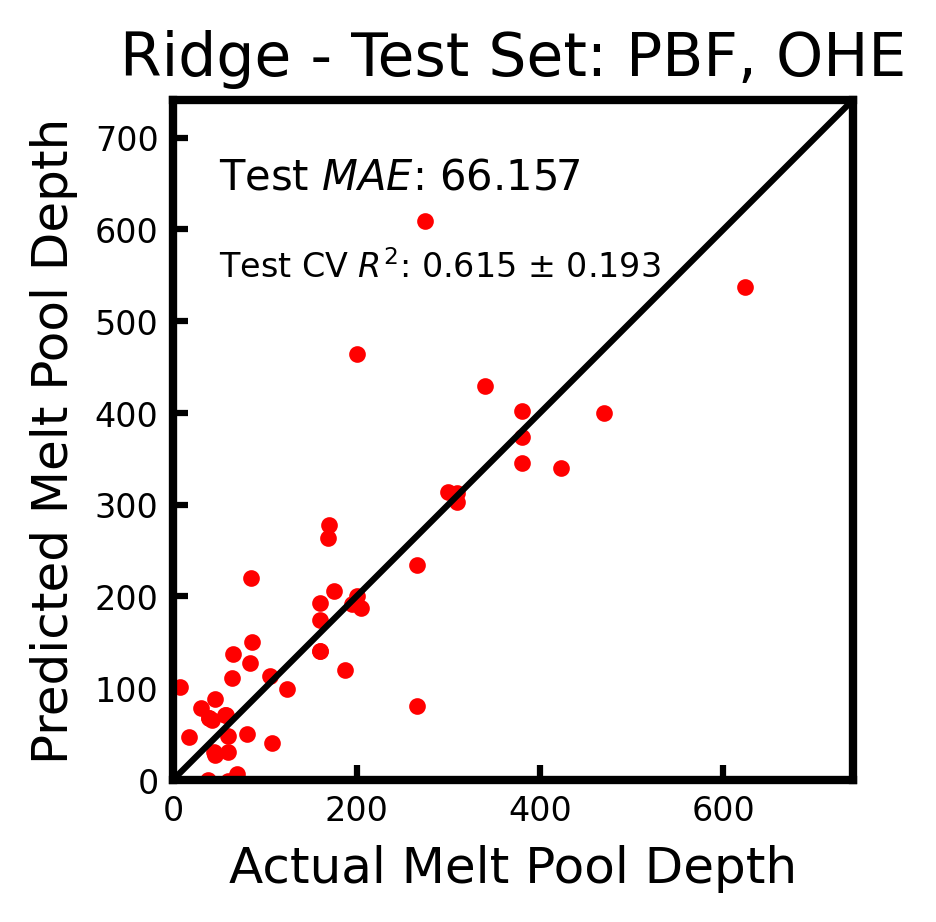

<Figure size 432x288 with 0 Axes>

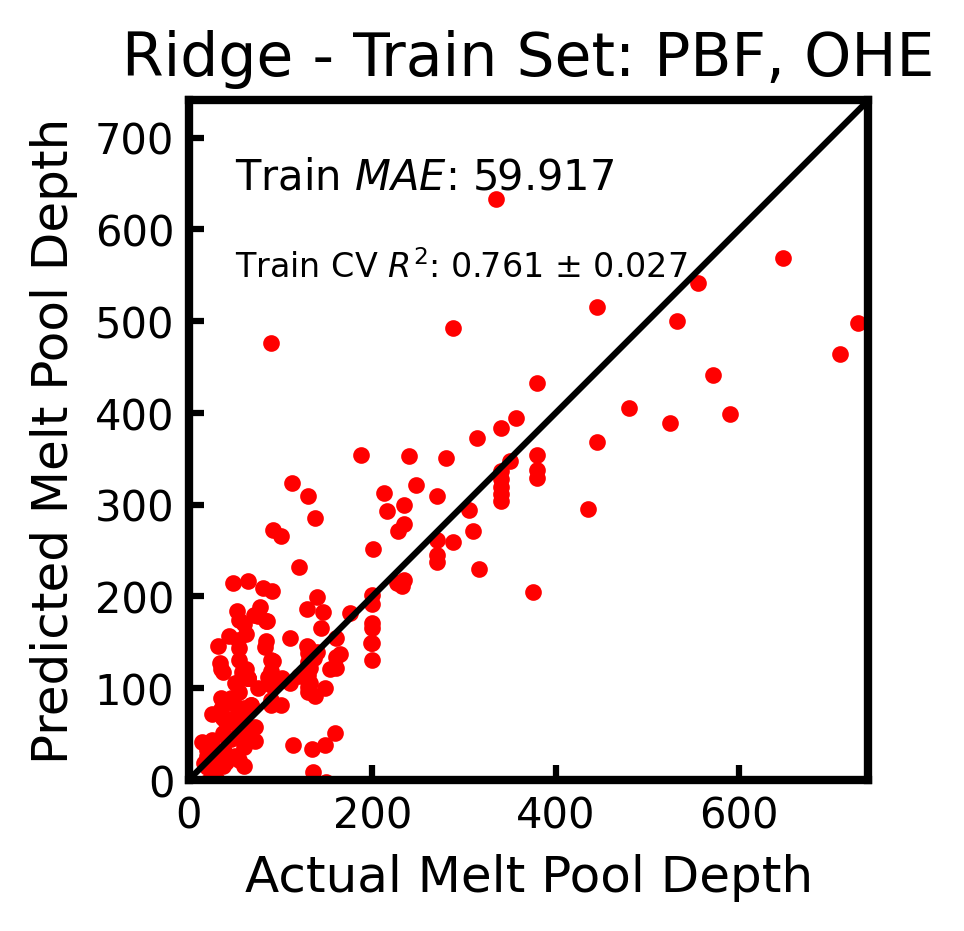

Lasso  Train R^2: 0.60349 ± 0.04251, Test R^2: 0.30696 ± 0.52460


<Figure size 432x288 with 0 Axes>

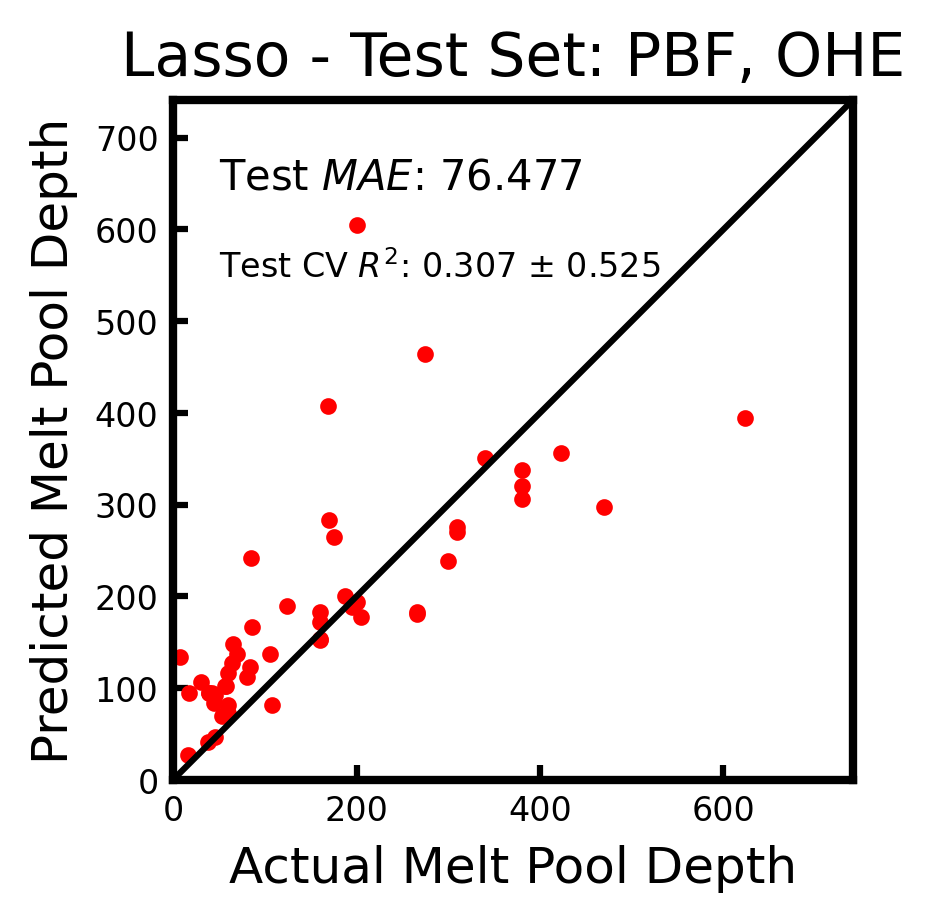

<Figure size 432x288 with 0 Axes>

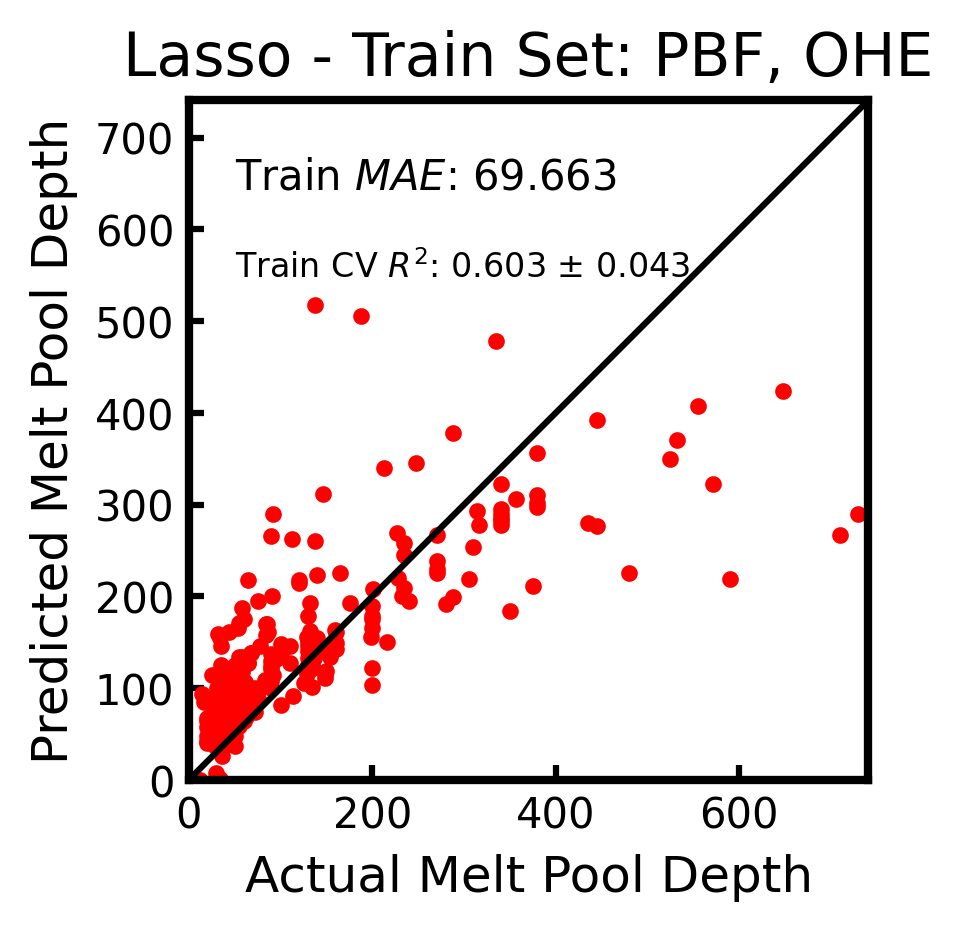

GB  Train R^2: 0.99018 ± 0.00220, Test R^2: 0.80013 ± 0.11128


<Figure size 432x288 with 0 Axes>

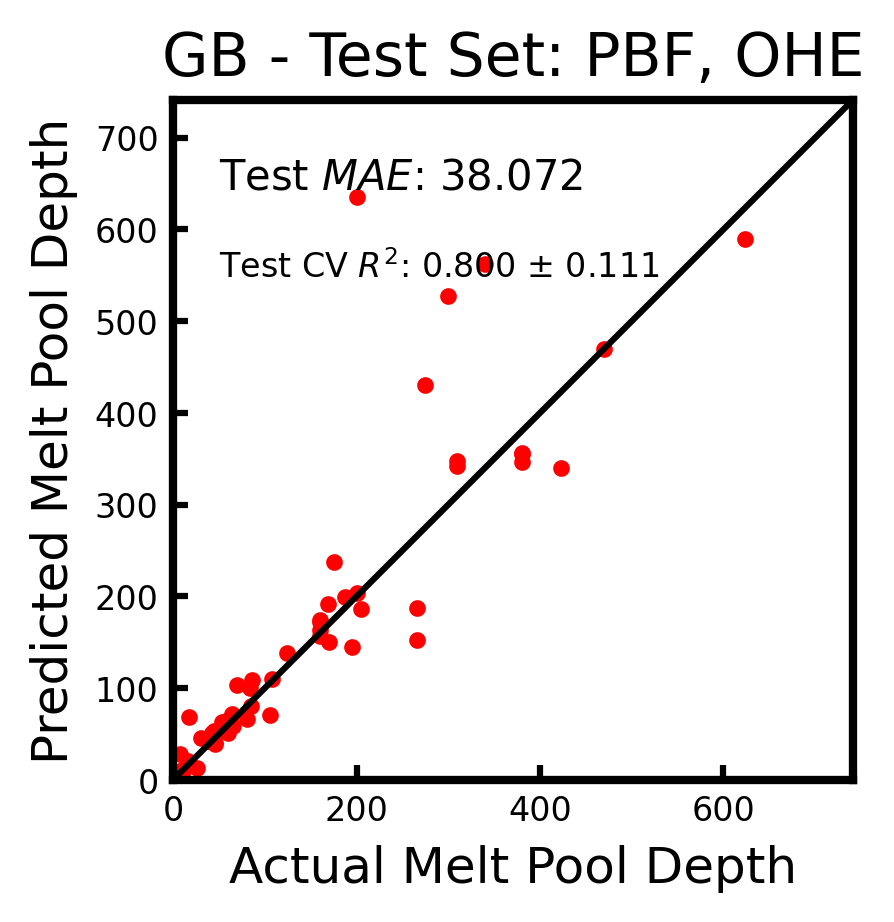

<Figure size 432x288 with 0 Axes>

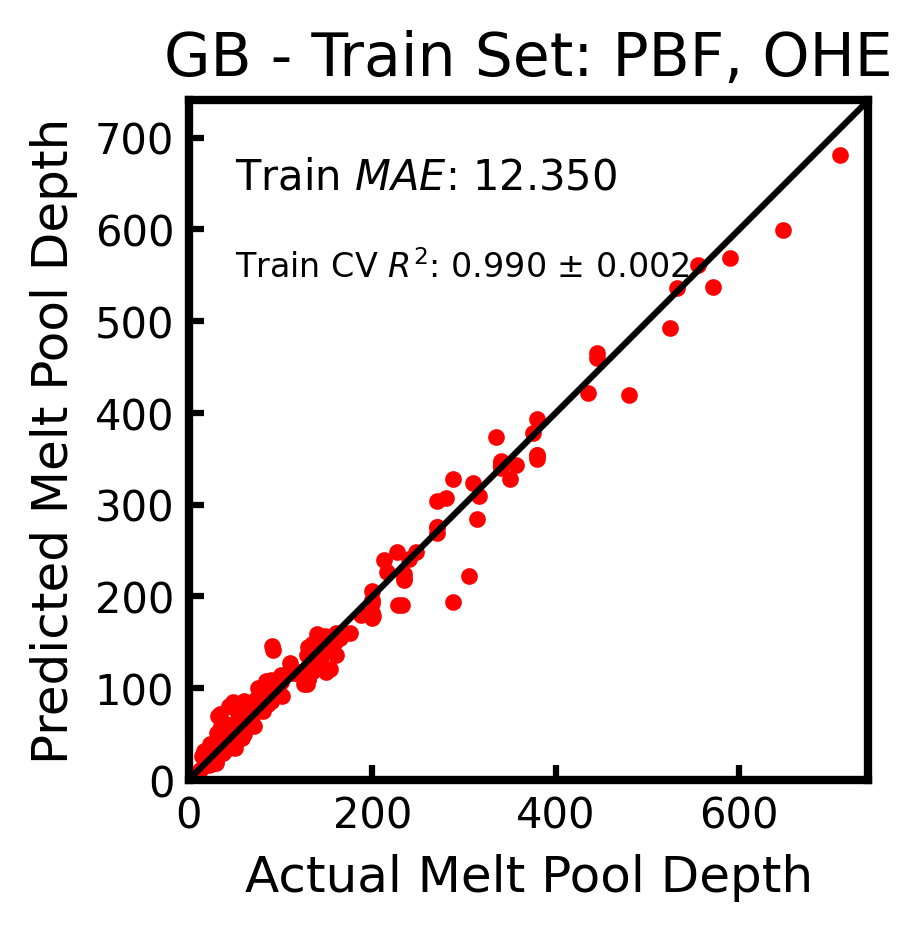

NN  Train R^2: 0.98475 ± 0.00637, Test R^2: 0.91885 ± 0.05562


<Figure size 432x288 with 0 Axes>

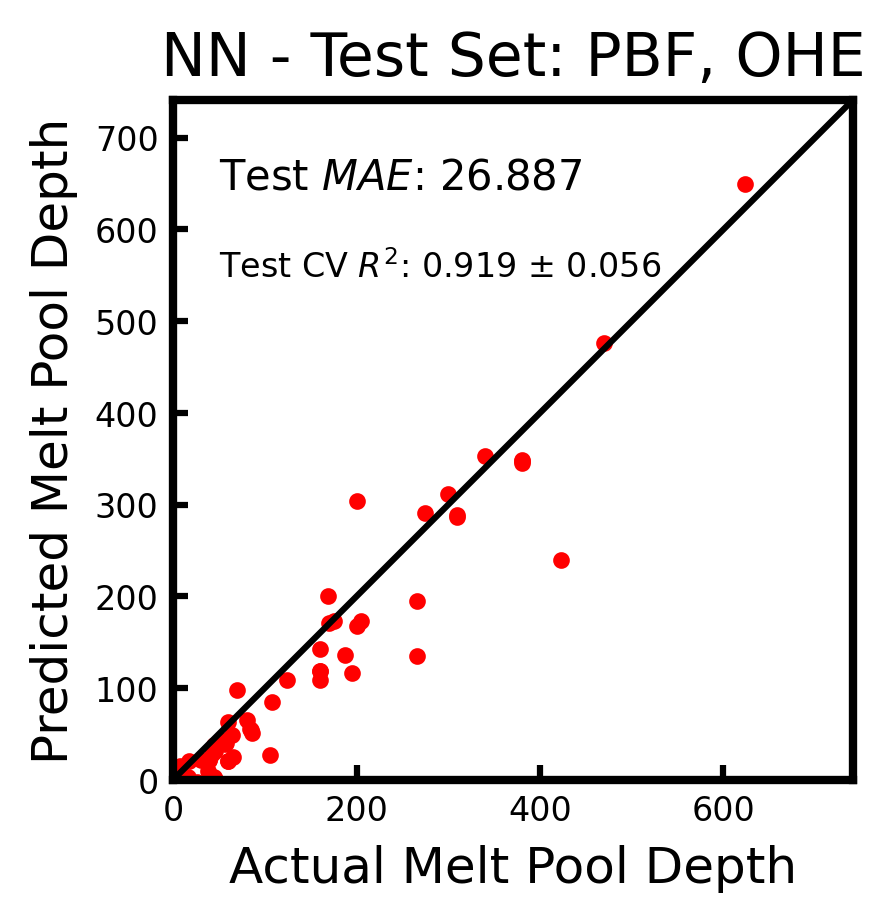

<Figure size 432x288 with 0 Axes>

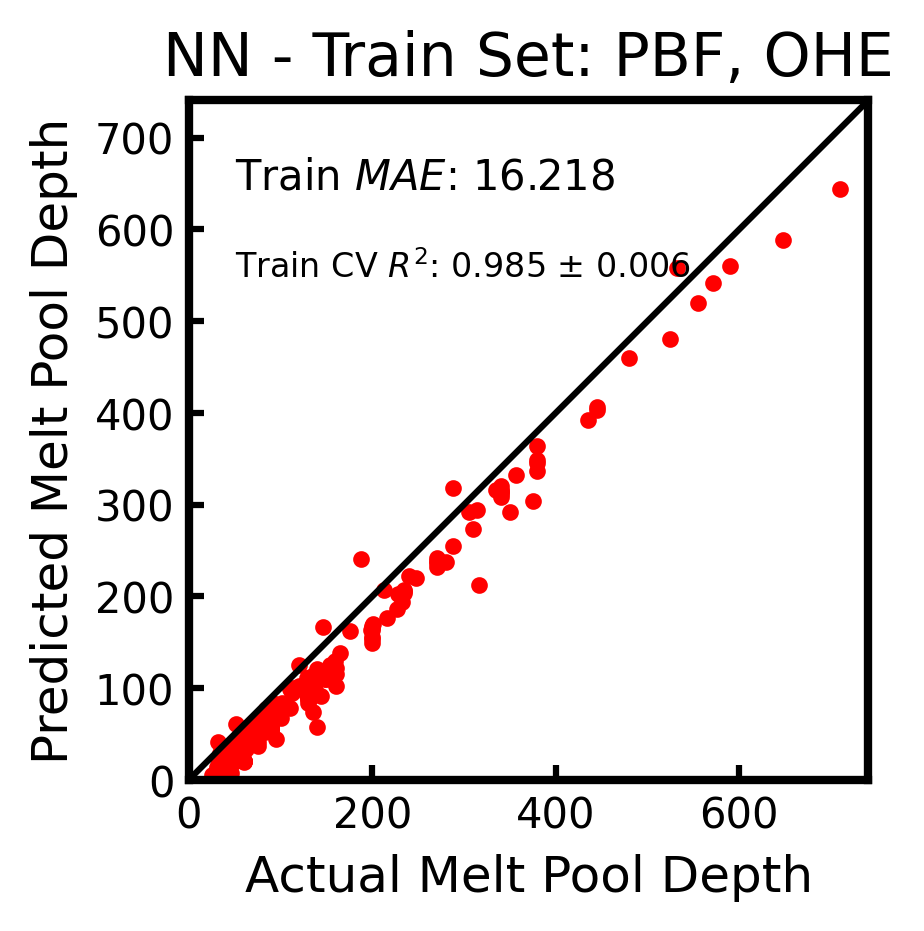

<Figure size 432x288 with 0 Axes>

In [34]:
%matplotlib inline
# Define parameters that models will be trained on and value to be predicted

parameter_list = ['Power', 'Velocity', 'density', 'Cp', 'k' , 'beam D', 'melting T', 'layer thickness',
                  'absorption coefficient', 'absorption coefficient 2']

label_col = 'depth of meltpool'

# Form dataset array from dataframe, given parameter_list, label_col
# function select_parameters() does this as well
data_list = []
label_list = []
materials_present = []
new_csv = select_process(csv, 'PBF')
count = 0
for i in range(len(new_csv)):
    success, features, label = extract_features(new_csv.iloc[i], parameter_list, label_col)
    if success < 0:
        continue
    else:
        print(i)
        data_list.append(features)
        label_list.append(label)
        materials_present.append(new_csv['Material'].iloc[i])
        count += 1
print('length in PBF data: ', len(new_csv))
print('Used data points: ', count)  
        
materials_ohe = [np.zeros(len(materials_present)) for key in materials.keys()]
len(materials_ohe)
materials_ohe = np.array(materials_ohe).T
#breakpoint()
#materials.keys()
print(len(materials_ohe))
material_pos = np.arange(len(materials.keys()))
for idx in range(len(materials_present)):
    for j_idx in range(len(material_pos)):
      #  breakpoint()
        if materials_present[idx] == materials.keys()[j_idx]:
            
            materials_ohe[idx,j_idx] = 1 

# print(np.argmax(materials_ohe, axis = 1))
    
        
X = np.array(np.squeeze(data_list))  

y = np.array(label_list)
#breakpoint()

fit_models, train_accuracy_ohe, train_accuracy_std_ohe, test_accuracy_ohe, test_accuracy_std_ohe  = learn(X.reshape(-1, len(parameter_list)), y, parameters = parameter_list, plot = True, title = 'PBF, OHE', materials_ohe = materials_ohe)


### Regression including element features and OHE

12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
94
95
96
97
98
99
100
101
138
140
141
142
145
182
183
184
185
186
187
188
189
190
191
192
193
194
195
260
261
262
263
264
265
271
272
273
274
275
276
277
278
279
280
281
282
283
284
285
286
287
288
289
290
291
292
293
294
295
296
297
298
299
300
301
302
303
304
305
306
307
308
309
310
311
312
313
314
315
316
317
318
319
320
321
322
323
324
325
346
347
348
349
350
351
352
353
354
355
356
357
358
359
360
361
362
363
364
365
366
367
368
369
370
371
372
373
374
375
376
377
378
379
380
381
382
383
384
385
386
387
388
389
390
391
392
393
394
395
396
397
398
399
400
401
402
403
404
405
406
407
408
409
410
411
412
413
414
415
416
417
418
419
420
421
422
423
424
425
426
427
428
429
430
431
432
433
434
435
436
437
438
439
440
441
442
443
444
445
446
447
448
449
450
451
452
453
454
455
456
457
458
459
460
461
462
463
464
465
466
467
468
477
478
479
480
481
482
483
484
485
486
487
488
489
490
491
736
737
738
739
740
741
742
743
744


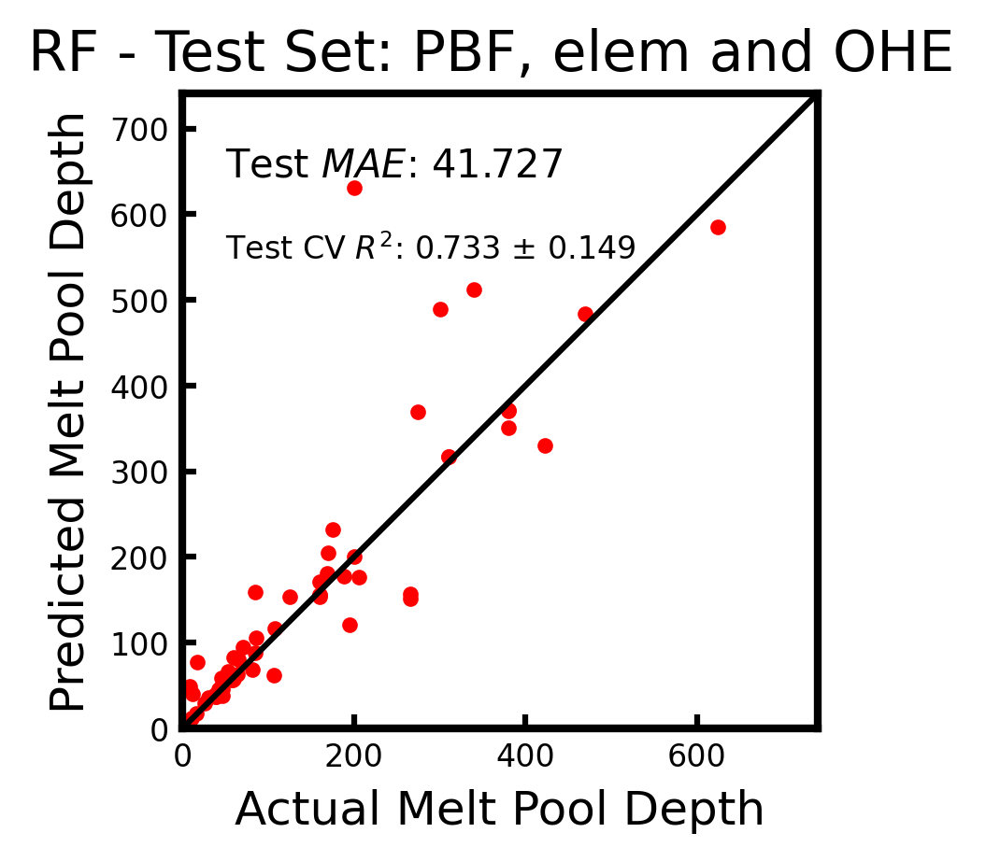

<Figure size 432x288 with 0 Axes>

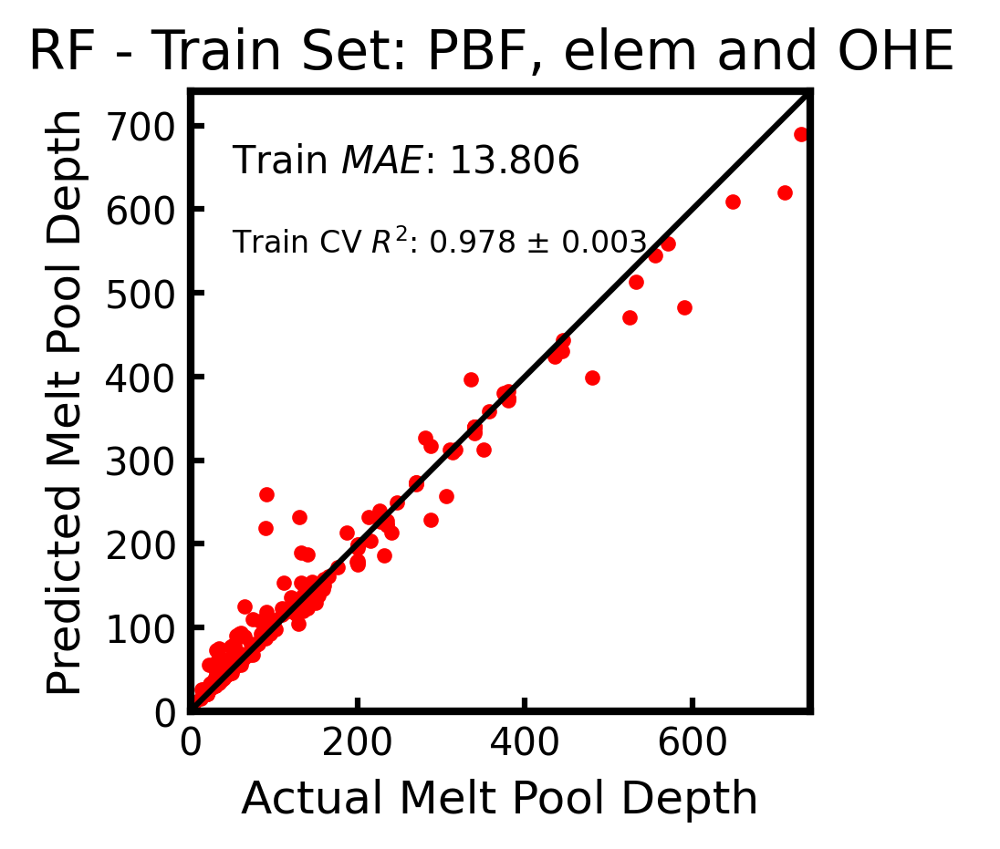

GPR  Train R^2: 0.91023 ± 0.00749, Test R^2: 0.79446 ± 0.09928


<Figure size 432x288 with 0 Axes>

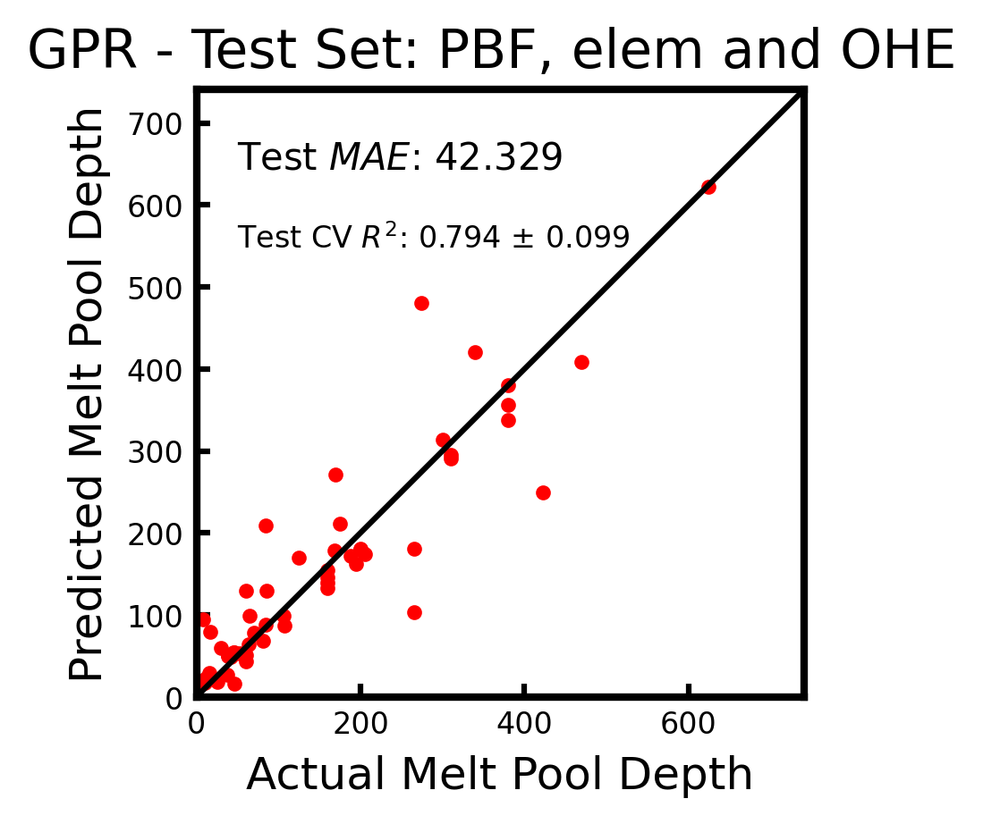

<Figure size 432x288 with 0 Axes>

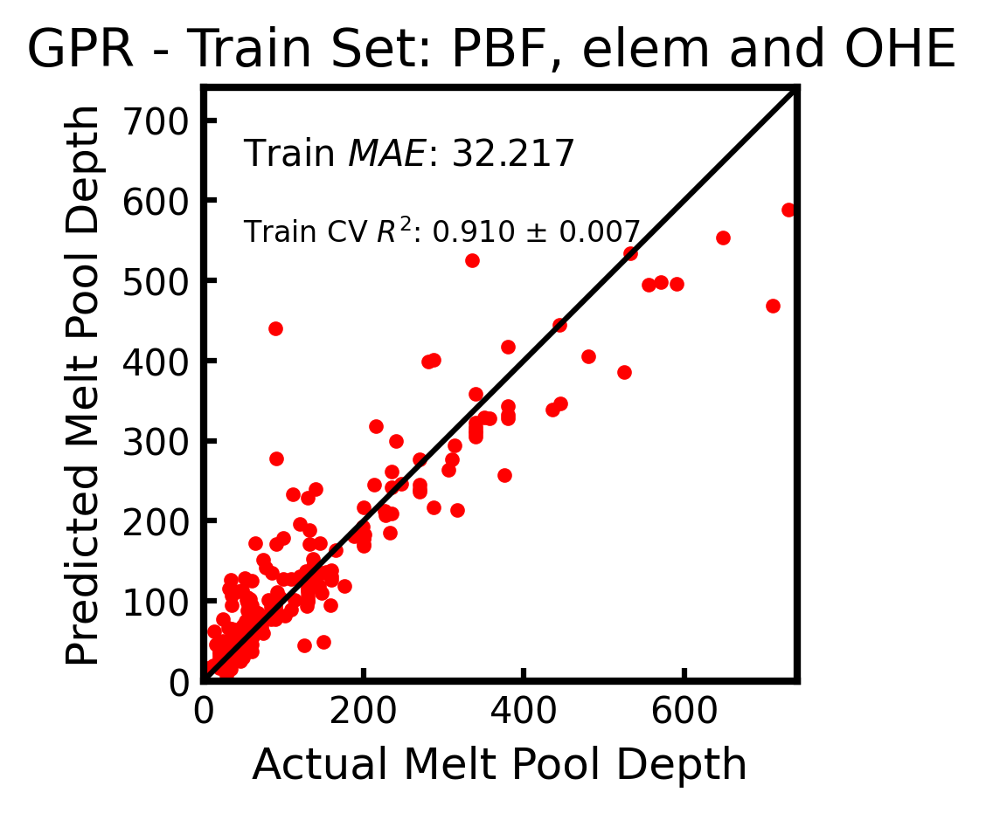

SVR  Train R^2: 0.78801 ± 0.04872, Test R^2: 0.71106 ± 0.10562


<Figure size 432x288 with 0 Axes>

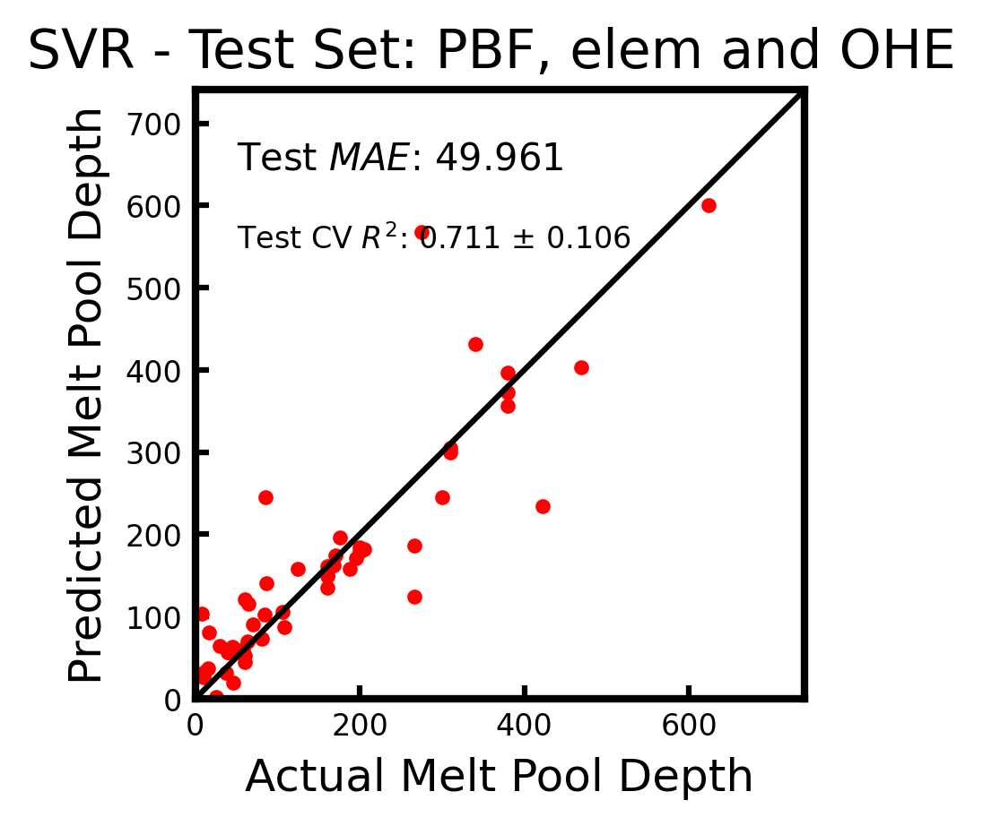

<Figure size 432x288 with 0 Axes>

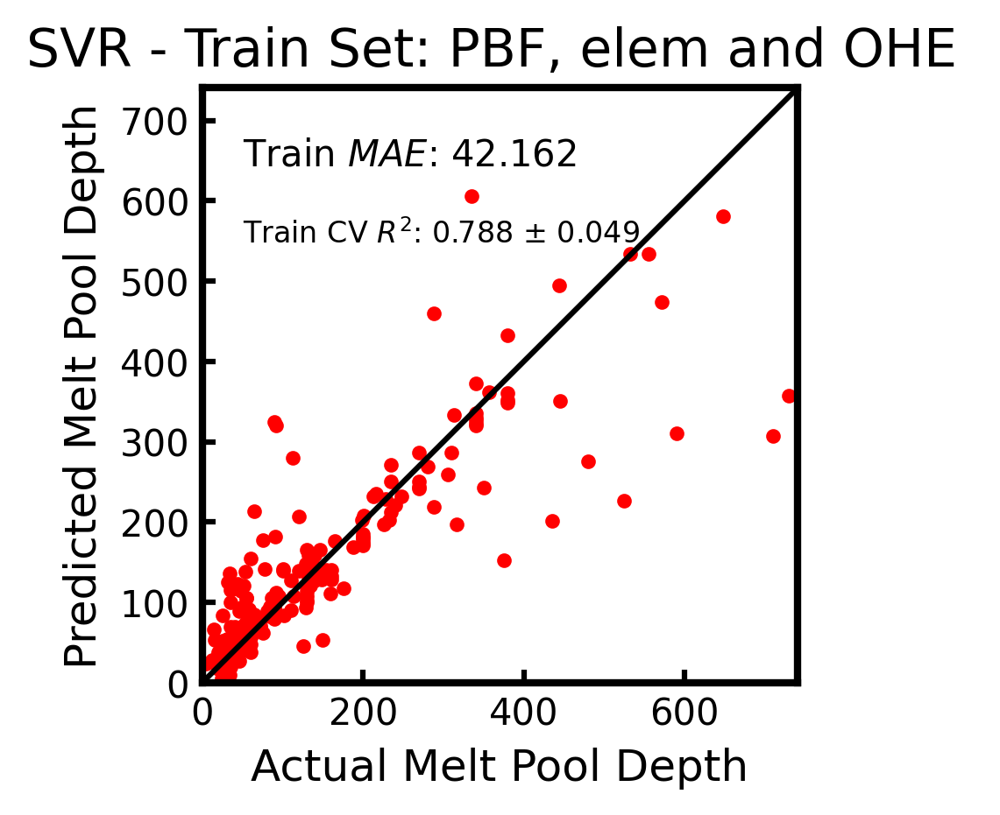

Ridge  Train R^2: 0.76104 ± 0.02736, Test R^2: 0.61531 ± 0.19336


<Figure size 432x288 with 0 Axes>

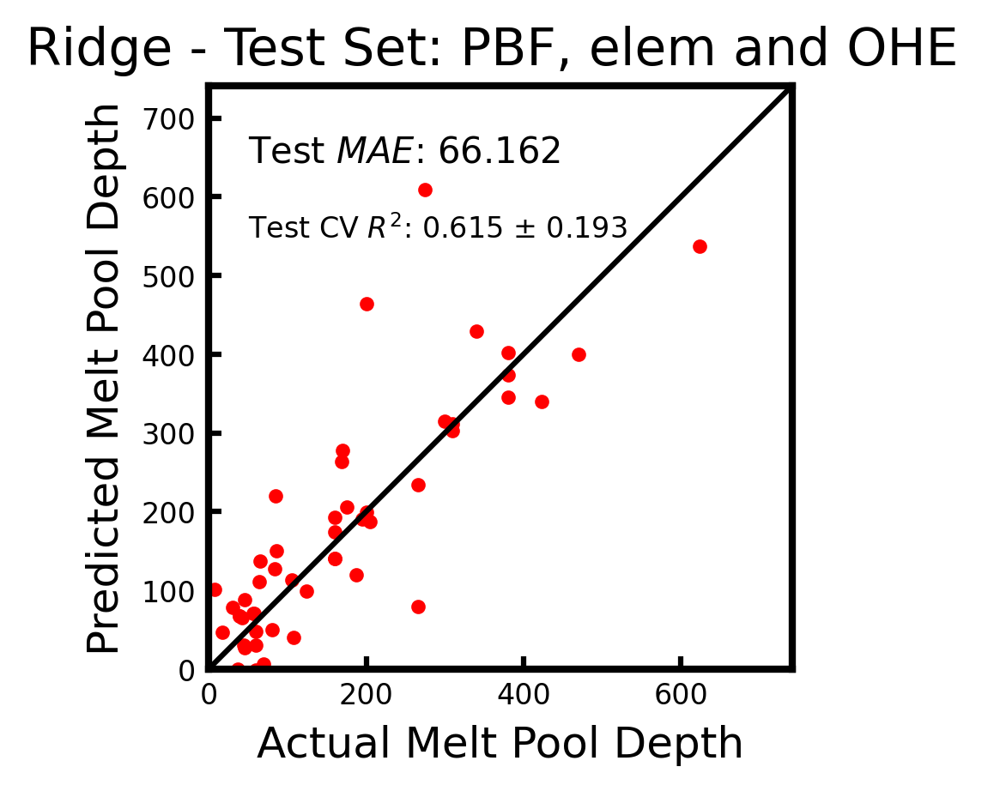

<Figure size 432x288 with 0 Axes>

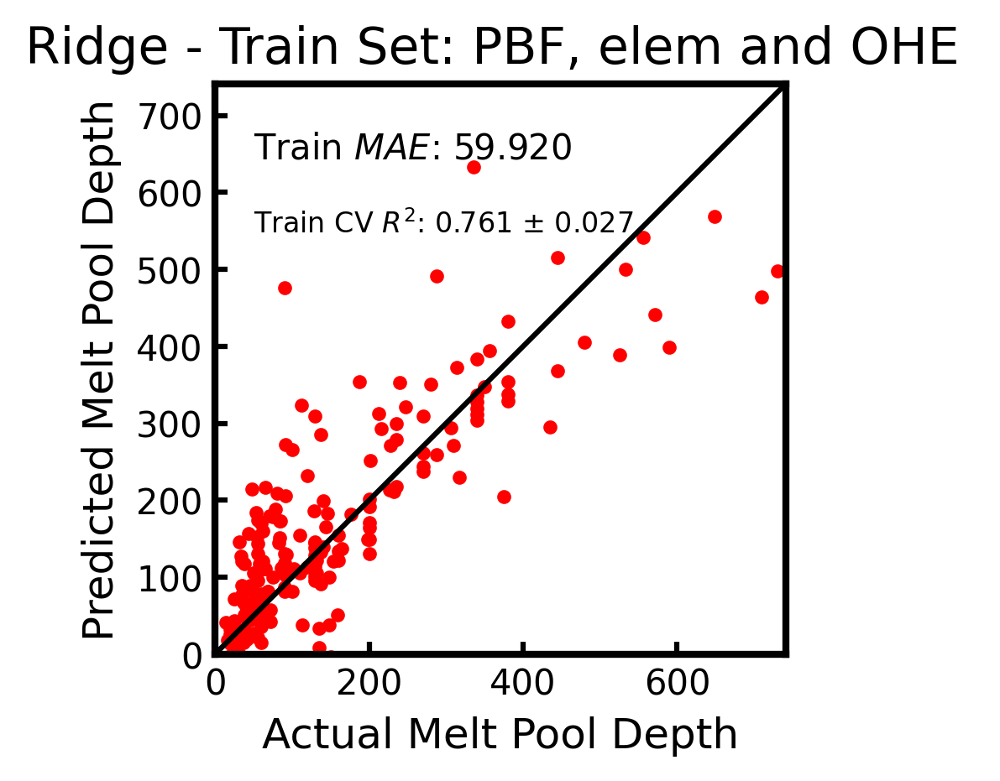

Lasso  Train R^2: 0.62942 ± 0.03494, Test R^2: 0.34189 ± 0.47801


<Figure size 432x288 with 0 Axes>

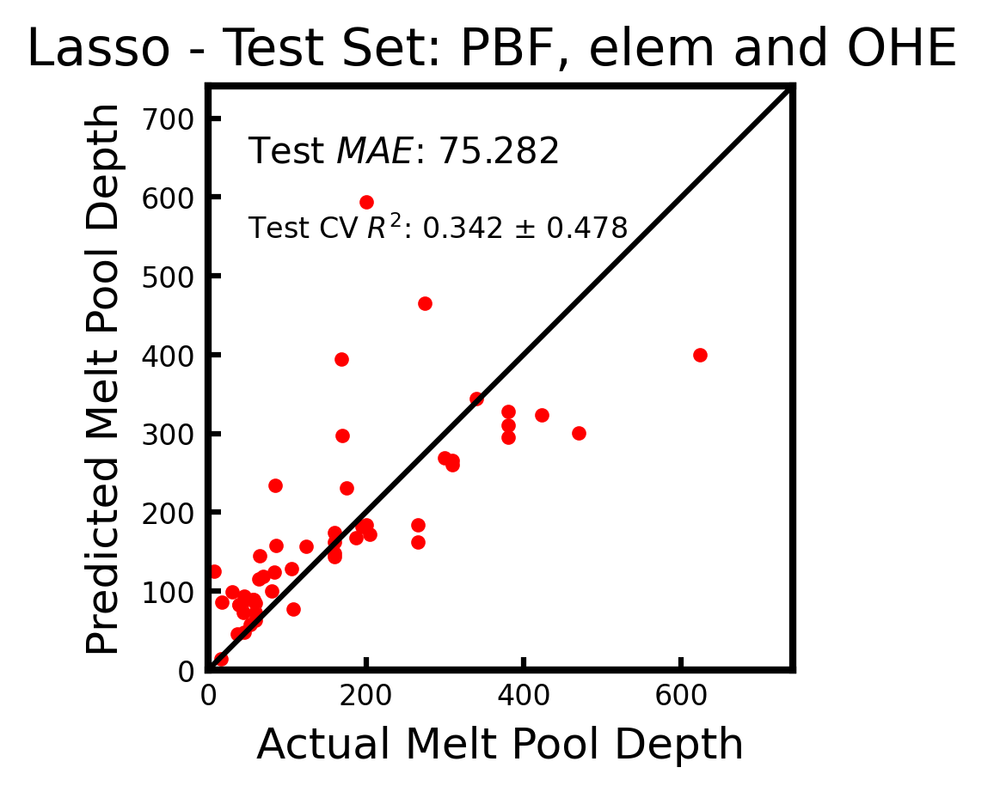

<Figure size 432x288 with 0 Axes>

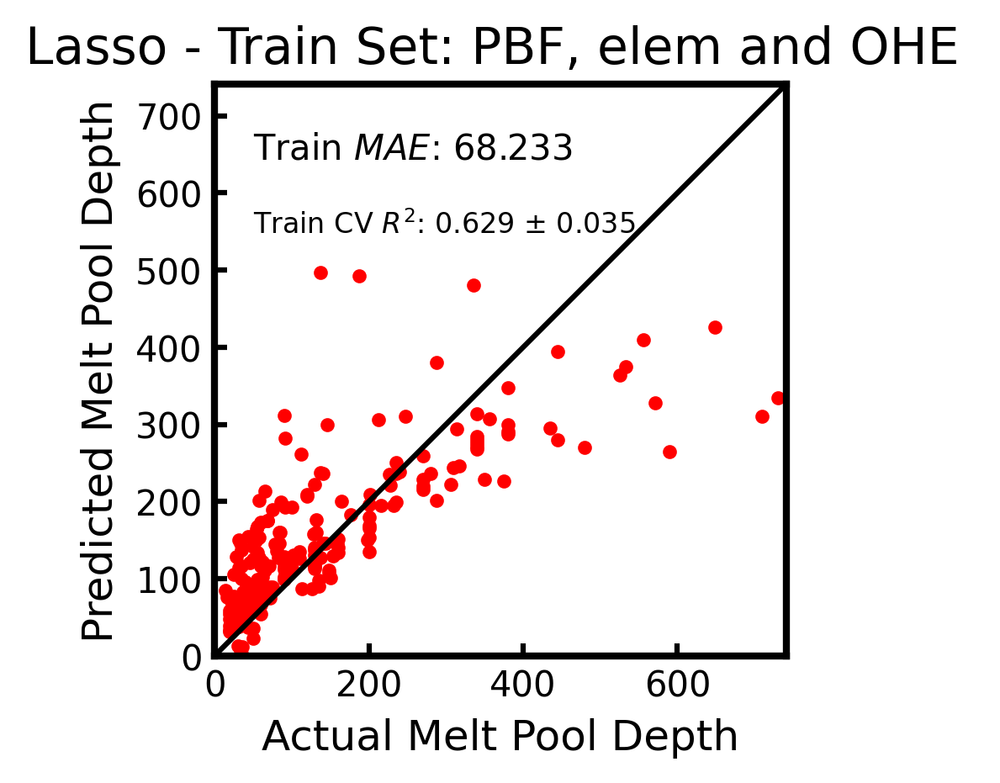

GB  Train R^2: 0.99028 ± 0.00222, Test R^2: 0.82314 ± 0.09009


<Figure size 432x288 with 0 Axes>

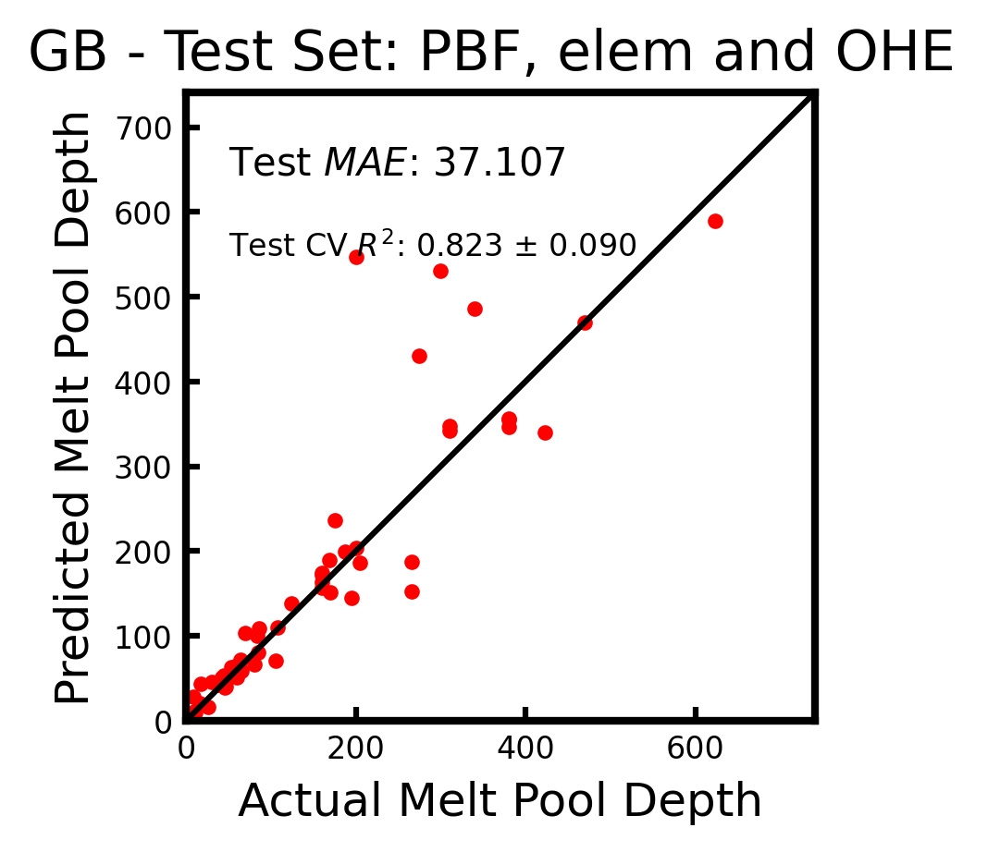

<Figure size 432x288 with 0 Axes>

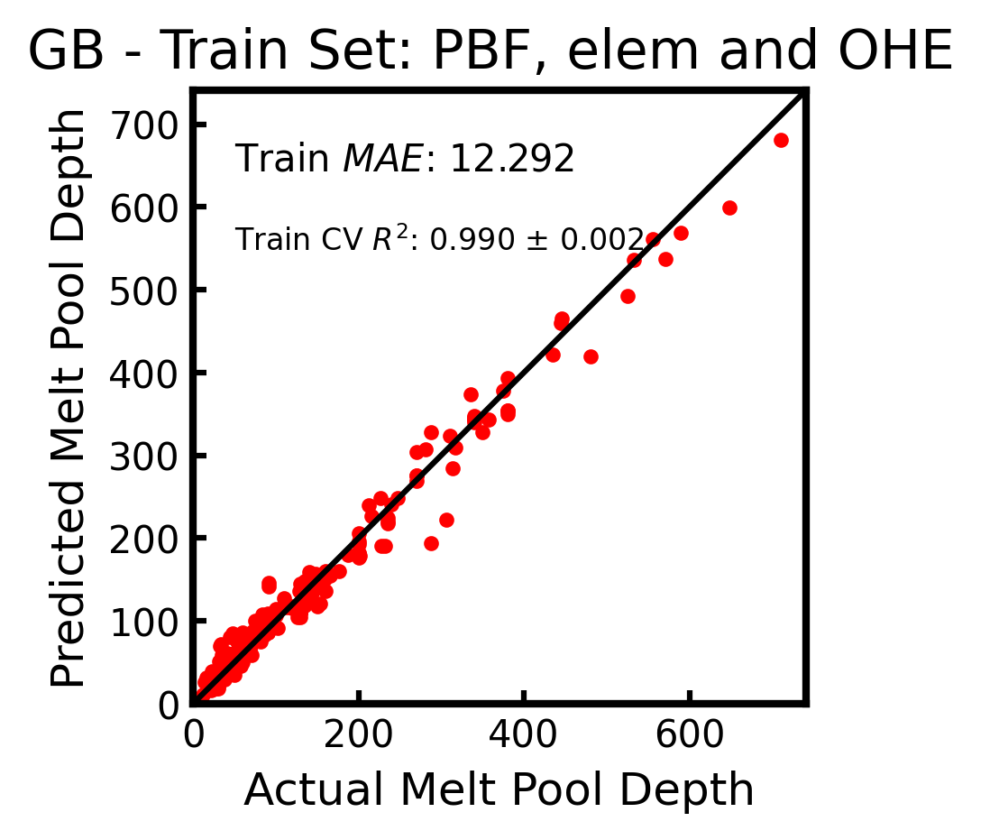

NN  Train R^2: 0.98433 ± 0.00325, Test R^2: 0.90647 ± 0.06478


<Figure size 432x288 with 0 Axes>

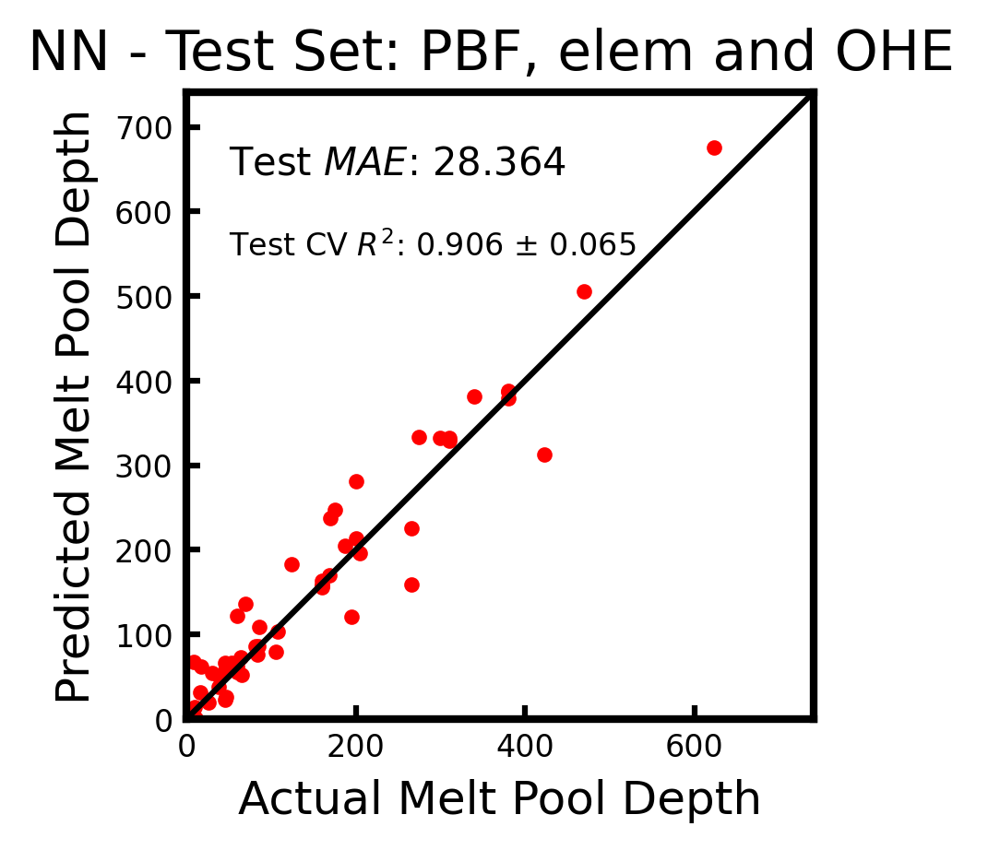

<Figure size 432x288 with 0 Axes>

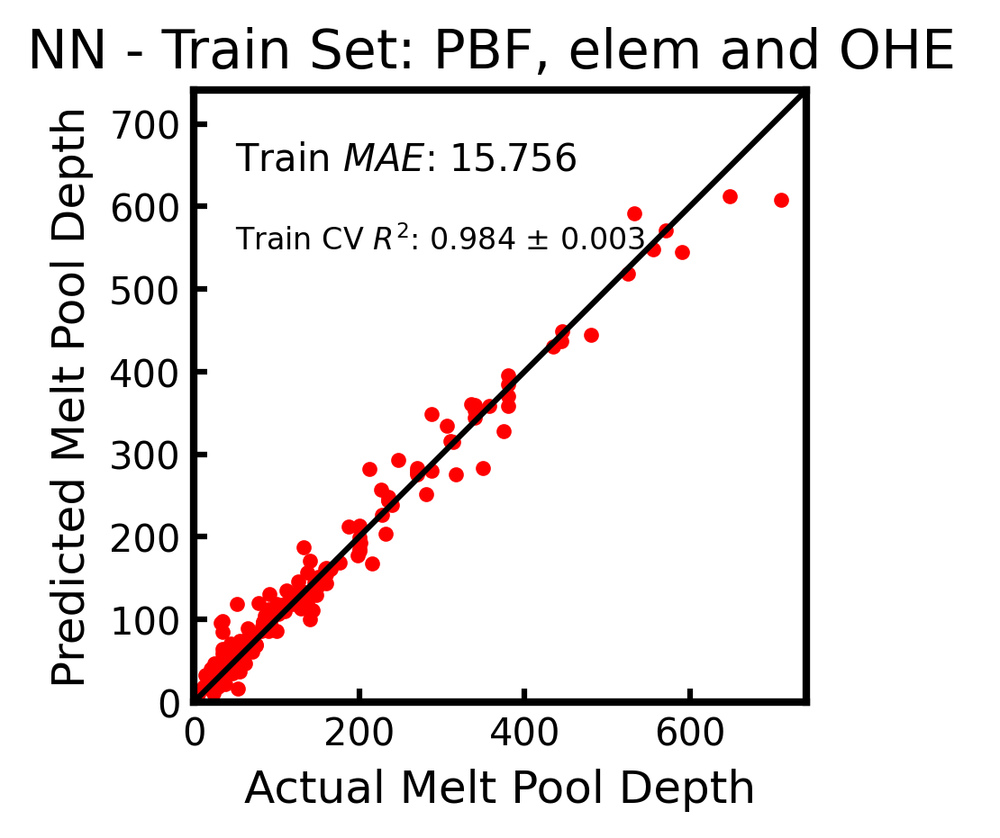

<Figure size 432x288 with 0 Axes>

In [35]:
# Including absorption coefficient
%matplotlib inline
# Define parameters that models will be trained on and value to be predicted

parameter_list = ['Power', 'Velocity', 'density', 'Cp', 'k' , 'beam D', 'melting T', 'layer thickness',
                  'absorption coefficient', 'absorption coefficient 2']
#parameter_list.extend(atomic_features)

label_col = 'depth of meltpool'

# Form dataset array from dataframe, given parameter_list, label_col
# function select_parameters() does this as well
data_list = []
label_list = []
elem_feature_list = []
materials_present = []
new_csv = select_process(csv, 'PBF')
count = 0
for i in range(len(new_csv)):
    success, features, label = extract_features(new_csv.iloc[i], parameter_list, label_col)
    
    if success < 0:
        continue
    else:
        print(i)
        current_elemental_features = featurize_datapoint(new_csv, i)
        data_list.append(features)
        label_list.append(label)
        elem_feature_list.append(current_elemental_features)
        materials_present.append(new_csv['Material'].iloc[i])
        count += 1
print('length in PBF data: ', len(new_csv))
print('Used data points: ', count)        
X = np.array(np.squeeze(data_list))  

y = np.array(label_list)
elemental_features = np.array(elem_feature_list)

materials_ohe = [np.zeros(len(materials_present)) for key in materials.keys()]
len(materials_ohe)
materials_ohe = np.array(materials_ohe).T
#breakpoint()
#materials.keys()
print(len(materials_ohe))
material_pos = np.arange(len(materials.keys()))
for idx in range(len(materials_present)):
    for j_idx in range(len(material_pos)):
      #  breakpoint()
        if materials_present[idx] == materials.keys()[j_idx]:
            
            materials_ohe[idx,j_idx] = 1 

fit_models, train_accuracy_elemohe, train_accuracy_std_elemohe, test_accuracy_elemohe, test_accuracy_std_elemohe  = learn(X.reshape(-1, len(parameter_list)), y, parameters = parameter_list, plot = True, title = 'PBF, elem and OHE ', elemental_features = elemental_features, materials_ohe = materials_ohe )


### Regression task including P/D parameters, elemental features

12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
94
95
96
97
98
99
100
101
138
140
141
142
145
182
183
184
185
186
187
188
189
190
191
192
193
194
195
260
261
262
263
264
265
271
272
273
274
275
276
277
278
279
280
281
282
283
284
285
286
287
288
289
290
291
292
293
294
295
296
297
298
299
300
301
302
303
304
305
306
307
308
309
310
311
312
313
314
315
316
317
318
319
320
321
322
323
324
325
346
347
348
349
350
351
352
353
354
355
356
357
358
359
360
361
362
363
364
365
366
367
368
369
370
371
372
373
374
375
376
377
378
379
380
381
382
383
384
385
386
387
388
389
390
391
392
393
394
395
396
397
398
399
400
401
402
403
404
405
406
407
408
409
410
411
412
413
414
415
416
417
418
419
420
421
422
423
424
425
426
427
428
429
430
431
432
433
434
435
436
437
438
439
440
441
442
443
444
445
446
447
448
449
450
451
452
453
454
455
456
457
458
459
460
461
462
463
464
465
466
467
468
477
478
479
480
481
482
483
484
485
486
487
488
489
490
491
736
737
738
739
740
741
742
743
744


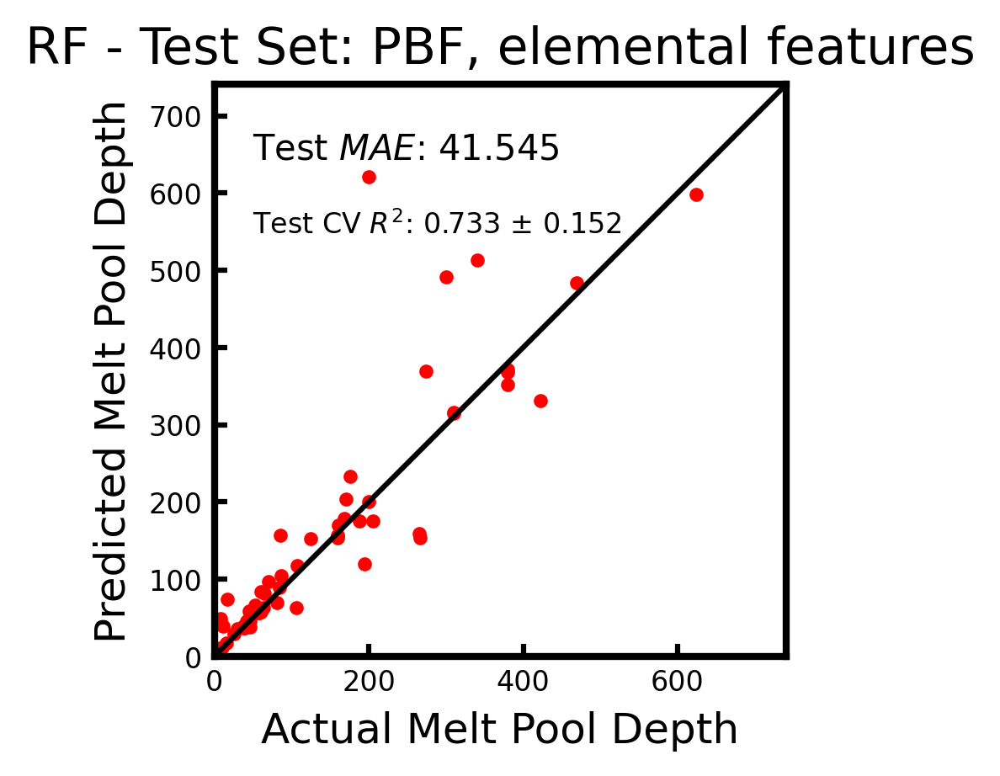

<Figure size 432x288 with 0 Axes>

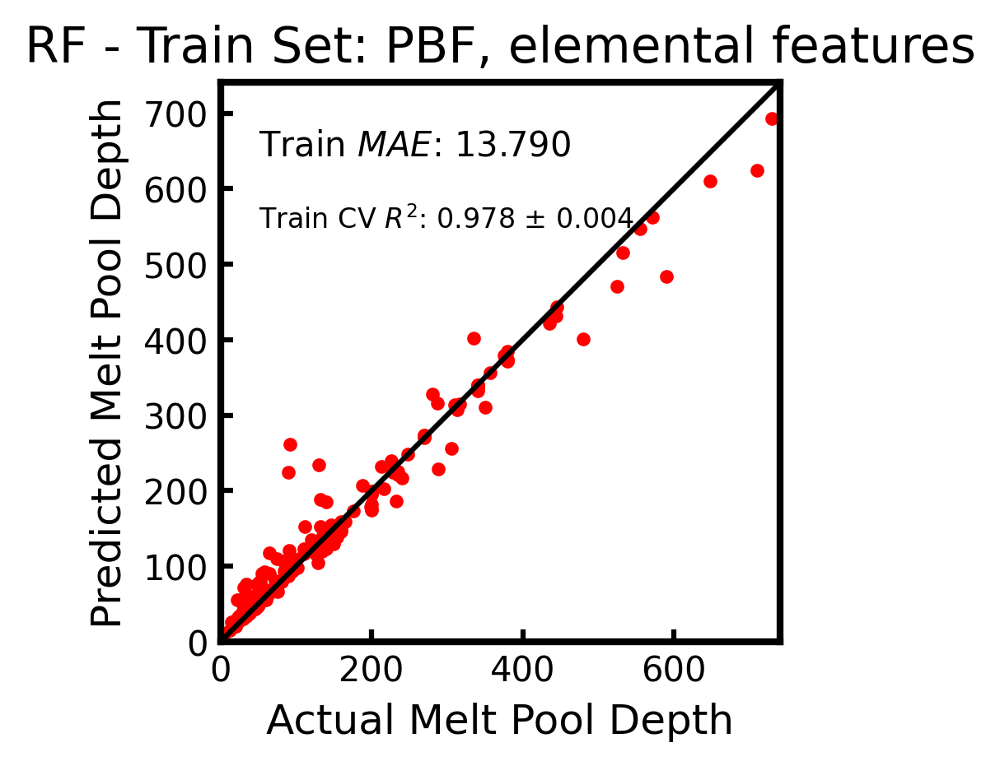

GPR  Train R^2: 0.90950 ± 0.00715, Test R^2: 0.79436 ± 0.09990


<Figure size 432x288 with 0 Axes>

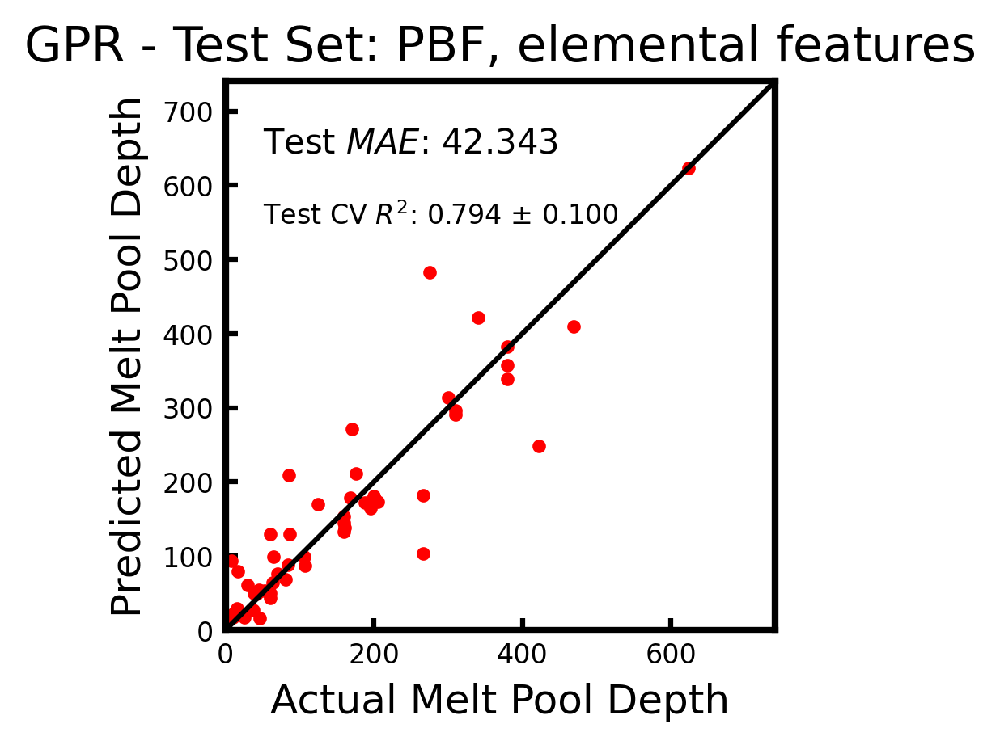

<Figure size 432x288 with 0 Axes>

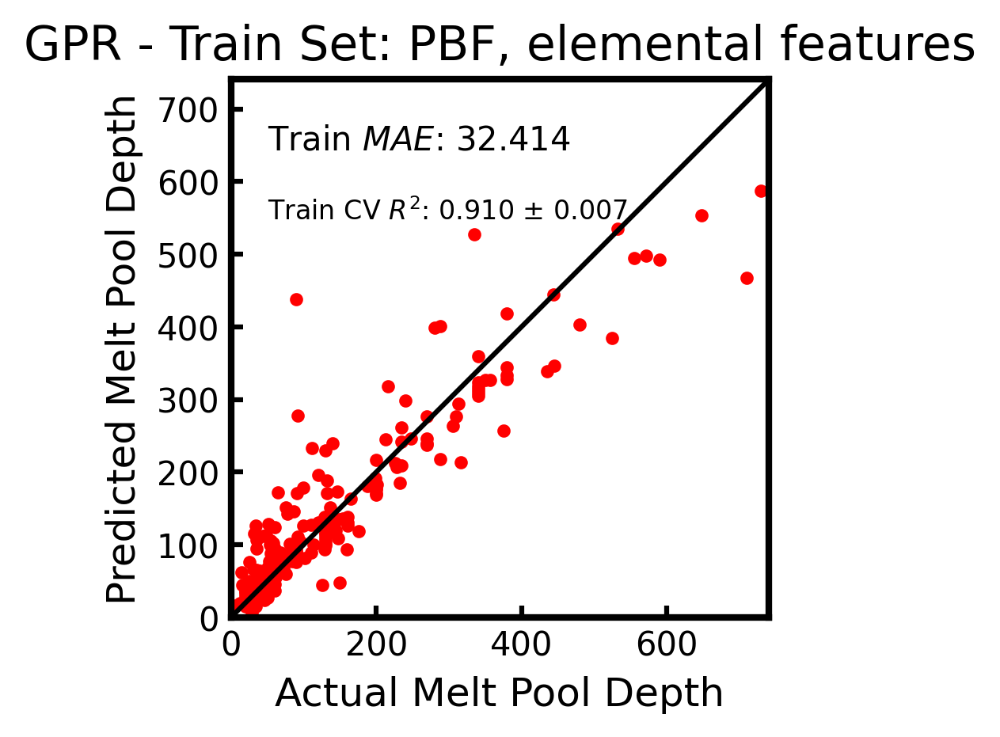

SVR  Train R^2: 0.79212 ± 0.04819, Test R^2: 0.71192 ± 0.10879


<Figure size 432x288 with 0 Axes>

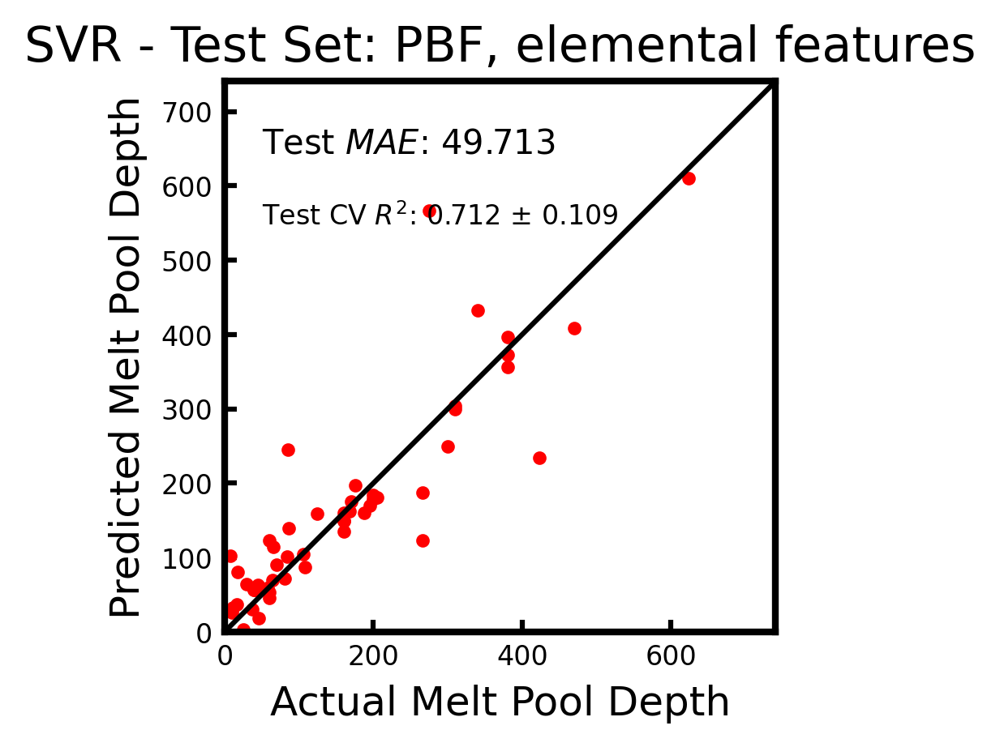

<Figure size 432x288 with 0 Axes>

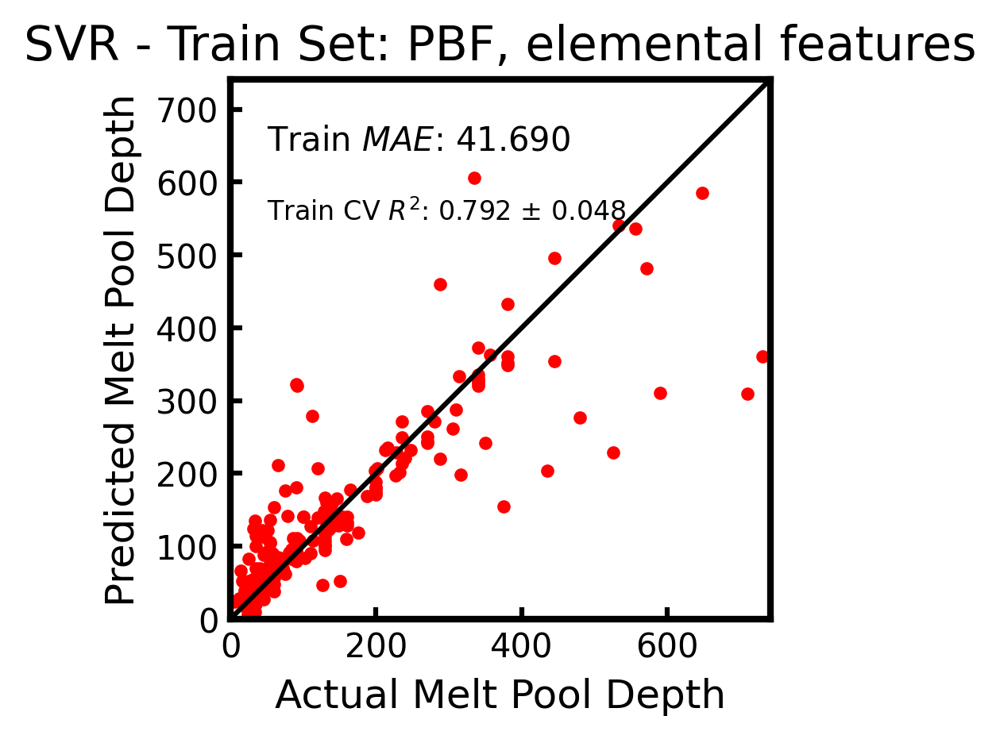

Ridge  Train R^2: 0.76104 ± 0.02736, Test R^2: 0.61530 ± 0.19342


<Figure size 432x288 with 0 Axes>

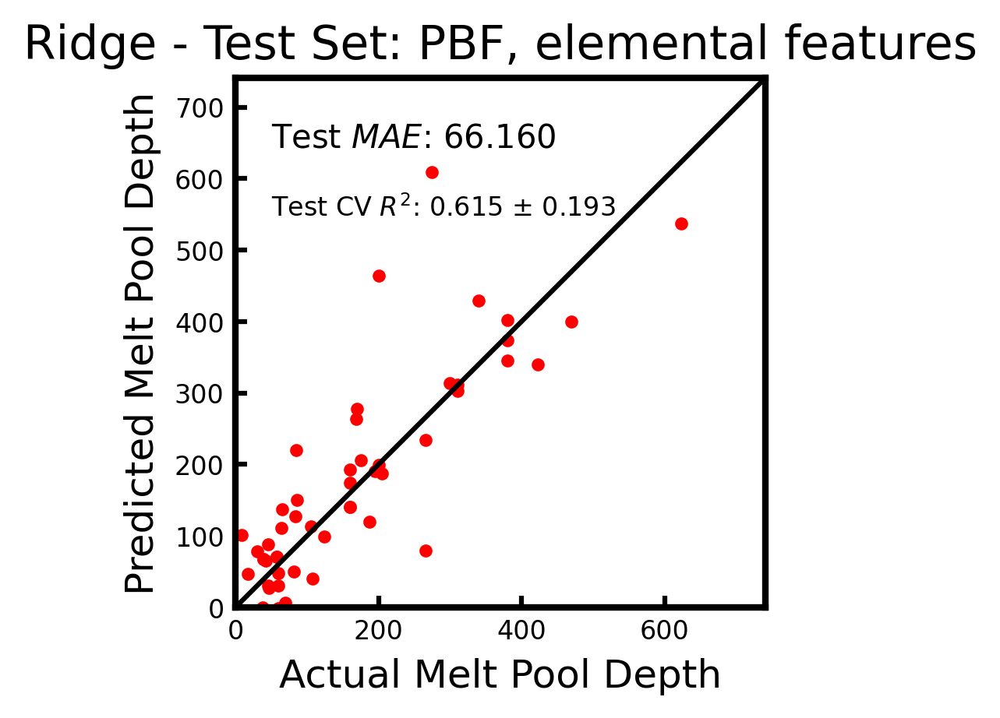

<Figure size 432x288 with 0 Axes>

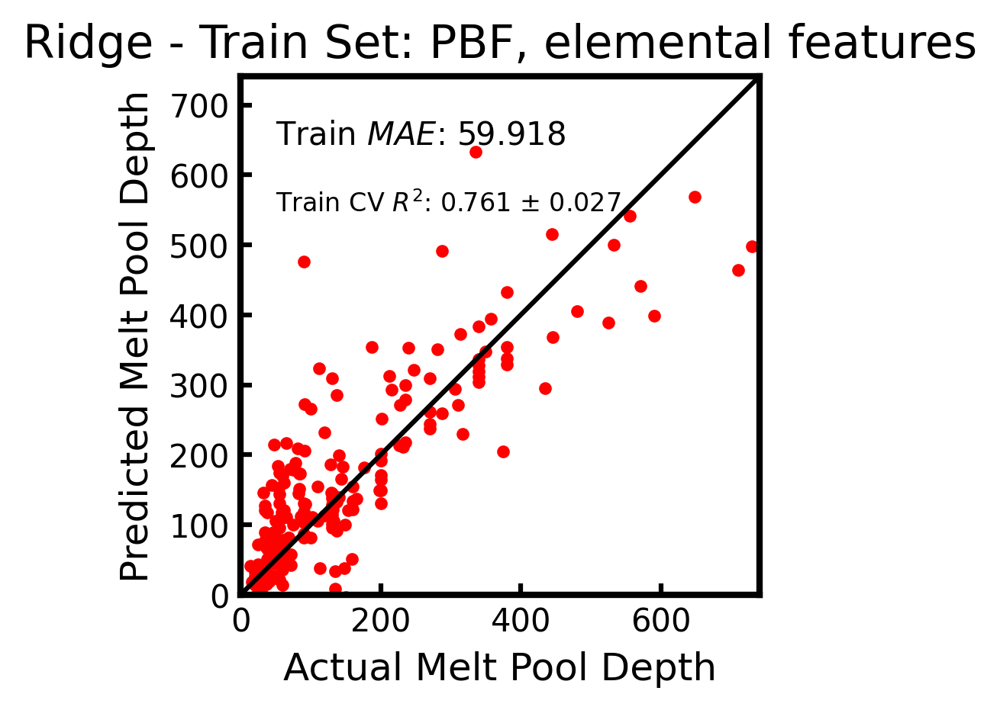

Lasso  Train R^2: 0.62942 ± 0.03494, Test R^2: 0.34189 ± 0.47801


<Figure size 432x288 with 0 Axes>

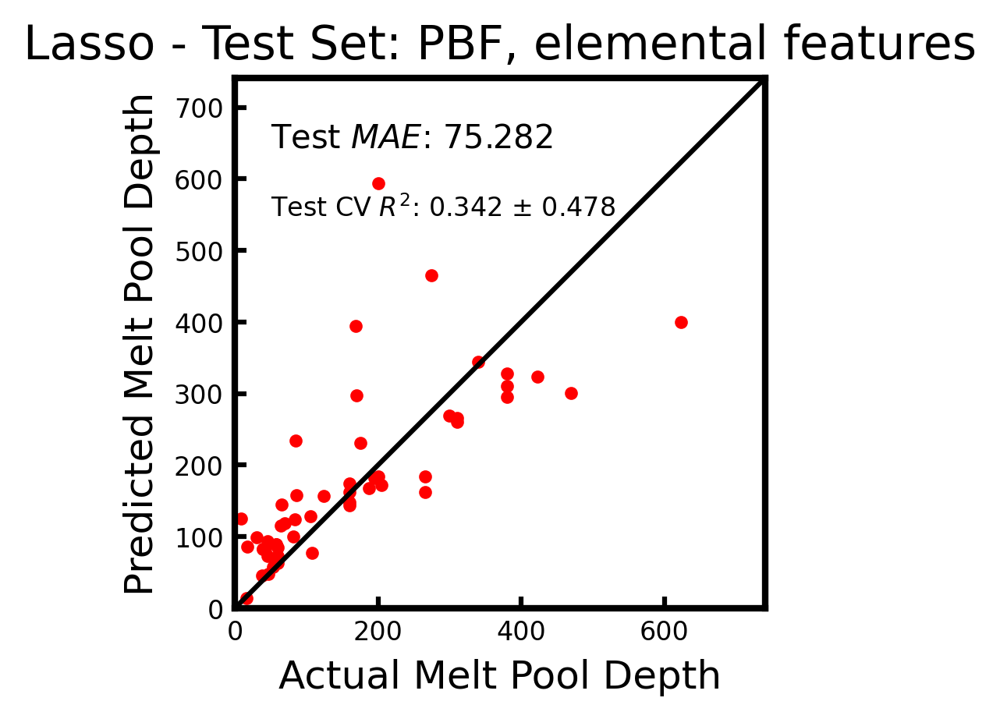

<Figure size 432x288 with 0 Axes>

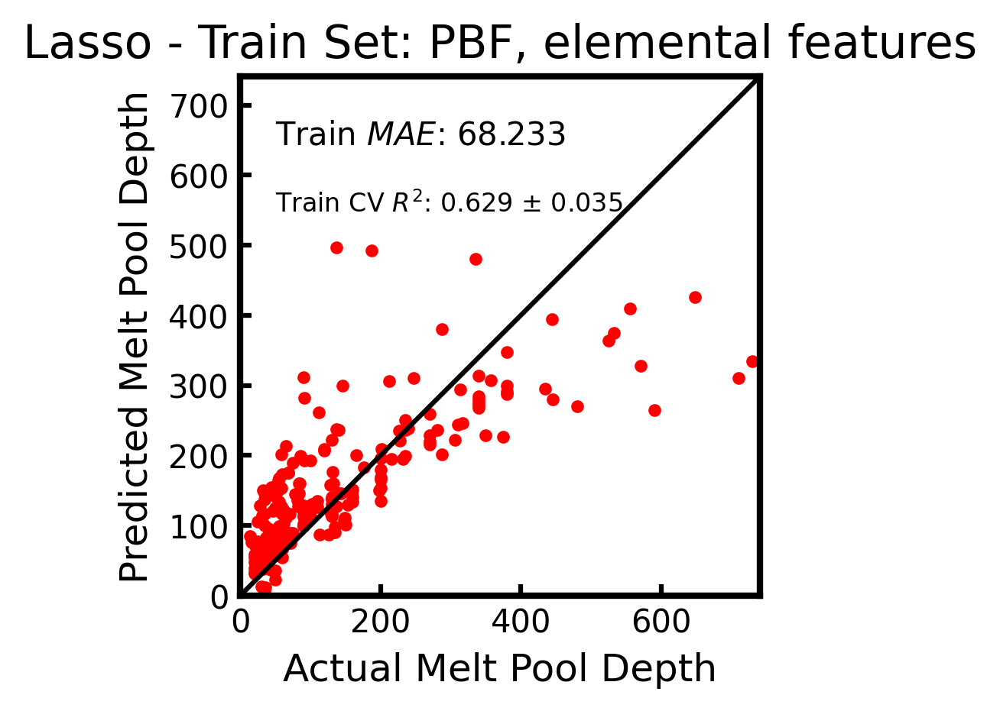

GB  Train R^2: 0.99028 ± 0.00222, Test R^2: 0.82495 ± 0.08837


<Figure size 432x288 with 0 Axes>

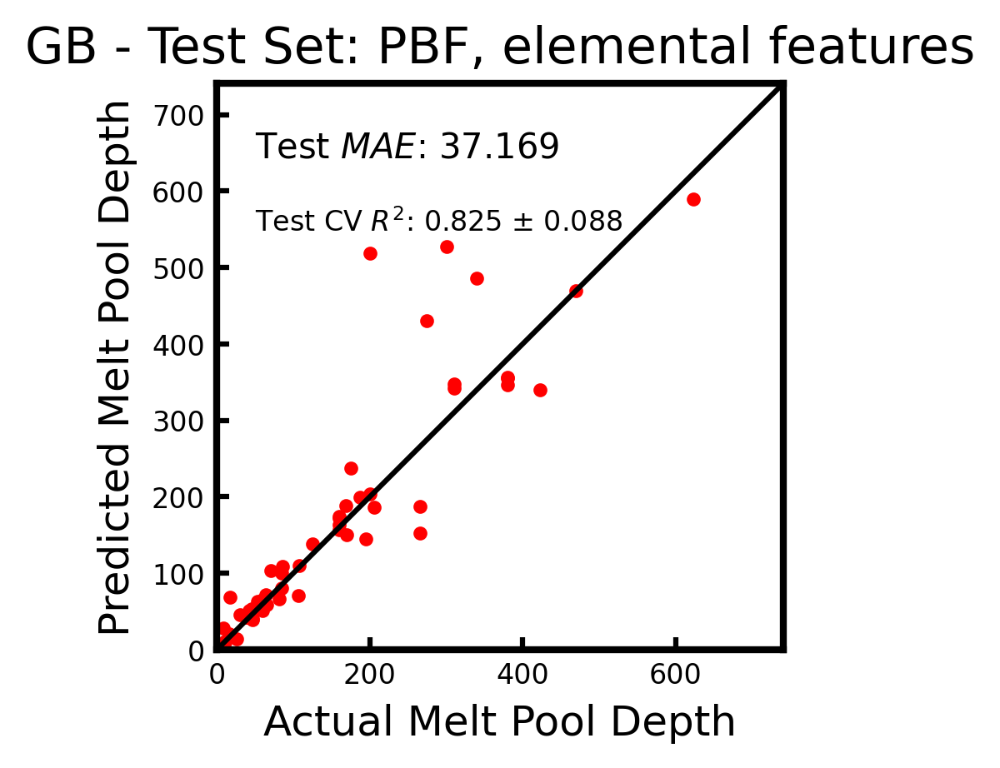

<Figure size 432x288 with 0 Axes>

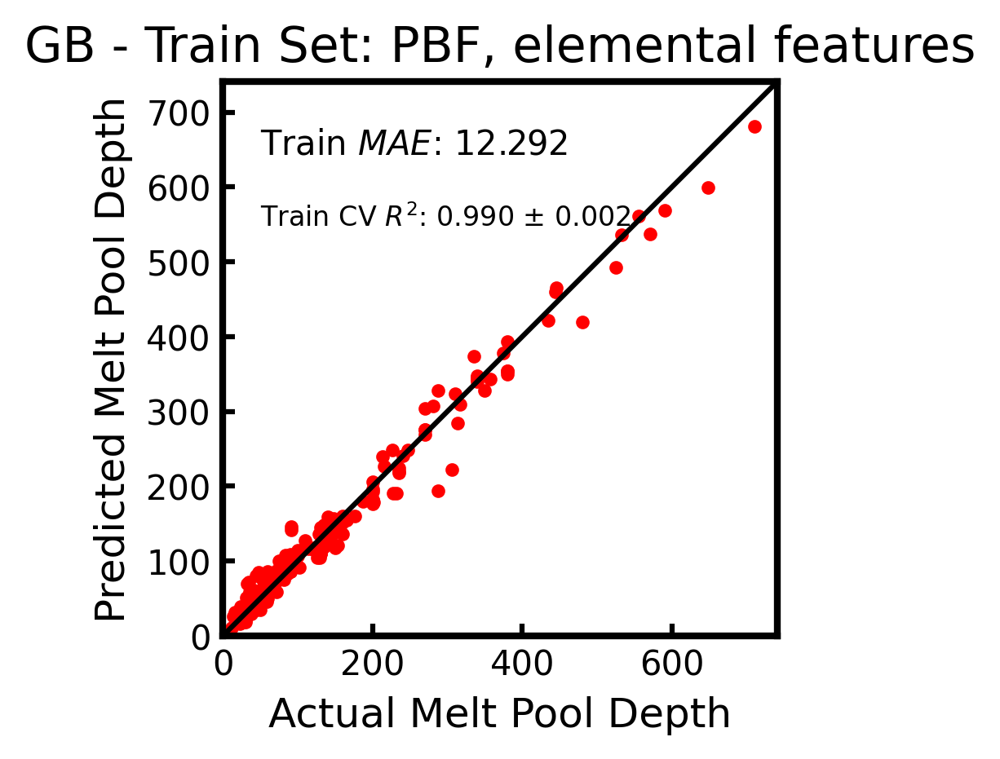

NN  Train R^2: 0.97994 ± 0.00835, Test R^2: 0.89576 ± 0.07043


<Figure size 432x288 with 0 Axes>

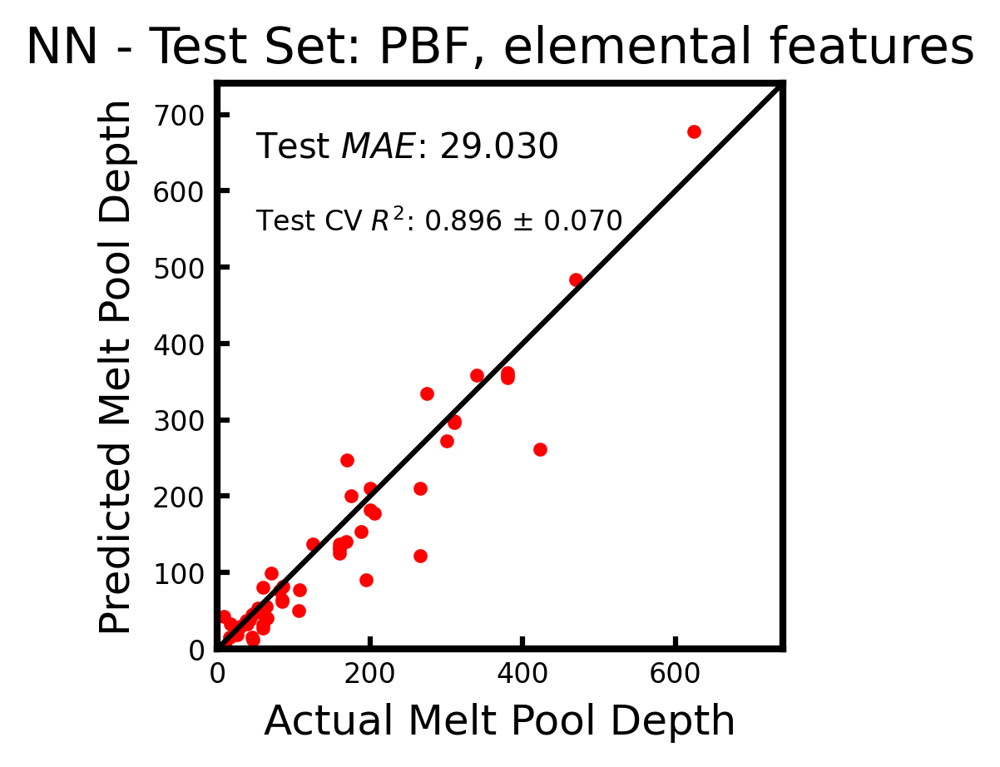

<Figure size 432x288 with 0 Axes>

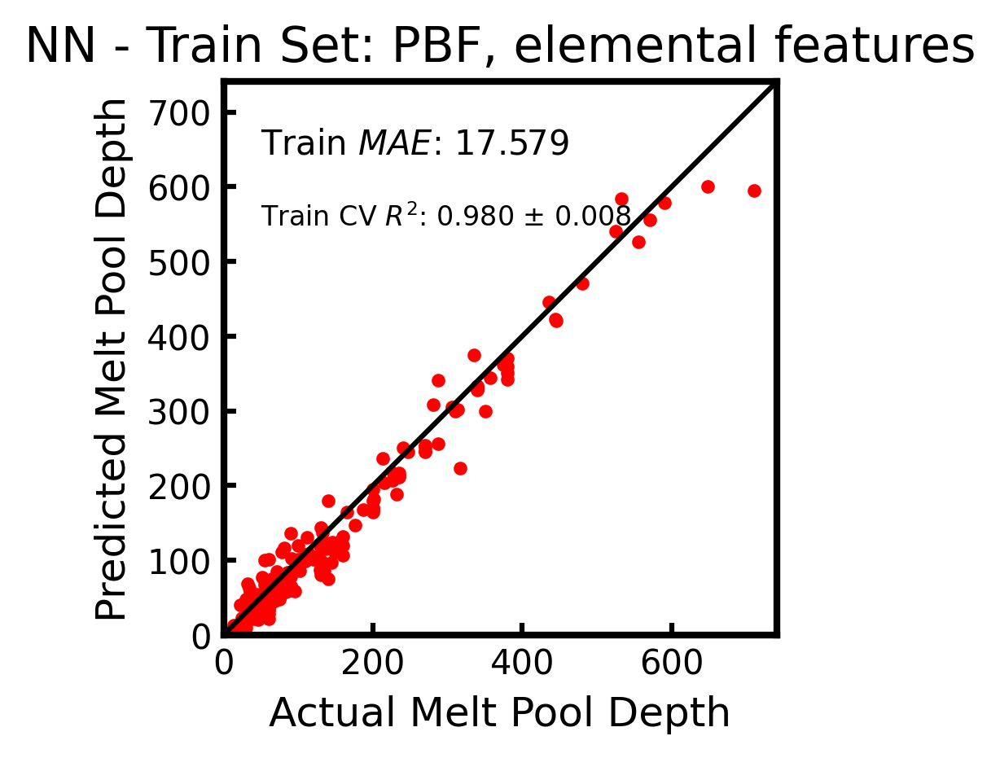

<Figure size 432x288 with 0 Axes>

In [36]:
# Including absorption coefficient
%matplotlib inline
# Define parameters that models will be trained on and value to be predicted

parameter_list = ['Power', 'Velocity', 'density', 'Cp', 'k' , 'beam D', 'melting T', 'layer thickness',
                  'absorption coefficient', 'absorption coefficient 2']
#parameter_list.extend(atomic_features)

label_col = 'depth of meltpool'

# Form dataset array from dataframe, given parameter_list, label_col
# function select_parameters() does this as well
data_list = []
label_list = []
elem_feature_list = []
new_csv = select_process(csv, 'PBF')
count = 0
for i in range(len(new_csv)):
    success, features, label = extract_features(new_csv.iloc[i], parameter_list, label_col)
    
    if success < 0:
        continue
    else:
        print(i)
        current_elemental_features = featurize_datapoint(new_csv, i)
        data_list.append(features)
        label_list.append(label)
        elem_feature_list.append(current_elemental_features)
        count += 1
print('length in PBF data: ', len(new_csv))
print('Used data points: ', count)        
X = np.array(np.squeeze(data_list))  

y = np.array(label_list)
elemental_features = np.array(elem_feature_list)

fit_models, train_accuracy_elem, train_accuracy_std_elem, test_accuracy_elem, test_accuracy_std_elem  = learn(X.reshape(-1, len(parameter_list)), y, parameters = parameter_list, plot = True, title = 'PBF, elemental features', elemental_features = elemental_features )


### Regression with replaced ***Thermodynamic parameters***

12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
94
95
96
97
98
99
100
101
138
140
141
142
145
182
183
184
185
186
187
188
189
190
191
192
193
194
195
260
261
262
263
264
265
271
272
273
274
275
276
277
278
279
280
281
282
283
284
285
286
287
288
289
290
291
292
293
294
295
296
297
298
299
300
301
302
303
304
305
306
307
308
309
310
311
312
313
314
315
316
317
318
319
320
321
322
323
324
325
346
347
348
349
350
351
352
353
354
355
356
357
358
359
360
361
362
363
364
365
366
367
368
369
370
371
372
373
374
375
376
377
378
379
380
381
382
383
384
385
386
387
388
389
390
391
392
393
394
395
396
397
398
399
400
401
402
403
404
405
406
407
408
409
410
411
412
413
414
415
416
417
418
419
420
421
422
423
424
425
426
427
428
429
430
431
432
433
434
435
436
437
438
439
440
441
442
443
444
445
446
447
448
449
450
451
452
453
454
455
456
457
458
459
460
461
462
463
464
465
466
467
468
477
478
479
480
481
482
483
484
485
486
487
488
489
490
491
736
737
738
739
740
741
742
743
744


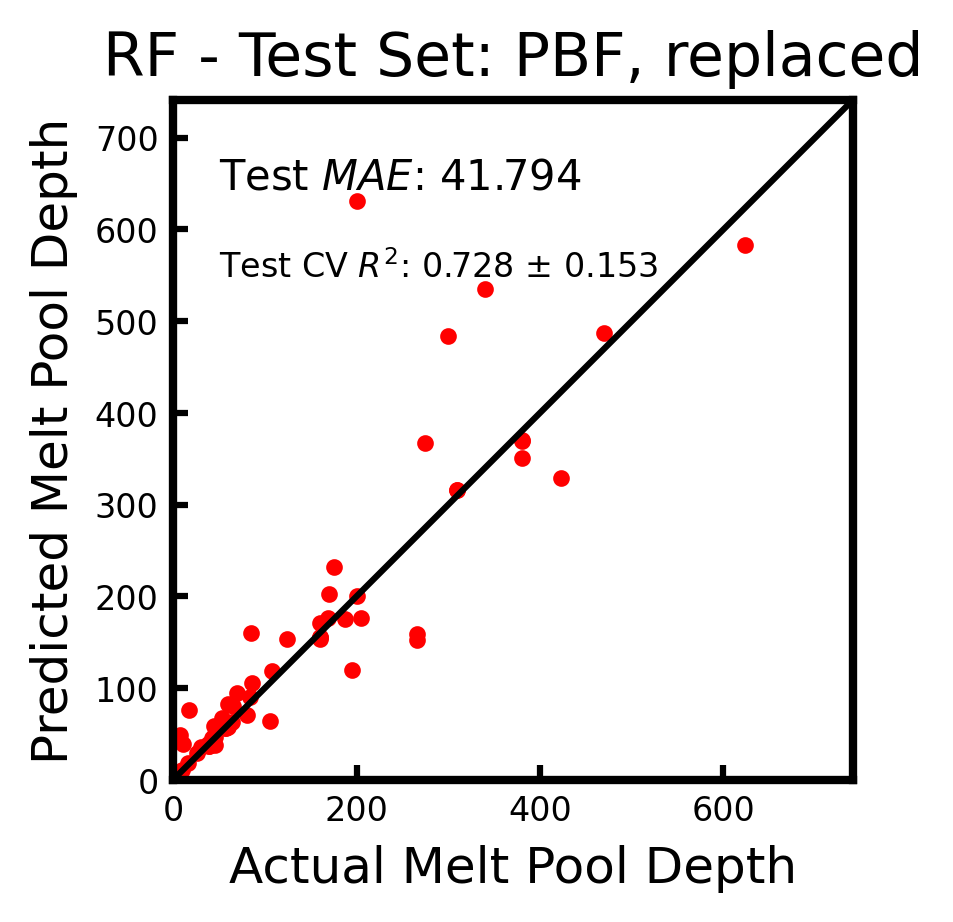

<Figure size 432x288 with 0 Axes>

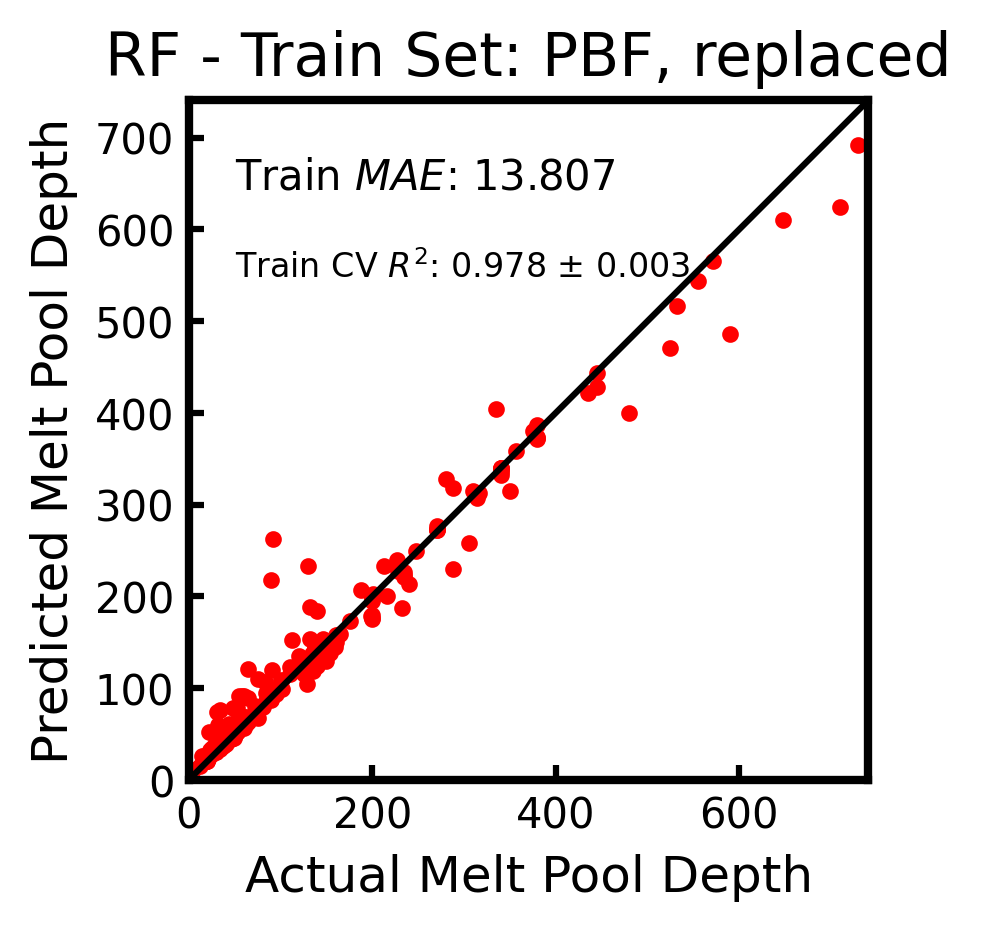

GPR  Train R^2: 0.90177 ± 0.00839, Test R^2: 0.78625 ± 0.10543


<Figure size 432x288 with 0 Axes>

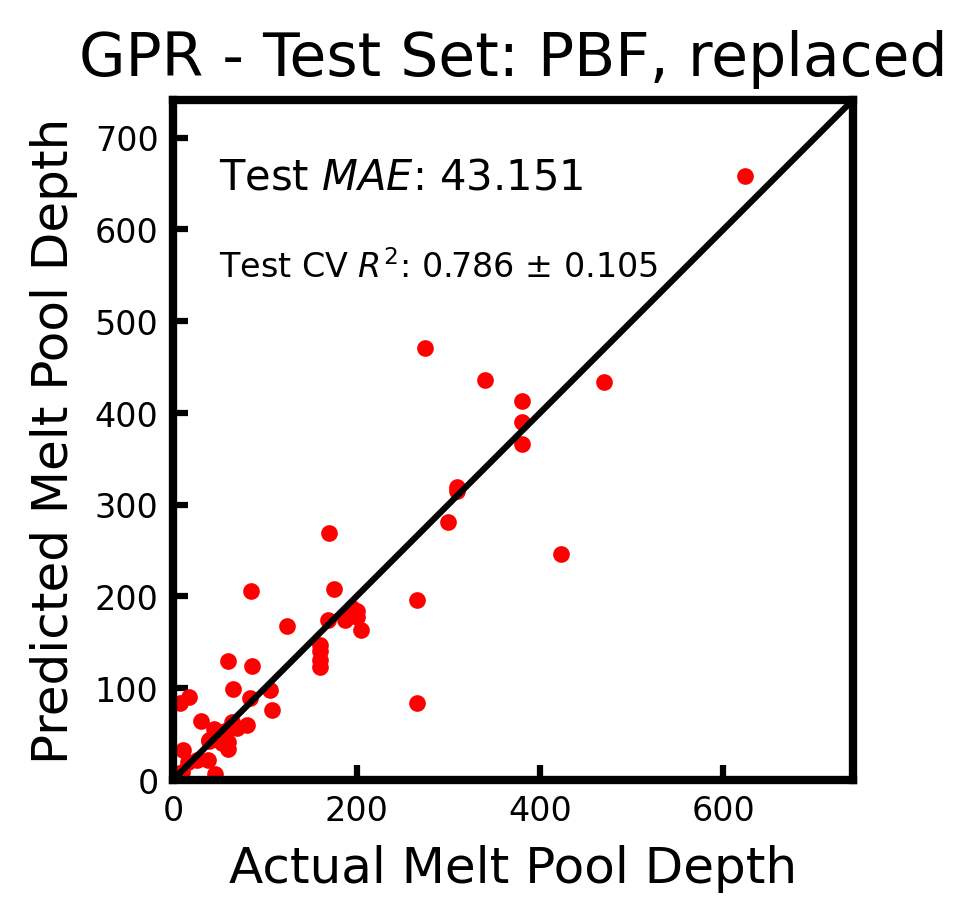

<Figure size 432x288 with 0 Axes>

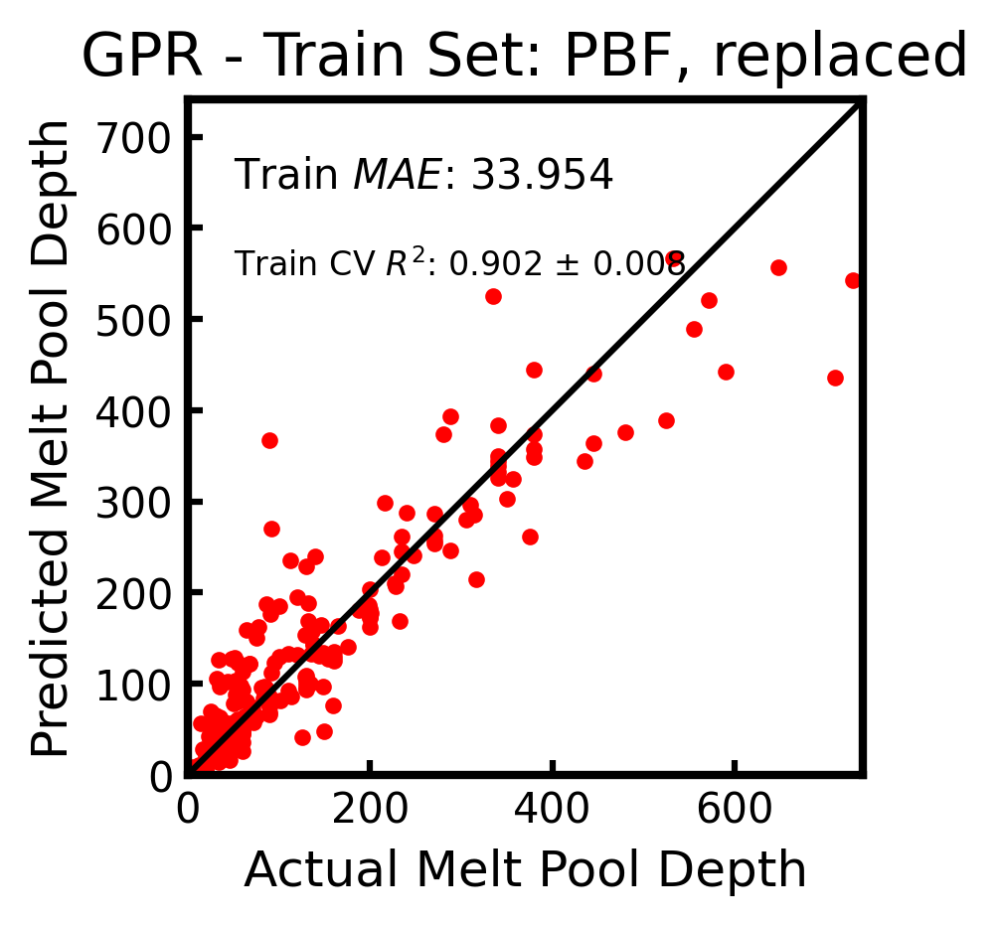

SVR  Train R^2: 0.83367 ± 0.04085, Test R^2: 0.75655 ± 0.10963


<Figure size 432x288 with 0 Axes>

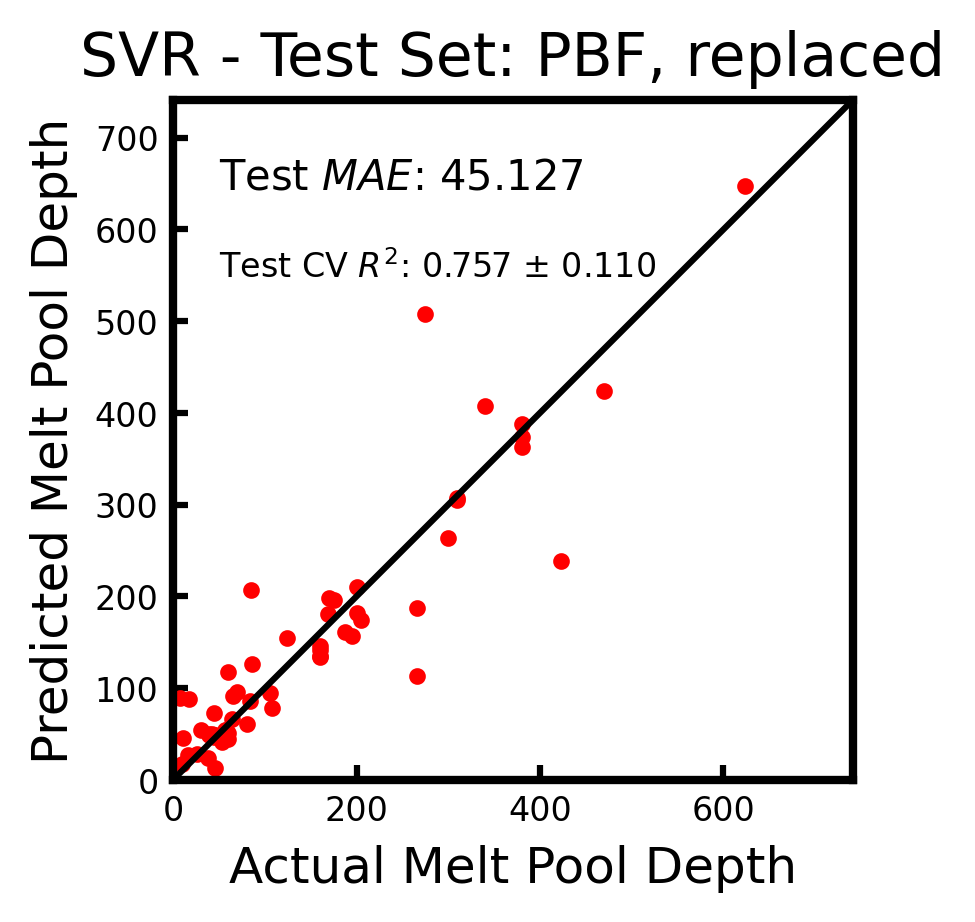

<Figure size 432x288 with 0 Axes>

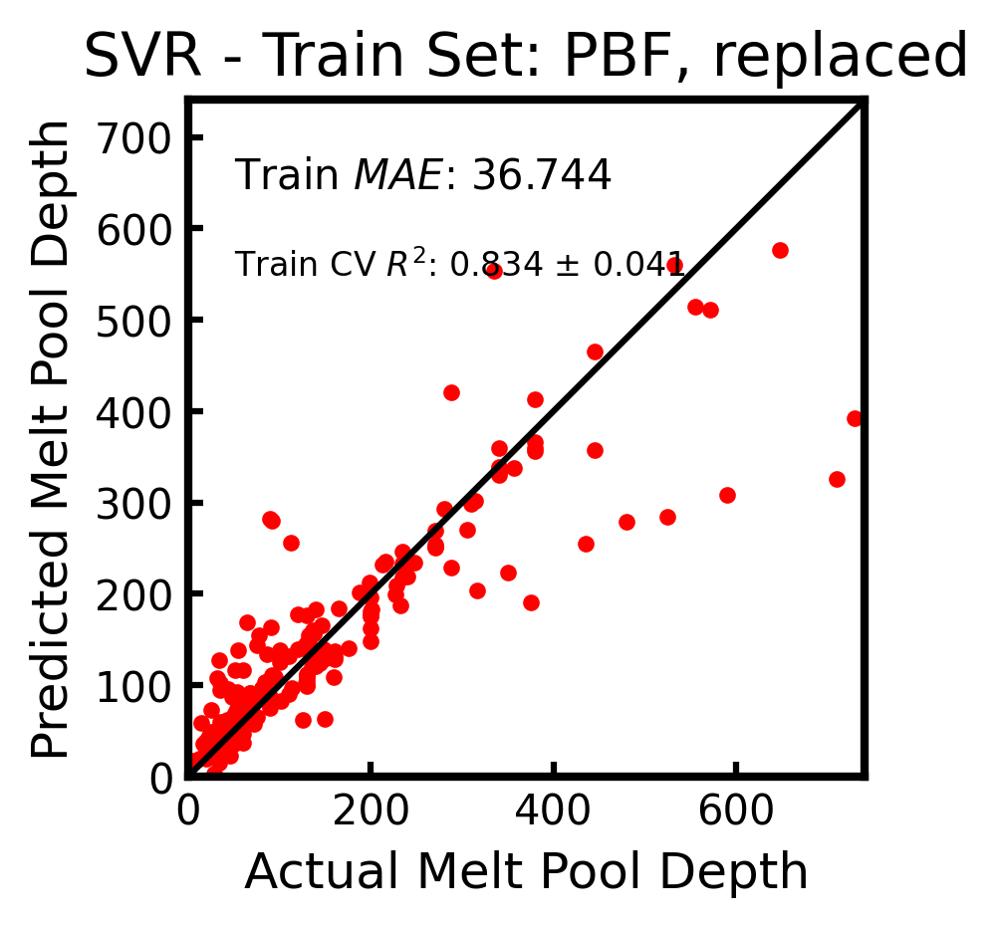

Ridge  Train R^2: 0.74745 ± 0.02918, Test R^2: 0.58661 ± 0.24458


<Figure size 432x288 with 0 Axes>

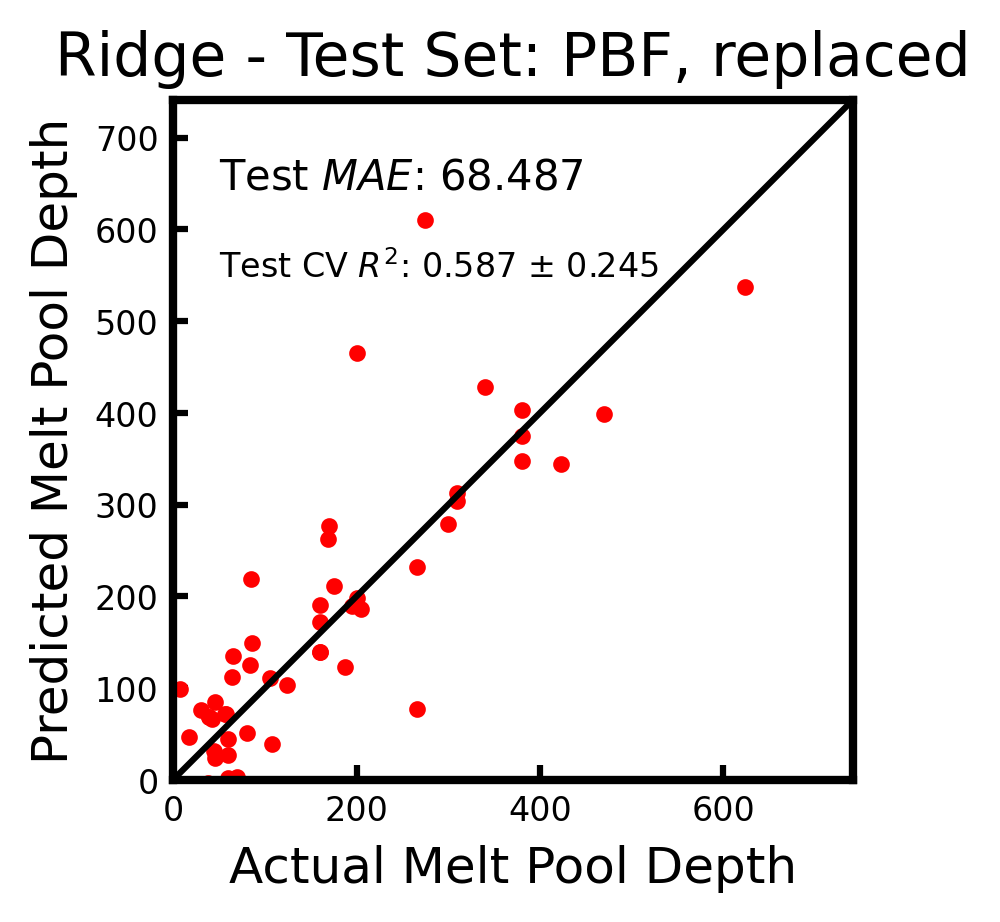

<Figure size 432x288 with 0 Axes>

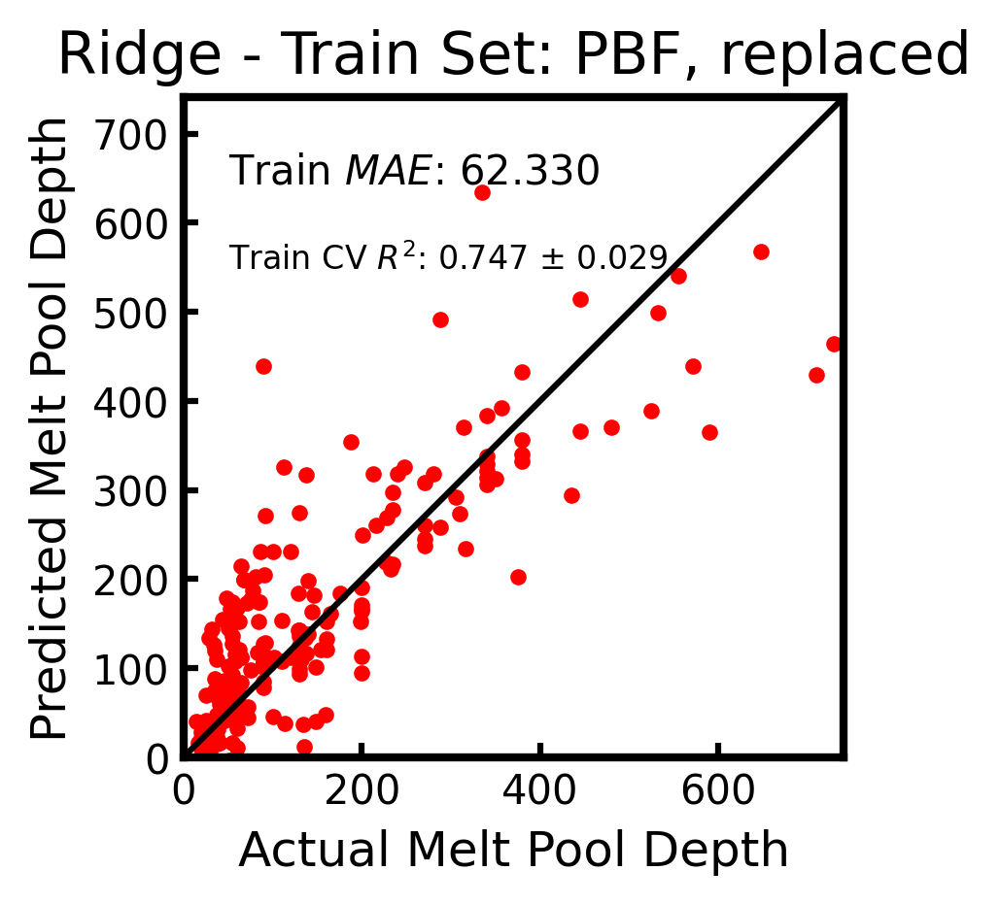

Lasso  Train R^2: 0.60448 ± 0.04105, Test R^2: 0.30628 ± 0.50506


<Figure size 432x288 with 0 Axes>

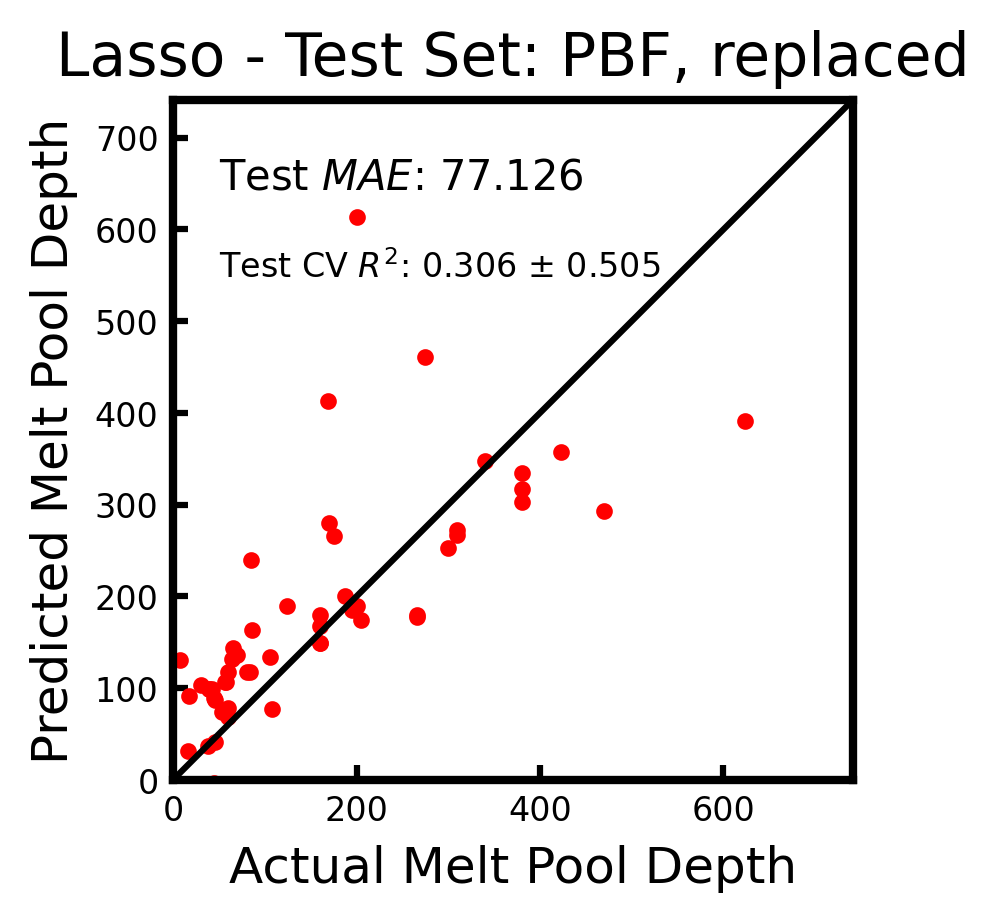

<Figure size 432x288 with 0 Axes>

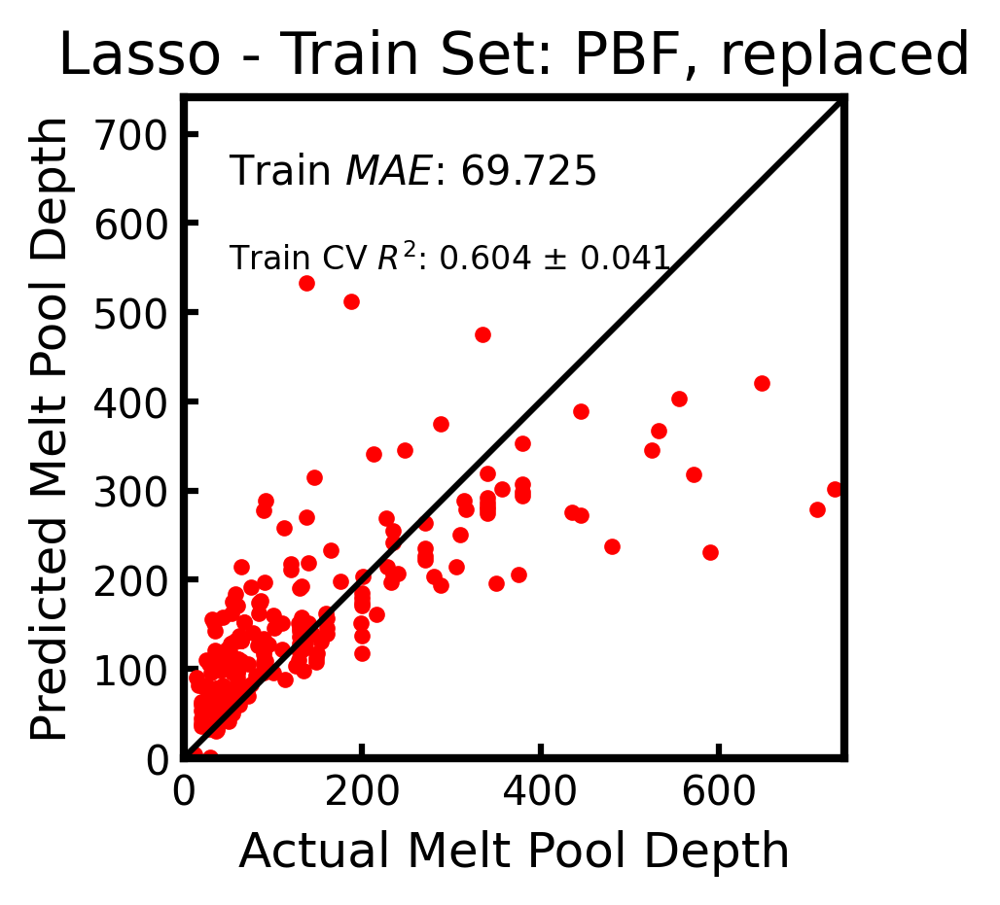

GB  Train R^2: 0.98998 ± 0.00223, Test R^2: 0.81611 ± 0.09771


<Figure size 432x288 with 0 Axes>

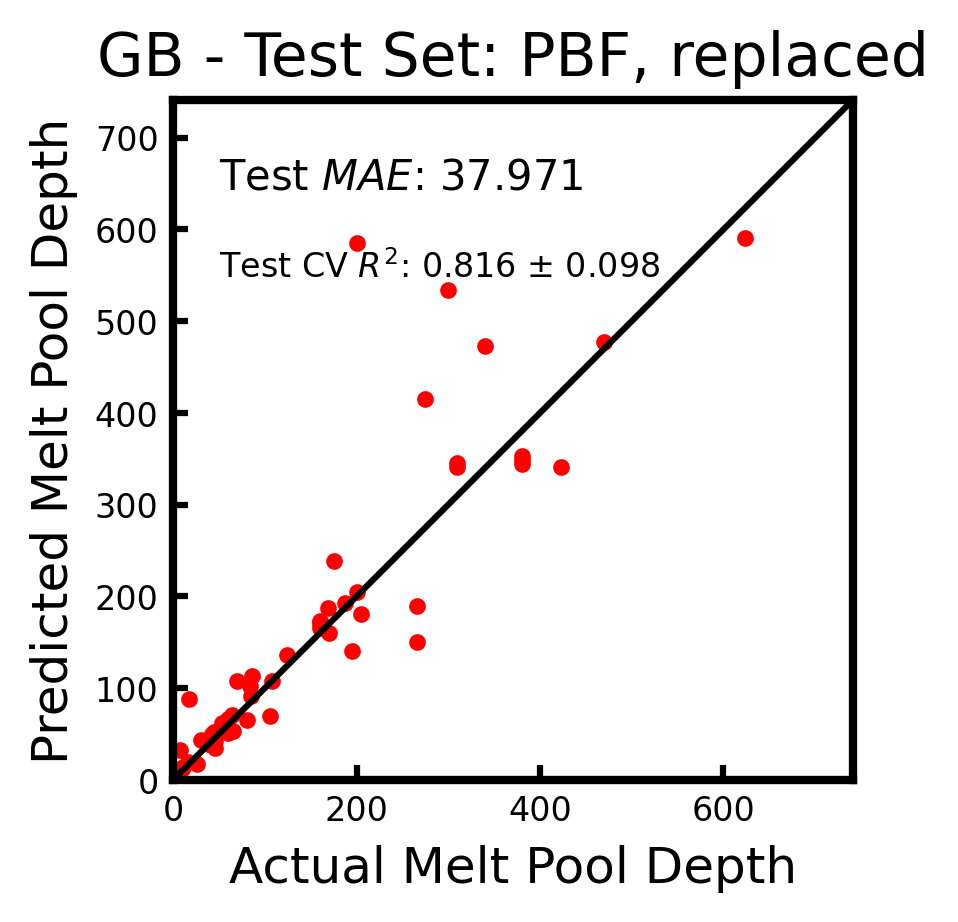

<Figure size 432x288 with 0 Axes>

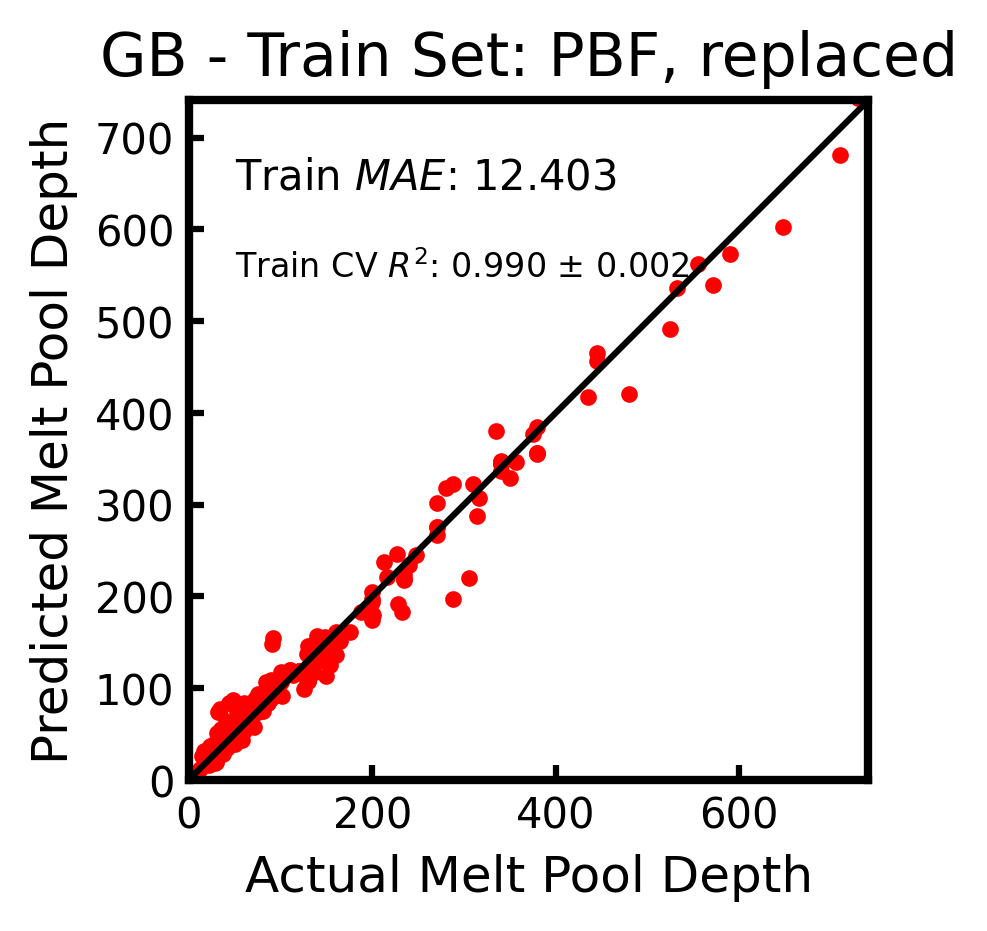

NN  Train R^2: 0.98461 ± 0.00787, Test R^2: 0.92425 ± 0.03812


<Figure size 432x288 with 0 Axes>

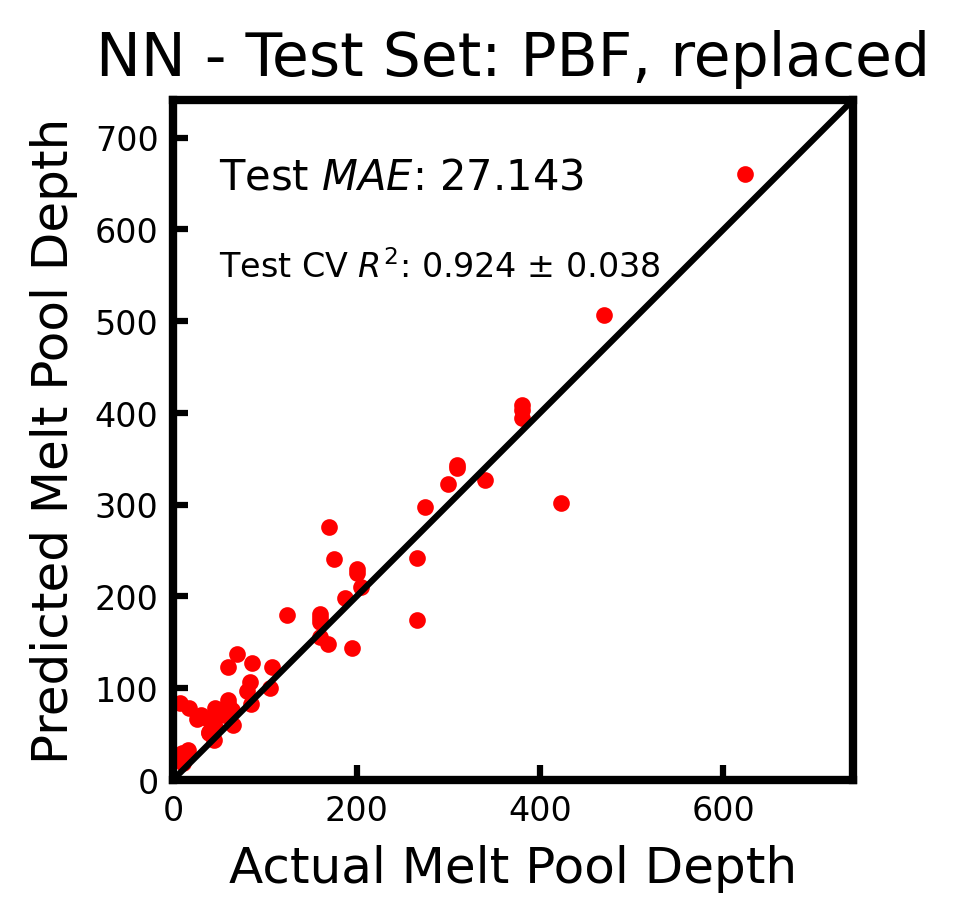

<Figure size 432x288 with 0 Axes>

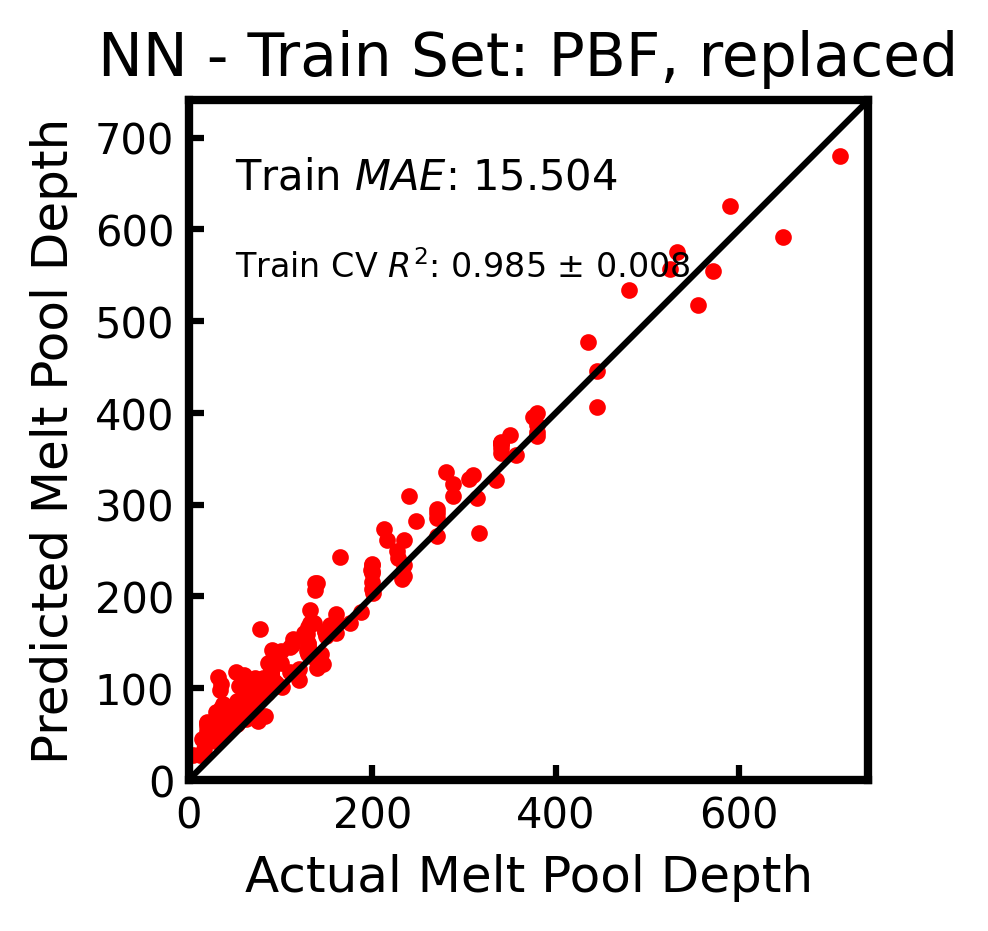

<Figure size 432x288 with 0 Axes>

In [37]:
%matplotlib inline
# Define parameters that models will be trained on and value to be predicted

parameter_list = ['Power', 'Velocity' , 'beam D', 'layer thickness',
                  'absorption coefficient', 'absorption coefficient 2']

label_col = 'depth of meltpool'

# Form dataset array from dataframe, given parameter_list, label_col
# function select_parameters() does this as well
data_list = []
label_list = []
elem_feature_list = []
new_csv = select_process(csv, 'PBF')
count = 0
for i in range(len(new_csv)):
    success, features, label = extract_features(new_csv.iloc[i], parameter_list, label_col)
    
    if success < 0:
        continue
    else:
        print(i)
        current_elemental_features = featurize_datapoint_rp(new_csv, i)
        data_list.append(features)
        label_list.append(label)
        elem_feature_list.append(current_elemental_features)
        count += 1
print('length in PBF data: ', len(new_csv))
print('Used data points: ', count)          
X = np.array(np.squeeze(data_list))  

y = np.array(label_list)
elemental_features = np.array(elem_feature_list)

fit_models_rp, train_accuracy_rp, train_accuracy_std_rp, test_accuracy_rp, test_accuracy_std_rp  = learn(X.reshape(-1, len(parameter_list)), y, parameters = parameter_list, plot = True, title = 'PBF, replaced', elemental_features = elemental_features )



## Feature importances with Processing, Thermodynamic parameters, and element features

In [38]:
# Including absorption coefficient, absorption coefficient 2
%matplotlib inline
# Define parameters that models will be trained on and value to be predicted

parameter_list = ['Power', 'Velocity', 'density', 'Cp', 'k' , 'beam D', 'melting T', 'layer thickness', 'absorption coefficient', 'absorption coefficient 2']
#parameter_list.extend(atomic_features)

label_col = 'depth of meltpool'

# Form dataset array from dataframe, given parameter_list, label_col
# function select_parameters() does this as well
data_list = []
label_list = []
elem_feature_list = []
new_csv = select_process(csv, 'PBF')
count = 0
for i in range(len(new_csv)):
    success, features, label = extract_features(new_csv.iloc[i], parameter_list, label_col)
    
    if success < 0:
        print('fail')
        continue
    else:
        print(i)
        current_elemental_features = featurize_datapoint(new_csv, i)
        data_list.append(features)
        label_list.append(label)
        elem_feature_list.append(current_elemental_features)
        count += 1
print(len(new_csv))
print(count)
X = np.array(np.squeeze(data_list))  

y = np.array(label_list)
elemental_features = np.array(elem_feature_list)

idx_normalize = len(X[0])
labels = y
# transpose if shape of label and data do not match
if len(X) != len(labels):
    X = X.T
    print(len(labels), len(X))
    print('transposed to ' + str(X.shape[0]) + ', ' + str(X.shape[1]))


# Rescale the data to fit standard normal distribution

X = np.hstack((X, elemental_features))

fit_models = []
train_accuracy = []
train_accuracy_std = []
test_accuracy = []
test_accuracy_std = []
# Iterate over implemented models


model = RandomForestRegressor(n_estimators = 500,random_state = 0)
    #model = RandomForestRegressor()

# Perform cross validation for each model
kf = KFold(n_splits=5)
trains = []
tests = []
train_maes = []
test_maes = []
# Perform cross validation for each model
for train, test in kf.split(X):


    # Shuffle data points before prediction
    X_shuffle, y_shuffle = shuffle(X, y, random_state=0)

    X_cv_train_before = X_shuffle[train]
    X_cv_test_before = X_shuffle[test]
    y_cv_train_before = y_shuffle[train]
    y_cv_test_before = y_shuffle[test]


    # Rescale the data to fit standard normal distribution
    # data is rescaled on indices before idx_normalize because indices after may include one-hot-encoded data
    X_train_cv_firsthalf = (X_cv_train_before[:,:idx_normalize] - np.mean(X_cv_train_before[:,:idx_normalize], axis = 0))/(np.std(X_cv_train_before[:,:idx_normalize], axis = 0) + 1e-10)
    X_test_cv_firsthalf = (X_cv_test_before[:,:idx_normalize] - np.mean(X_cv_train_before[:,:idx_normalize], axis = 0))/(np.std(X_cv_train_before[:,:idx_normalize], axis = 0) + 1e-10)
    y_train_cv = (y_cv_train_before - np.mean(y_cv_train_before))/(np.std(y_cv_train_before) + 1e-10)
    y_test_cv = (y_cv_test_before - np.mean(y_cv_train_before))/(np.std(y_cv_train_before) + 1e-10)

    # put normalized numerical data with categorical data if present
    X_train_cv = np.hstack((X_train_cv_firsthalf, X_cv_train_before[:, idx_normalize:]))
    X_test_cv = np.hstack((X_test_cv_firsthalf, X_cv_test_before[:, idx_normalize:]))

    model.fit(X_train_cv, y_train_cv)

    # Calculate MAE and R^2

    y_predtrain = model.predict(X_train_cv)
    y_predtest = model.predict(X_test_cv)

    trains.append(model.score(X_train_cv, y_train_cv))
    tests.append(model.score(X_test_cv, y_test_cv))


    y_test_pred = model.predict(X_test_cv)
    y_original_scaled = y_test_cv*np.std(y_cv_train_before)+np.mean(y_cv_train_before)
    pred_original_scaled = y_predtest*np.std(y_cv_train_before)+np.mean(y_cv_train_before)
    mae_test = metrics.mean_absolute_error(y_original_scaled, pred_original_scaled)

    y_train_pred = model.predict(X_train_cv)
    train_y_original_scaled = y_train_cv*np.std(y_cv_train_before)+np.mean(y_cv_train_before)
    train_pred_original_scaled = y_predtrain*np.std(y_cv_train_before)+np.mean(y_cv_train_before)


    mae_train = metrics.mean_absolute_error(train_y_original_scaled, train_pred_original_scaled)
    train_maes.append(mae_train)
    test_maes.append(mae_test)

# Aggregate information
trains = np.array(trains)
tests = np.array(tests)
train_maes = np.array(train_maes)
test_maes = np.array(test_maes)
r2_mean = tests.mean()
r2_std = tests.std()
r2_train_mean = trains.mean()
r2_train_std =  trains.std()



mae_mean_train = train_maes.mean()
mae_mean_test = test_maes.mean()

mae_mean_train_std = train_maes.std()
mae_mean_test_std = test_maes.std()

train_accuracy.append(r2_train_mean)
test_accuracy_std.append(r2_std)
test_accuracy.append(r2_mean)
train_accuracy_std.append(r2_train_std)

importances = model.feature_importances_
feature_names = []
feature_names.extend(parameter_list)
feature_names.extend(['atomic number', 'electron negativity', 'metalic radius', 'electrons',
               'atom volume', 'electron affinity', 'ionization energy', 'fusion heat'])

fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
94
95
96
97
98
99
100
101
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
138
fail
140
141
142
fail
fail
145
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
182
183
184
185
186
187
188
189
190
191
192
193
194
195
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fail
fa

In [39]:

import pandas as pd

# Create dataframe with above data
def plot_bar_grouped(data, err = None):
    x = np.arange(data.shape[0])
    dx = (np.arange(data.shape[1])-data.shape[1]/2.)/(data.shape[1]+2.)
    d = 1./(data.shape[1]+2.)


    fig, ax=plt.subplots(dpi = 300, figsize = [4,3])
    for i in range(data.shape[1]):
        ax.bar(x+dx[i],data[:,i], width=d, label="{} elements".format(i))

#     plt.legend(framealpha=1).draggable()
    ticks = np.arange(7)
    labels =  ['RF', 'GPR', 'SVR', 'Ridge', 'Lasso', 'GB', 'NN']
    plt.xticks(ticks=ticks, labels= ['RF', 'GPR', 'SVR', 'Ridge', 'Lasso', 'GB', 'NN'])
#     plt.legend(bbox_to_anchor=(0,1.02,1,0.2), loc="lower left",
#                 mode="expand", borderaxespad=0, ncol=4, fontsize = 6, frameon = False)
    plt.ylabel(r' Train 5-fold CV $R^2$')
    plt.show()




### Describe elemental composition of alloys in the dataset

In [40]:
def convert_elements(csv, index, num_atoms = 3):
    # get features for a single data point
    elem_names = []
    elem_comps = []
    
    for feature in atomic_features:
        # iterate over elements to find non-zero entries
        comp = csv.iloc[index][feature]

        try:
            alloy_elem = float(comp)
        except:

            alloy_elem = 0
        if alloy_elem > 0:
            elem_names.append(feature)
            elem_comps.append(alloy_elem)

    return len(elem_comps)


(0.0, 8.5)

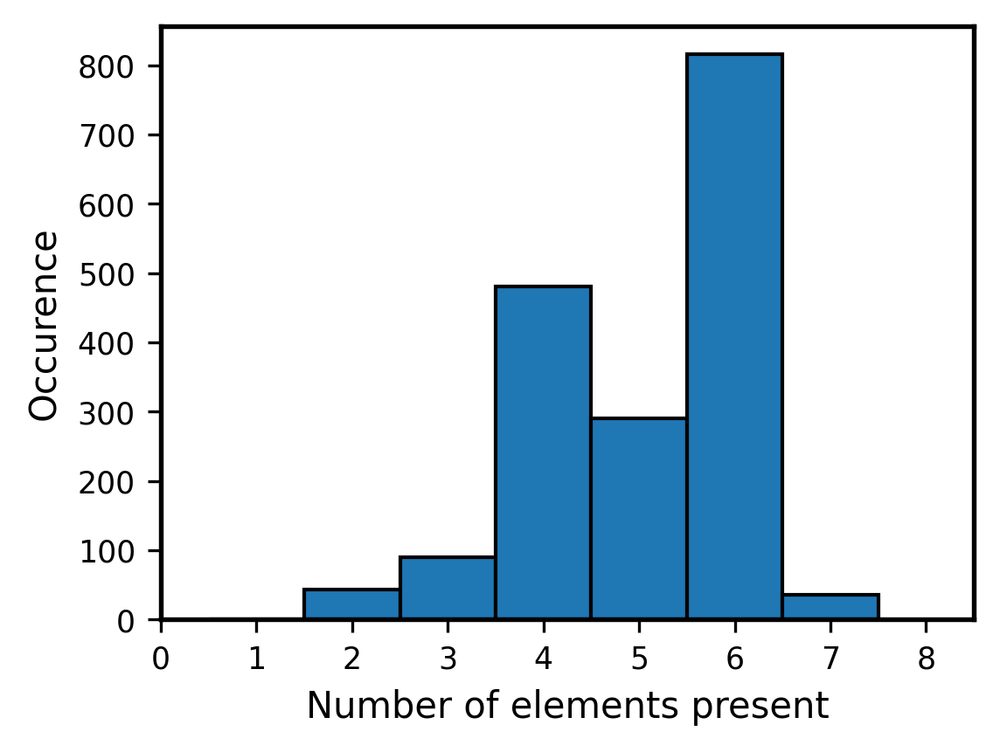

In [41]:
regressioncsv['Material']
num = []
for i in range(len(regressioncsv)):
    num.append(convert_elements(regressioncsv, i))
    
fig, ax=plt.subplots(dpi = 300, figsize = [4,3])
plt.hist(num, align = 'right', bins = [0,1,2,3,4,5,6,7], edgecolor = 'k')
plt.ylabel("Occurence")
plt.xlabel("Number of elements present")
plt.xticks(np.arange(9))
plt.xlim(0,8.5)

## Classification task 

Predicts the melt pool shape based on features of the build process. The potential classes are `spatter`, `balling`, `keyhole`, `desirable`, and `LOF`  describing either the type of defect, or indicating that there is  no defect in the `desirable` case. The following algorithms are used to generate predictions, and their accuracies are compared.


- Random Forests 'RF'


- Gaussian Process Classification 'GPC'


- Support Vector Classification 'SVC'


- Logistic Regression 'Logistic Regression'


- Gradient Boosted Random Forest 'GB'



- Neural Network 'NN'

The base ML case considers process and thermodynamic parameters, and later cells add one-hot-encoding and elemental features


In [42]:
%matplotlib inline 

def classify_learn(data, labels, label_names, material = None, parameters = None,  materials_ohe = None, title = None, plot = False, prefix = None, elemental_features = None ):
    
    '''
    
    
    
   Iterate over the models, performing training/cross-validation and plotting confusion matrices

    
    Arguments:
    data: Matrix array of data, n samples x m features, numpy array
    labels: vector of defect labels, n samples x 1 feature, numpy array
    label_names: string label of each class
    
    (Optional, only displayed on figure)
    material: Material that is trained on (string)
    parameters: parameters contained in data (list of strings)
    title: Any additional information (e.g. process, paper ID) to be specified (string)
    plot: Whether to produce plots
    prefix: string prefix of figure filename 

    
    Returns:
    fit_models: List of fit models
    train_accuracy: List of CV accuracies
    train_accuracy_std: List of standard deviation of CV accuracy
    test_accuracy: List of test CV accuracies
    test_accuracy_std: List of standard deviation of CV accuracy 
    '''

    params = { #'font.family'      : 'serif',
               'font.size'        : 12,
               'xtick.labelsize'  : 'small',
               'ytick.labelsize'  : 'small',
               #'axes.labelsize'   : 'large',
               'axes.linewidth'   : 1.3 }
    plt.rcParams.update(params)


    y  = labels
    X = data
    
    # transpose if shape of label and data do not match
    if len(X) != len(labels):
        X = X.T
        print(len(labels), len(X))
        print('transposed to ' + str(X.shape[0]) + ', ' + str(X.shape[1]))
        
        
    # Rescale the data to fit standard normal distribution  
    idx_normalize = len(X[0])
    
    
    # If elemental feautures are provided, append it
    if elemental_features is not None:
        try:
            
            X = np.hstack((X, elemental_features))
            idx_normalize = len(X[0])
        except:
            breakpoint()
            
            
            
    # If material one hot encoding info is provided, append it
    if materials_ohe is not None:
        X = np.hstack((X, materials_ohe))
       
    
            
            
            
    fit_models = []
    train_accuracy = []
    train_accuracy_std = []
    test_accuracy = []
    test_accuracy_std = []
    
    
    
    
    
    # Iterate over implemented models
    for modeltoggle in ['RF', 'GPC', 'SVC', 'Logistic Regression', 'GB', 'NN']:
    
        if modeltoggle == 'RF':
            model = RandomForestClassifier()
        elif modeltoggle == 'GPC':
            #print(y)
           # kernel = gp.kernels.ConstantKernel(1.0, (1e-1, 1e3))*gp.kernels.RBF(1.0, (1e-3, 1e3))
            
            #model = gp.GaussianProcessClassifier(kernel = kernel, n_restarts_optimizer = 10)
            model = gp.GaussianProcessClassifier()
        elif modeltoggle == 'SVC':
            model = SVC()
        elif modeltoggle == 'Logistic Regression':
            model = LogisticRegression(C =0.00045)

        elif modeltoggle == 'GB':
            model = GradientBoostingClassifier()
        elif modeltoggle == 'NN':
             model = MLPClassifier(hidden_layer_sizes=(32, 64, 64), activation='relu', solver='adam', alpha=0.0001, max_iter = 20000)
       
        # Perform cross validation for each model
        kf = KFold(n_splits=5)
        trains = []
        tests = []
        # Perform cross validation for each model
        for train, test in kf.split(X):

            X_shuffle, y_shuffle = shuffle(X, y, random_state=0)

            X_cv_train_before = X_shuffle[train]
            X_cv_test_before = X_shuffle[test]
            y_train_cv = y_shuffle[train]
            y_test_cv = y_shuffle[test]
            
            
            # Rescale the data to fit standard normal distribution
            # data is rescaled on indices before idx_normalize because indices after may include one-hot-encoded data
            X_train_cv_firsthalf = (X_cv_train_before[:,:idx_normalize] - np.mean(X_cv_train_before[:,:idx_normalize], axis = 0))/(np.std(X_cv_train_before[:,:idx_normalize], axis = 0) + 1e-10)
            X_test_cv_firsthalf = (X_cv_test_before[:,:idx_normalize] - np.mean(X_cv_train_before[:,:idx_normalize], axis = 0))/(np.std(X_cv_train_before[:,:idx_normalize], axis = 0) + 1e-10)
            
            
            # put normalized numerical data with categorical data if present
            X_train_cv = np.hstack((X_train_cv_firsthalf, X_cv_train_before[:, idx_normalize:]))
            X_test_cv = np.hstack((X_test_cv_firsthalf, X_cv_test_before[:, idx_normalize:]))
            
            model.fit(X_train_cv, y_train_cv)
               
            trains.append(model.score(X_train_cv, y_train_cv))
            tests.append(model.score(X_test_cv, y_test_cv))
            print(model)
            if model == 'SVC':
                print(trains, 'SVC')
            if model == 'Logistic Regression':
                print(trains, 'LR')
        trains = np.array(trains)
        tests = np.array(tests)


        r2_mean = tests.mean()
        r2_std = tests.std()

        r2_train_mean = trains.mean()
        r2_train_std =  trains.std()


        train_accuracy.append(r2_train_mean)
        test_accuracy_std.append(r2_std)
        test_accuracy.append(r2_mean)
        train_accuracy_std.append(r2_train_std)
        print(modeltoggle,  'Train Accuracy: {:.5f} ± {:.5f}, Test Accuracy: {:.5f} ± {:.5f}'.
                format(r2_train_mean, r2_train_std, r2_mean, r2_std))
        # Fit on a single train/validation partition
        
        if plot:
            X_train = X_train_cv
            y_train = y_train_cv
            X_test = X_test_cv
            y_test = y_test_cv


            # Compute confusion matrix for classification algorithm

            label_id = np.arange(len(label_names))
            confusion_train = np.zeros((len(label_id), len(label_id)))
            
            for idx, sample in enumerate(y_train):
              
                curr_sample = X_train[idx,:].reshape(1,-1)
                predicted = model.predict(curr_sample)
                confusion_train[int(sample), int(predicted)] += 1
            
                
            fig = plt.figure(figsize = (4,4), dpi = 300)
            ax = fig.gca()

            plt.imshow(confusion_train/np.sum(confusion_train, axis = 0).reshape(1,-1), cmap = 'binary')
#             breakpoint()

            r2_train = model.score(X_train, y_train)
            s =  'Train Accuracy:\n {:.3f}'.format(r2_train)

            plt.text(1.0, 0, s, fontsize=10)

            s_train_cv =  'Train CV Acc: {:.3f} ± {:.3f}'.format(r2_train_mean, r2_train_std)
            plt.text(1.0, 0.4, s_train_cv, fontsize=8)


            plt.title(modeltoggle + ', '+ title)
            label = "Parameters: " + '\n'
            for parameter in parameter_list:
                paramstring = "•" + parameter+ '\n'
                label += paramstring
            plt.xlabel('Ground Truth')
            plt.ylabel('Predicted')
            cbar = plt.colorbar()
            cbar.ax.get_yaxis().labelpad = 15
            cbar.ax.set_ylabel('Proportion of samples', rotation=270)

            label_id = np.arange(len(label_names))
            plt.xticks(label_id, label_names, fontsize = 4)
            plt.yticks(label_id, label_names, fontsize = 4)
#             breakpoint()
           # savefig(prefix + title+modeltoggle + "train"+".png")
    
            
    
    
            fig = plt.figure(figsize = (4,4), dpi = 300)
            ax = fig.gca()

#             plt.imshow(confusion_test/np.sum(confusion_test, axis = 0).reshape(1,-1), cmap = 'binary')
            
            for m in range(4):
                for n in range(4):
                    plt.text(m, n  + 0.3, confusion_train[m, n])
            
            plt.title(modeltoggle + ', '+ title)
            plt.xticks(label_id, label_names, fontsize = 4)
            plt.yticks(label_id, label_names, fontsize = 4)
            plt.xlabel('Ground Truth')
            plt.ylabel('Predicted')
            plt.imshow(np.zeros((4,4)), cmap = 'binary')
            label = "Parameters: " + '\n'
            for parameter in parameter_list:
                paramstring = "•" + parameter+ '\n'
                label += paramstring
            r2_test = model.score(X_test, y_test)
            s =  'Train Accuracy:\n {:.3f}'.format(r2_train)

            
            #plt.text(1.0, 0, s, fontsize=10)
            s_cv =  'Train CV Acc: {:.3f} ± {:.3f}'.format(r2_train, r2_train_std)
            plt.text(1.0, -0.15, s_cv, fontsize=8)
            plt.xticks(label_id, label_names, fontsize = 4)
            plt.yticks(label_id, label_names, fontsize = 4)

          #  savefig(prefix + title+modeltoggle + "num_train"+".png")
            plt.title(modeltoggle)
            plt.xticks(label_id, label_names, fontsize = 4)
            plt.yticks(label_id, label_names, fontsize = 4)
            plt.show()
            
            confusion_test = np.zeros((len(label_id), len(label_id)))
            
            
            for idx, sample in enumerate(y_test):
                curr_sample = X_test[idx,:].reshape(1,-1)
                predicted = model.predict(curr_sample)             
            
                confusion_test[int(sample), int(predicted)] += 1
            fig = plt.figure(figsize = (4,4), dpi = 300)
            ax = fig.gca()

            plt.imshow(confusion_test/np.sum(confusion_test, axis = 0).reshape(1,-1), cmap = 'binary')
            
#             for m in range(4):
#                 for n in range(4):
#                     plt.text(m, n  + 0.3, confusion_test[m, n], c = 'w')
            
            plt.title(modeltoggle + ', '+ title)
            plt.xticks(label_id, label_names, fontsize = 4)
            plt.yticks(label_id, label_names, fontsize = 4)
            plt.xlabel('Ground Truth')
            plt.ylabel('Predicted')
            
            label = "Parameters: " + '\n'
            for parameter in parameter_list:
                paramstring = "•" + parameter+ '\n'
                label += paramstring
            r2_test = model.score(X_test, y_test)
            s =  'Test Accuracy:\n {:.3f}'.format(r2_test)

            
            #plt.text(1.0, 0, s, fontsize=10)
            s_cv =  'Test CV Acc: {:.3f} ± {:.3f}'.format(r2_mean, r2_std)
            plt.text(1.0, -0.15, s_cv, fontsize=8)
            plt.xticks(label_id, label_names, fontsize = 4)
            plt.yticks(label_id, label_names, fontsize = 4)
            cbar = plt.colorbar()
            cbar.ax.get_yaxis().labelpad = 15
            cbar.ax.set_ylabel('Proportion of samples', rotation=270)
        #    savefig(prefix + title+modeltoggle + "test"+".png")
            plt.title(modeltoggle)
            plt.xticks(label_id, label_names, fontsize = 4)
            plt.yticks(label_id, label_names, fontsize = 4)
            plt.show()
            
            
            
            fig = plt.figure(figsize = (4,4), dpi = 300)
            ax = fig.gca()

#             plt.imshow(confusion_test/np.sum(confusion_test, axis = 0).reshape(1,-1), cmap = 'binary')
            
            for m in range(4):
                for n in range(4):
                    plt.text(m, n  + 0.3, confusion_test[m, n])
            
            plt.title(modeltoggle + ', '+ title)
            plt.xticks(label_id, label_names, fontsize = 4)
            plt.yticks(label_id, label_names, fontsize = 4)
            plt.xlabel('Ground Truth')
            plt.ylabel('Predicted')
            plt.imshow(np.zeros((4,4)), cmap = 'binary')
            label = "Parameters: " + '\n'
            for parameter in parameter_list:
                paramstring = "•" + parameter+ '\n'
                label += paramstring
            r2_test = model.score(X_test, y_test)
            s =  'Test Accuracy:\n {:.3f}'.format(r2_test)

            
            #plt.text(1.0, 0, s, fontsize=10)
            s_cv =  'Test CV Acc: {:.3f} ± {:.3f}'.format(r2_mean, r2_std)
            plt.text(1.0, -0.15, s_cv, fontsize=8)
            plt.xticks(label_id, label_names, fontsize = 4)
            plt.yticks(label_id, label_names, fontsize = 4)

       #     savefig(prefix + title+modeltoggle + "num_test"+".png")
            plt.title(modeltoggle)
            plt.xticks(label_id, label_names, fontsize = 4)
            plt.yticks(label_id, label_names, fontsize = 4)
            plt.show()
            
            
            
            
            
             
           
            
            
            
        fit_models.append(model)
    return fit_models, train_accuracy, train_accuracy_std, test_accuracy, test_accuracy_std 


(252, 29) (252,)
RandomForestClassifier()
RandomForestClassifier()
RandomForestClassifier()
RandomForestClassifier()
RandomForestClassifier()
RF Train Accuracy: 1.00000 ± 0.00000, Test Accuracy: 0.86086 ± 0.05110


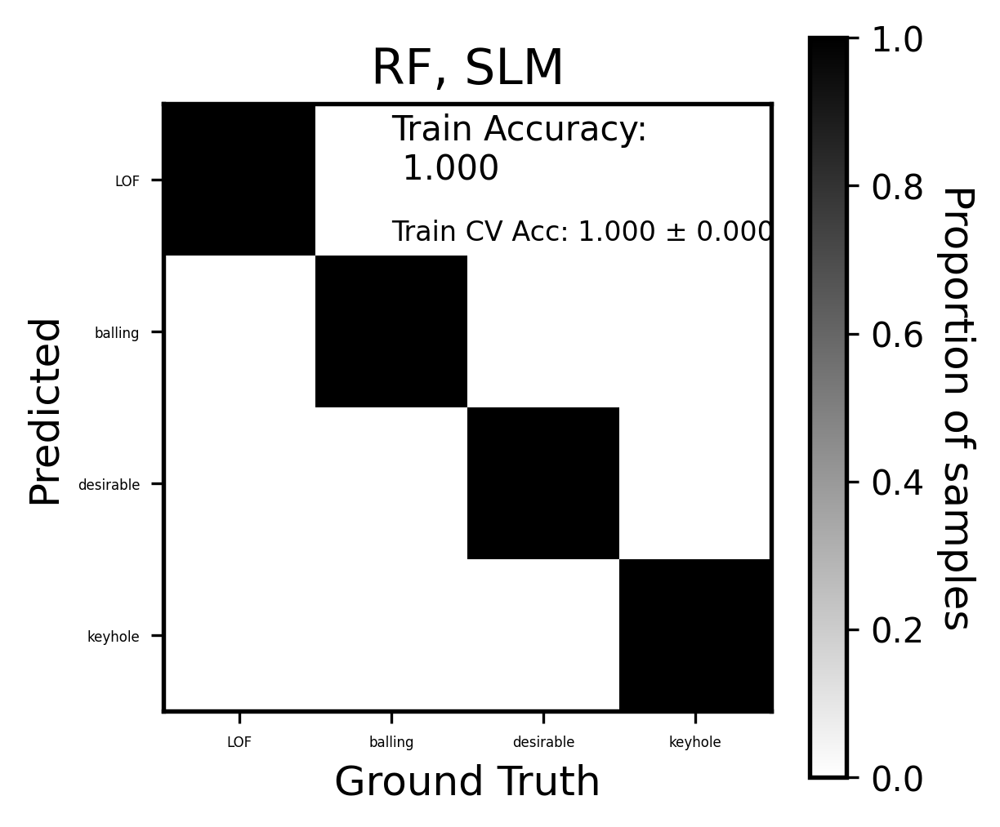

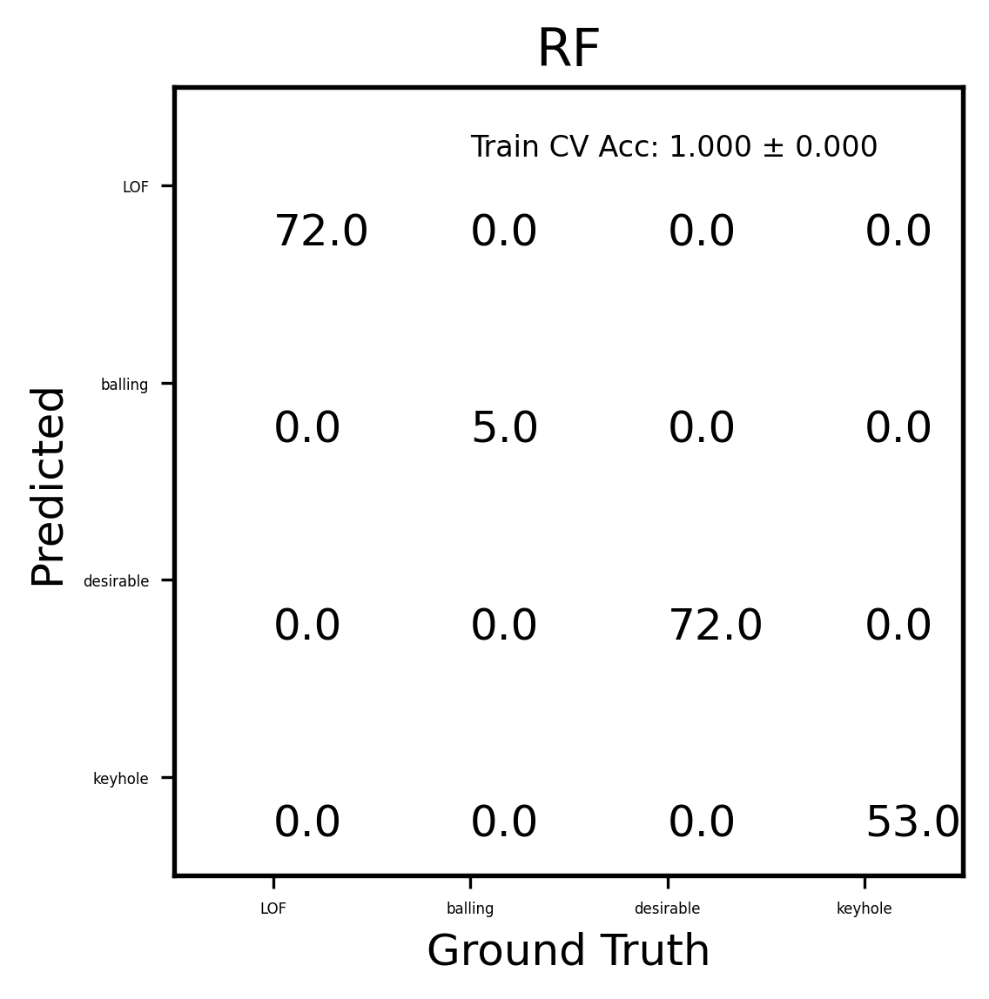

/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:259: RuntimeWarning: invalid value encountered in true_divide


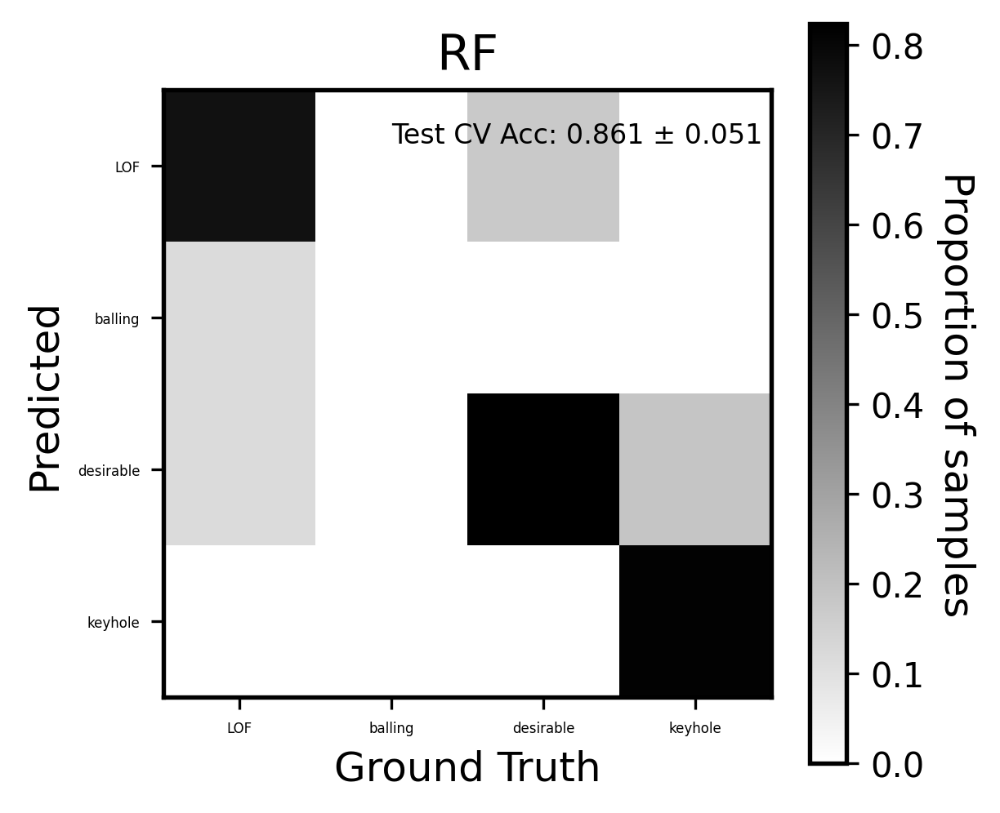

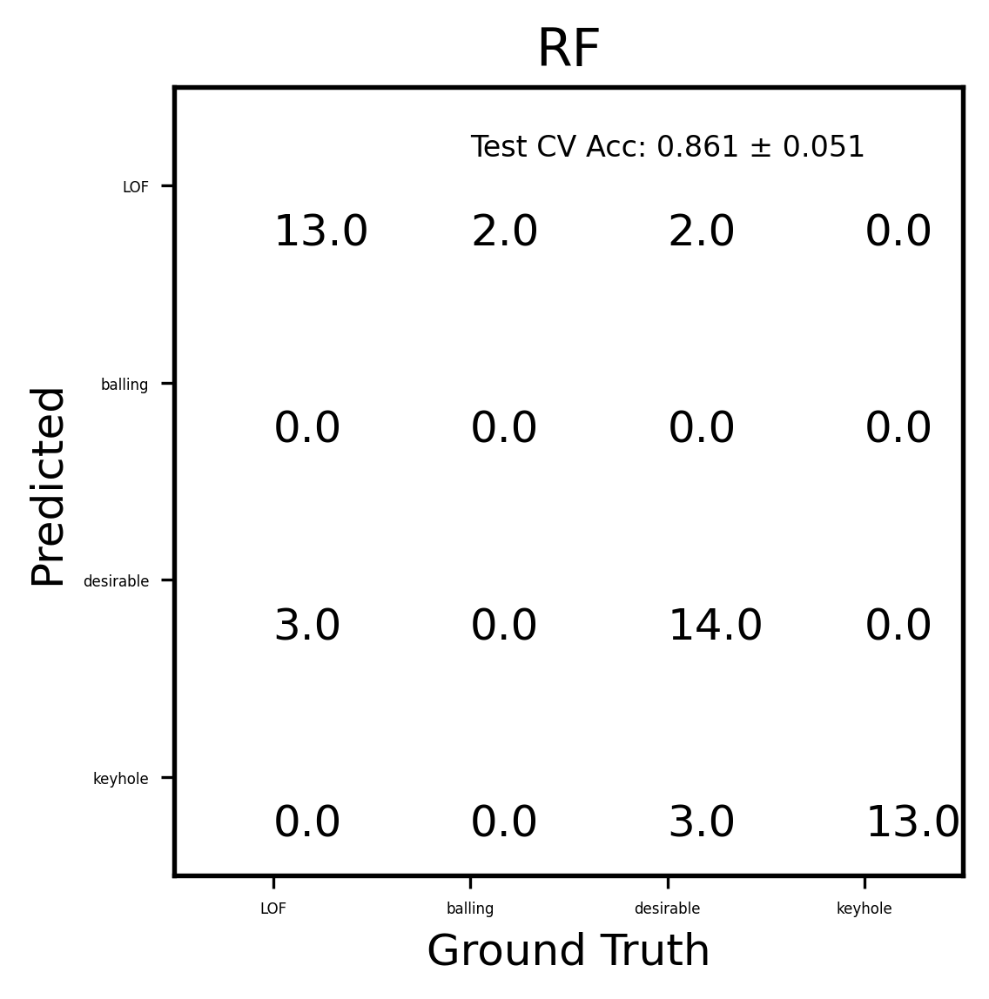

GaussianProcessClassifier()
GaussianProcessClassifier()
GaussianProcessClassifier()
GaussianProcessClassifier()
GaussianProcessClassifier()
GPC Train Accuracy: 0.84921 ± 0.00790, Test Accuracy: 0.73012 ± 0.05319


/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:181: RuntimeWarning: invalid value encountered in true_divide


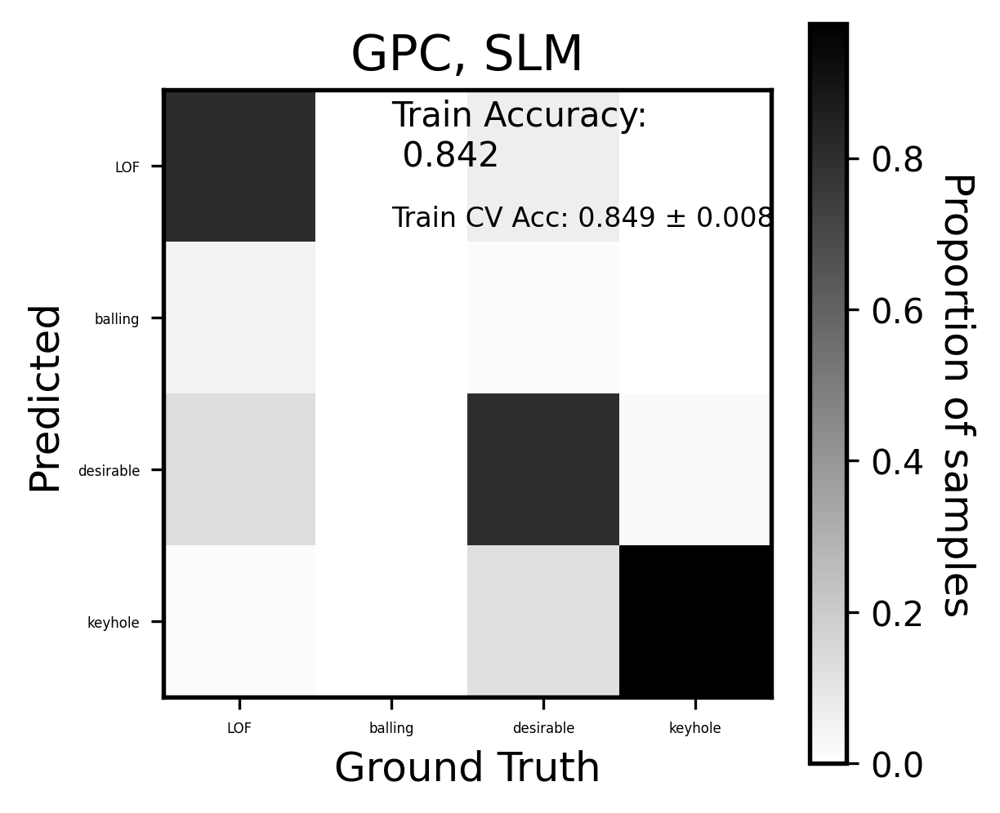

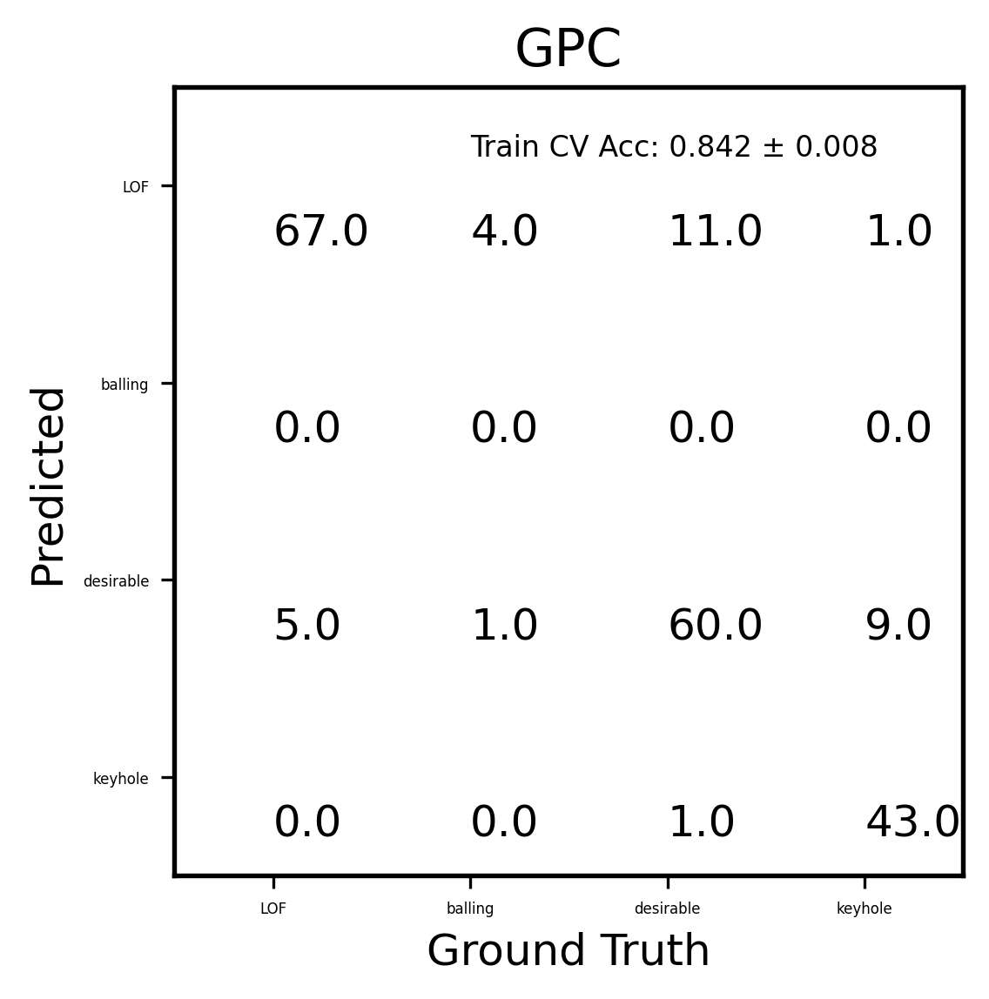

/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:259: RuntimeWarning: invalid value encountered in true_divide


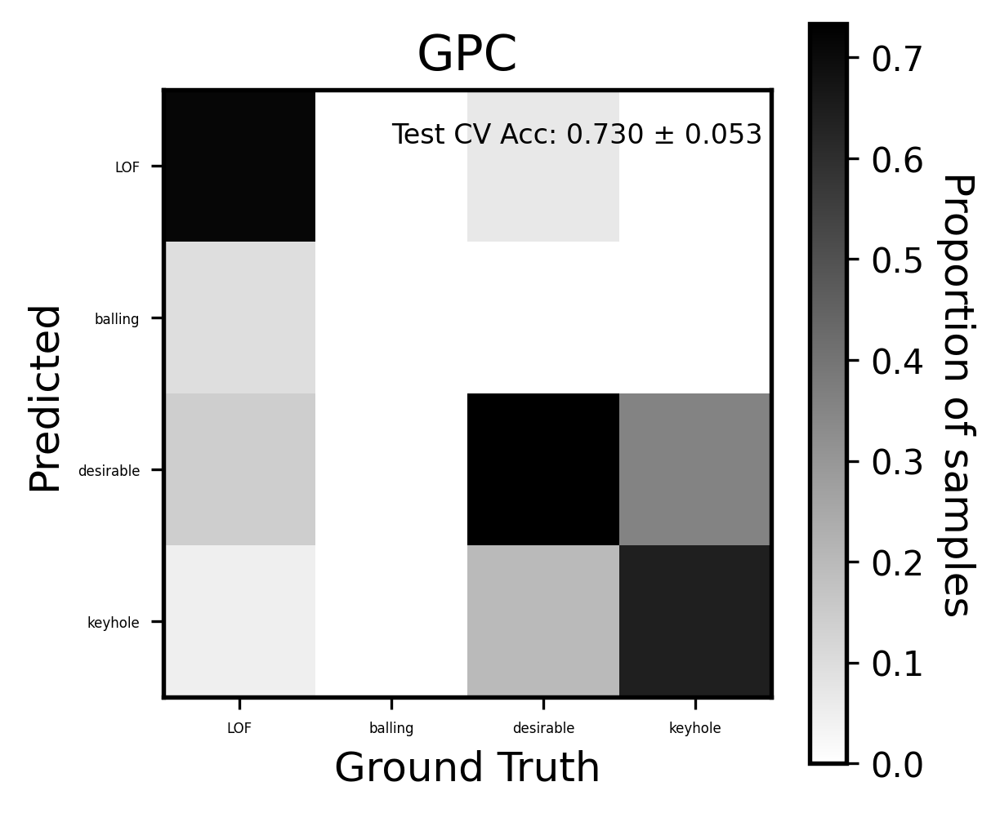

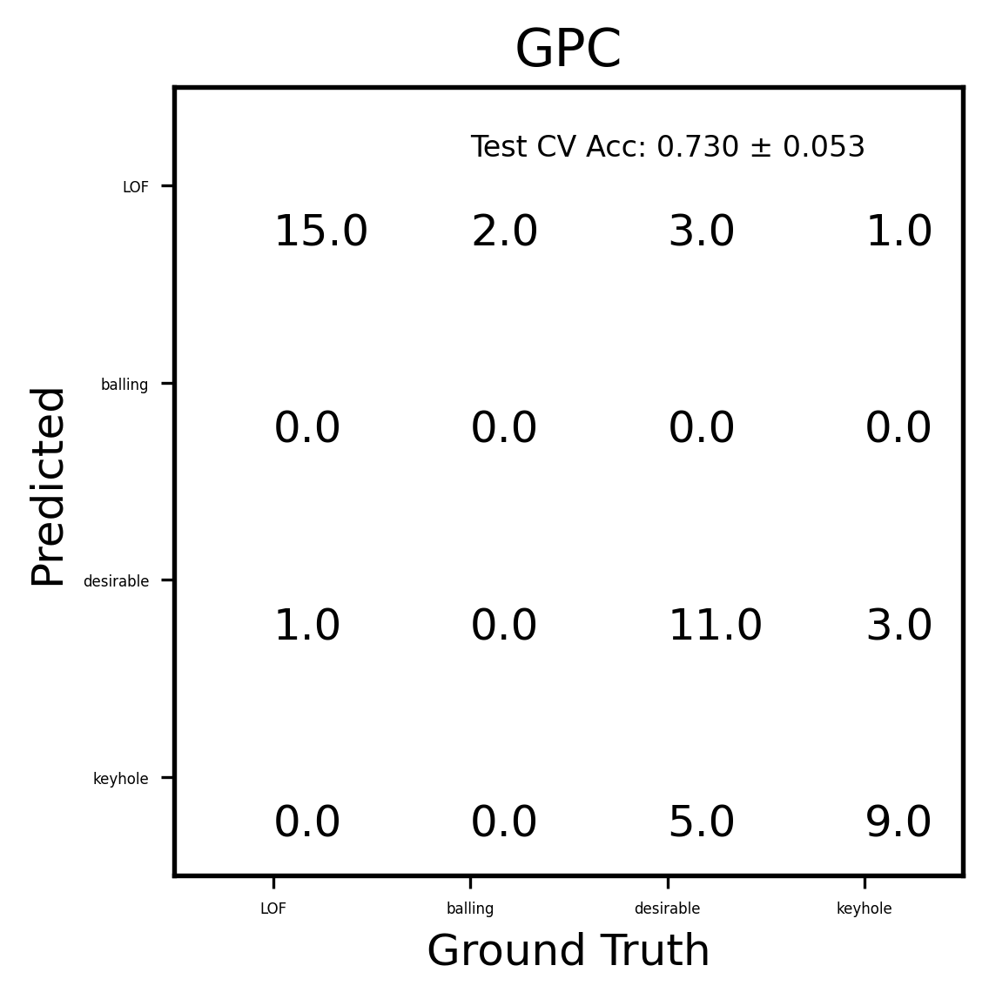

SVC()
SVC()
SVC()
SVC()
SVC()
SVC Train Accuracy: 0.70434 ± 0.01740, Test Accuracy: 0.62667 ± 0.08719


/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:181: RuntimeWarning: invalid value encountered in true_divide


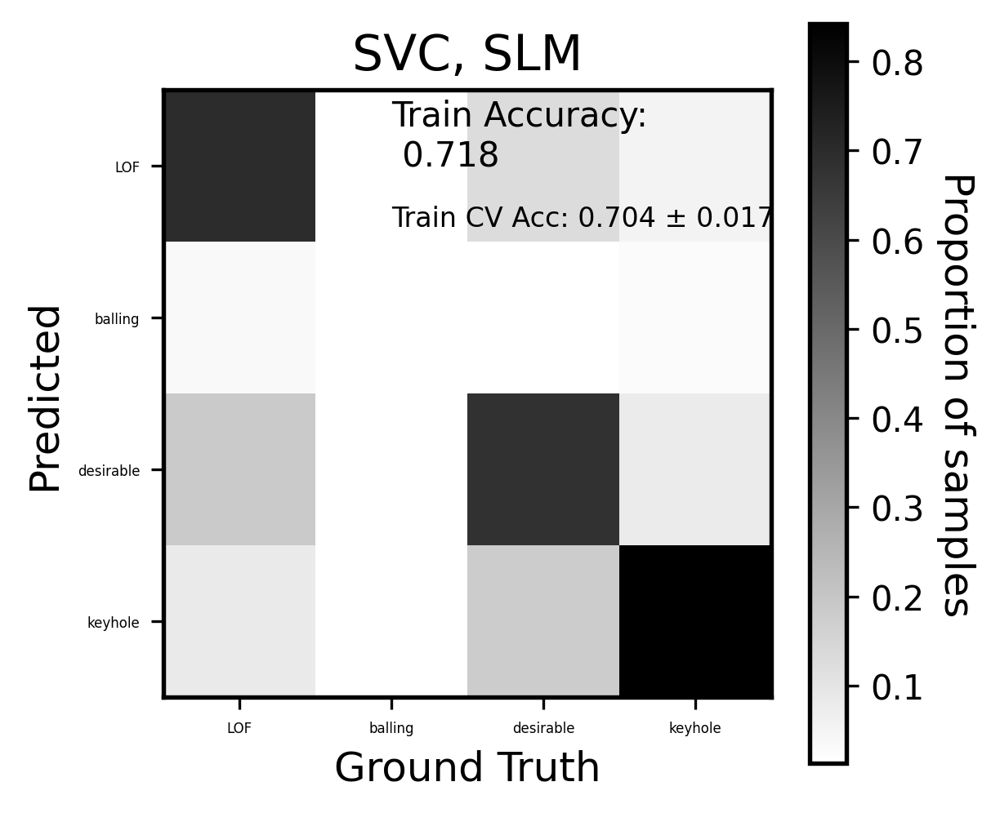

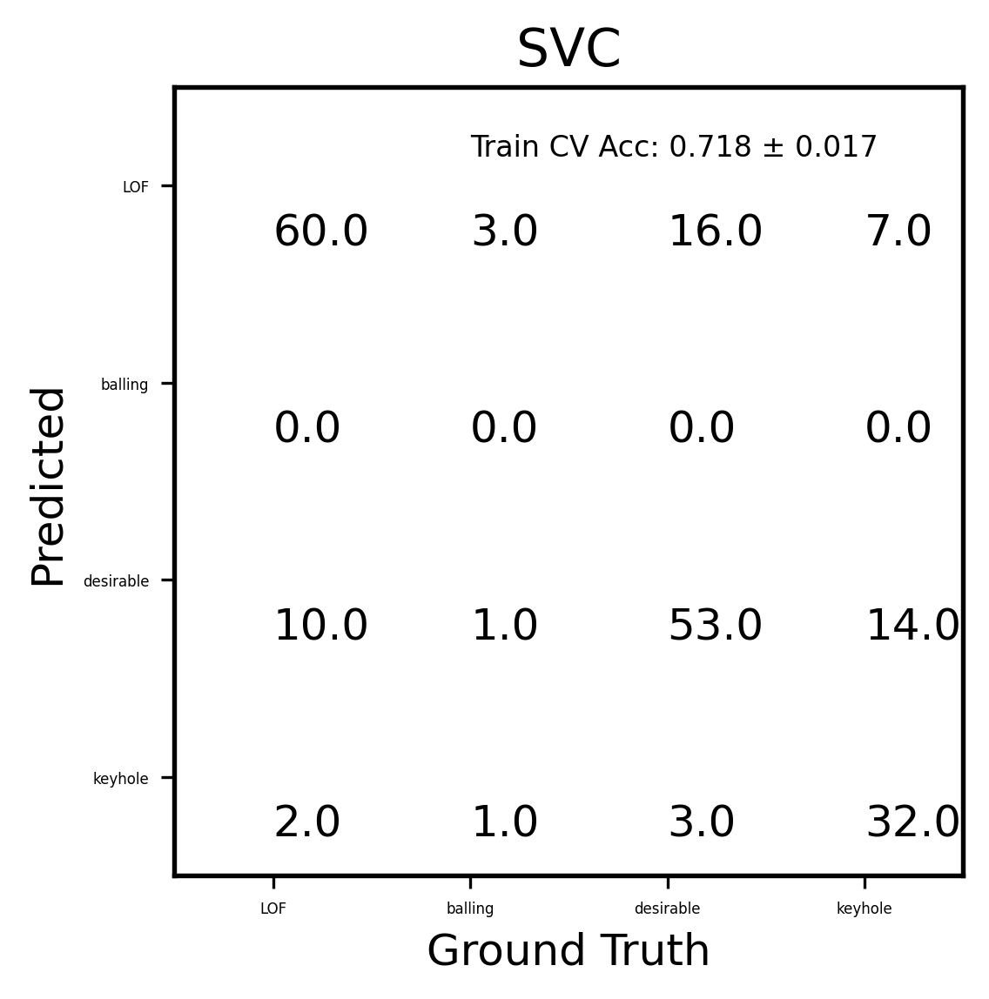

/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:259: RuntimeWarning: invalid value encountered in true_divide


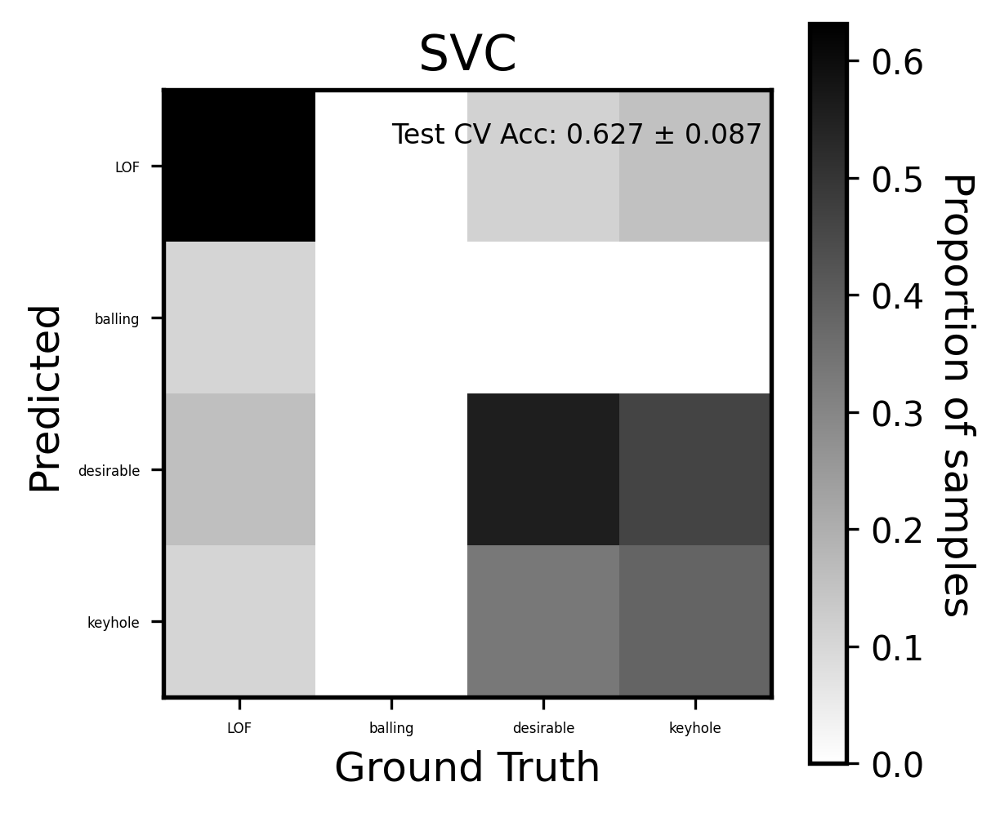

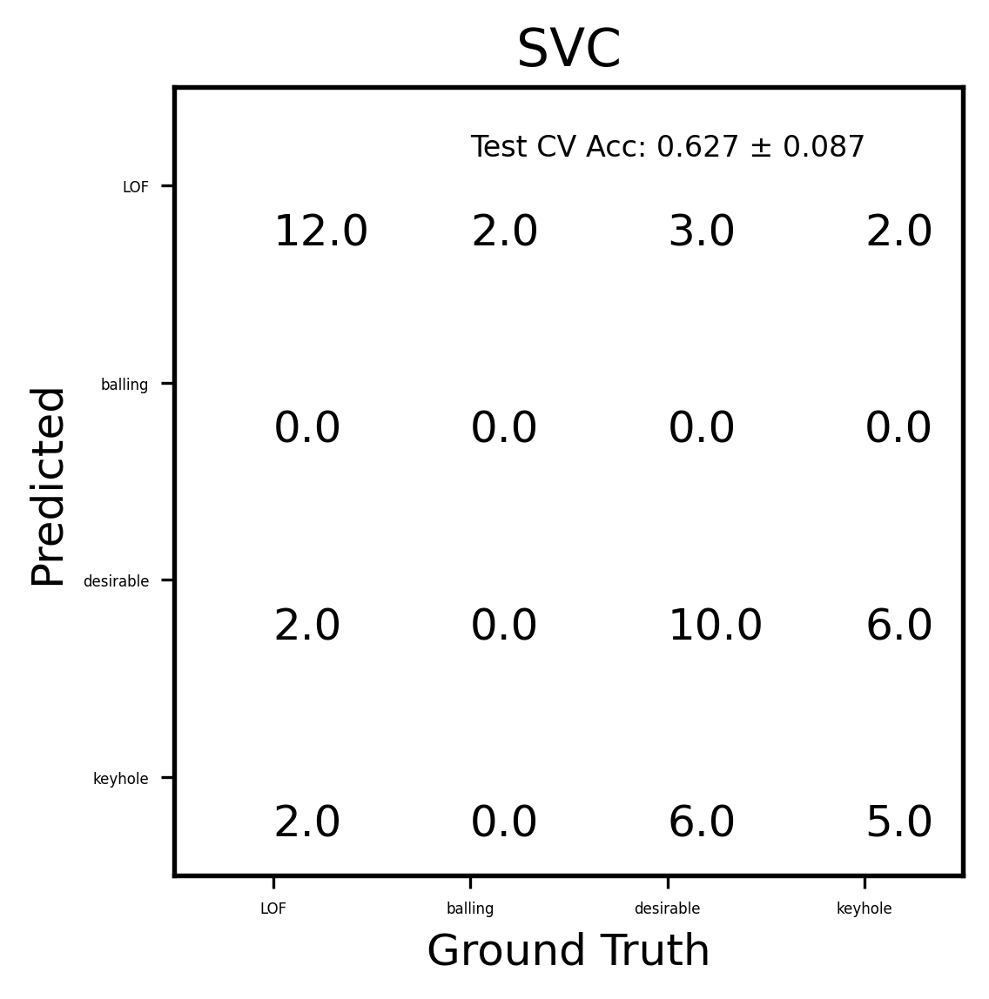

LogisticRegression(C=0.00045)
LogisticRegression(C=0.00045)
LogisticRegression(C=0.00045)
LogisticRegression(C=0.00045)
LogisticRegression(C=0.00045)
Logistic Regression Train Accuracy: 0.42256 ± 0.04943, Test Accuracy: 0.36157 ± 0.09518


/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:181: RuntimeWarning: invalid value encountered in true_divide


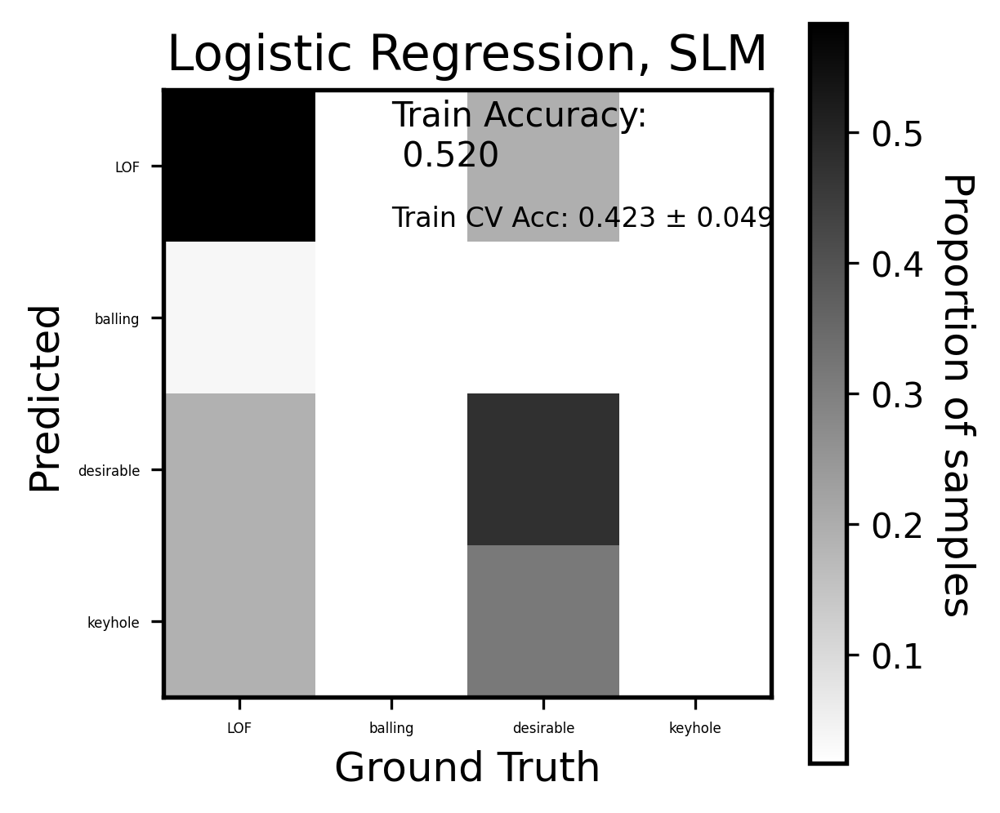

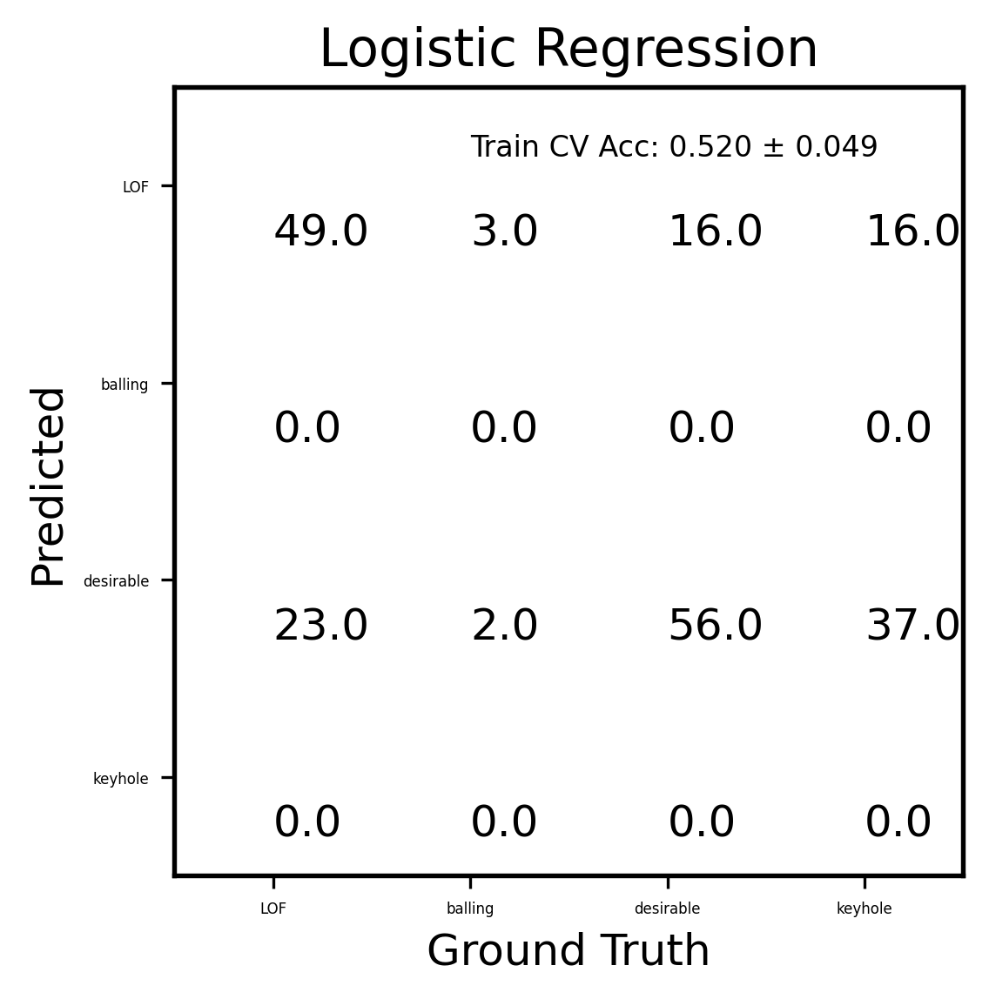

/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:259: RuntimeWarning: invalid value encountered in true_divide


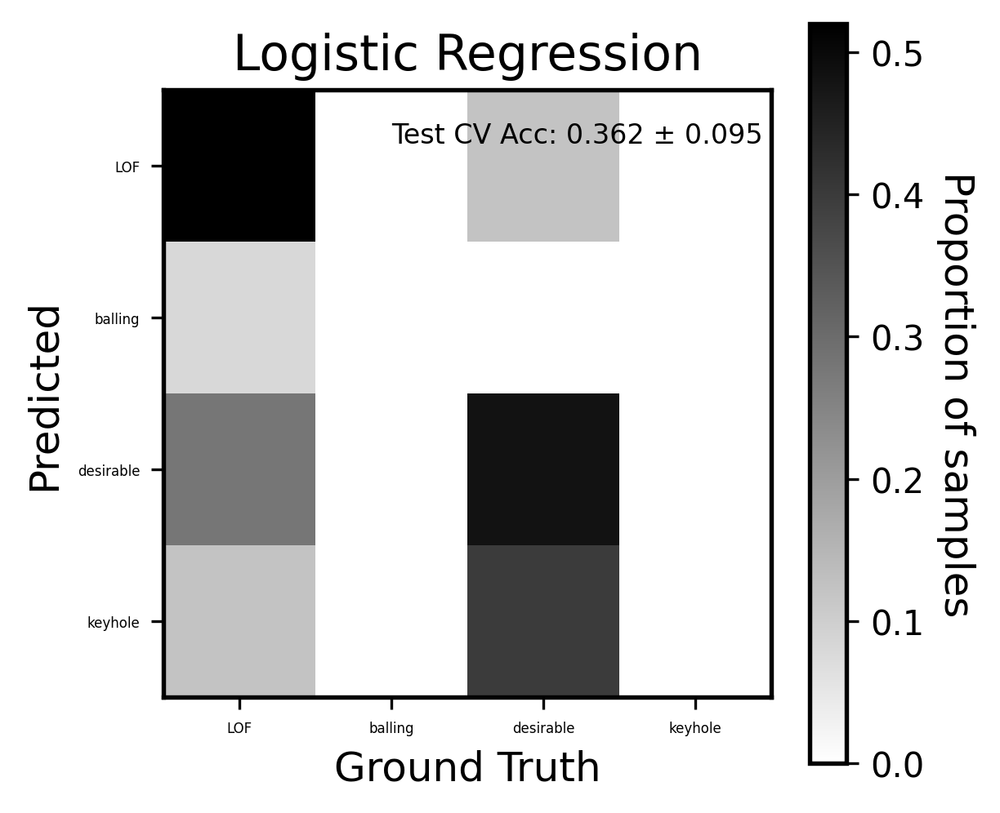

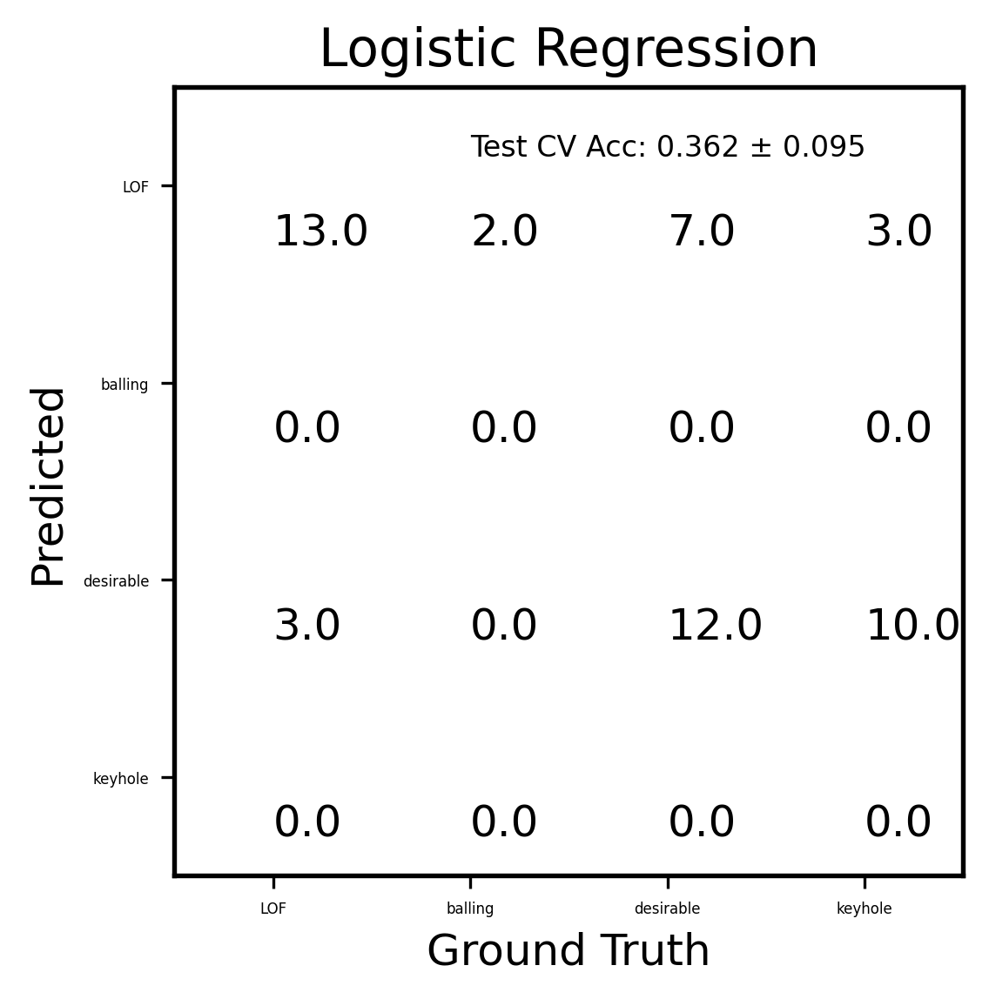

GradientBoostingClassifier()
GradientBoostingClassifier()
GradientBoostingClassifier()
GradientBoostingClassifier()
GradientBoostingClassifier()
GB Train Accuracy: 1.00000 ± 0.00000, Test Accuracy: 0.90455 ± 0.04303


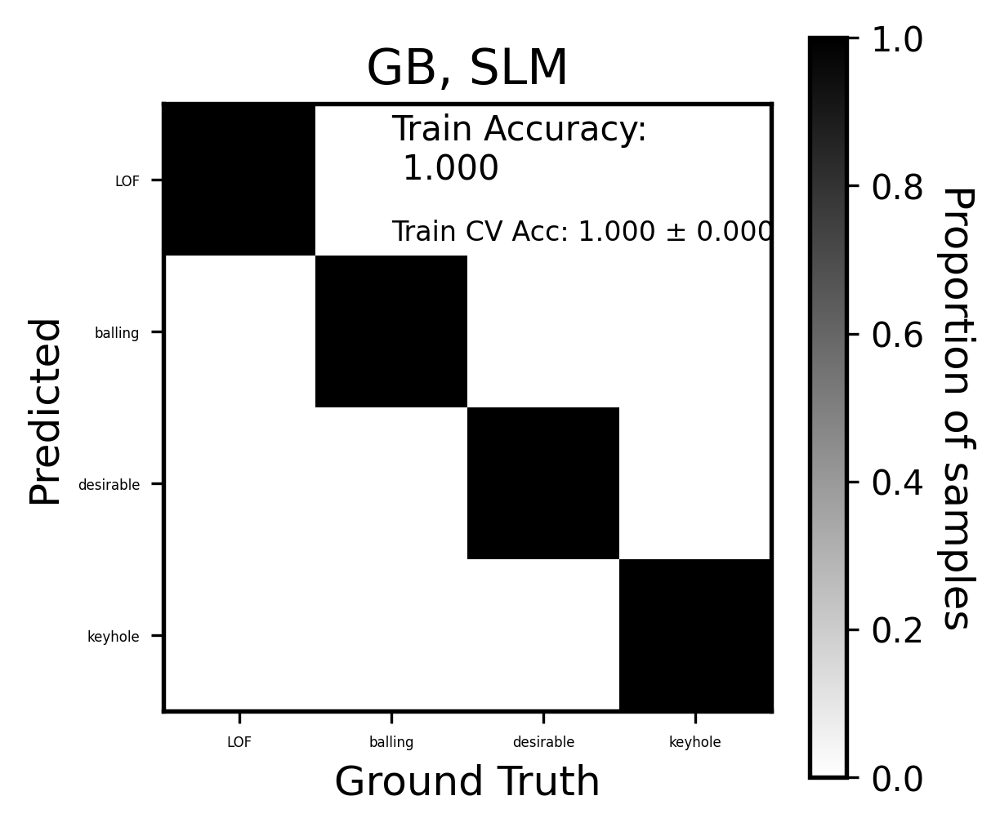

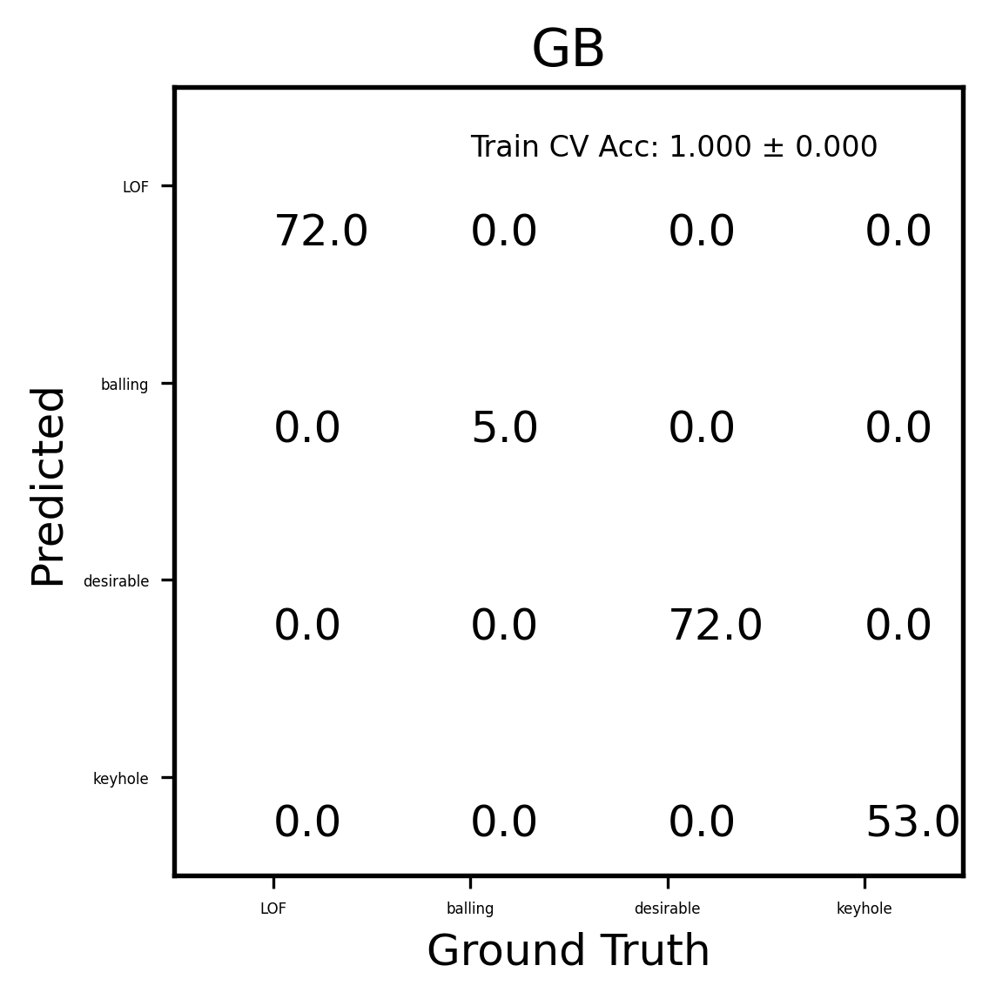

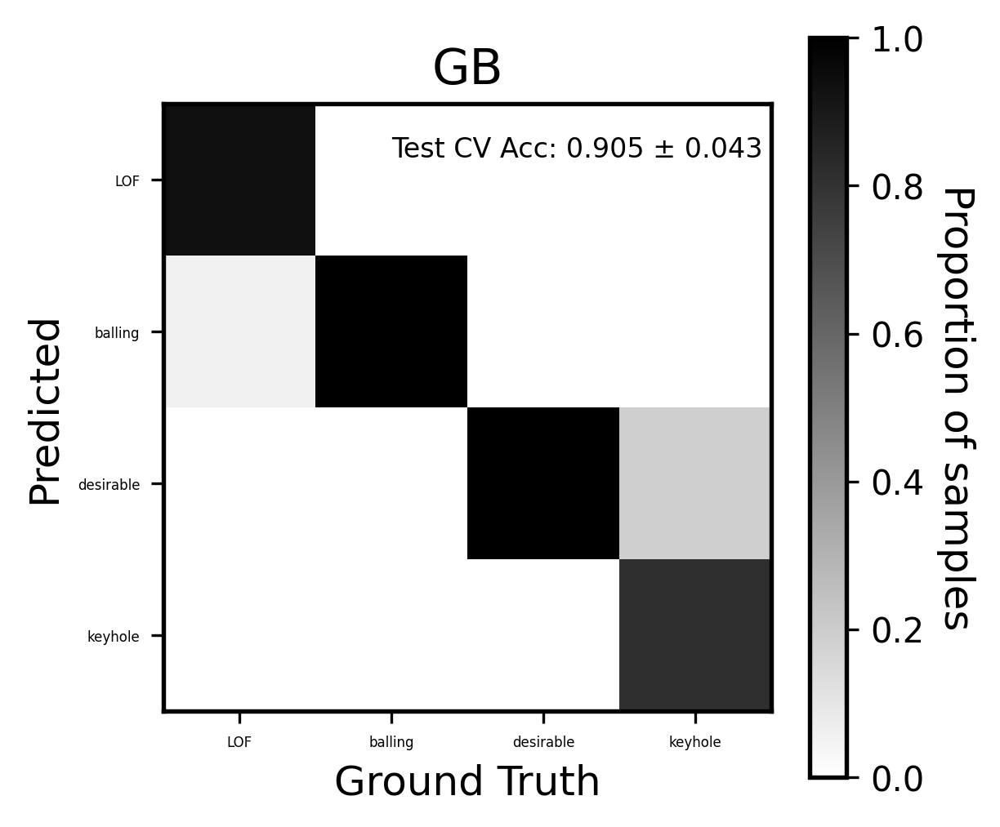

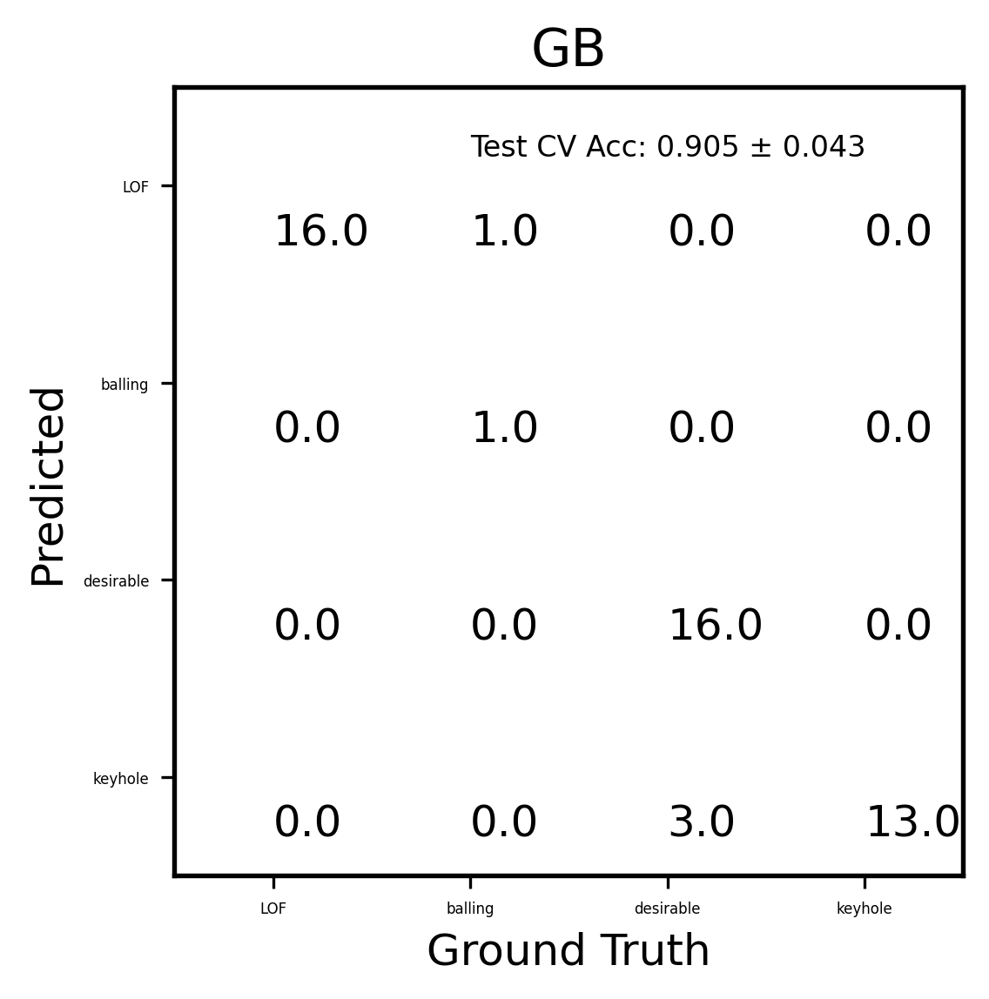

MLPClassifier(hidden_layer_sizes=(32, 64, 64), max_iter=20000)
MLPClassifier(hidden_layer_sizes=(32, 64, 64), max_iter=20000)
MLPClassifier(hidden_layer_sizes=(32, 64, 64), max_iter=20000)
MLPClassifier(hidden_layer_sizes=(32, 64, 64), max_iter=20000)
MLPClassifier(hidden_layer_sizes=(32, 64, 64), max_iter=20000)
NN Train Accuracy: 0.76577 ± 0.04443, Test Accuracy: 0.67475 ± 0.07119


/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:181: RuntimeWarning: invalid value encountered in true_divide


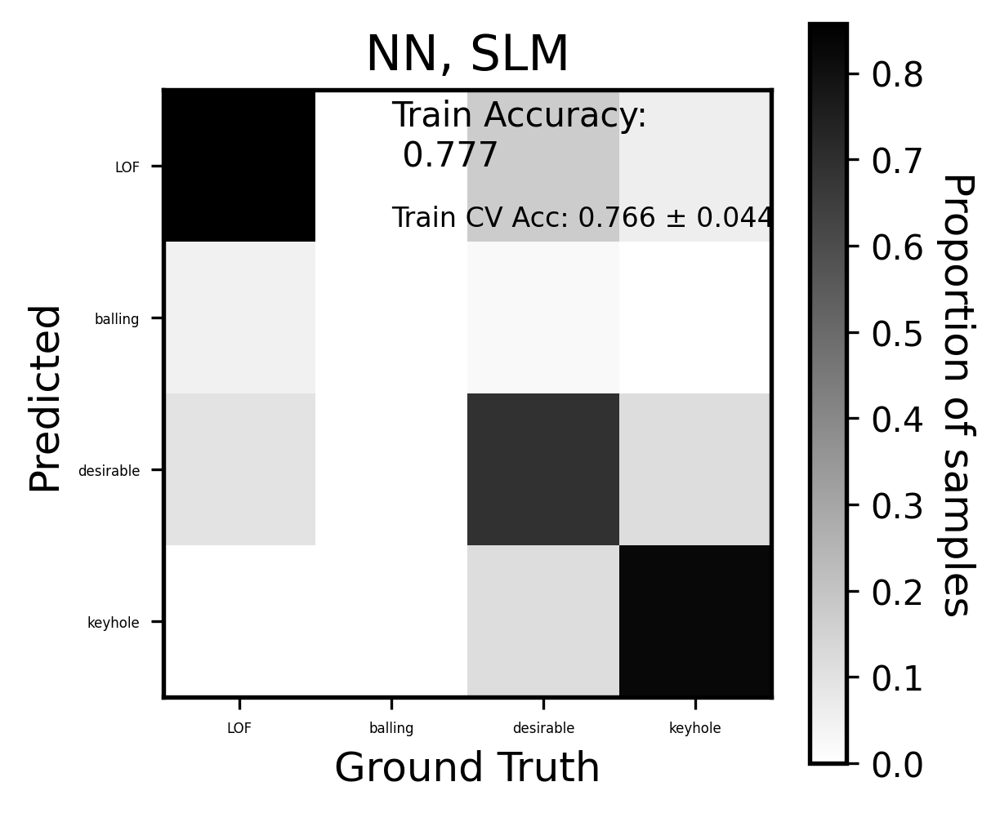

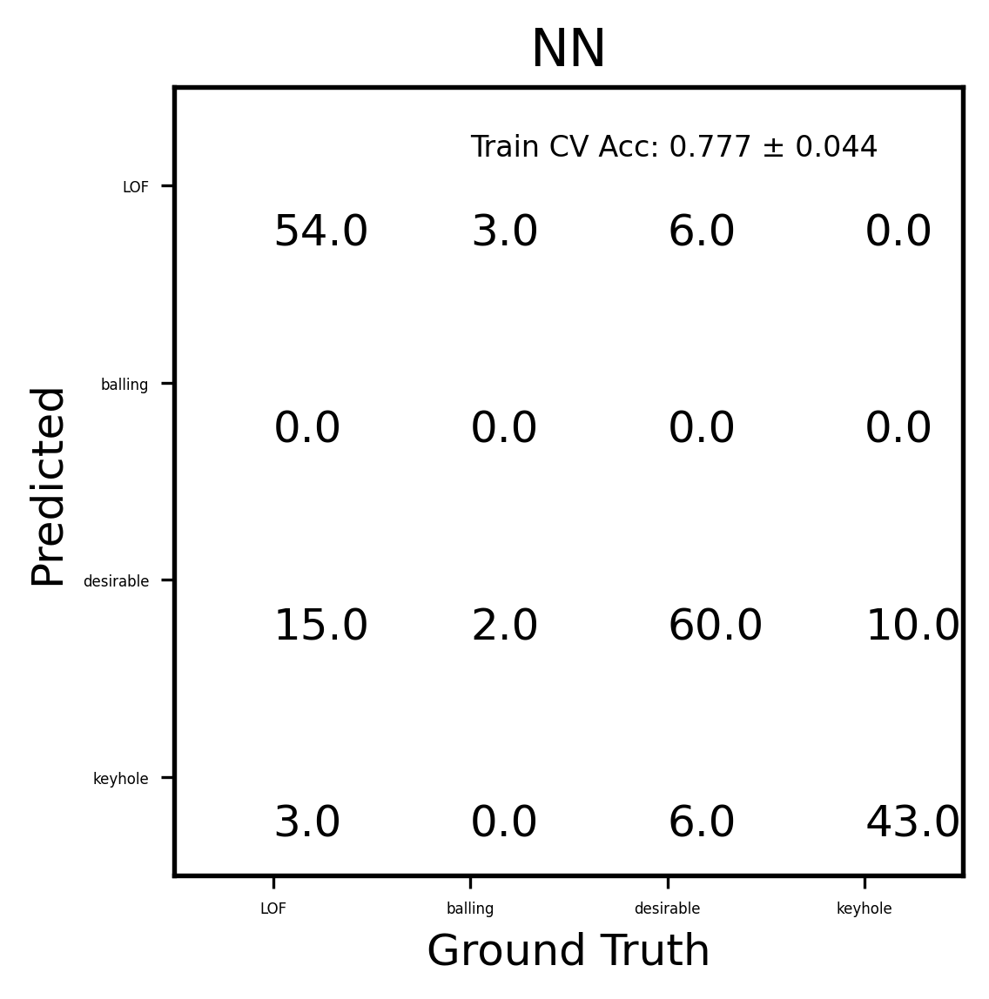

/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:259: RuntimeWarning: invalid value encountered in true_divide


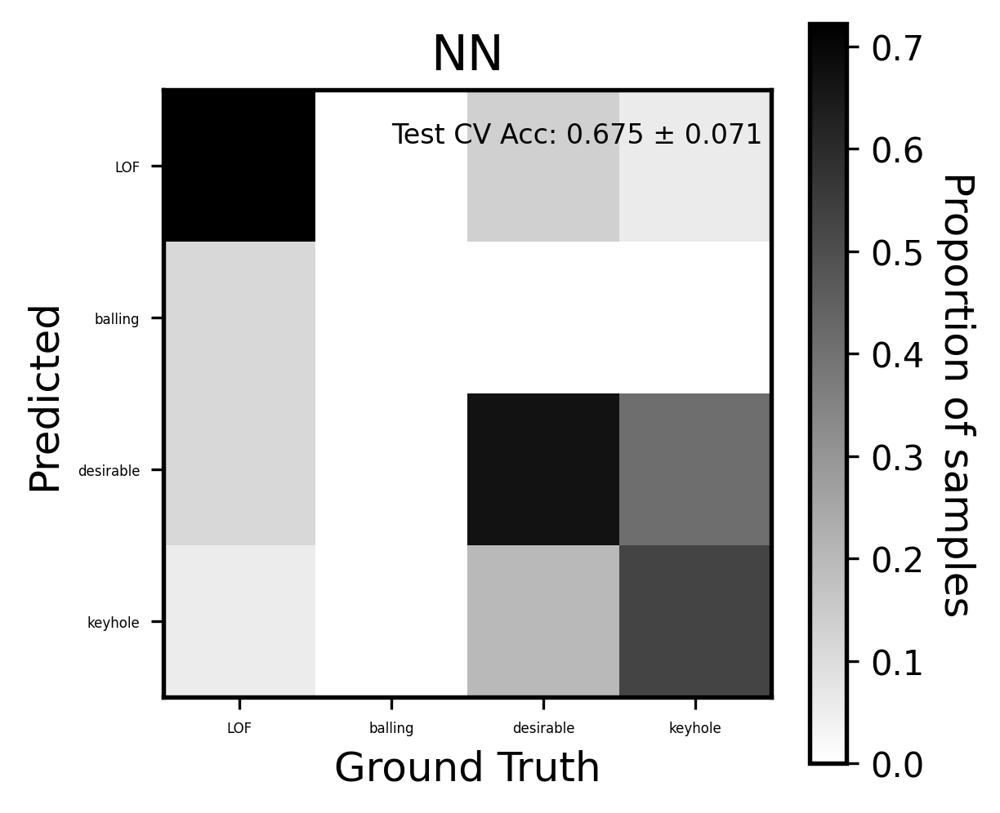

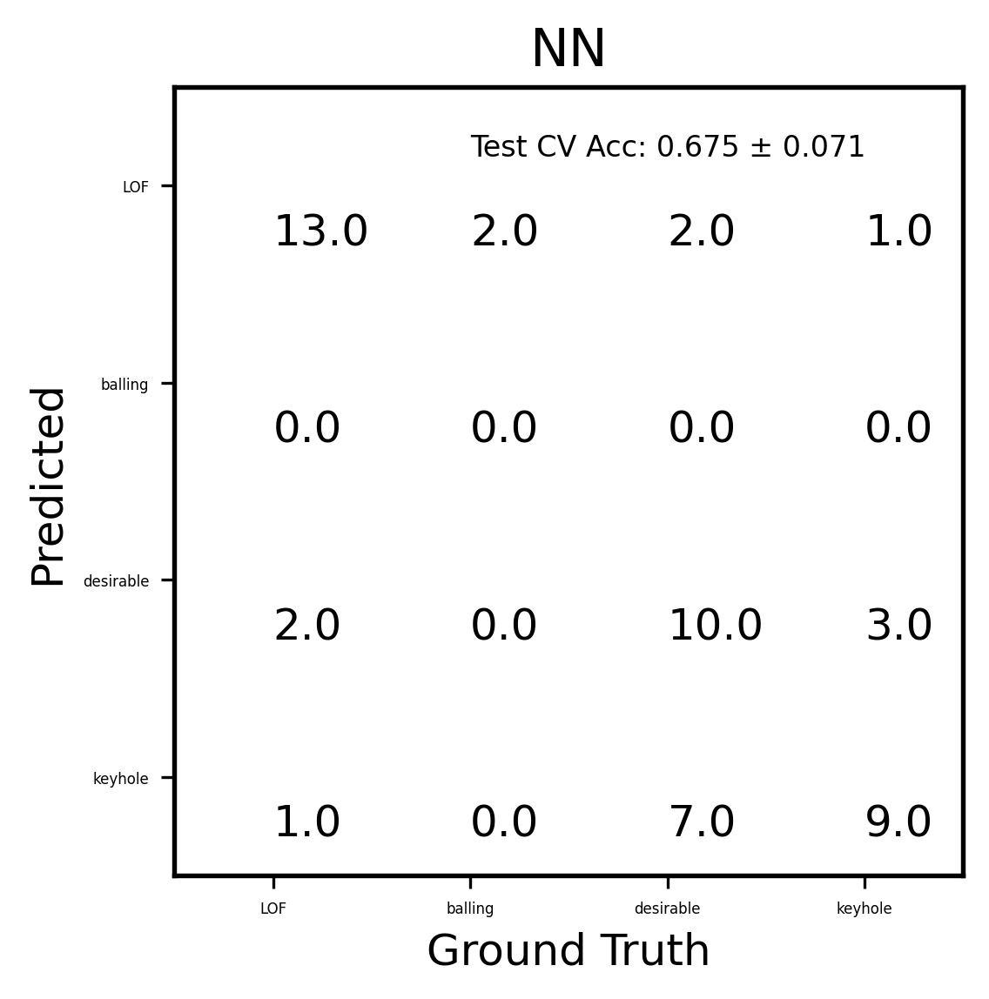

In [43]:
%matplotlib inline
# Define parameters that models will be trained on and value to be predicted
parameter_list = ['Power', 'Velocity', 'density', 'Cp', 'k' , 'beam D', 'melting T', 'layer thickness', 'absorption coefficient', 'absorption coefficient 2']
parameter_list.extend(atomic_features)
label_col = 'meltpool shape'

#Form dataset array from dataframe, given parameter_list, label_col
# function select_parameters() does this as well

data_list = []
label_list = []
new_csv = select_subset(class_csv, 'Sub-process', 'SLM')

test = 0
for i in range(len(new_csv)):
    success, features, label = extract_features(new_csv.iloc[i], parameter_list, label_col)
    if success < 0:
        continue
    else:
        test += 1
        data_list.append(features)
        label_list.append(label)

        
X= np.array(np.squeeze(data_list))
labels = np.unique(label_list)
# breakpoint()
# Define labels from csv file
label_id = np.arange(len(labels))
class_labels = np.zeros(len(label_list))
for idx, sample in enumerate(label_list):
    for l_id, lbl in enumerate(labels):
        if lbl == sample:
            class_labels[idx] = l_id
y = np.array(class_labels)
# breakpoint()

 
class_labels = np.array(class_labels,dtype = 'int')

print(X.shape, y.shape)
fit_models, train_accuracy, train_accuracy_std, test_accuracy, test_accuracy_std = classify_learn(X.reshape(-1, len(X[0])), y, labels,plot = True, parameters = parameter_list, title = 'SLM', prefix = 'classification')

## Classification with PT and atomic compositions

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277


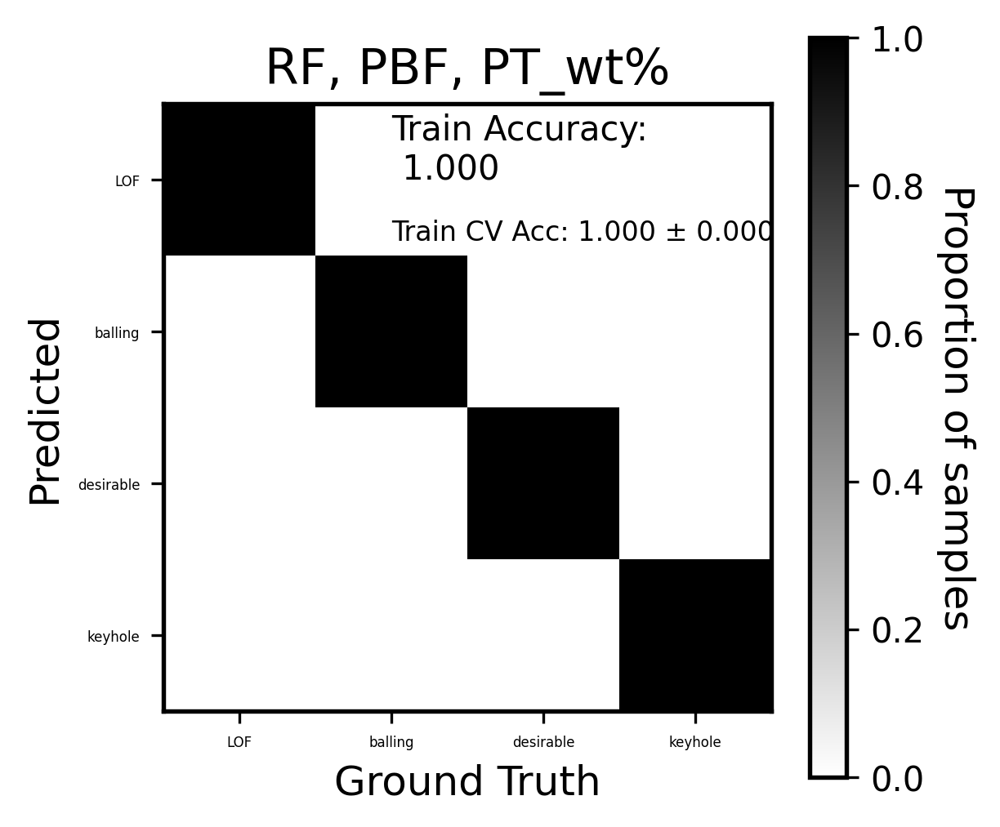

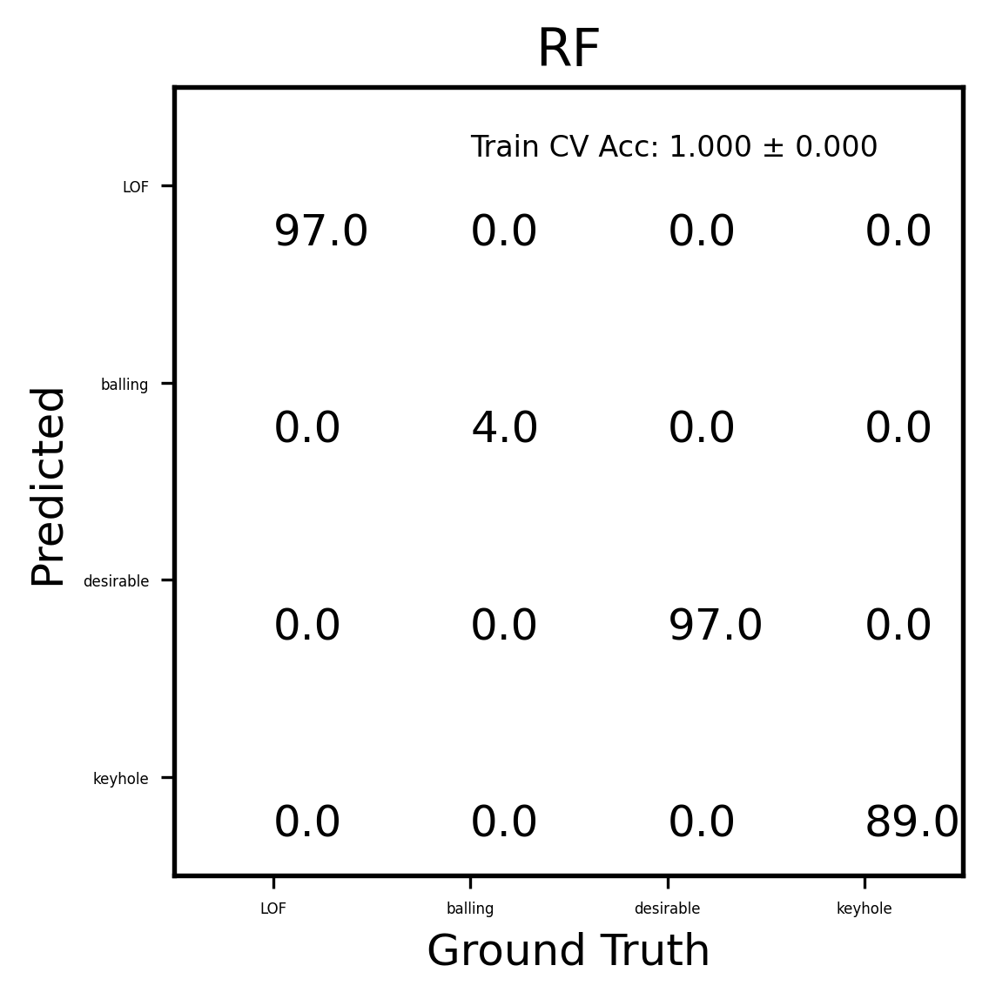

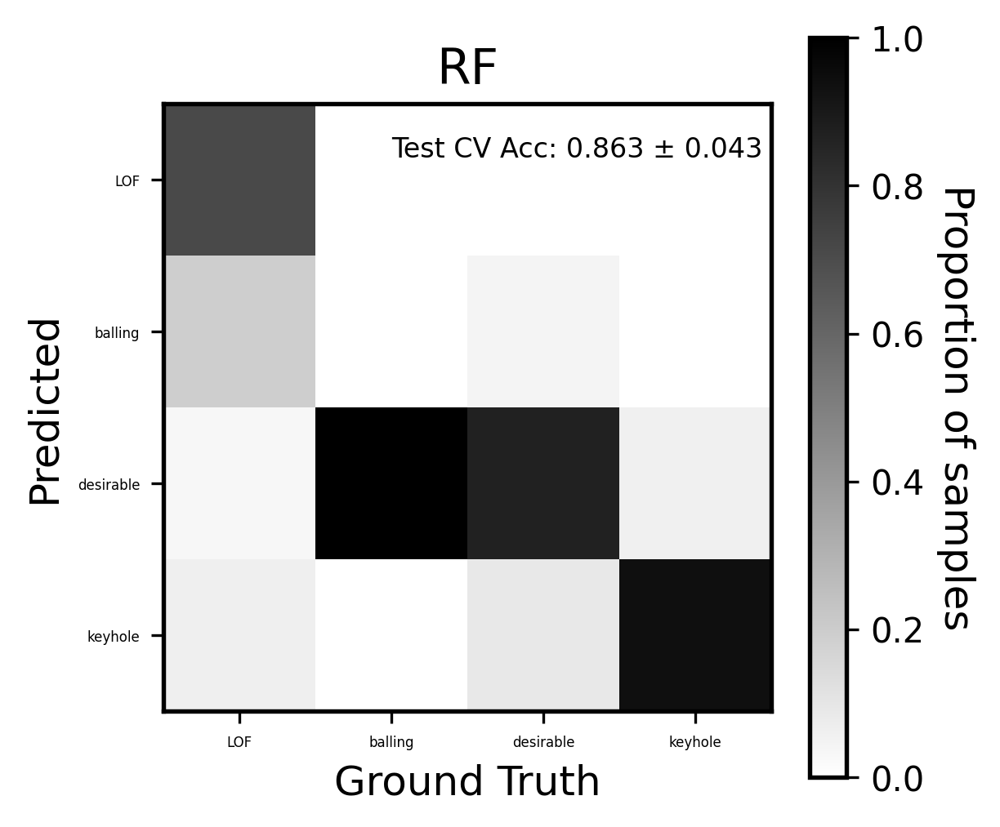

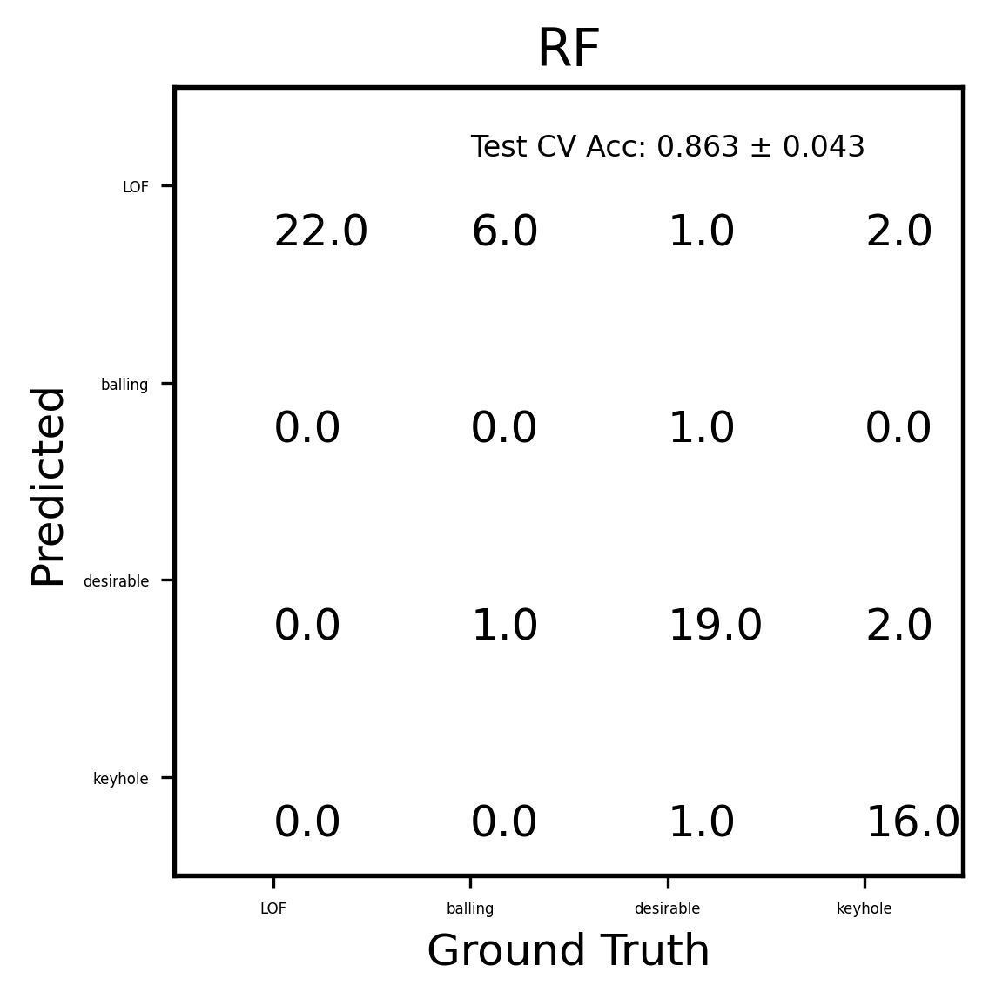

GaussianProcessClassifier()
GaussianProcessClassifier()
GaussianProcessClassifier()
GaussianProcessClassifier()
GaussianProcessClassifier()
GPC Train Accuracy: 0.80167 ± 0.00762, Test Accuracy: 0.68998 ± 0.03850


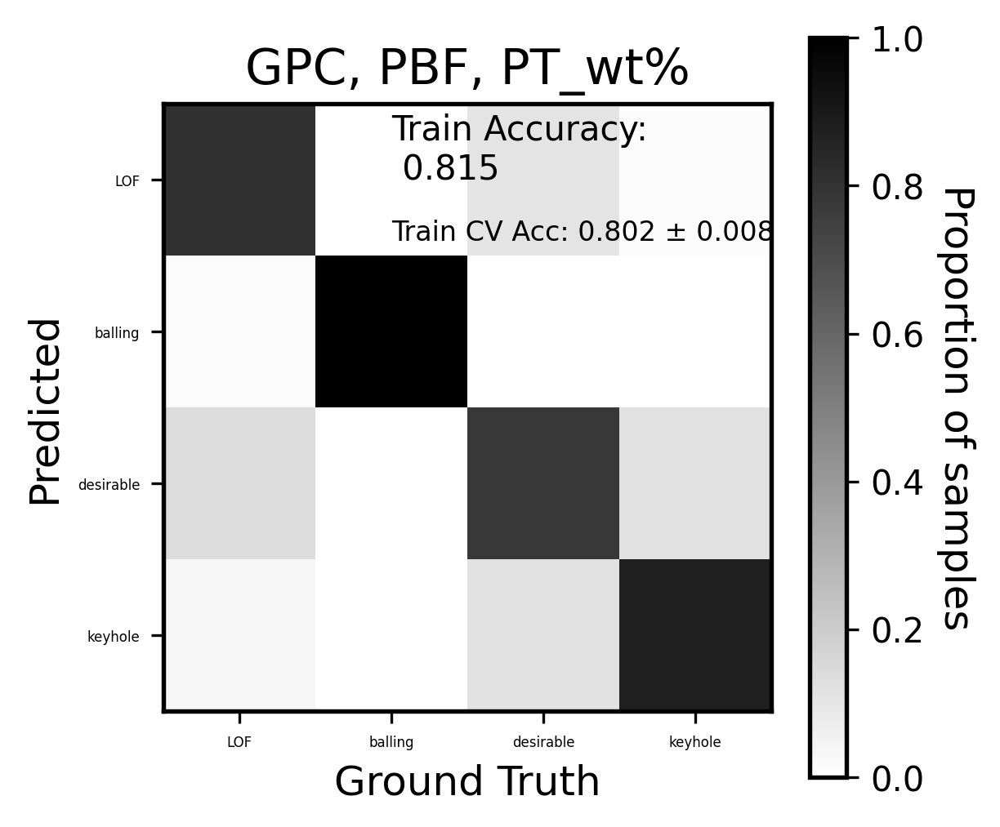

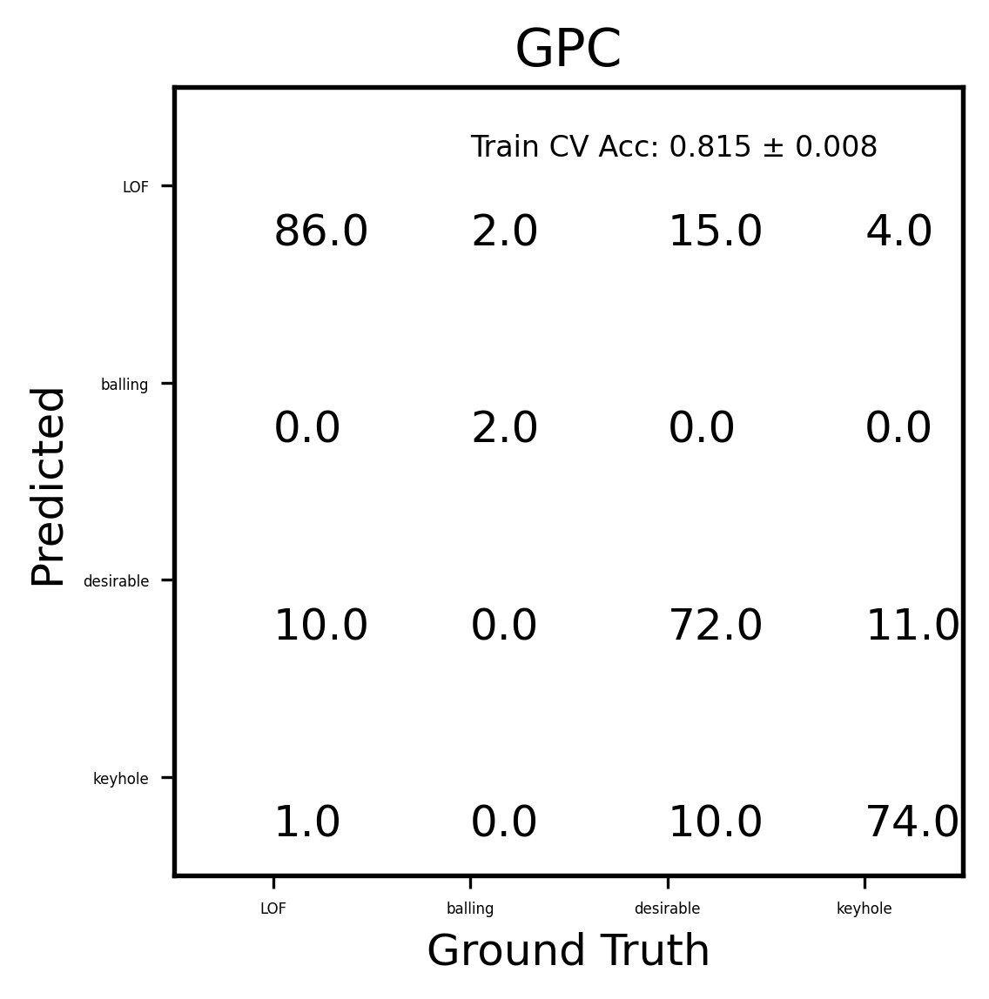

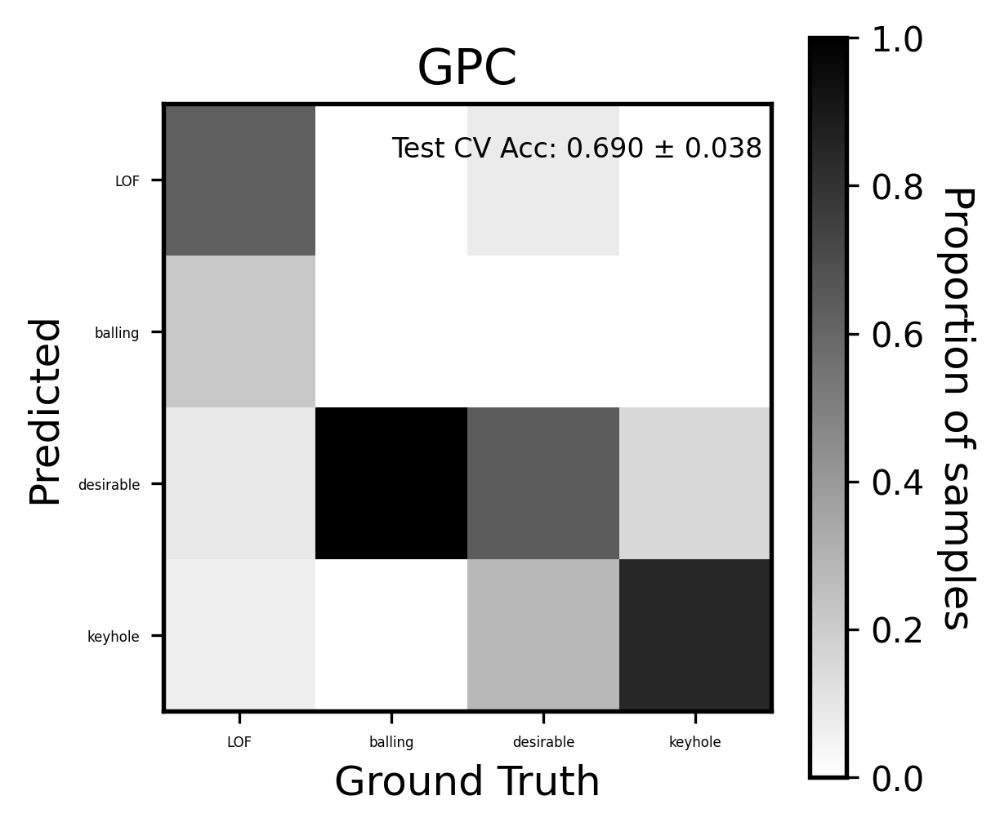

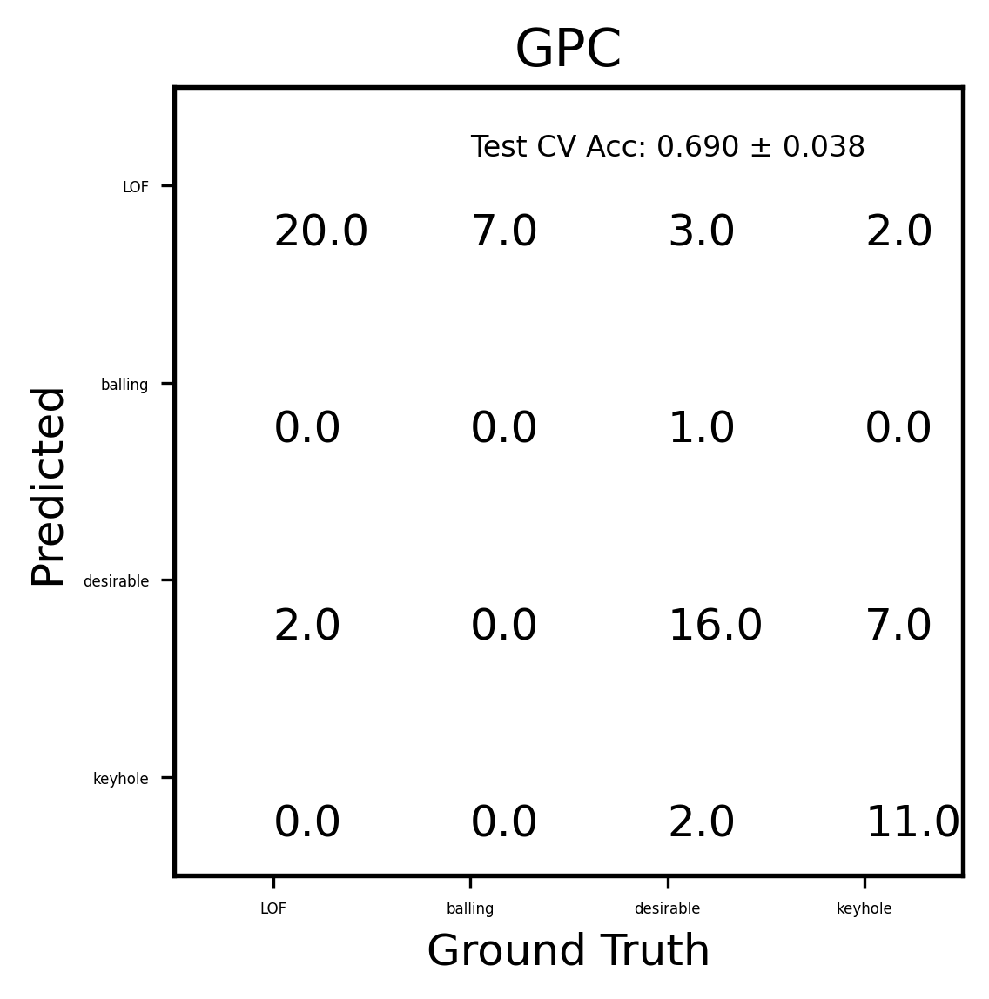

SVC()
SVC()
SVC()
SVC()
SVC()
SVC Train Accuracy: 0.63825 ± 0.02179, Test Accuracy: 0.59785 ± 0.04689


/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:181: RuntimeWarning: invalid value encountered in true_divide


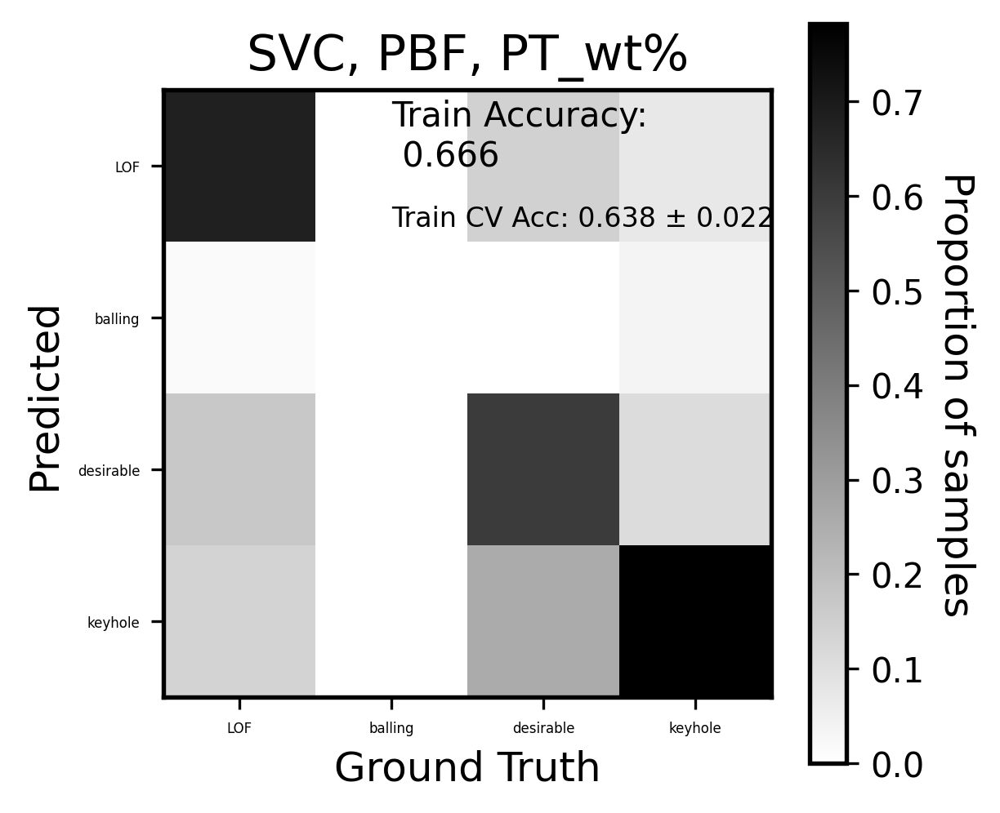

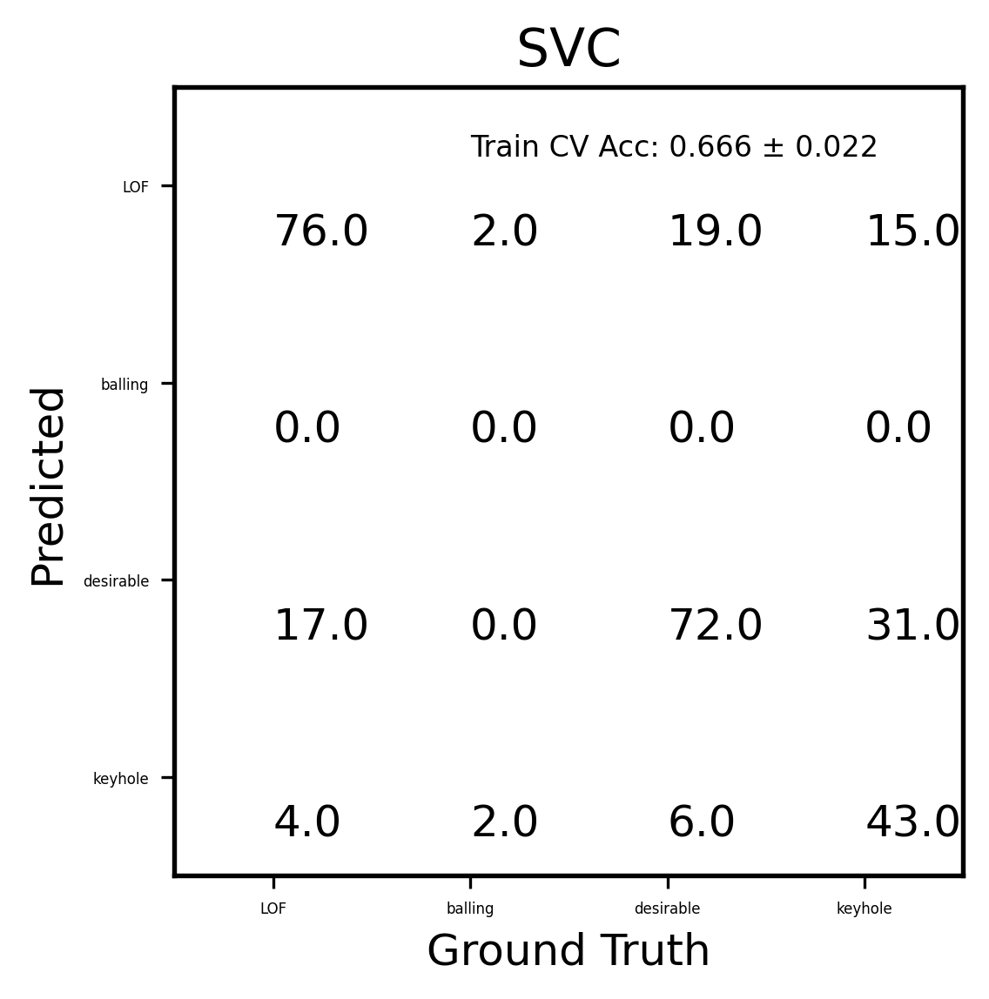

/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:259: RuntimeWarning: invalid value encountered in true_divide


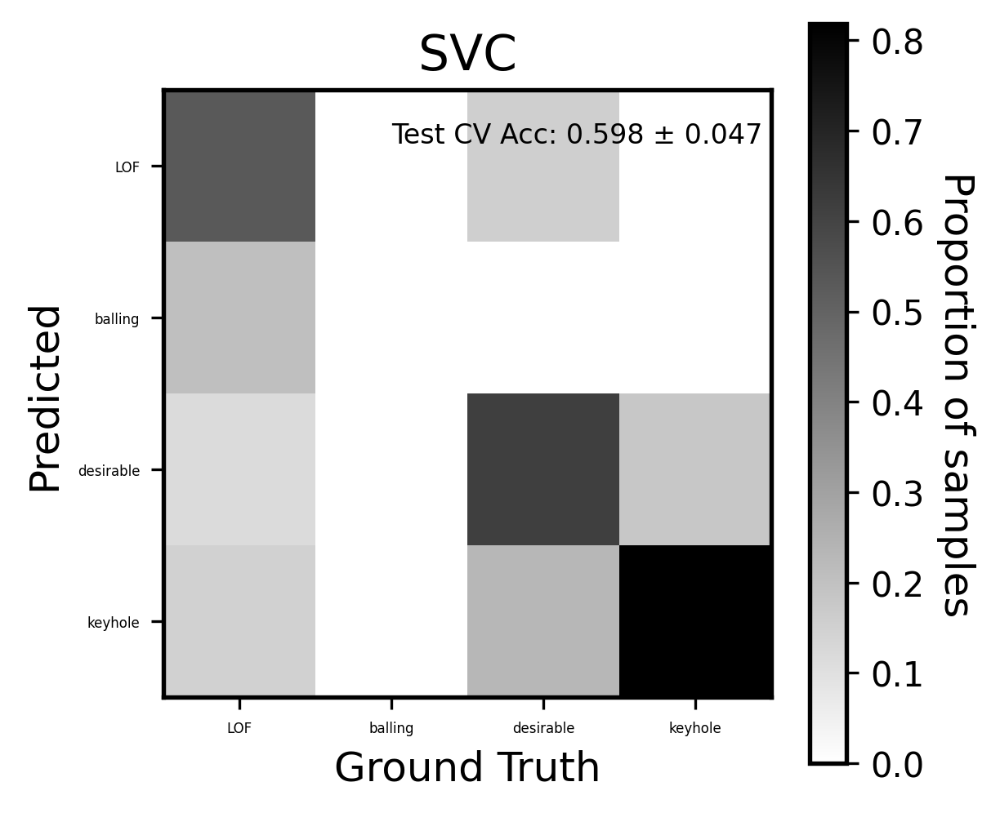

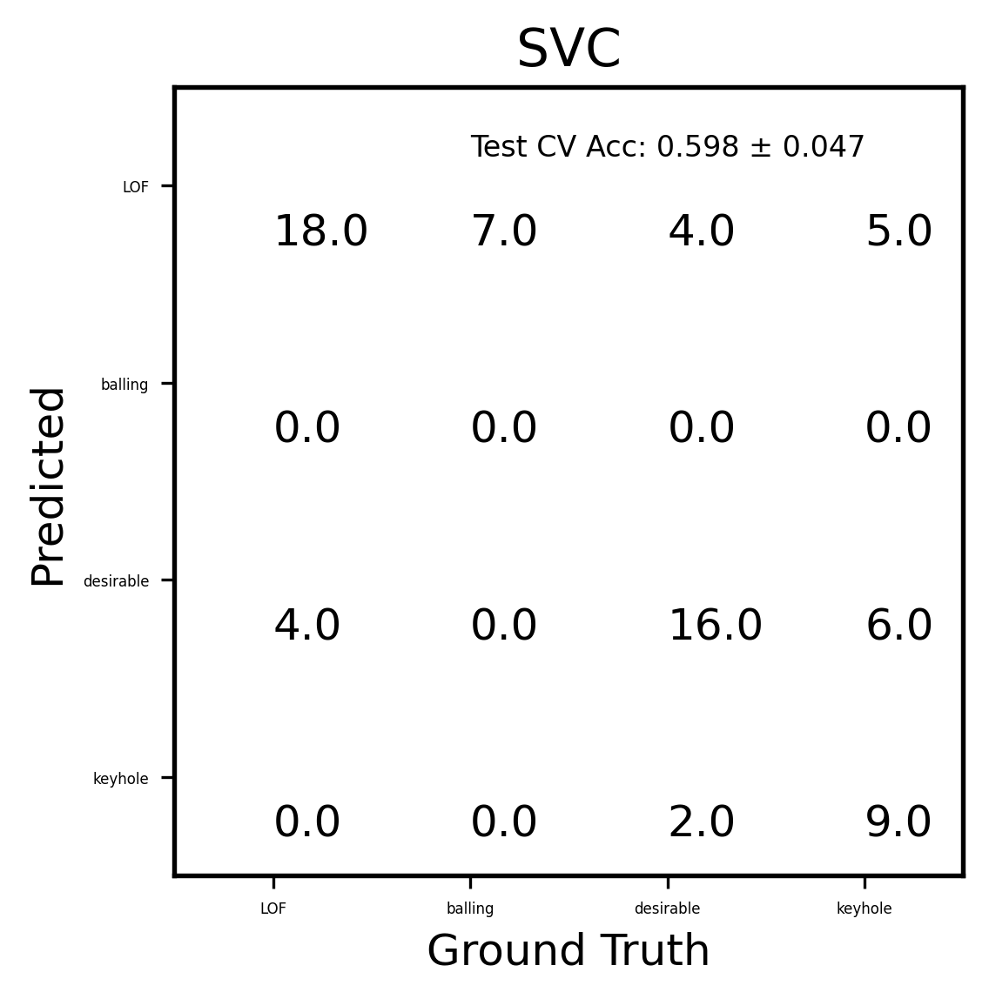

LogisticRegression(C=0.00045)
LogisticRegression(C=0.00045)
LogisticRegression(C=0.00045)
LogisticRegression(C=0.00045)
LogisticRegression(C=0.00045)
Logistic Regression Train Accuracy: 0.40293 ± 0.02075, Test Accuracy: 0.31585 ± 0.03215


/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:181: RuntimeWarning: invalid value encountered in true_divide


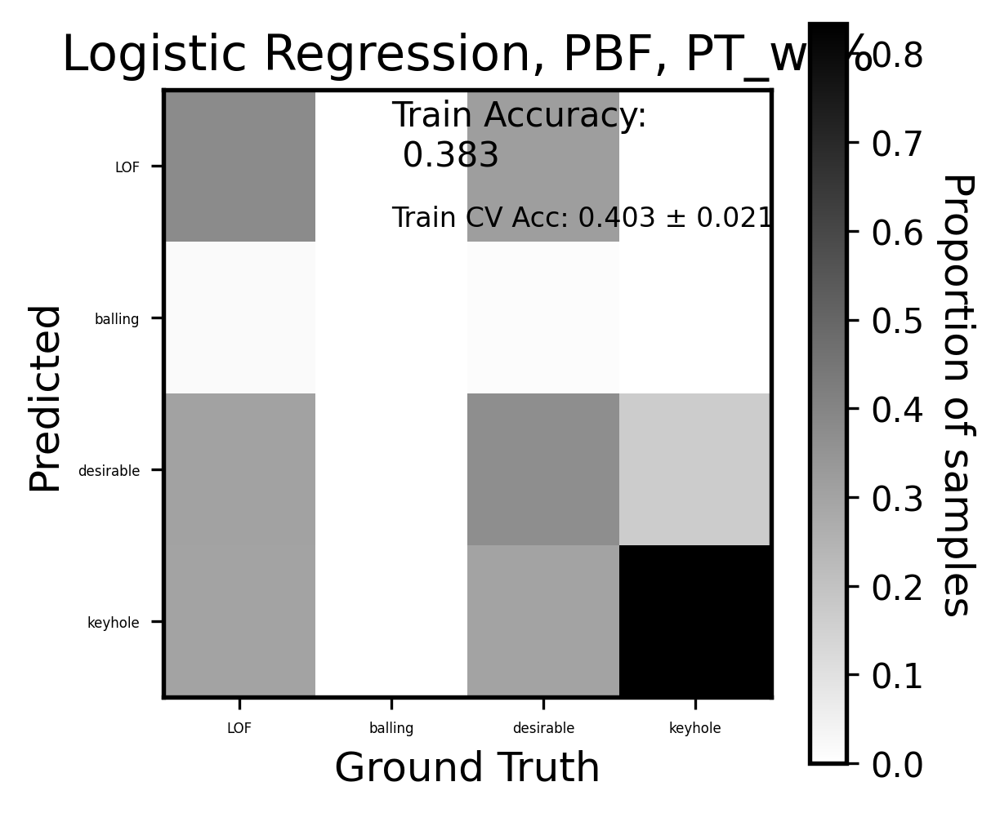

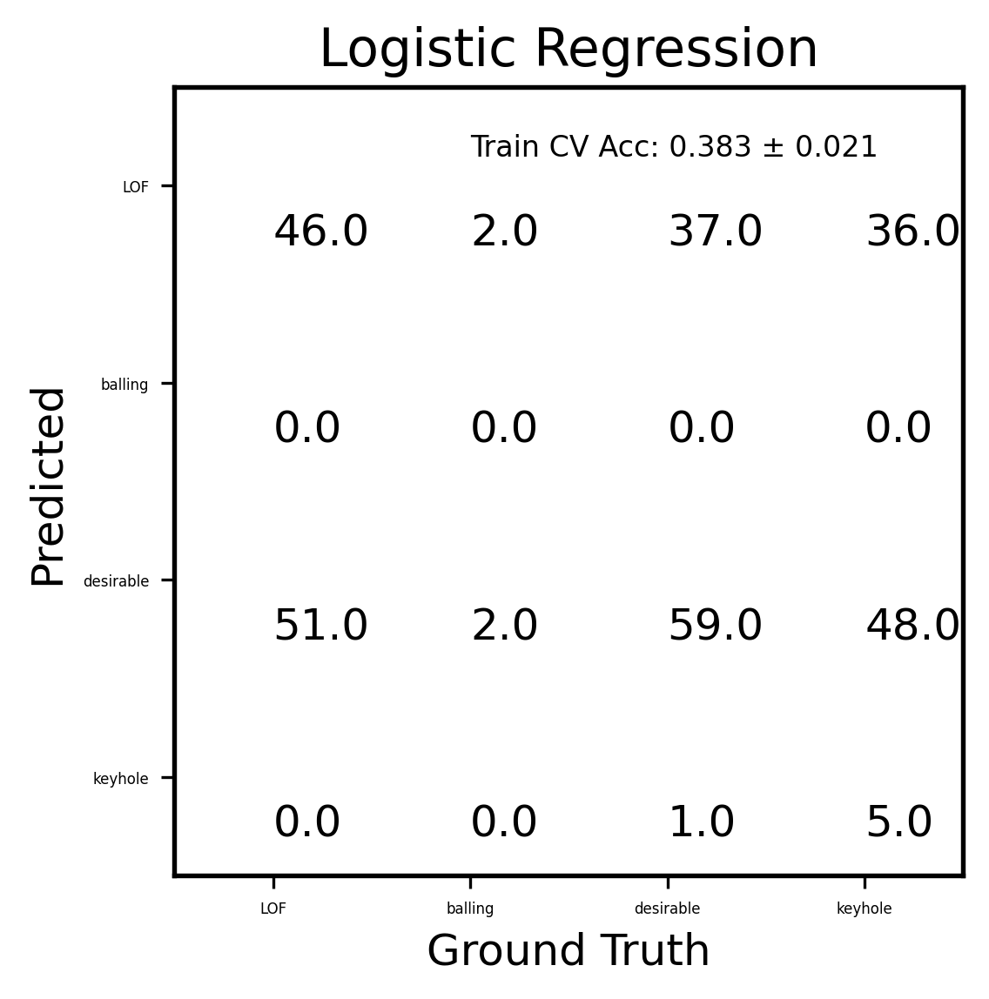

/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:259: RuntimeWarning: invalid value encountered in true_divide


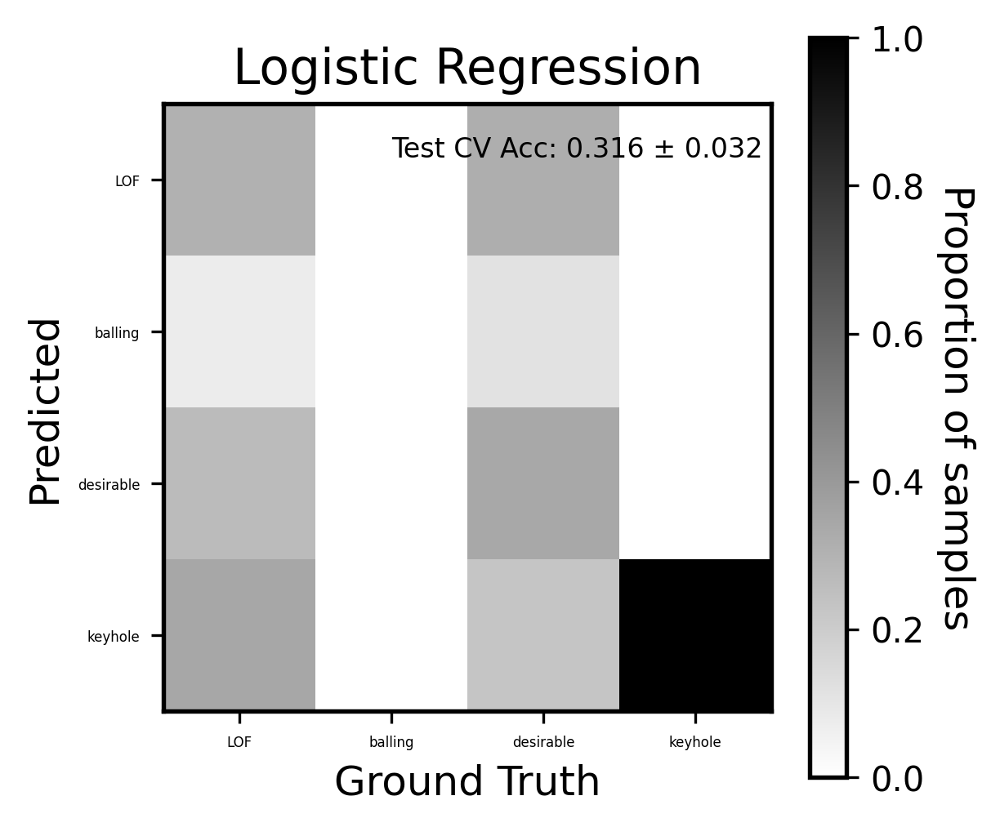

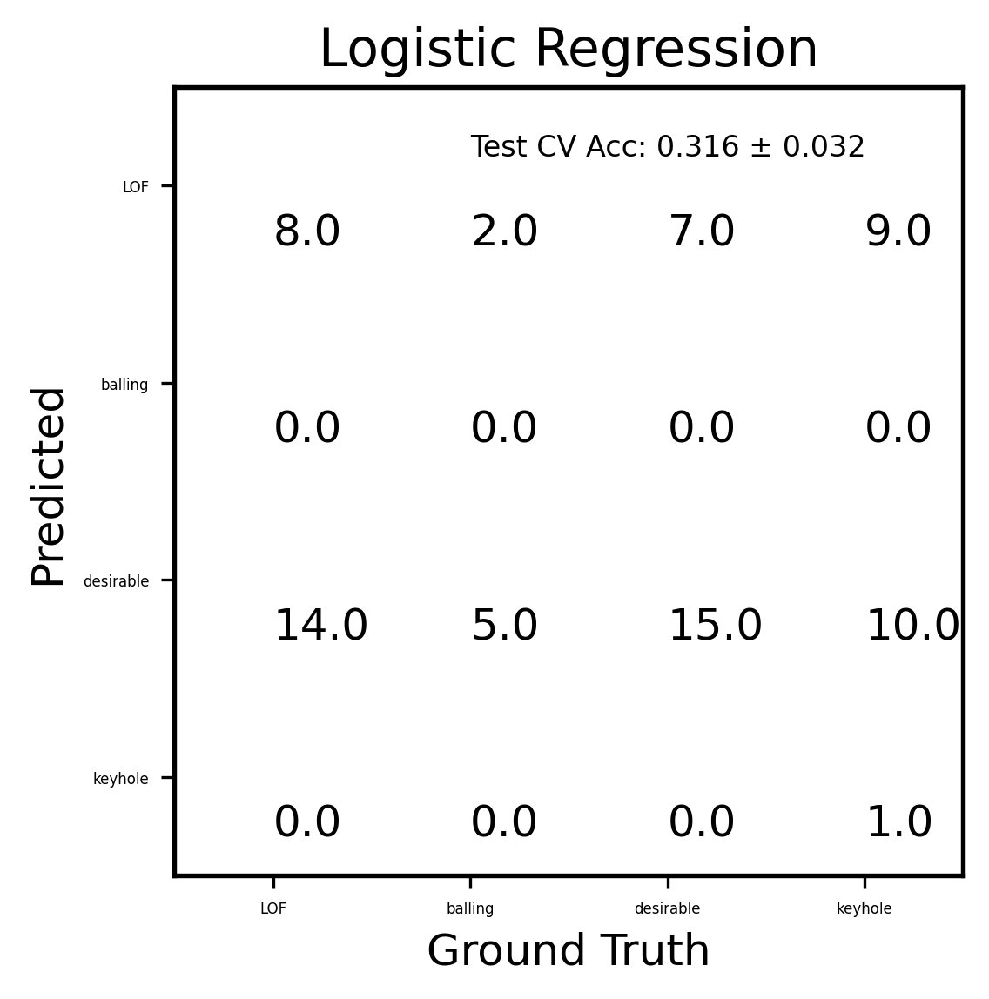

GradientBoostingClassifier()
GradientBoostingClassifier()
GradientBoostingClassifier()
GradientBoostingClassifier()
GradientBoostingClassifier()
GB Train Accuracy: 1.00000 ± 0.00000, Test Accuracy: 0.85450 ± 0.03915


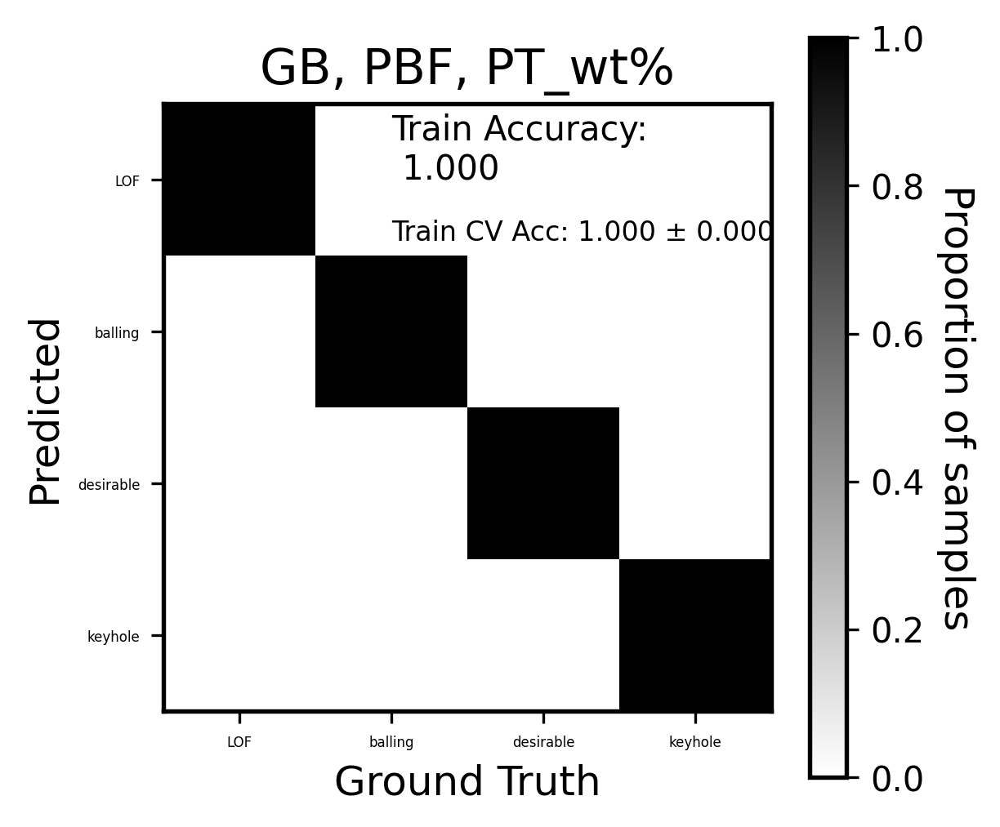

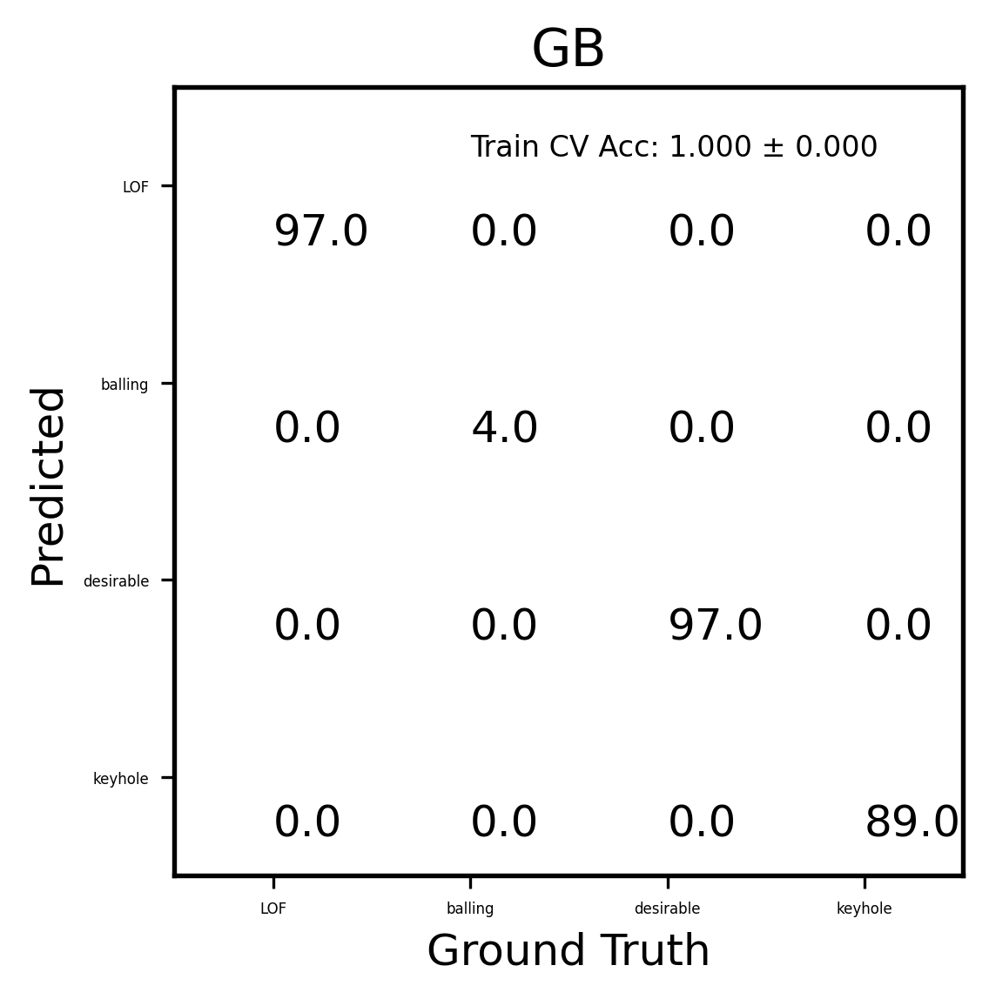

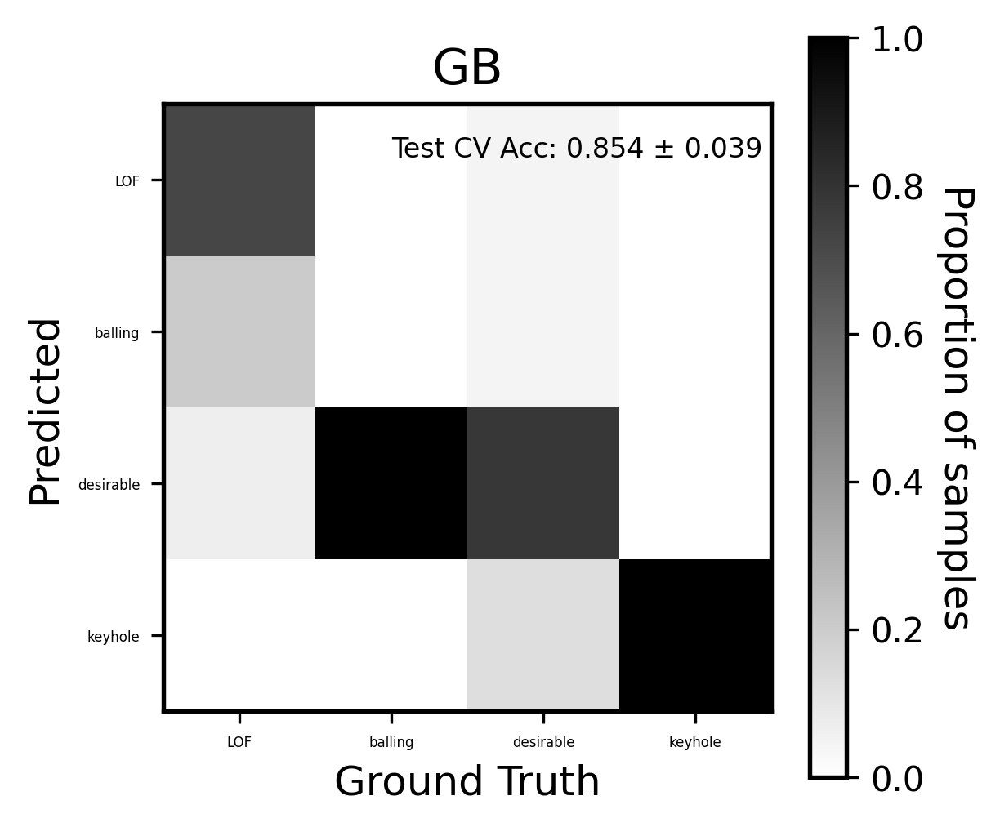

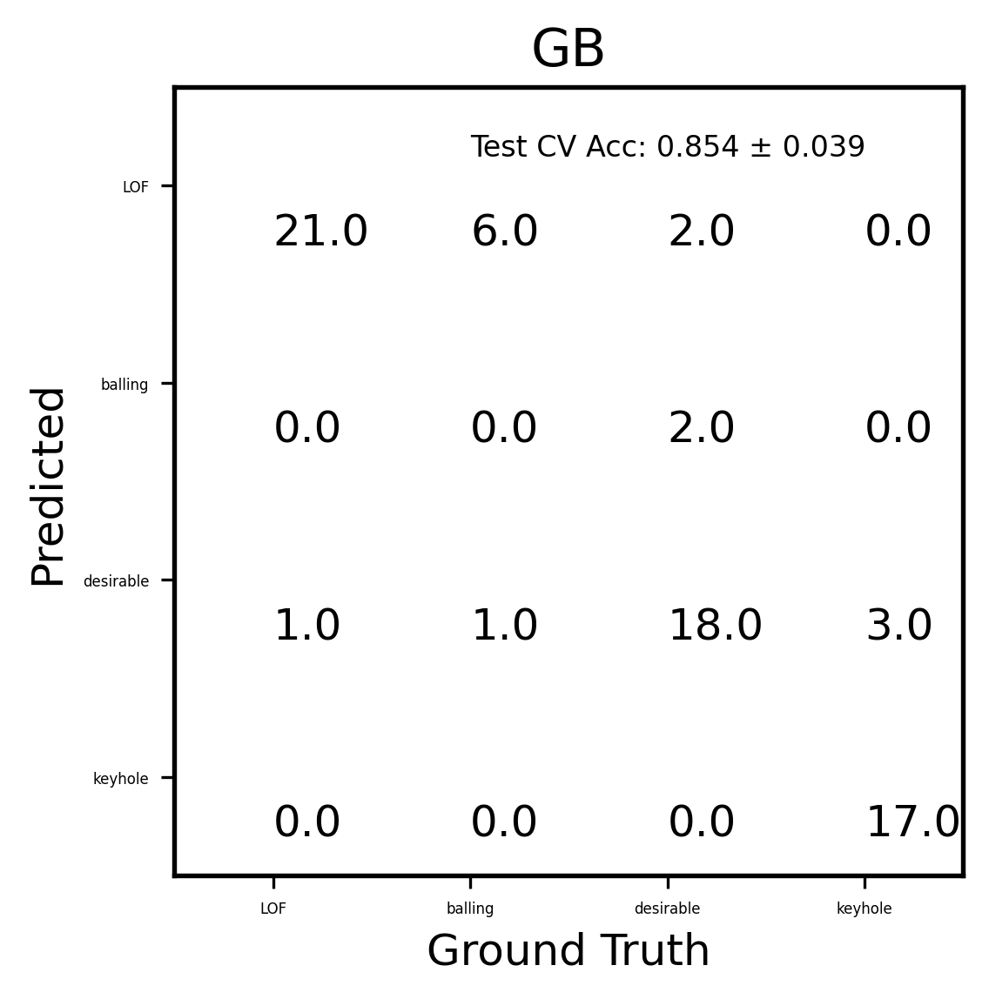

MLPClassifier(hidden_layer_sizes=(32, 64, 64), max_iter=20000)
MLPClassifier(hidden_layer_sizes=(32, 64, 64), max_iter=20000)
MLPClassifier(hidden_layer_sizes=(32, 64, 64), max_iter=20000)
MLPClassifier(hidden_layer_sizes=(32, 64, 64), max_iter=20000)
MLPClassifier(hidden_layer_sizes=(32, 64, 64), max_iter=20000)
NN Train Accuracy: 0.97207 ± 0.01148, Test Accuracy: 0.81577 ± 0.05774


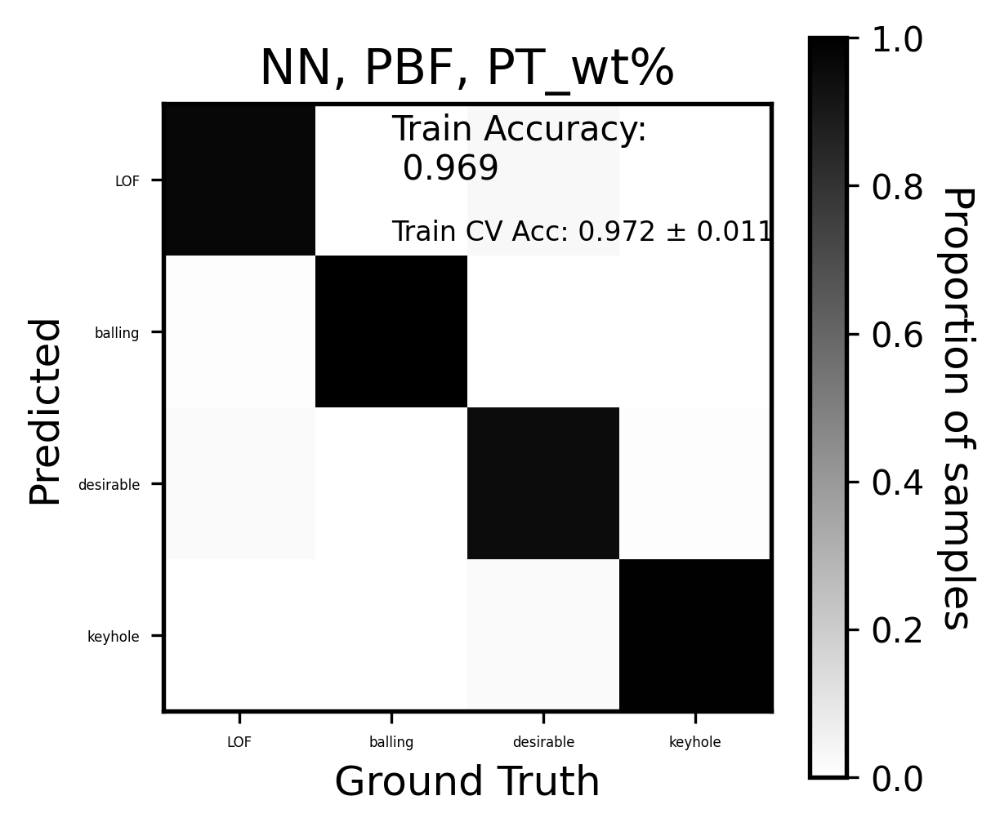

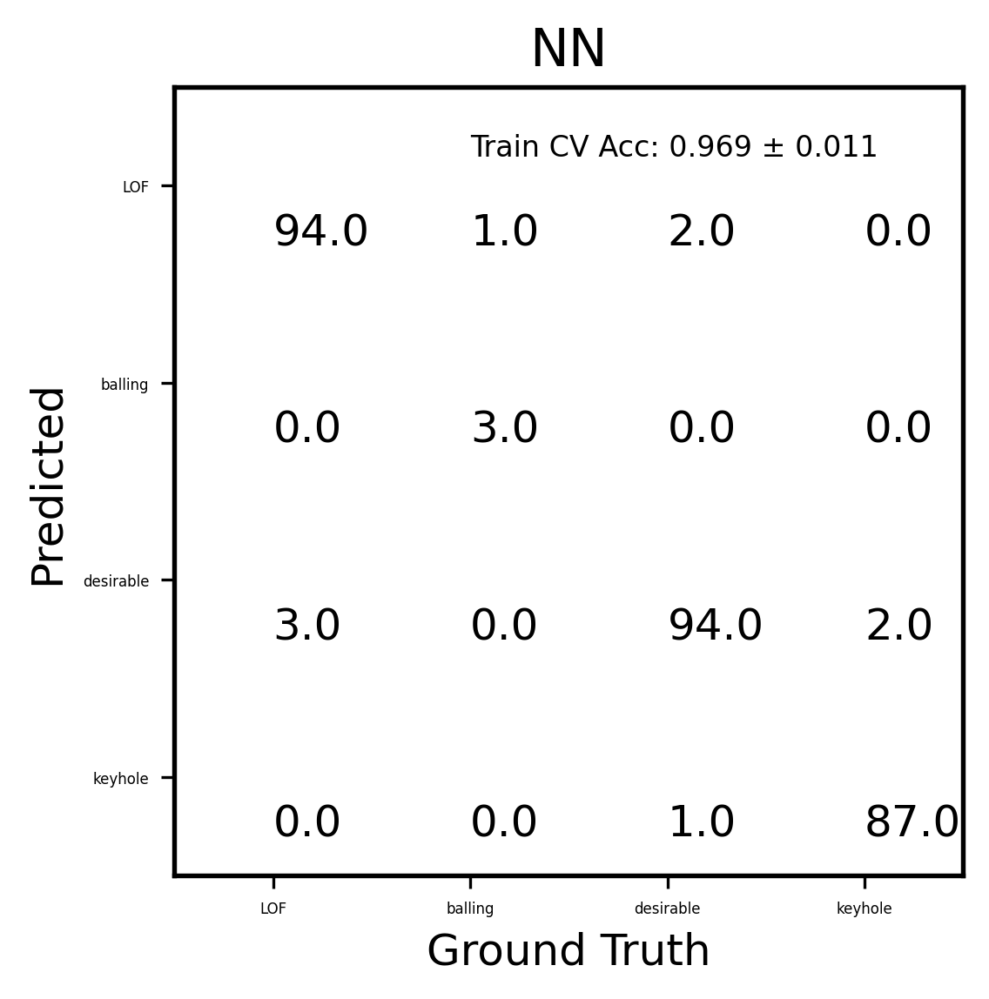

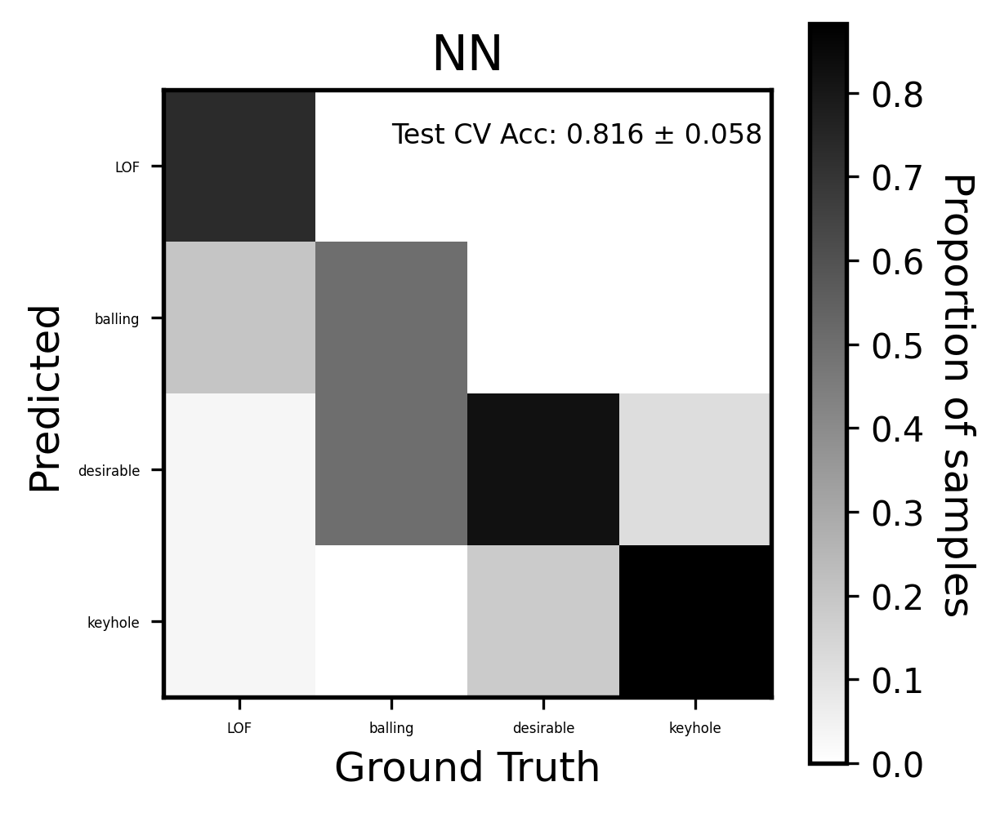

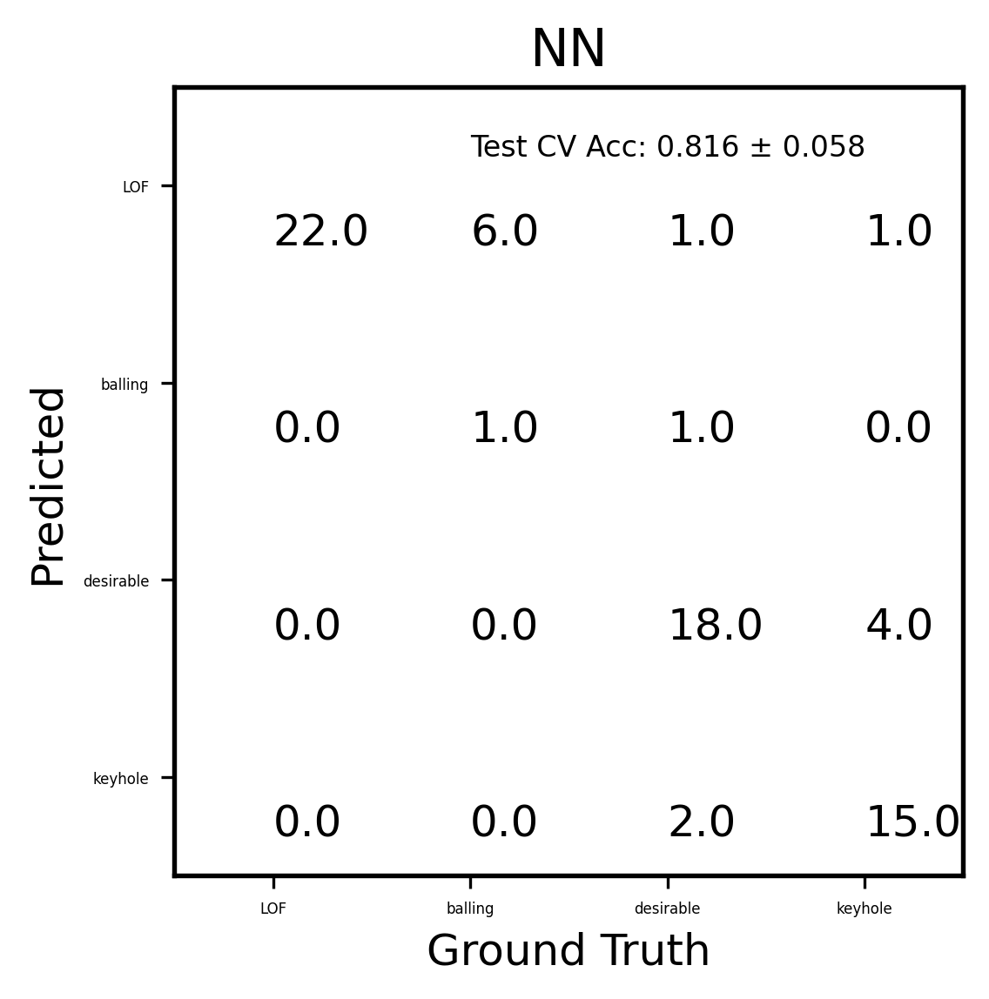

In [44]:
%matplotlib inline
# Define parameters that models will be trained on and value to be predicted
parameter_list = ['Power', 'Velocity', 'density', 'Cp', 'k' , 'beam D', 'melting T', 'layer thickness', 'absorption coefficient']

atomic_features = []
for col in csv.columns:
   # print('%' in col)
    if '%' in col:
        atomic_features.append(col)

parameter_list.extend(atomic_features)

label_col = 'meltpool shape'


#new_csv = select_subset(new_csv, 'paper ID', 19)
#new_csv = select_material(new_csv, 'Ti6Al4V')

#Form dataset array from dataframe, given parameter_list, label_col
# function select_parameters() does this as well
data_list = []
label_list = []

new_csv = select_process(class_csv, 'PBF')

#new_csv = select_material(new_csv, 'Ti-6Al-4V')
test = 0
for i in range(len(new_csv)):
    success, features, label = extract_features(new_csv.iloc[i], parameter_list, label_col)
    if success < 0:
      #  print("CONTINUE")
        continue
    else:
        test += 1
        print(test)
        data_list.append(features)
        label_list.append(label)
print('length in PBF data: ', len(new_csv))
print('Used data points: ', test)
X= np.array(np.squeeze(data_list))
labels = np.unique(label_list)

# Define labels from csv file
label_id = np.arange(len(labels))
class_labels = np.zeros(len(label_list))
for idx, sample in enumerate(label_list):
    for l_id, lbl in enumerate(labels):
        if lbl == sample:
            class_labels[idx] = l_id
y = np.array(class_labels)
 
class_labels = np.array(class_labels,dtype = 'int')

fit_models_wt, train_accuracy_wt, train_accuracy_std_wt, test_accuracy_wt, test_accuracy_std_wt = classify_learn(X.reshape(-1, len(X[0])), y, labels, parameters = parameter_list, title = 'PBF, PT_wt%', plot = True, prefix = 'classification')

## Classification with PT and Material one hot encoding

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
length in PBF data:  2178
Used data points:  252
252
RandomForestClassifier()
RandomForestClassifier

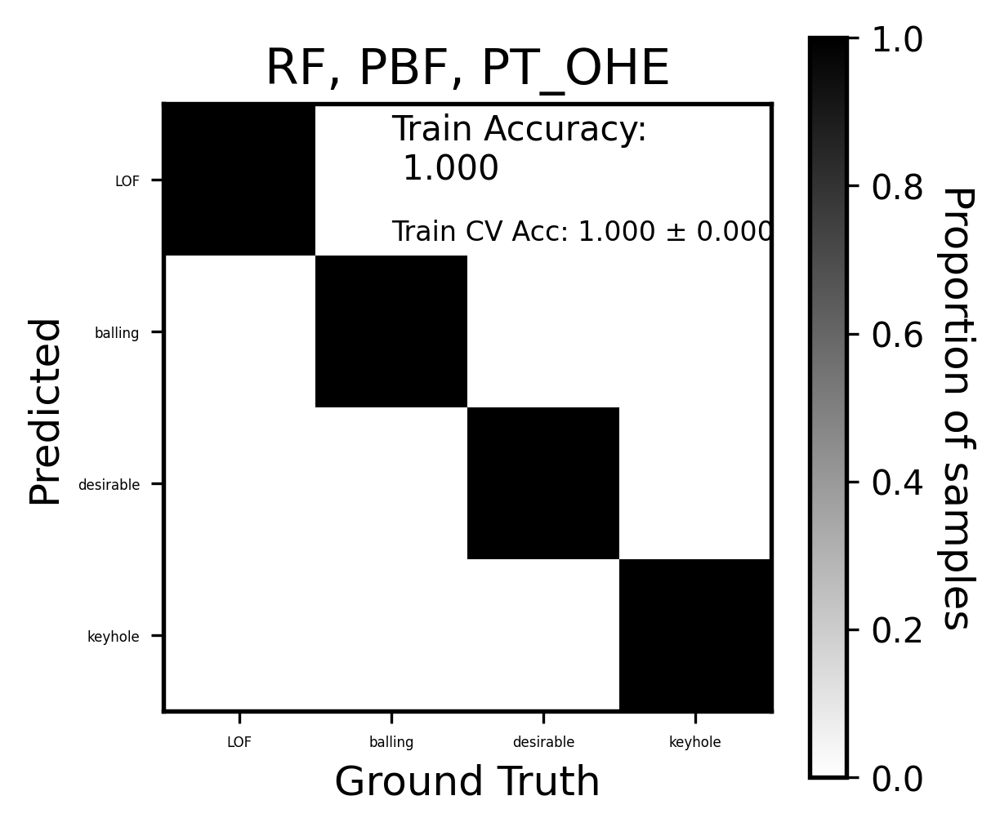

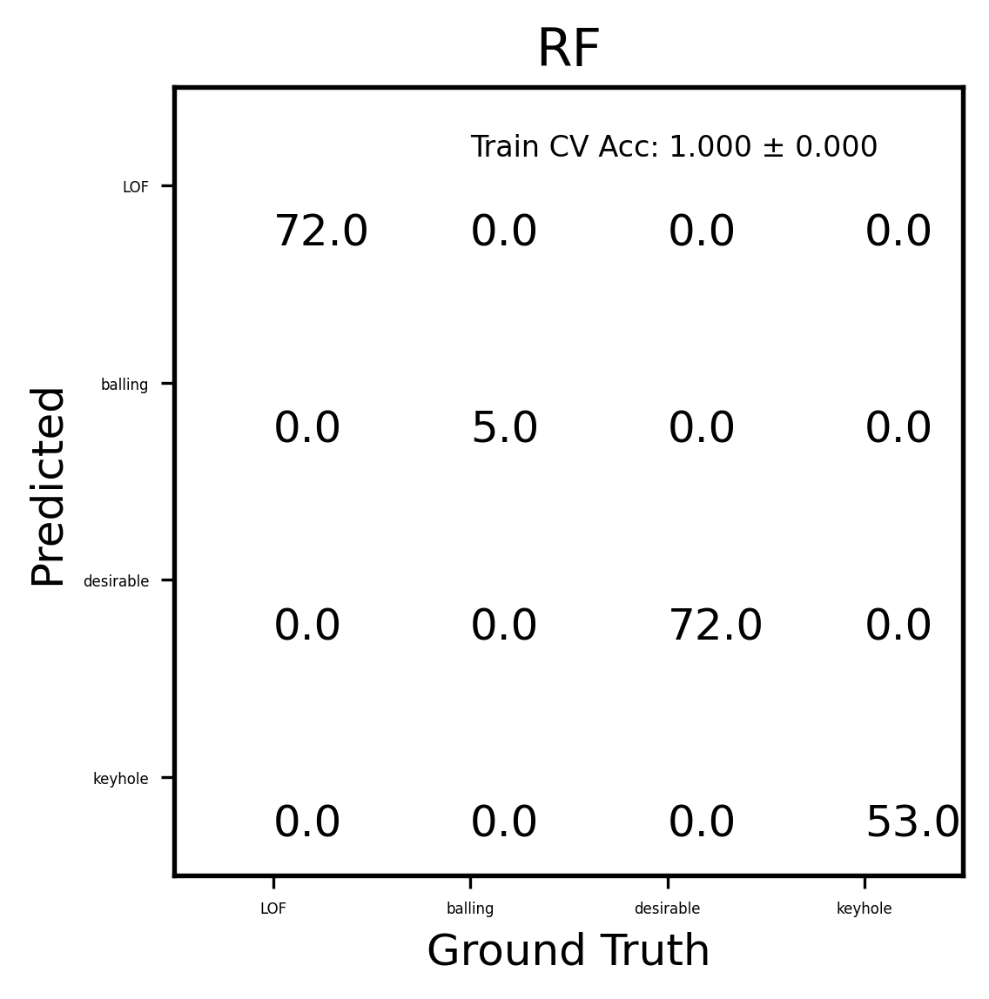

/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:259: RuntimeWarning: invalid value encountered in true_divide


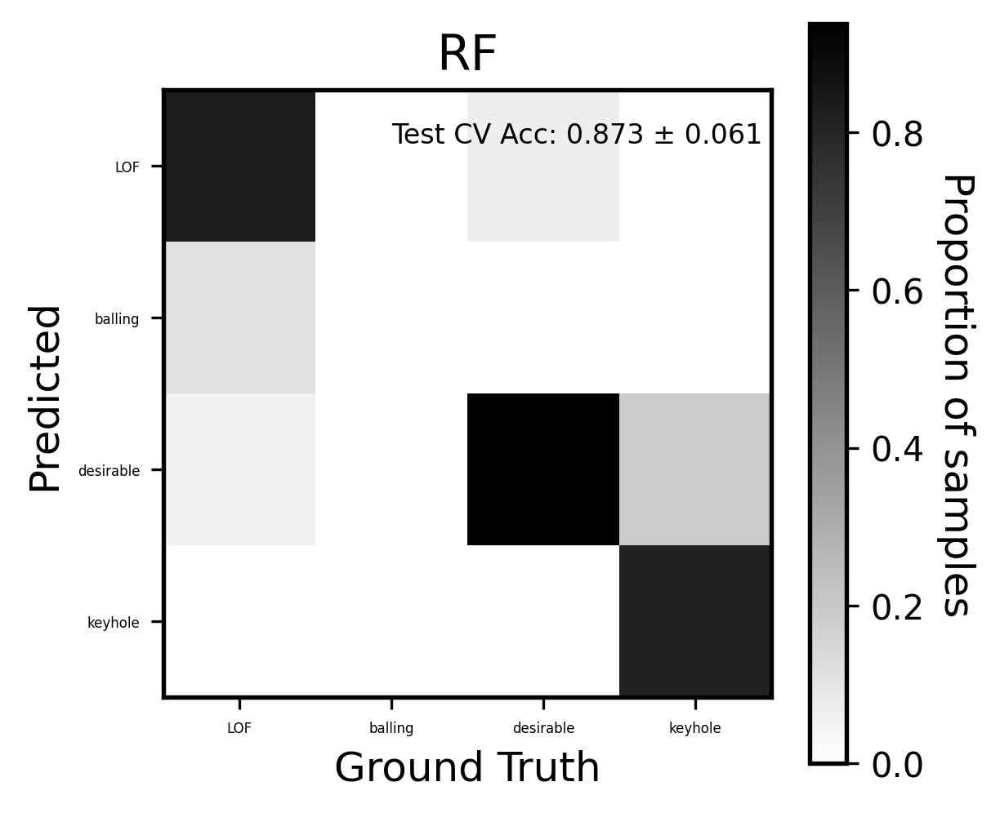

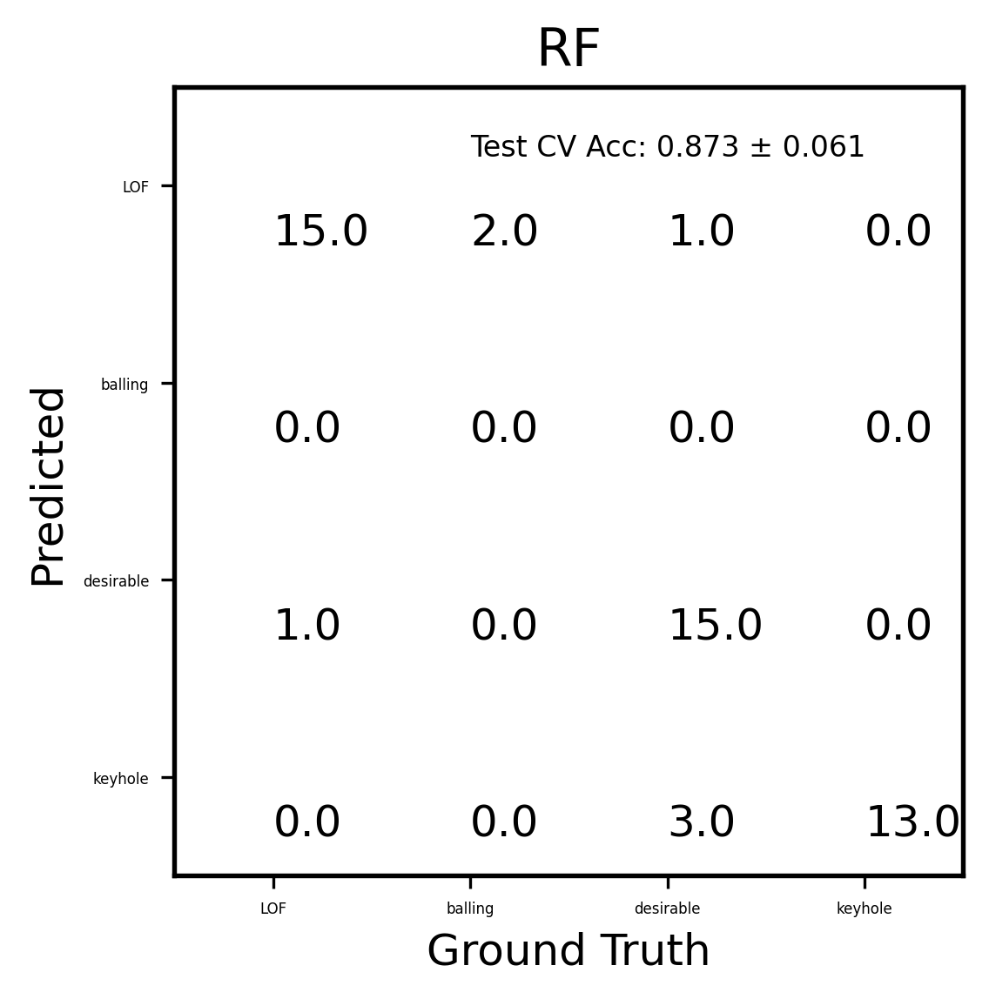

GaussianProcessClassifier()
GaussianProcessClassifier()
GaussianProcessClassifier()
GaussianProcessClassifier()
GaussianProcessClassifier()
GPC Train Accuracy: 0.85218 ± 0.01009, Test Accuracy: 0.73412 ± 0.06011


/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:181: RuntimeWarning: invalid value encountered in true_divide


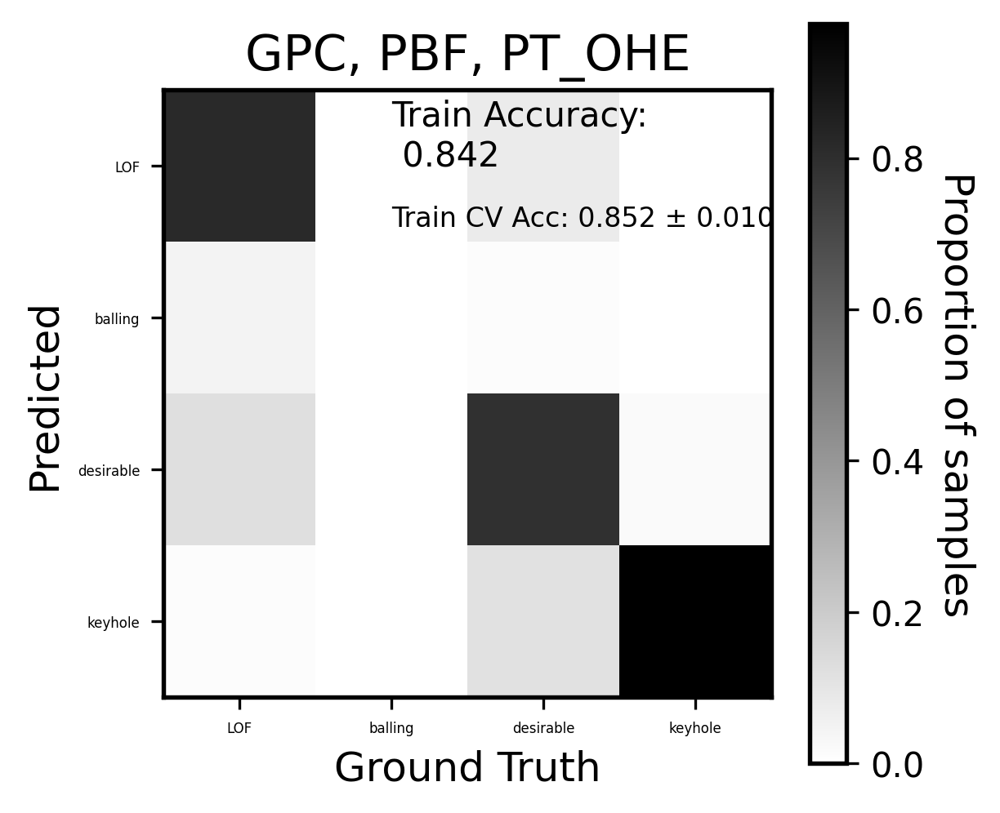

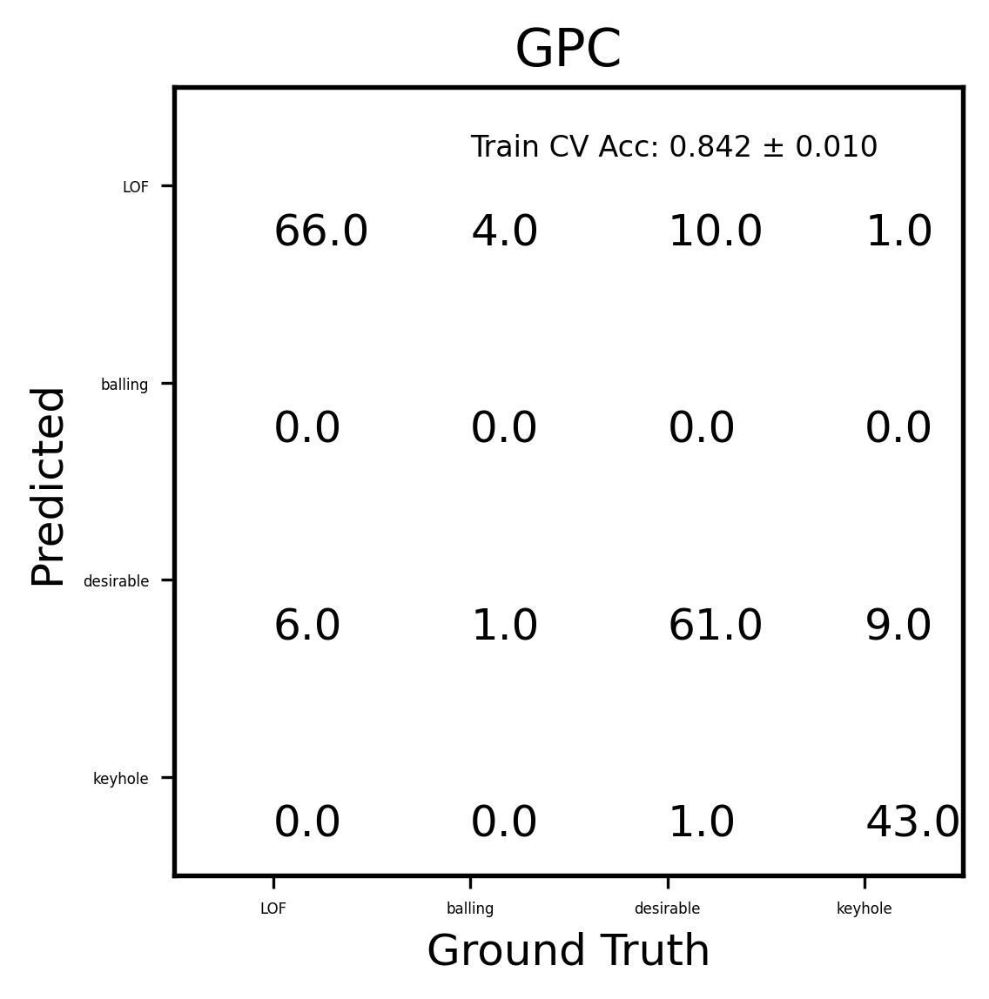

/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:259: RuntimeWarning: invalid value encountered in true_divide


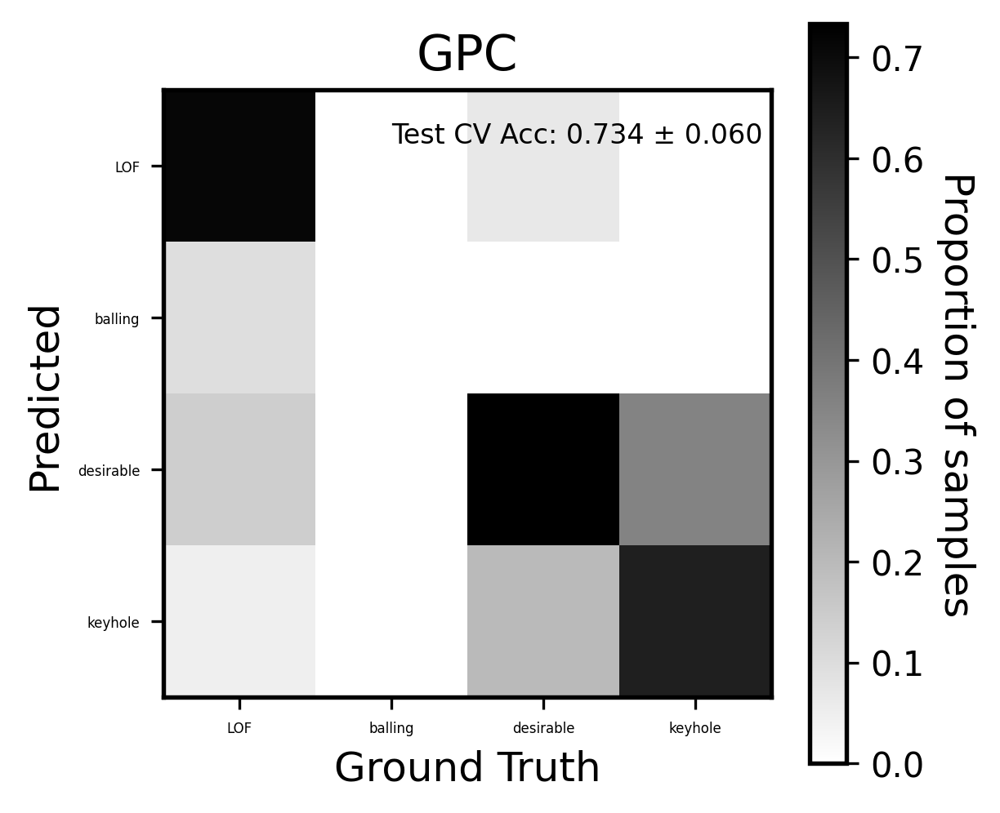

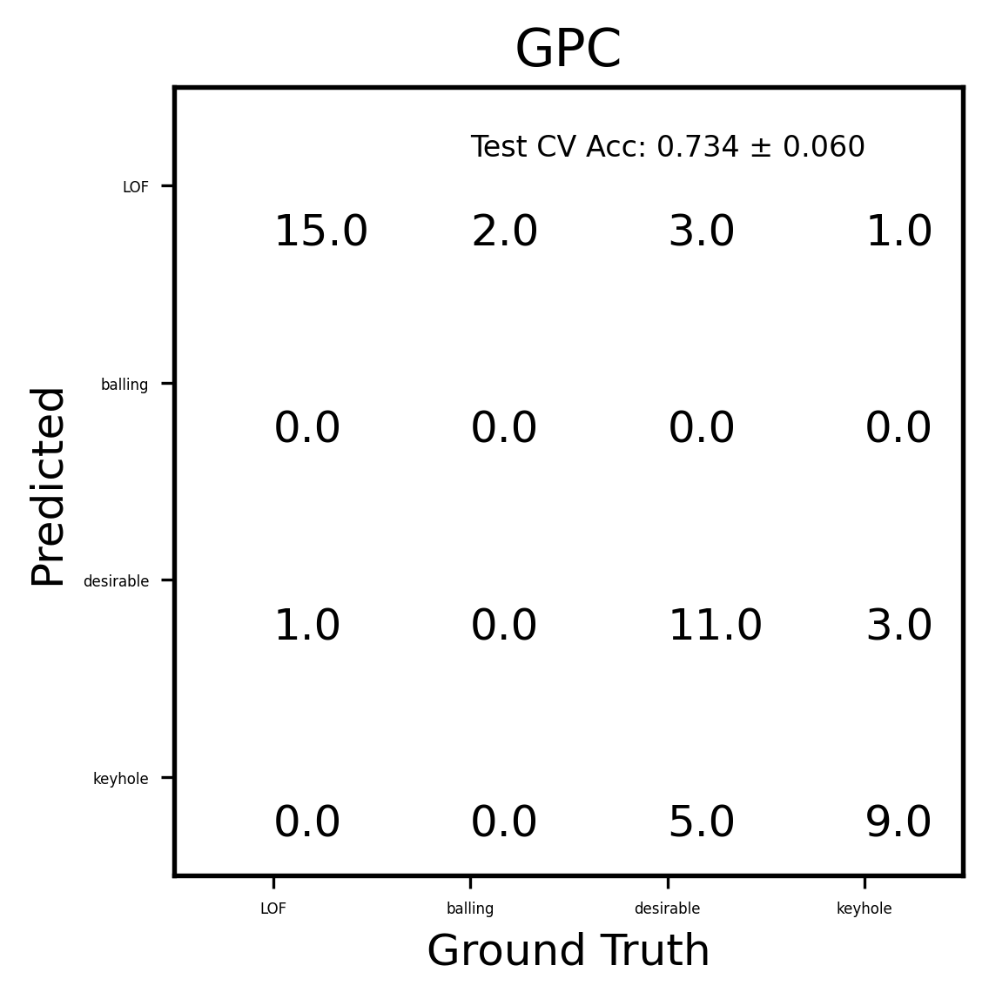

SVC()
SVC()
SVC()
SVC()
SVC()
SVC Train Accuracy: 0.75098 ± 0.00820, Test Accuracy: 0.68220 ± 0.06945


/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:181: RuntimeWarning: invalid value encountered in true_divide


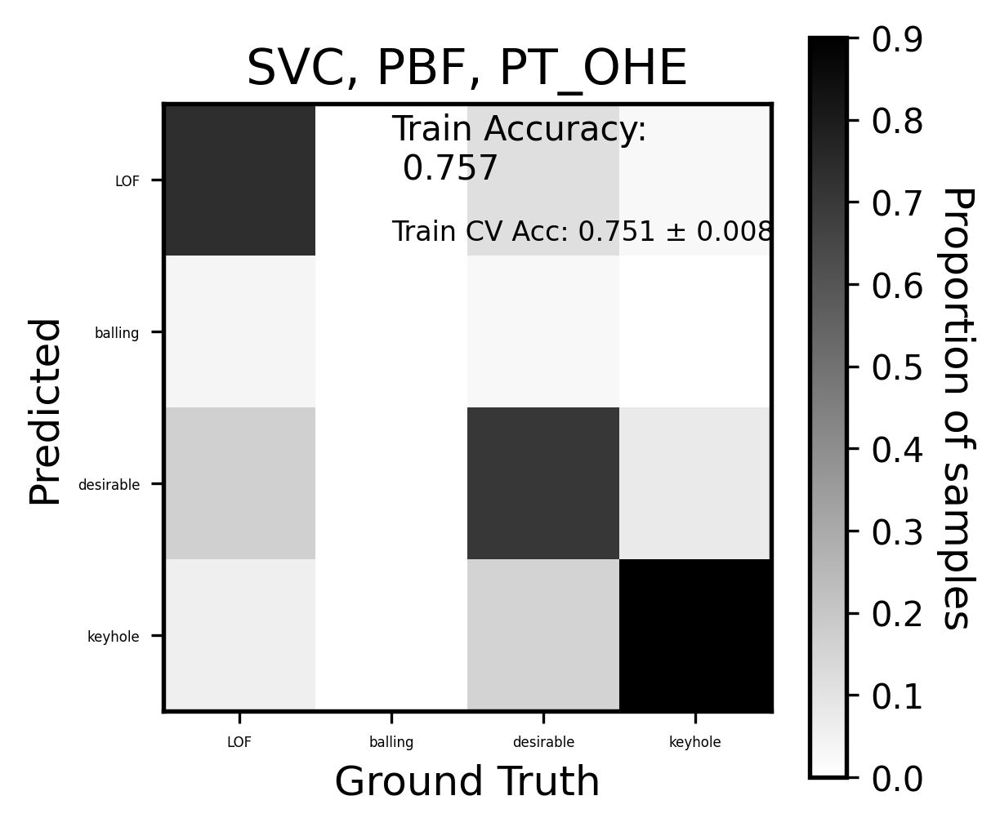

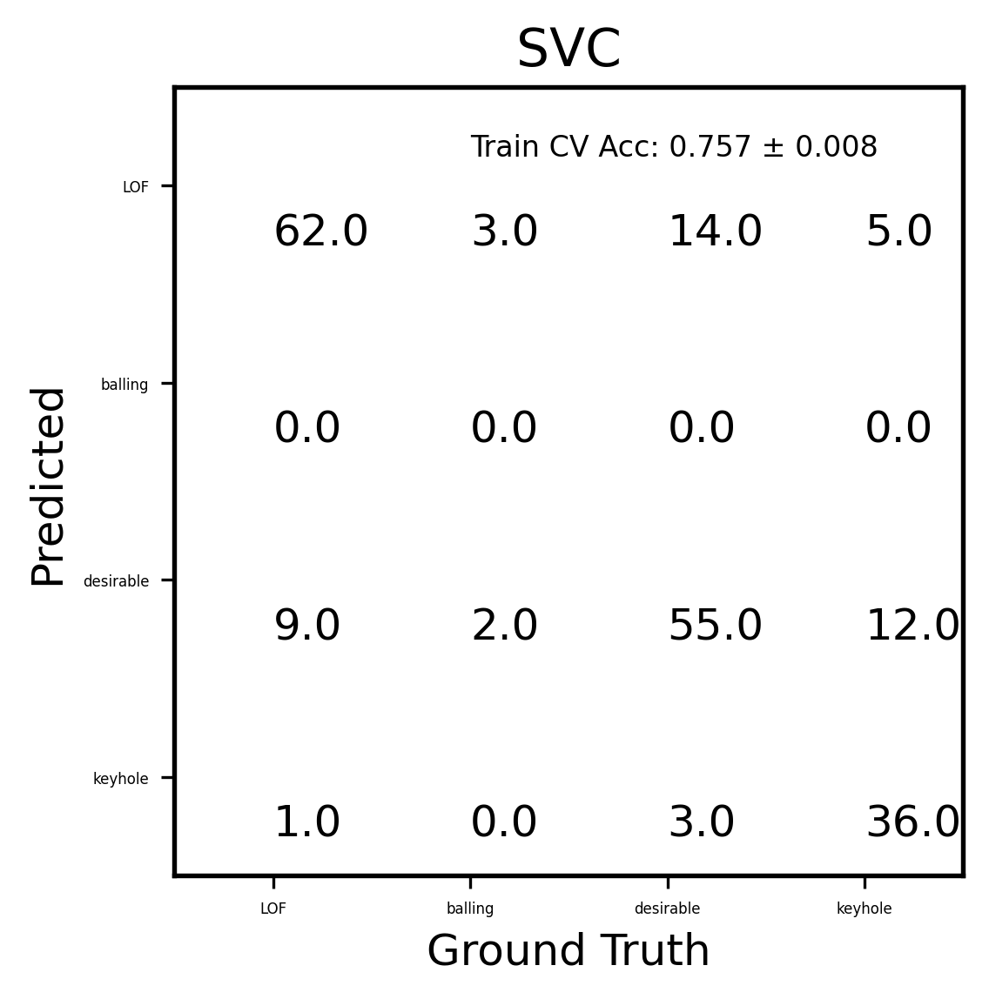

/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:259: RuntimeWarning: invalid value encountered in true_divide


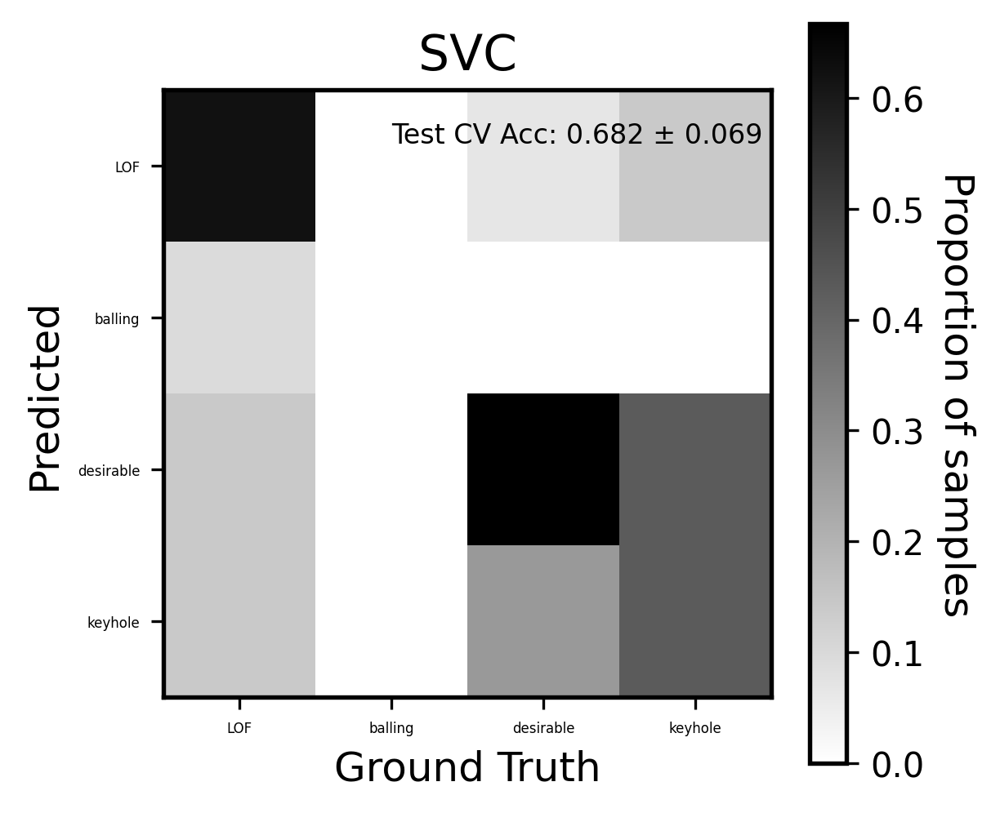

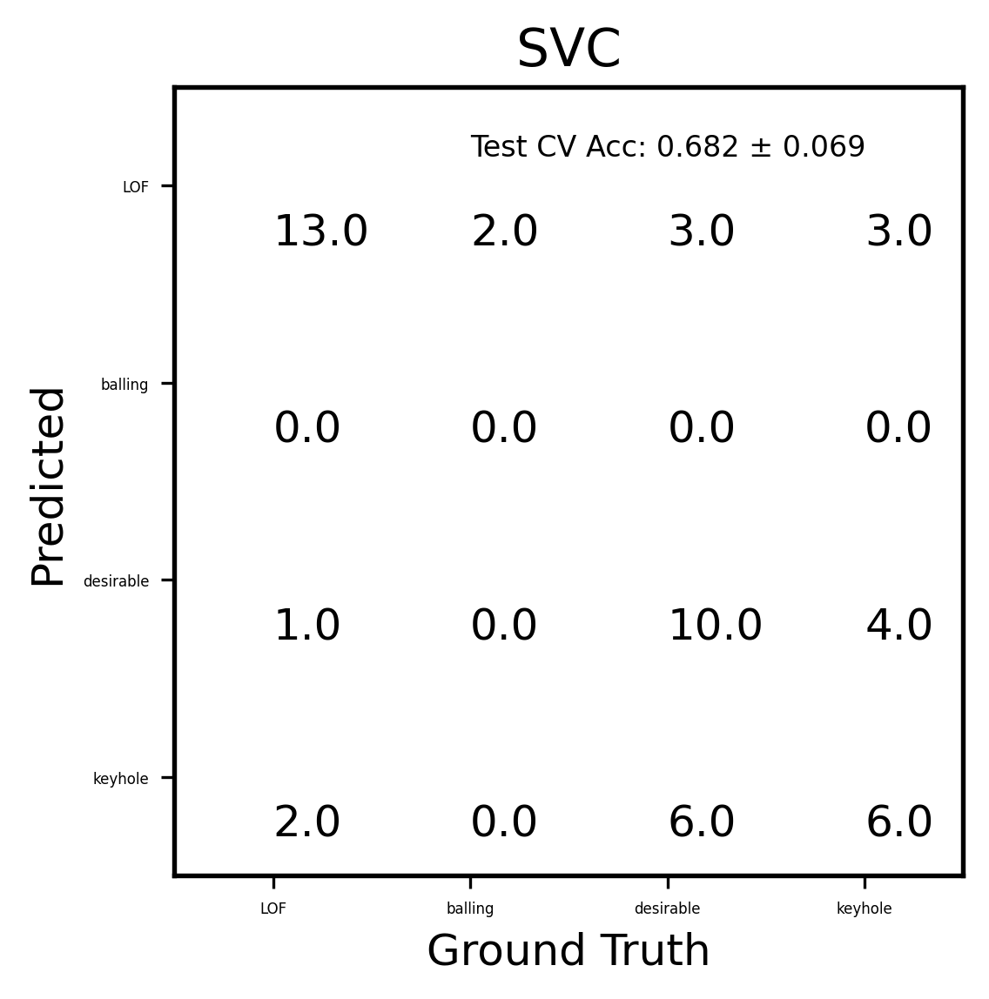

LogisticRegression(C=0.00045)
LogisticRegression(C=0.00045)
LogisticRegression(C=0.00045)
LogisticRegression(C=0.00045)
LogisticRegression(C=0.00045)
Logistic Regression Train Accuracy: 0.41661 ± 0.06200, Test Accuracy: 0.36165 ± 0.11079


/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:181: RuntimeWarning: invalid value encountered in true_divide


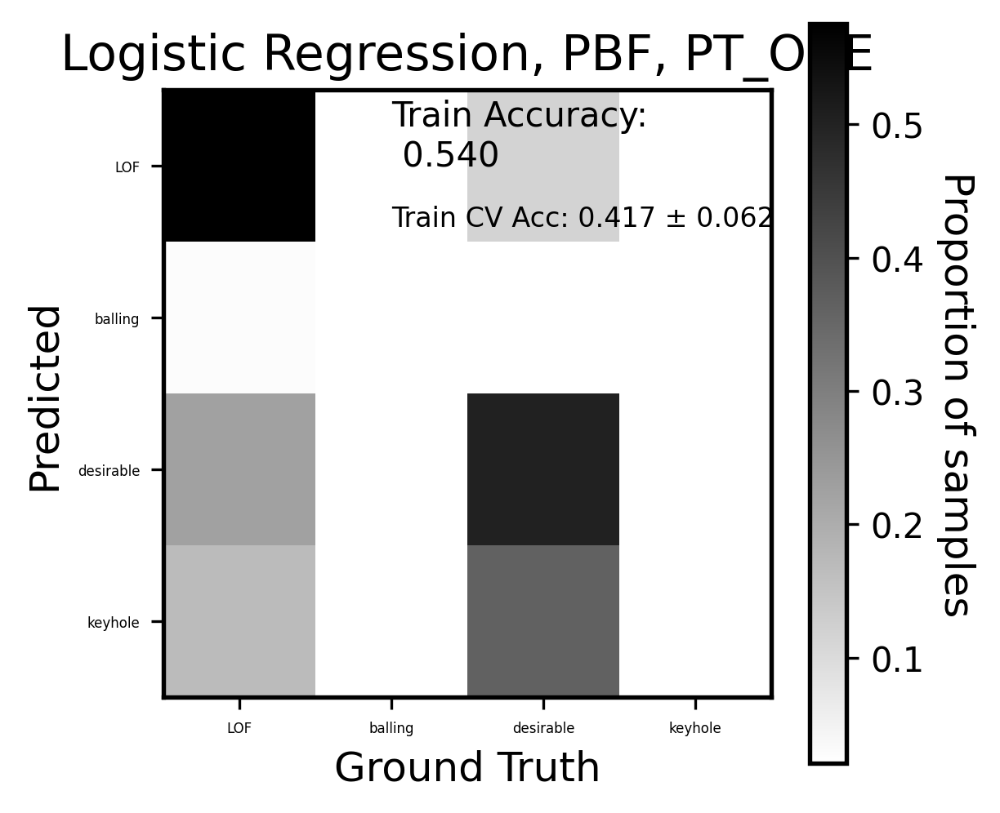

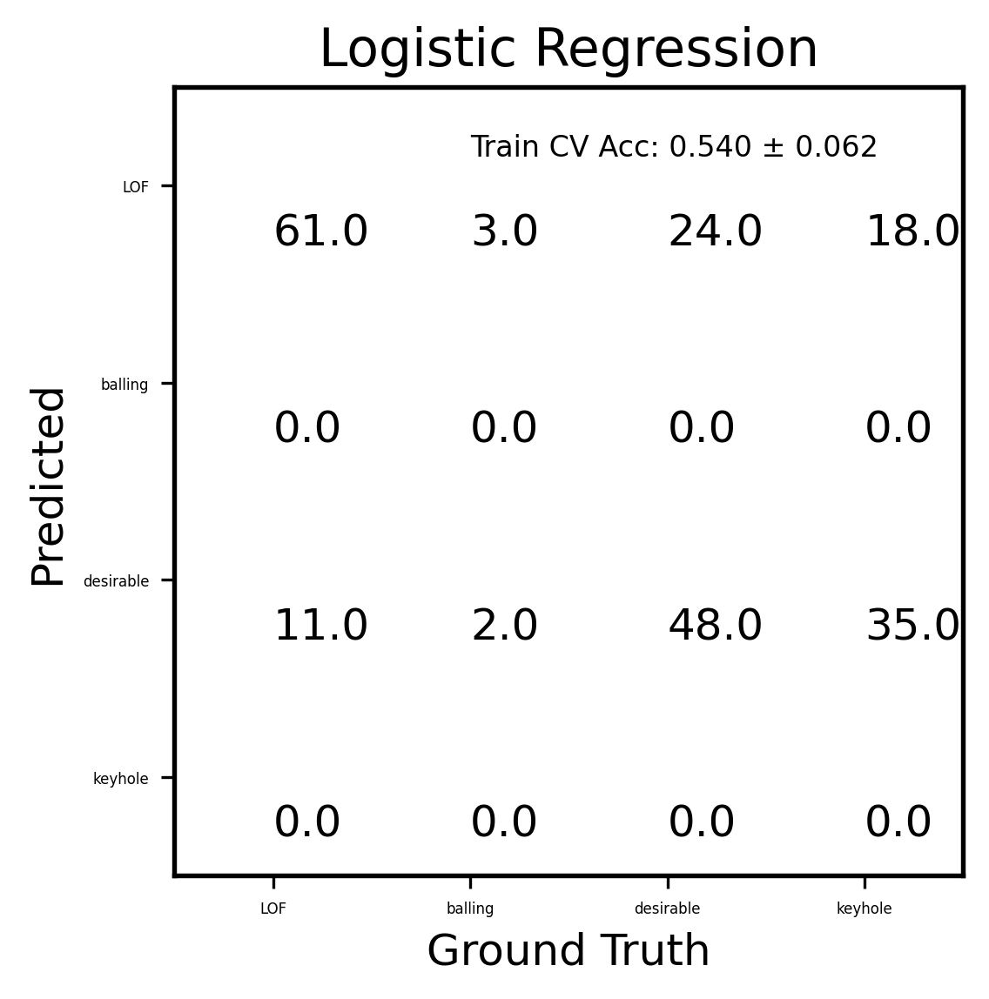

/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:259: RuntimeWarning: invalid value encountered in true_divide


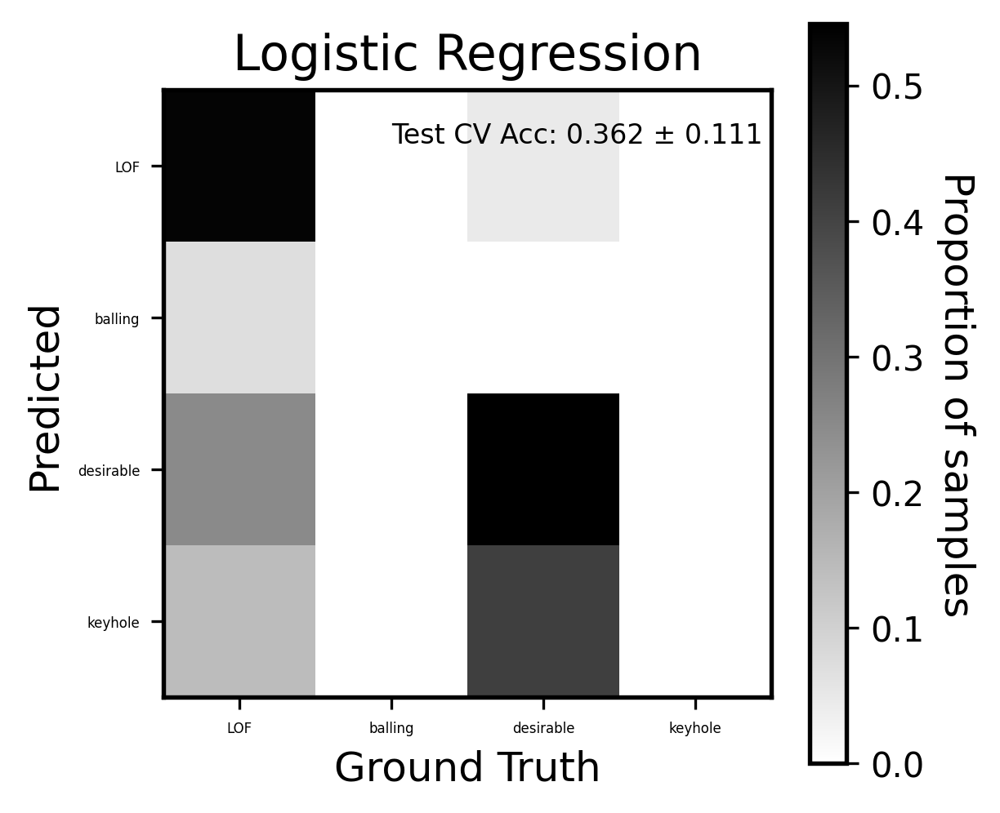

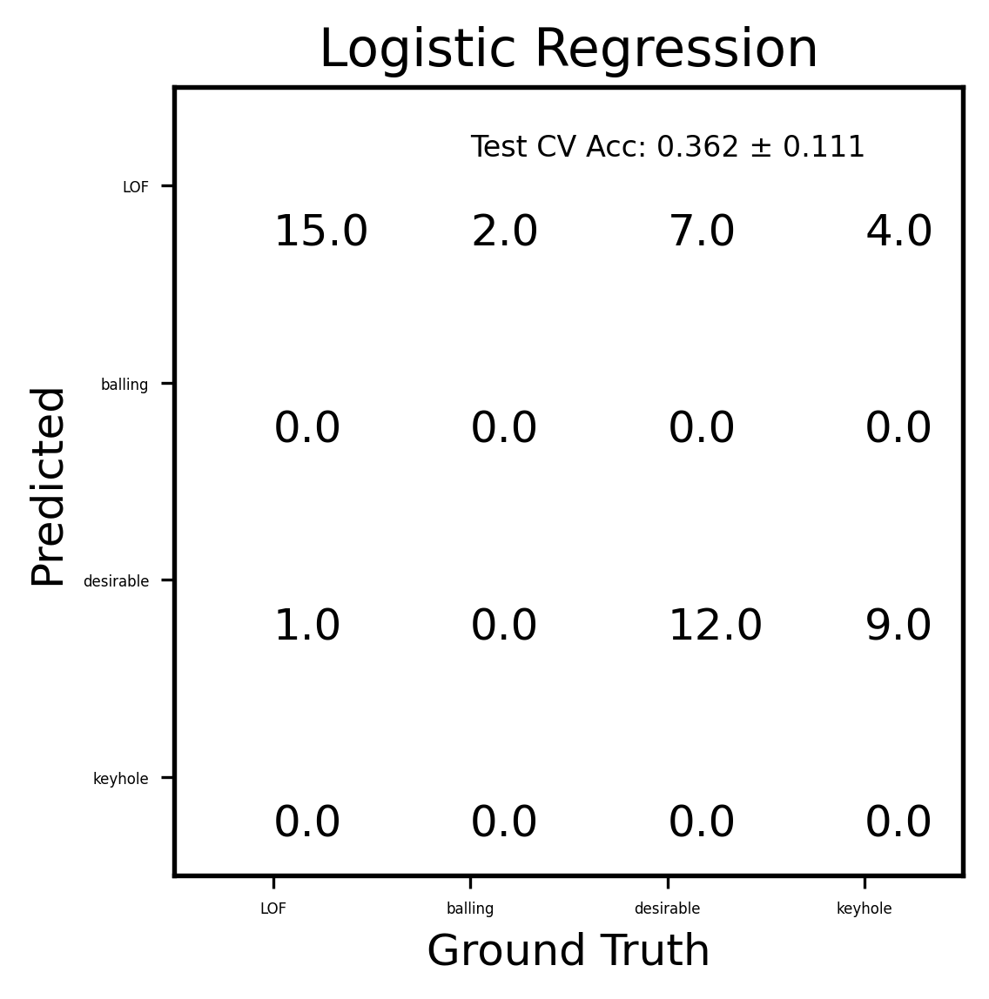

GradientBoostingClassifier()
GradientBoostingClassifier()
GradientBoostingClassifier()
GradientBoostingClassifier()
GradientBoostingClassifier()
GB Train Accuracy: 1.00000 ± 0.00000, Test Accuracy: 0.89663 ± 0.03918


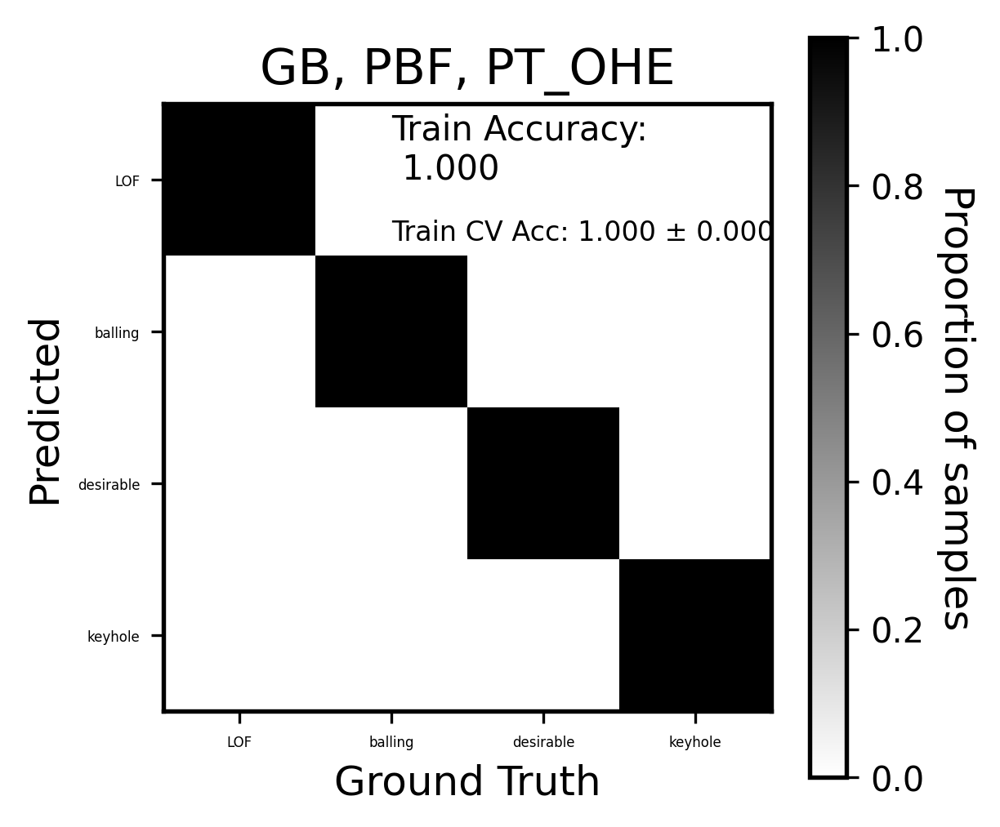

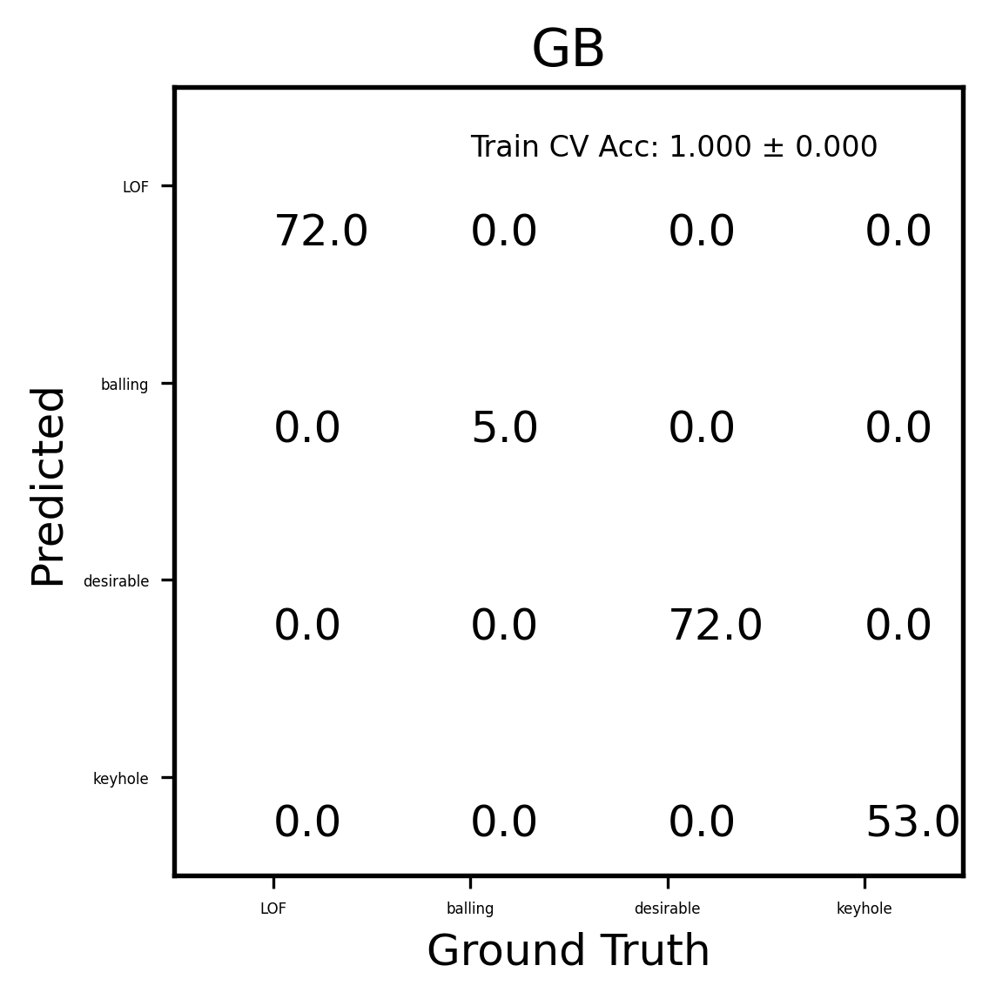

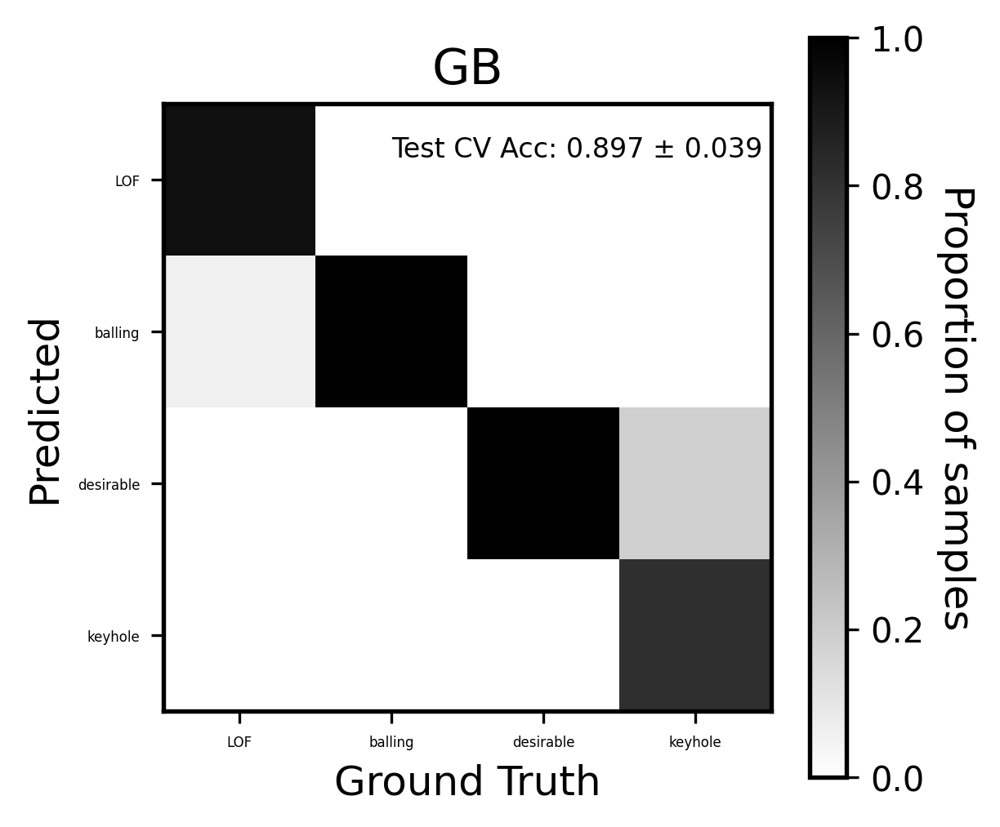

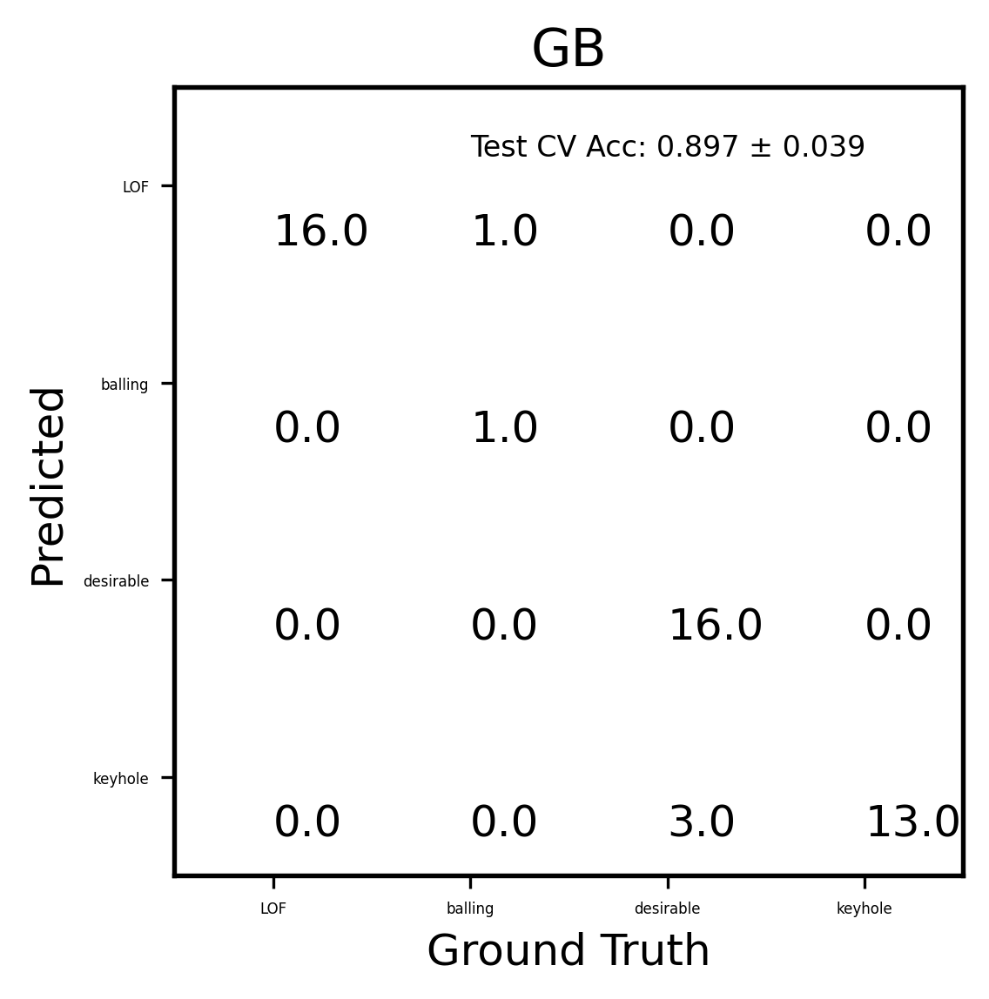

MLPClassifier(hidden_layer_sizes=(32, 64, 64), max_iter=20000)
MLPClassifier(hidden_layer_sizes=(32, 64, 64), max_iter=20000)
MLPClassifier(hidden_layer_sizes=(32, 64, 64), max_iter=20000)
MLPClassifier(hidden_layer_sizes=(32, 64, 64), max_iter=20000)
MLPClassifier(hidden_layer_sizes=(32, 64, 64), max_iter=20000)
NN Train Accuracy: 0.79257 ± 0.05260, Test Accuracy: 0.71459 ± 0.07273


/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:181: RuntimeWarning: invalid value encountered in true_divide


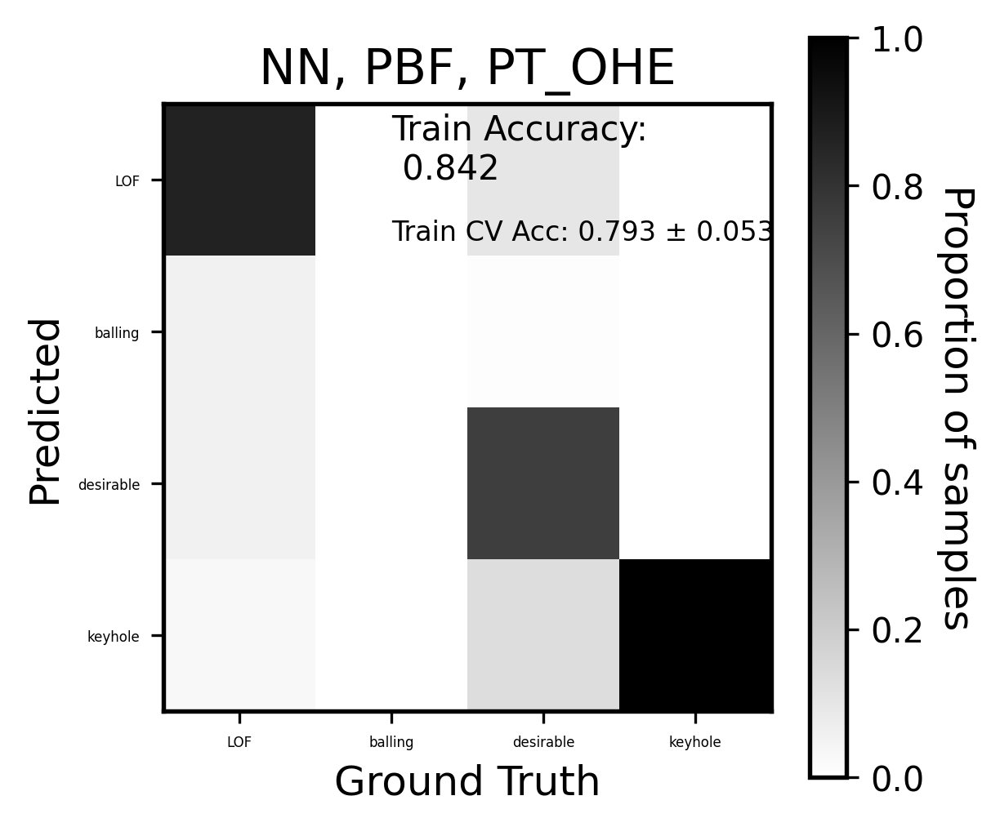

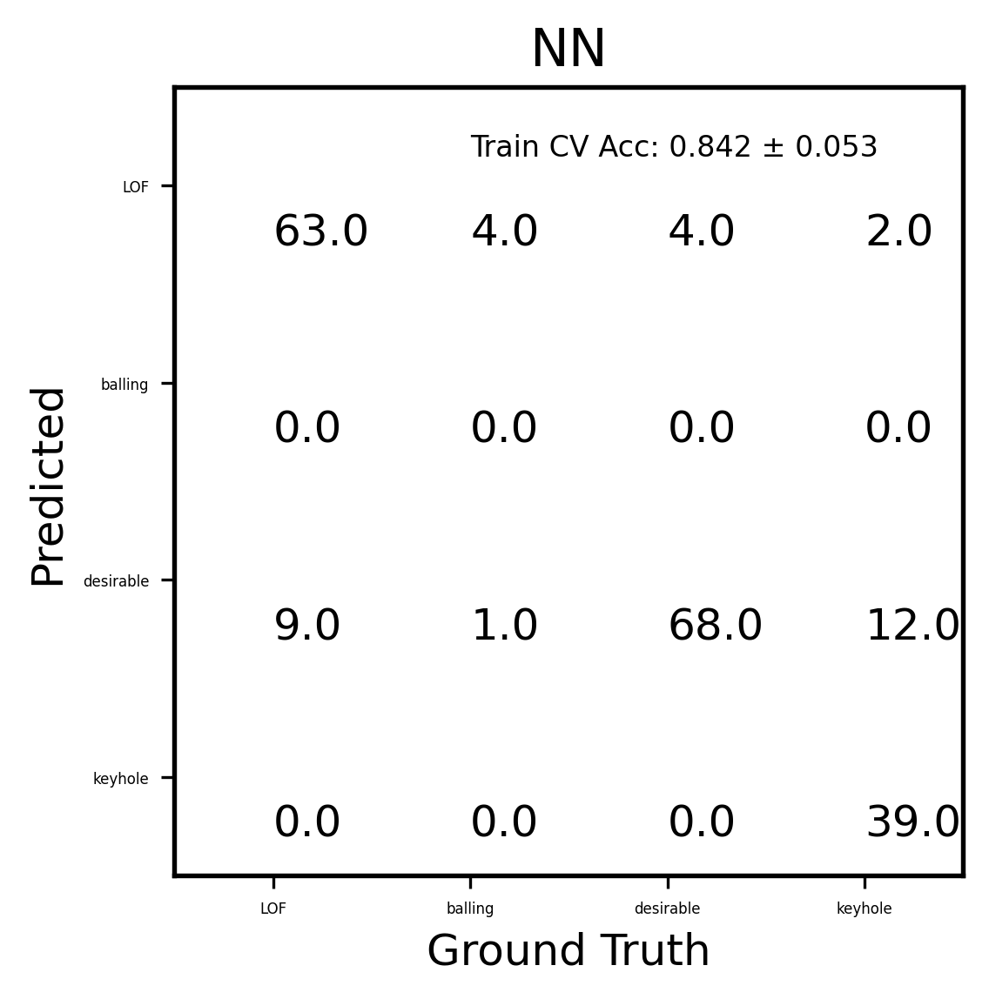

/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:259: RuntimeWarning: invalid value encountered in true_divide


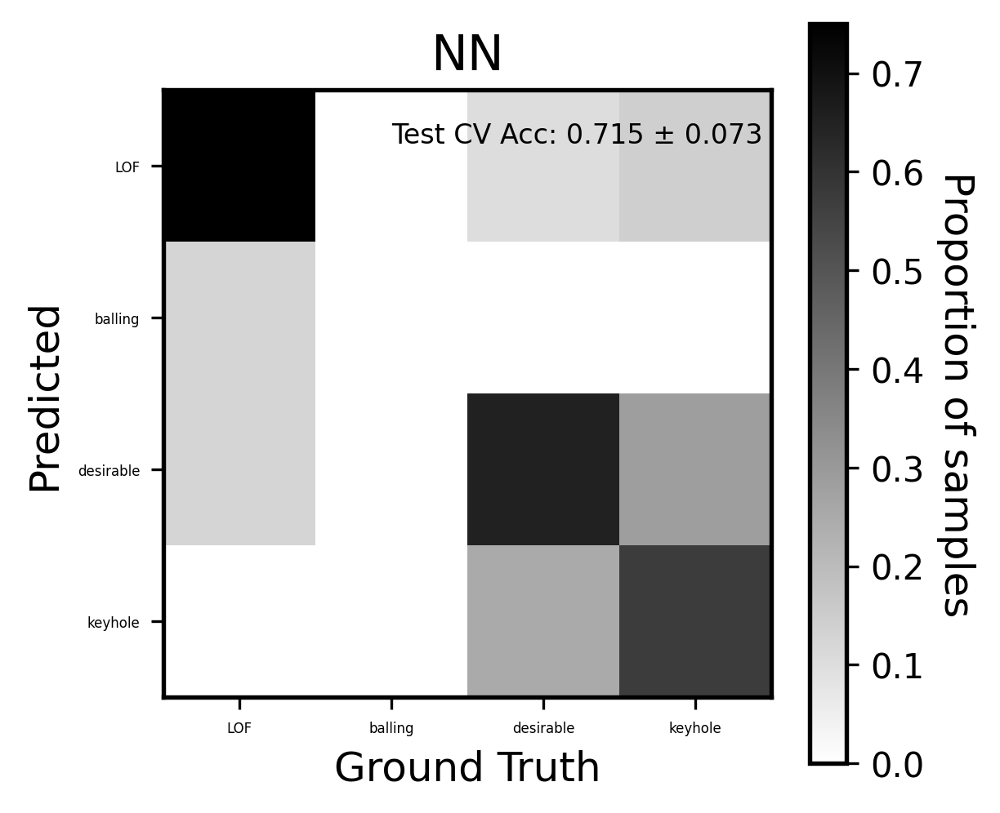

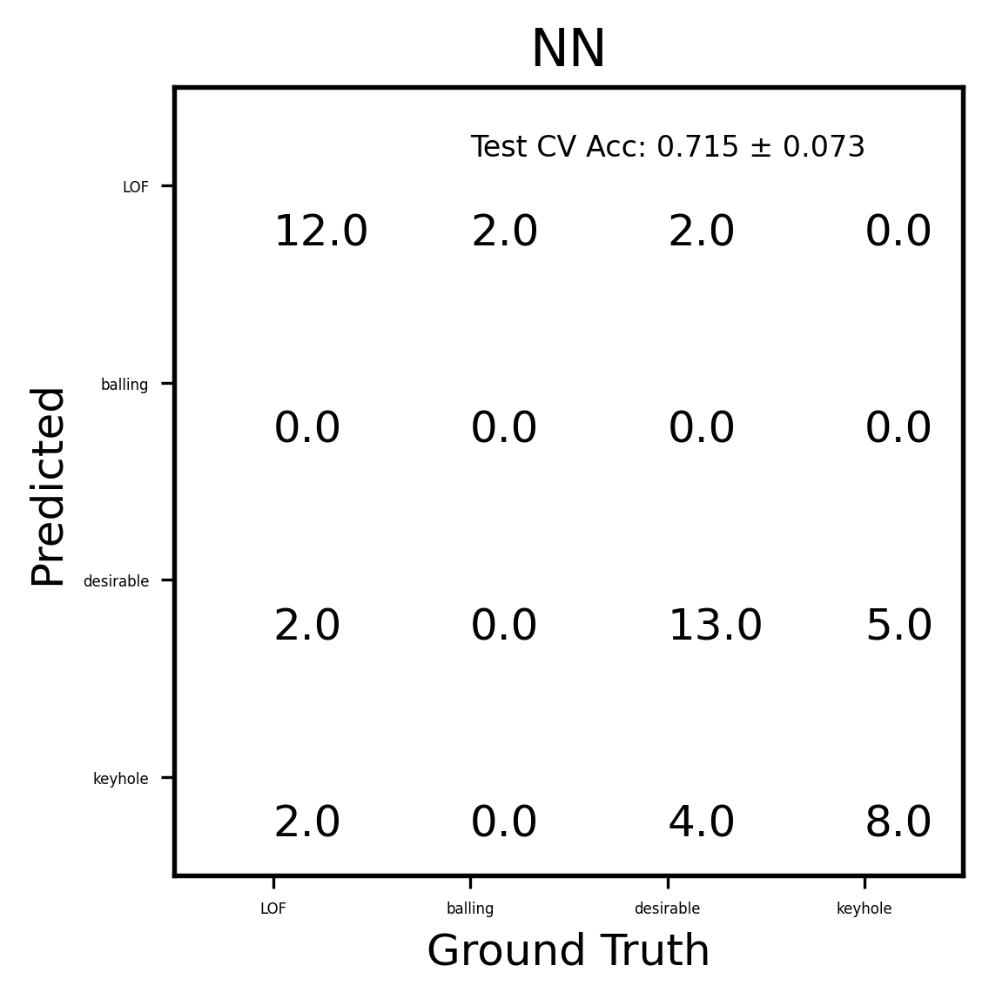

In [45]:
%matplotlib inline
# Define parameters that models will be trained on and value to be predicted
parameter_list = ['Power', 'Velocity', 'density', 'Cp', 'k' , 'beam D', 'melting T', 'layer thickness', 'absorption coefficient', 'absorption coefficient 2']
label_col = 'meltpool shape'


#new_csv = select_subset(new_csv, 'paper ID', 19)
#new_csv = select_material(new_csv, 'Ti6Al4V')

#Form dataset array from dataframe, given parameter_list, label_col
# function select_parameters() does this as well
data_list = []
label_list = []
materials_present = []

new_csv = select_process(class_csv, 'PBF')
#new_csv = select_material(new_csv, 'Ti-6Al-4V')
test = 0
for i in range(len(new_csv)):
    success, features, label = extract_features(new_csv.iloc[i], parameter_list, label_col)
    if success < 0:
      #  print("CONTINUE")
        continue
    else:
        test += 1
        print(test)
        data_list.append(features)
        label_list.append(label)
        materials_present.append(new_csv['Material'].iloc[i])

print('length in PBF data: ', len(new_csv))
print('Used data points: ', test)
X= np.array(np.squeeze(data_list))
labels = np.unique(label_list)

# Define labels from csv file
label_id = np.arange(len(labels))
class_labels = np.zeros(len(label_list))
for idx, sample in enumerate(label_list):
    for l_id, lbl in enumerate(labels):
        if lbl == sample:
            class_labels[idx] = l_id
y = np.array(class_labels)

# Define One Hot Encoding of materials
materials_ohe = [np.zeros(len(materials_present)) for key in materials.keys()]

materials_ohe = np.array(materials_ohe).T

#breakpoint()
#materials.keys()
print(len(materials_ohe))
material_pos = np.arange(len(materials.keys()))
for idx in range(len(materials_present)):
    for j_idx in range(len(material_pos)):
      #  breakpoint()
        if materials_present[idx] == materials.keys()[j_idx]:
            
            materials_ohe[idx,j_idx] = 1 
            #pass
# for i,j in zip(y_pos, materials.keys()):
    
#     print(i, j)
#breakpoint()
 
class_labels = np.array(class_labels,dtype = 'int')


fit_models_ohe, train_accuracy_ohe, train_accuracy_std_ohe, test_accuracy_ohe, test_accuracy_std_ohe = classify_learn(X.reshape(-1, len(X[0])), y, labels, parameters = parameter_list, title = 'PBF, PT_OHE', plot = True, prefix = 'classification', materials_ohe = materials_ohe)


## Classification Decision Boundaries based on Power and Velocity

(191, 2)
(191, 2) (191,)
RandomForestClassifier()
RandomForestClassifier()
RandomForestClassifier()
RandomForestClassifier()
RandomForestClassifier()
RF Train Accuracy: 0.98822 ± 0.00641, Test Accuracy: 0.75371 ± 0.04966
GaussianProcessClassifier()
GaussianProcessClassifier()
GaussianProcessClassifier()
GaussianProcessClassifier()
GaussianProcessClassifier()
GPC Train Accuracy: 0.78141 ± 0.01417, Test Accuracy: 0.73779 ± 0.07169
SVC()
SVC()
SVC()
SVC()
SVC()
SVC Train Accuracy: 0.75917 ± 0.01765, Test Accuracy: 0.72200 ± 0.07112
LogisticRegression(C=0.00045)
LogisticRegression(C=0.00045)
LogisticRegression(C=0.00045)
LogisticRegression(C=0.00045)
LogisticRegression(C=0.00045)
Logistic Regression Train Accuracy: 0.67012 ± 0.01750, Test Accuracy: 0.66964 ± 0.06953
GradientBoostingClassifier()
GradientBoostingClassifier()
GradientBoostingClassifier()
GradientBoostingClassifier()
GradientBoostingClassifier()
GB Train Accuracy: 0.98429 ± 0.00668, Test Accuracy: 0.82672 ± 0.07038
MLPClassifi

/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:74: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.


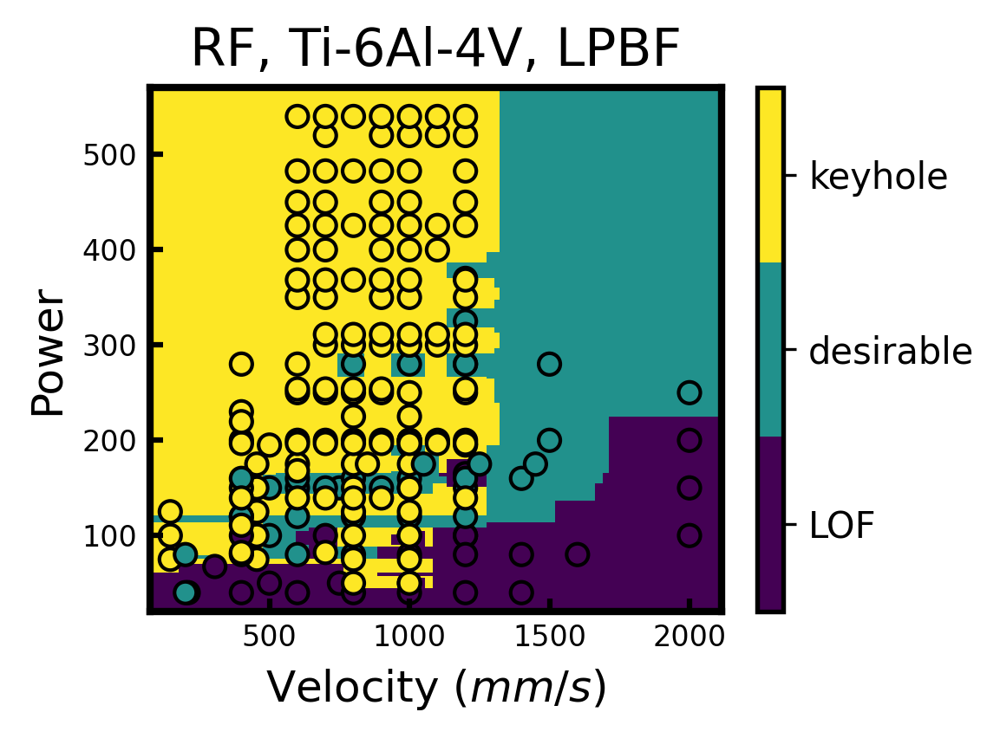

[2 2 2 ... 1 1 1] PREDICTED
UNIQUE [0 1 2]
class_labels
[[2 2 2 ... 0 0 0]
 [2 2 2 ... 0 0 0]
 [2 2 2 ... 0 0 0]
 ...
 [2 2 2 ... 1 1 1]
 [2 2 2 ... 1 1 1]
 [2 2 2 ... 1 1 1]]


/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:74: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.


<Figure size 432x288 with 0 Axes>

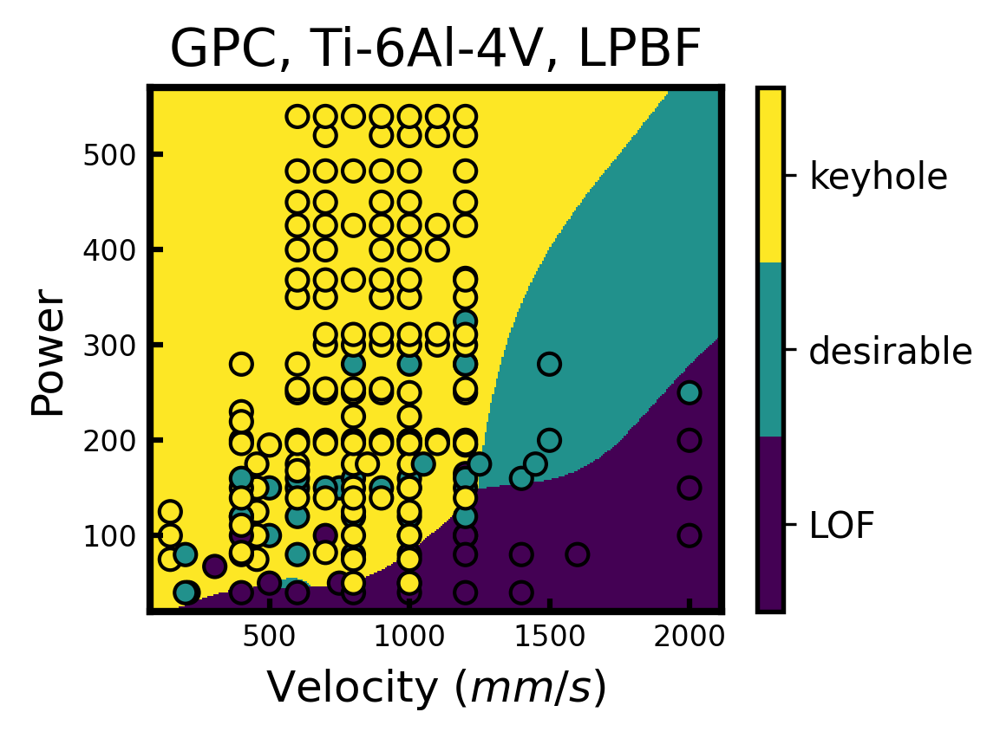

[2 2 2 ... 2 2 2] PREDICTED
UNIQUE [0 1 2]
class_labels
[[2 2 2 ... 0 0 0]
 [2 2 2 ... 0 0 0]
 [2 2 2 ... 0 0 0]
 ...
 [2 2 2 ... 2 2 2]
 [2 2 2 ... 2 2 2]
 [2 2 2 ... 2 2 2]]


/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:74: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.


<Figure size 432x288 with 0 Axes>

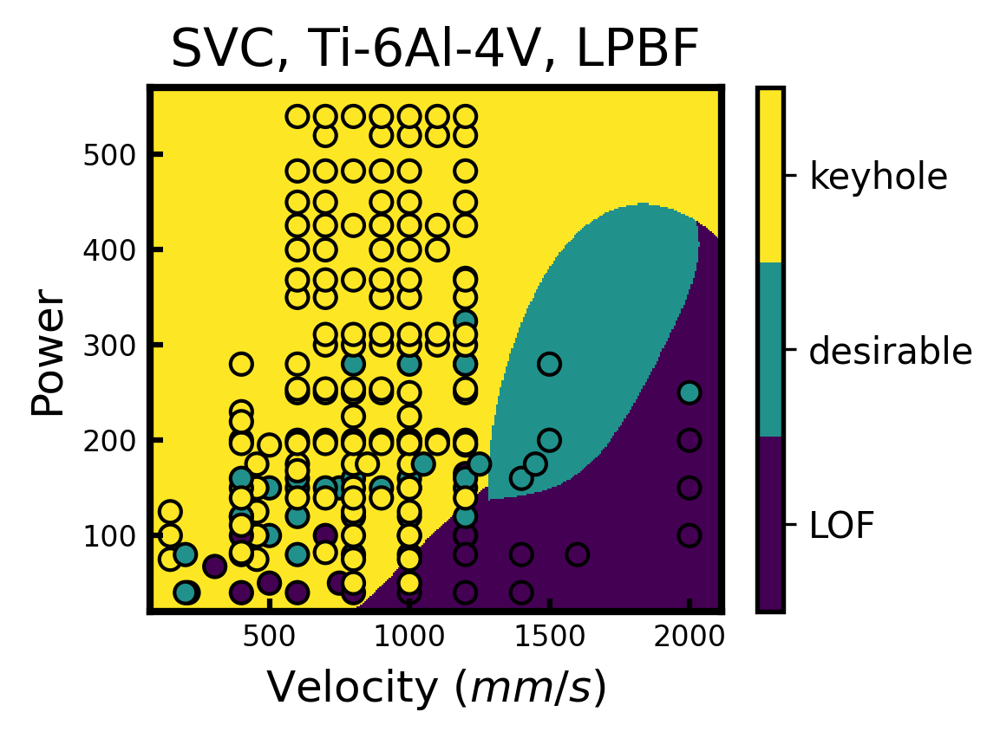

[2 2 2 ... 2 2 2] PREDICTED
UNIQUE [0 1 2]
class_labels
[[2 2 2 ... 2 2 2]
 [2 2 2 ... 2 2 2]
 [2 2 2 ... 2 2 2]
 ...
 [2 2 2 ... 2 2 2]
 [2 2 2 ... 2 2 2]
 [2 2 2 ... 2 2 2]]


/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:74: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.


<Figure size 432x288 with 0 Axes>

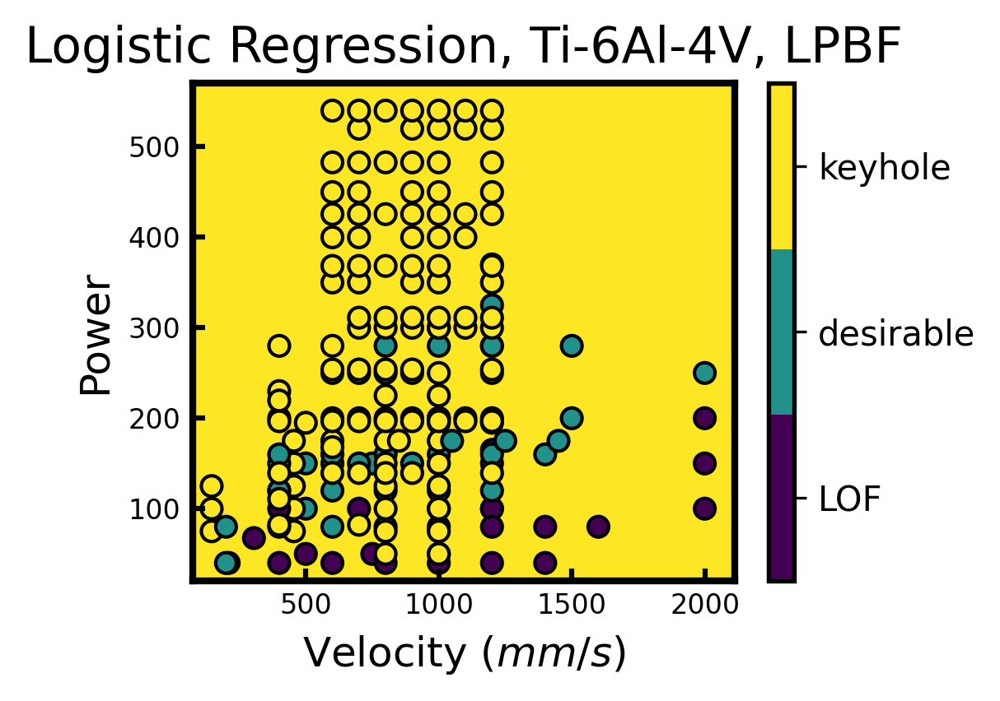

[0 0 0 ... 1 1 1] PREDICTED
UNIQUE [0 1 2]
class_labels
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [2 2 2 ... 1 1 1]
 [2 2 2 ... 1 1 1]
 [2 2 2 ... 1 1 1]]


/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:74: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.


<Figure size 432x288 with 0 Axes>

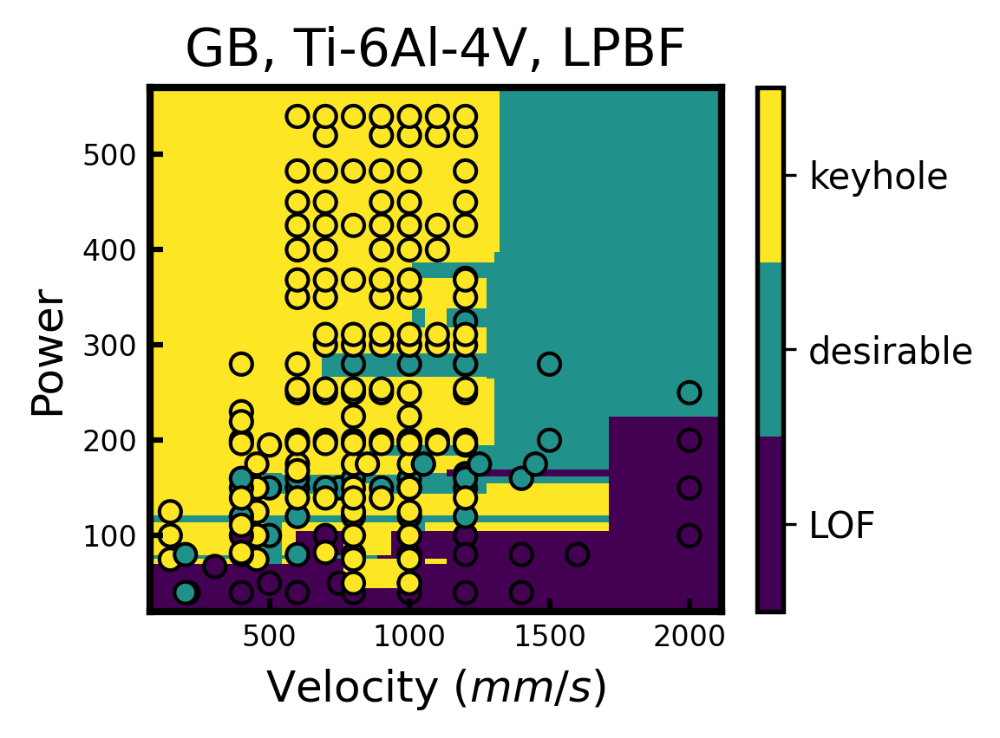

[0 0 0 ... 1 1 1] PREDICTED
UNIQUE [0 1 2]
class_labels
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [2 2 2 ... 1 1 1]
 [2 2 2 ... 1 1 1]
 [2 2 2 ... 1 1 1]]


/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:74: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.


<Figure size 432x288 with 0 Axes>

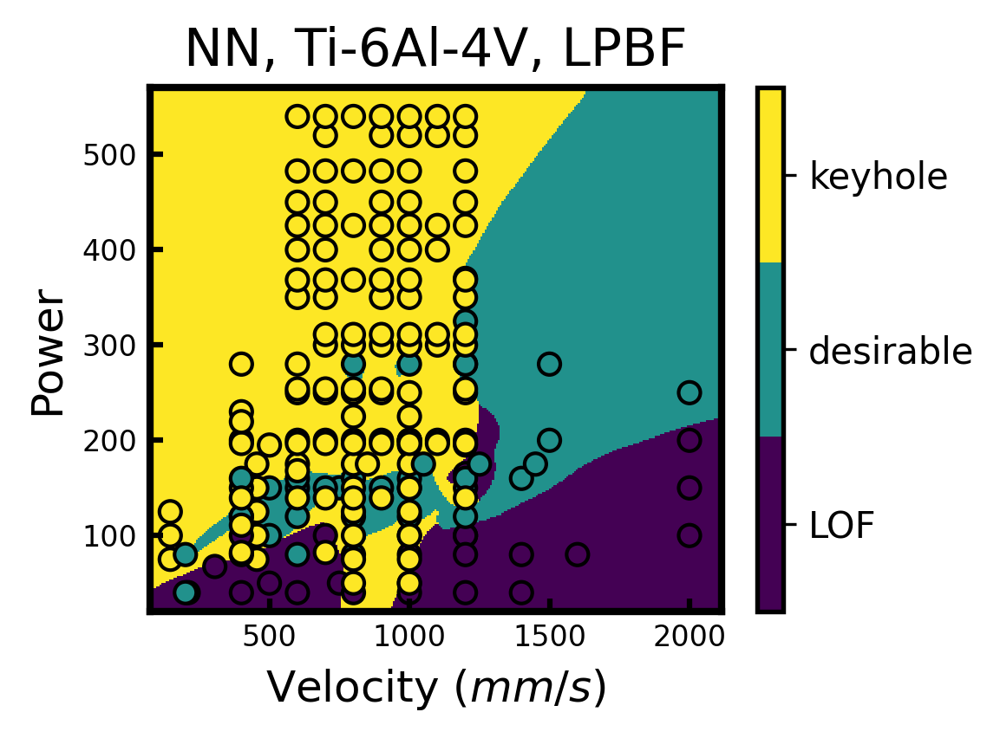

<Figure size 432x288 with 0 Axes>

In [47]:

%matplotlib inline
# Define parameters that models will be trained on and value to be predicted
parameter_list = ['Velocity', 'Power']#['Power', 'Velocity', 'Hatch spacing', 'width of melt pool']
label_col = 'meltpool shape'


#new_csv = select_subset(new_csv, 'paper ID', 19)
#new_csv = select_material(new_csv, 'Ti6Al4V')

#Form dataset array from dataframe, given parameter_list, label_col
# function select_parameters() does this as well
data_list = []
label_list = []
new_csv = select_subset(class_csv, 'Sub-process', 'SLM')
new_csv = select_material(new_csv, 'Ti-6Al-4V')
for i in range(len(new_csv)):
    success, features, label = extract_features(new_csv.iloc[i], parameter_list, label_col)
    if success < 0 or not label in ['keyhole', 'LOF', 'desirable'] :
        continue
    else:
        data_list.append(features)
        label_list.append(label)
    
print(X.shape)
X= np.array(np.squeeze(data_list))
labels = np.unique(y)
label_id = np.arange(len(labels))
y = np.array(label_list)

class_labels = np.zeros(len(y))
for idx, sample in enumerate(y):
    for l_id, lbl in enumerate(labels):
        if lbl == sample:
            class_labels[idx] = l_id
print(X.shape, y.shape)
# breakpoint()
 
class_labels = np.array(class_labels,dtype = 'int')

fit_models, train_accuracy, train_accuracy_std, test_accuracy, test_accuracy_std = classify_learn(X.reshape(-1, len(X[0])), class_labels,label_names = label_id, prefix= 'decbound', parameters = parameter_list, title = 'SLM', plot = False)

scaler = StandardScaler()
scaler.fit(X)
X_rescale = scaler.transform(X)

nx = 300
ny = 300

xs = np.linspace(1.1*np.min(X_rescale[:,0]), 1.1*np.max(X_rescale[:,0]), nx)

ys = np.linspace(1.1*np.min(X_rescale[:,1]), 1.1*np.max(X_rescale[:,1]), ny)

xx, yy = np.meshgrid(xs, ys)



for idx,model in enumerate(fit_models):
    fig = plt.figure(figsize = [4,3], dpi = dpi)

    xx, yy = np.meshgrid(xs, ys)
    W = model.predict(np.c_[xx.ravel(), yy.ravel()])
    
    xx_unscaled = scaler.inverse_transform(np.c_[xx.ravel(), yy.ravel()])
    xx = xx_unscaled[:,0].reshape(xx.shape)
    yy = xx_unscaled[:, 1].reshape(yy.shape)
    
    #Z = np.argmax(W, axis = 1)
    Z = W
    print(W, "PREDICTED")
    Z = Z.reshape(xx.shape)
    ax = plt.subplot(111)
    cmap = plt.get_cmap('viridis', len(np.unique(class_labels)))

    plt.pcolormesh(xx, yy, (Z), cmap = cmap)

    
    cbar = plt.colorbar()
    plt.clim(np.min(np.unique(class_labels)) - 0.5, np.max(np.unique(class_labels)) +0.5)
    #cbar.ax.set_ylabel('Type', rotation = 270, labelpad = 10)
    
    
    strings= labels
    #plt.clim(0,3)
    print("UNIQUE", np.unique(class_labels))
    cbar.set_ticks(np.arange(len(np.unique(class_labels))))
    #print(strings[0:20])
    cbar.set_ticklabels(strings)
    
    print('class_labels')
    ax.set_xlim(xx.min(), xx.max())
    ax.set_ylim(yy.min(), yy.max())
    plt.title(['RF', 'GPC', 'SVC', 'Logistic Regression', 'GB', 'NN'][idx] + ', Ti-6Al-4V' + ', LPBF')
    str_model = ['RF', 'GPC', 'SVC', 'Logistic Regression', 'GB', 'NN'][idx]
    
    
    print(Z)
    title = 'all_lpbf' + '_decbound'
    plt.xticks(fontsize = 8)
    plt.yticks(fontsize = 8)
    frame_tick()
    plt.xlabel(r'Velocity ($mm/s$)')
    plt.ylabel(r'Power')
    plt.tight_layout()
   # savefig(title+str_model + "classnopoints"+".png")
    plt.scatter(X[:,0], X[:, 1], c = class_labels, edgecolor = 'k', cmap= cmap)
    plt.tight_layout()
   # savefig(title+str_model + "classdatapoints"+".png")
    plt.show()
    plt.clf()

## Classification with PT, wt% and OHE

length in PBF data:  2178
Used data points:  358
358
RandomForestClassifier()
RandomForestClassifier()
RandomForestClassifier()
RandomForestClassifier()
RandomForestClassifier()
RF Train Accuracy: 1.00000 ± 0.00000, Test Accuracy: 0.86017 ± 0.03592


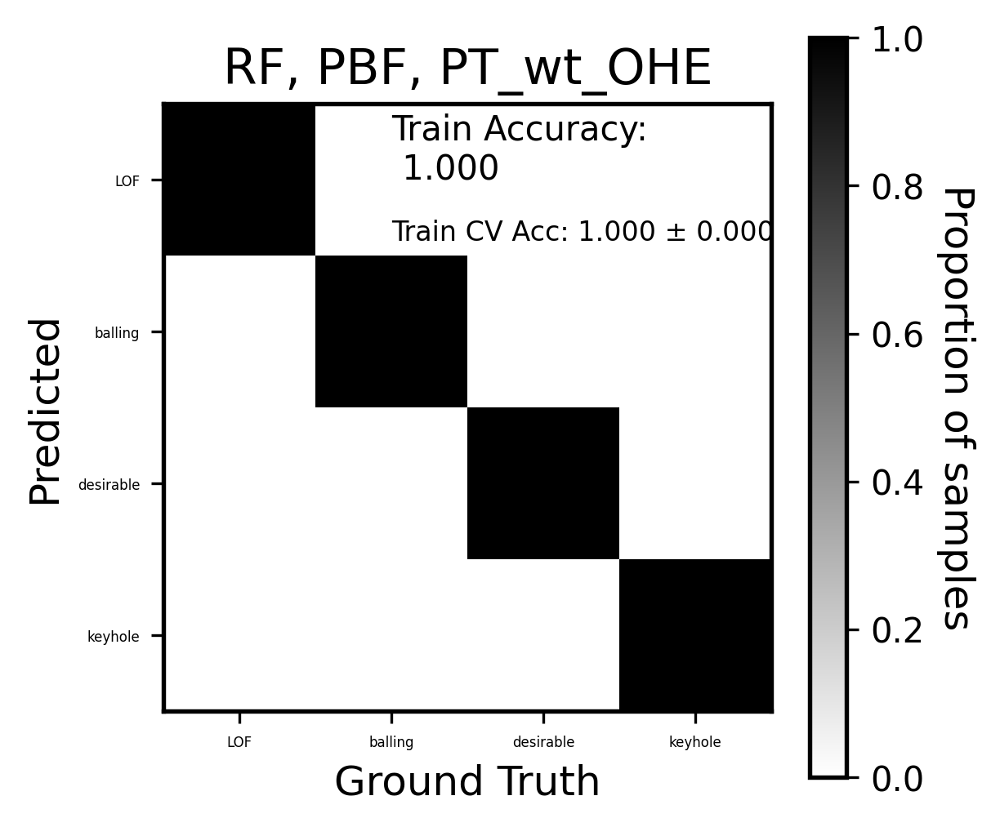

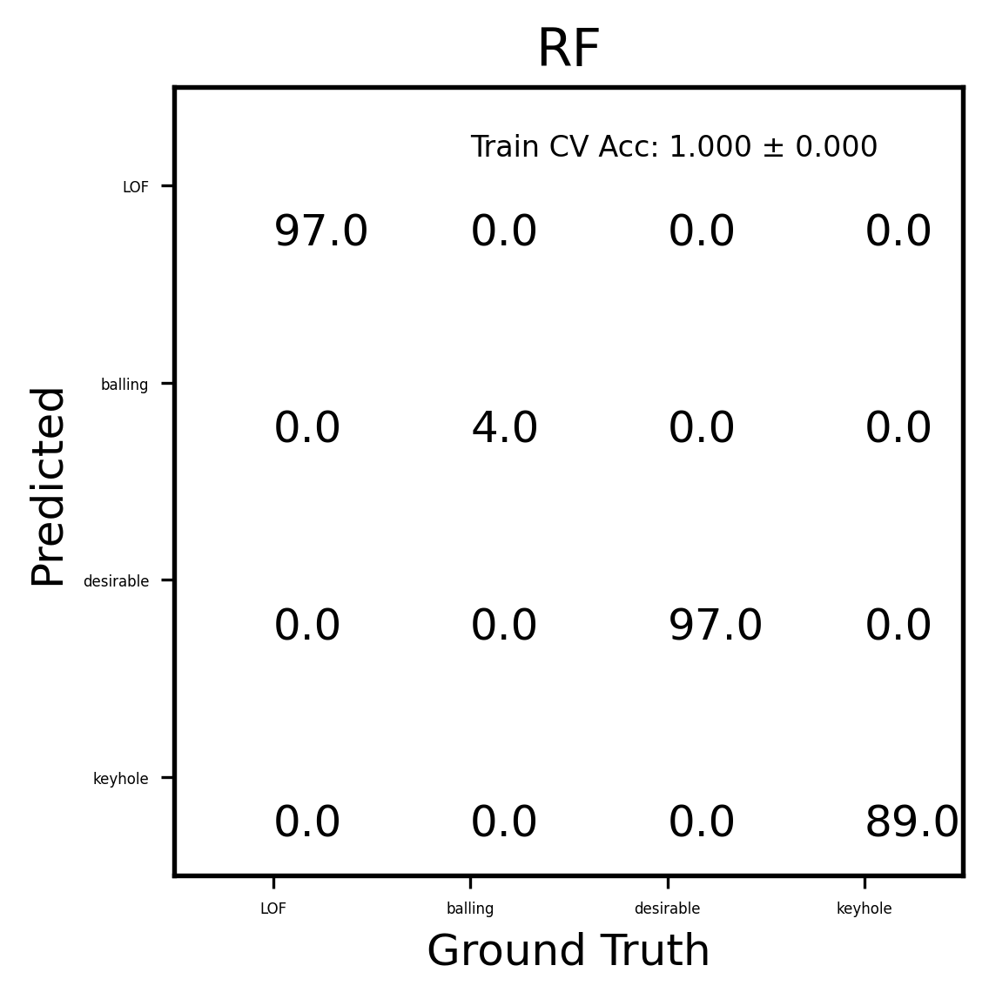

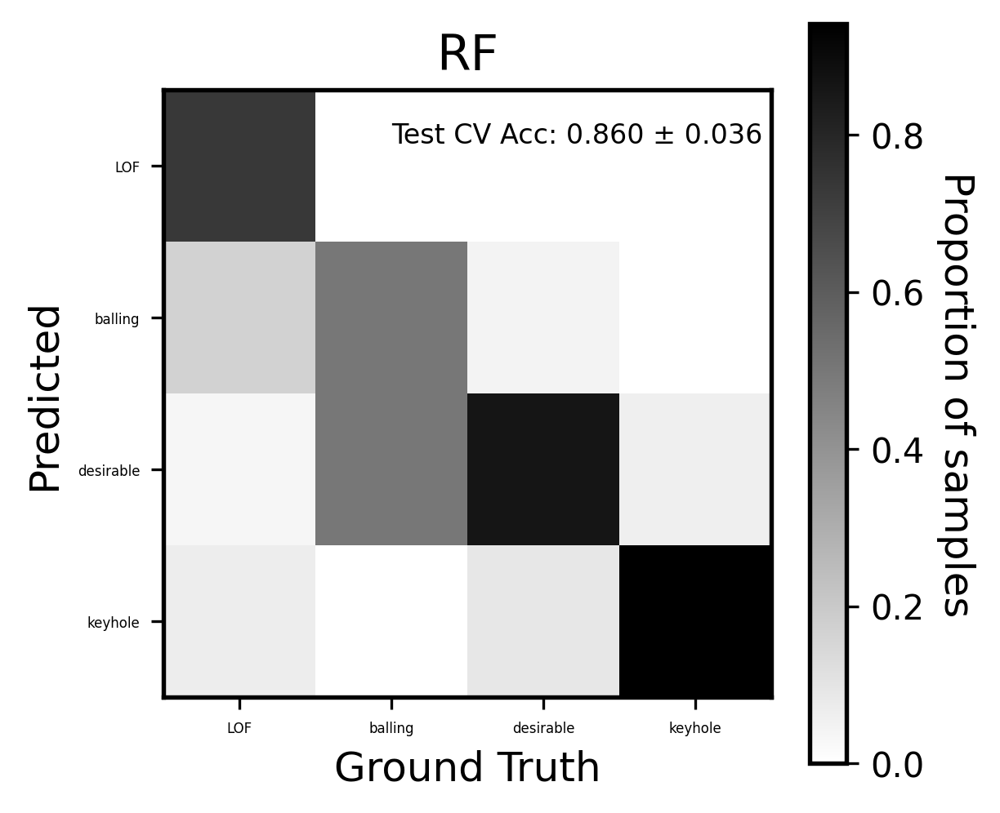

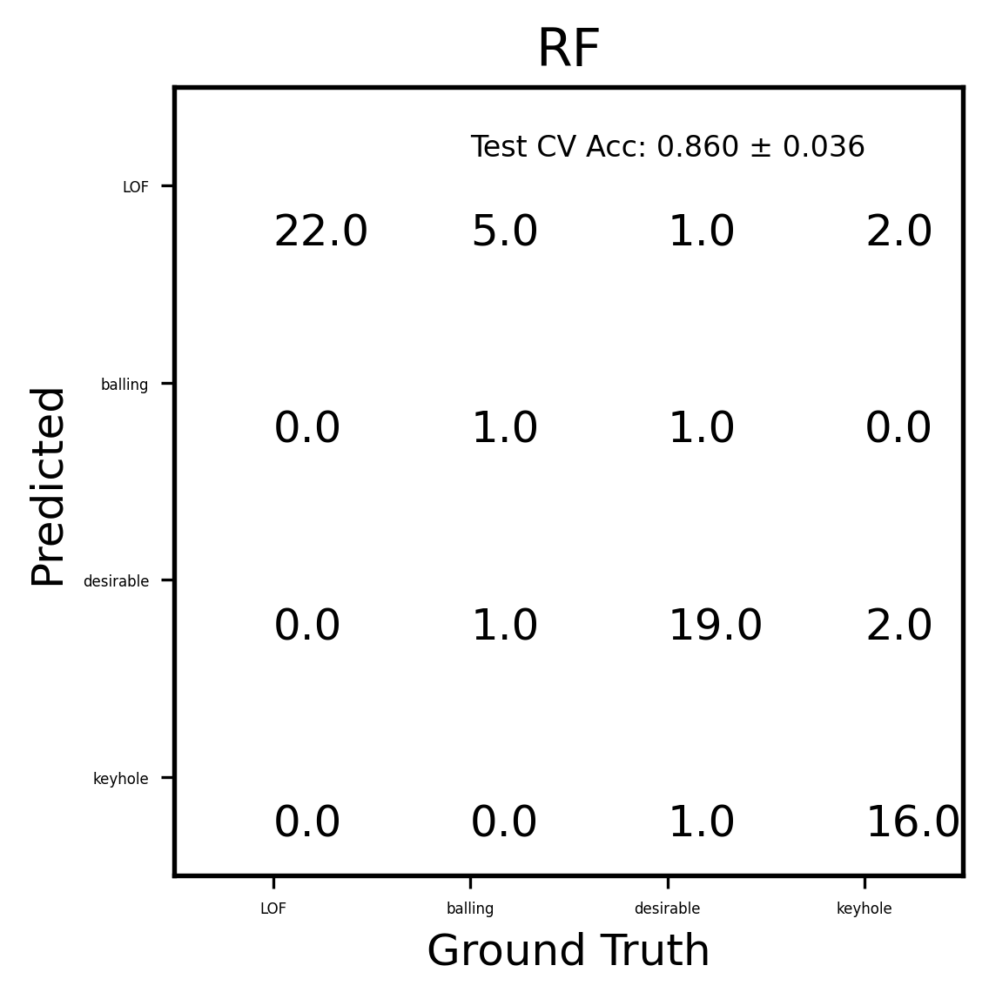

GaussianProcessClassifier()
GaussianProcessClassifier()
GaussianProcessClassifier()
GaussianProcessClassifier()
GaussianProcessClassifier()
GPC Train Accuracy: 0.80167 ± 0.00762, Test Accuracy: 0.68998 ± 0.03850


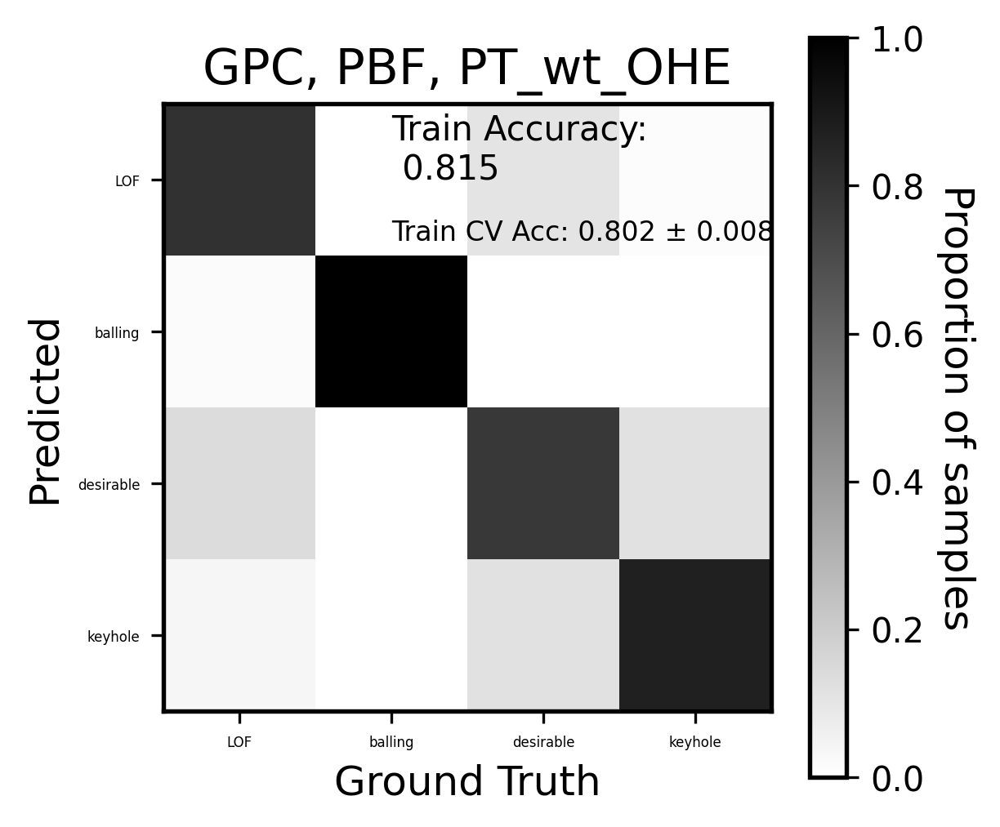

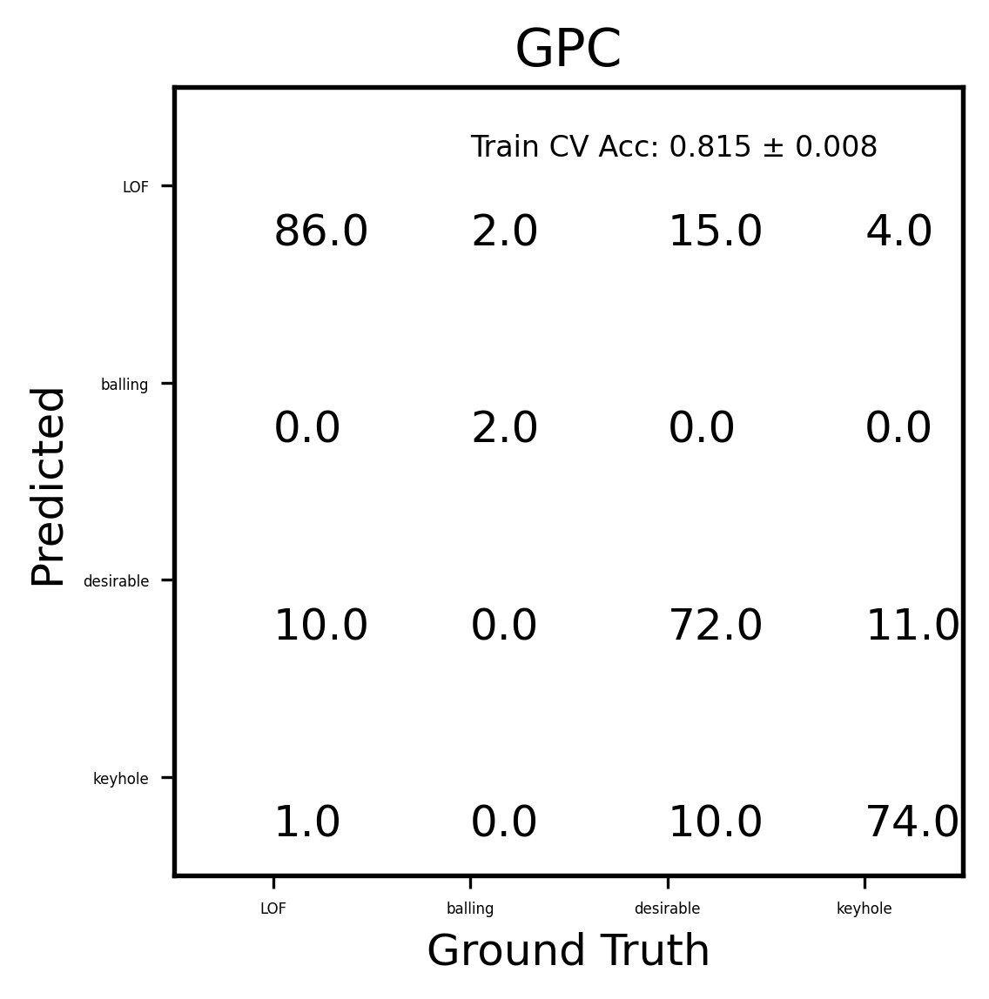

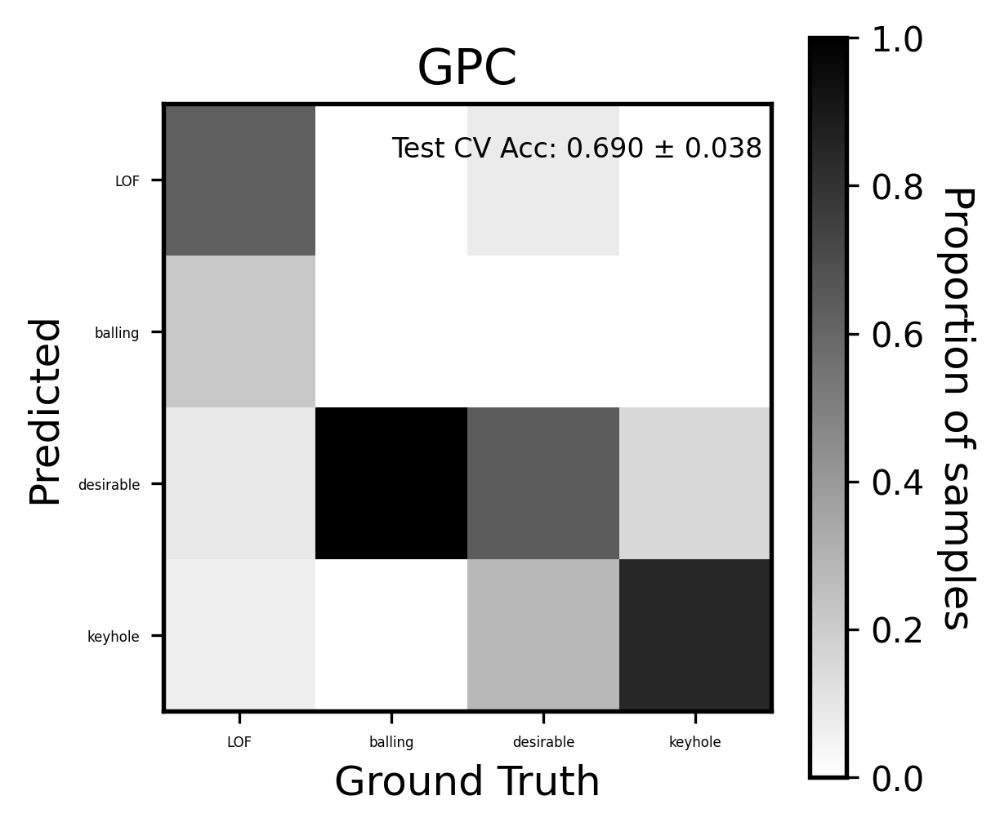

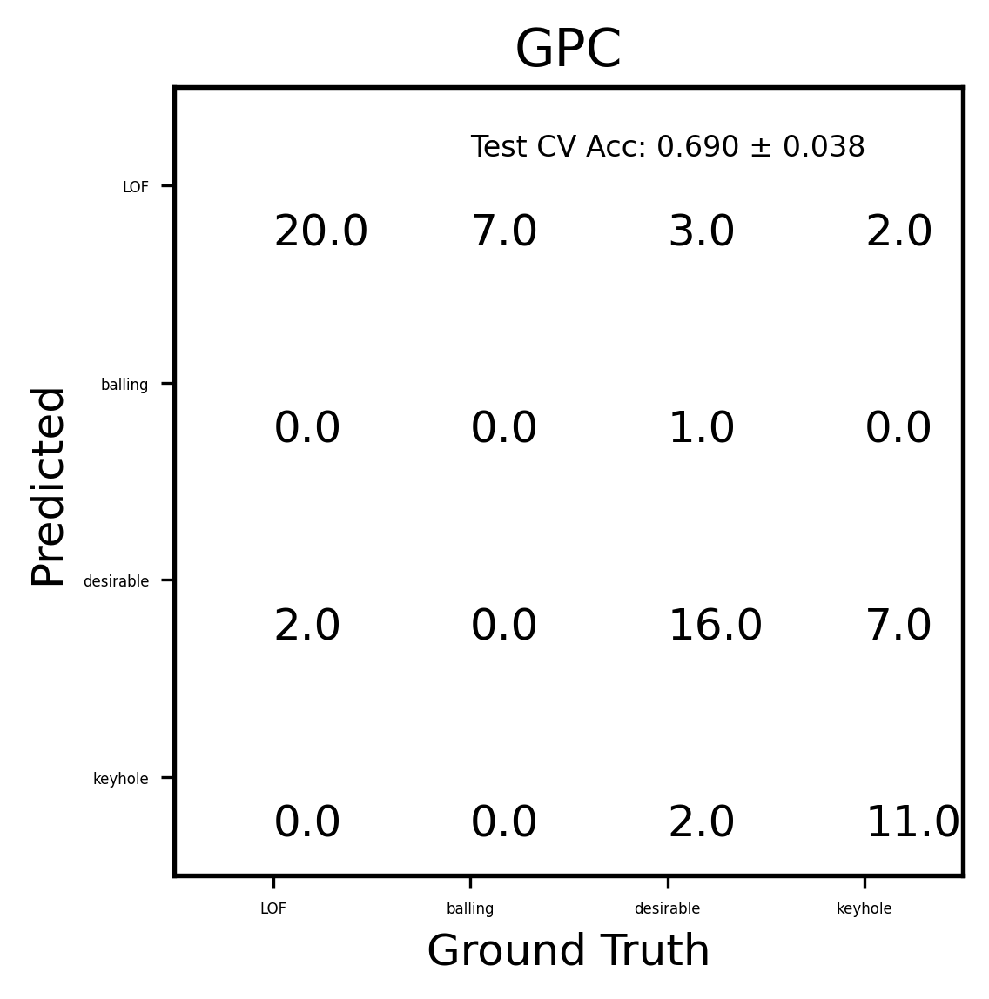

SVC()
SVC()
SVC()
SVC()
SVC()
SVC Train Accuracy: 0.63825 ± 0.02179, Test Accuracy: 0.59785 ± 0.04689


/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:181: RuntimeWarning: invalid value encountered in true_divide


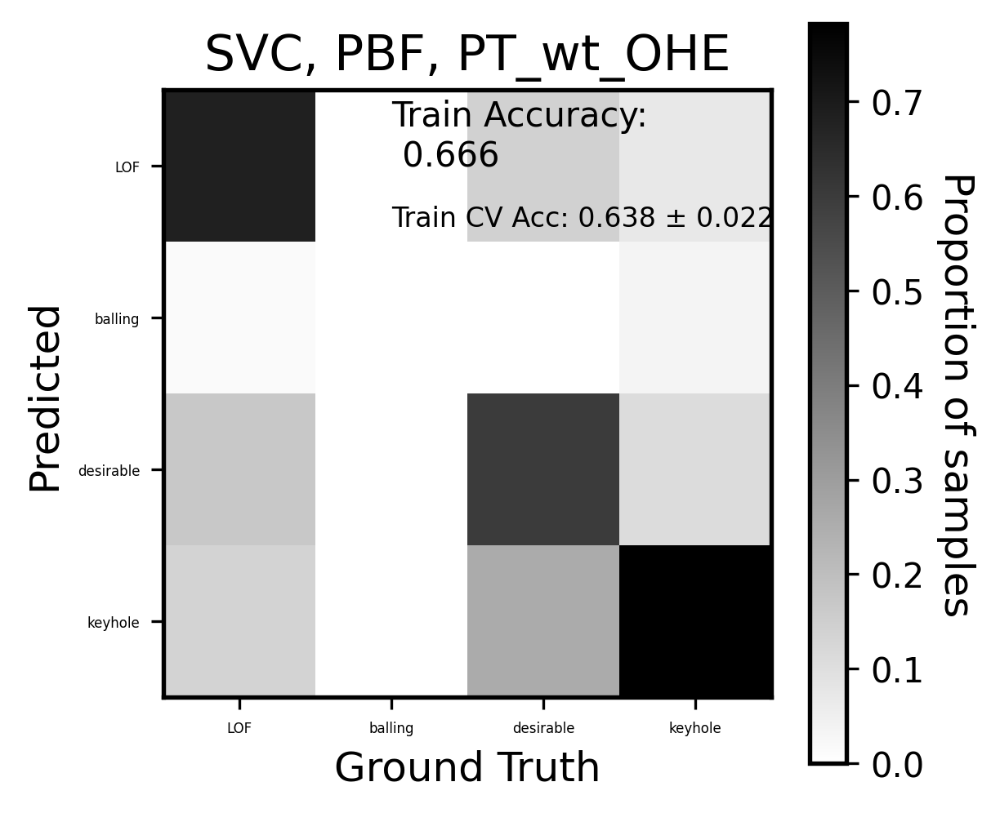

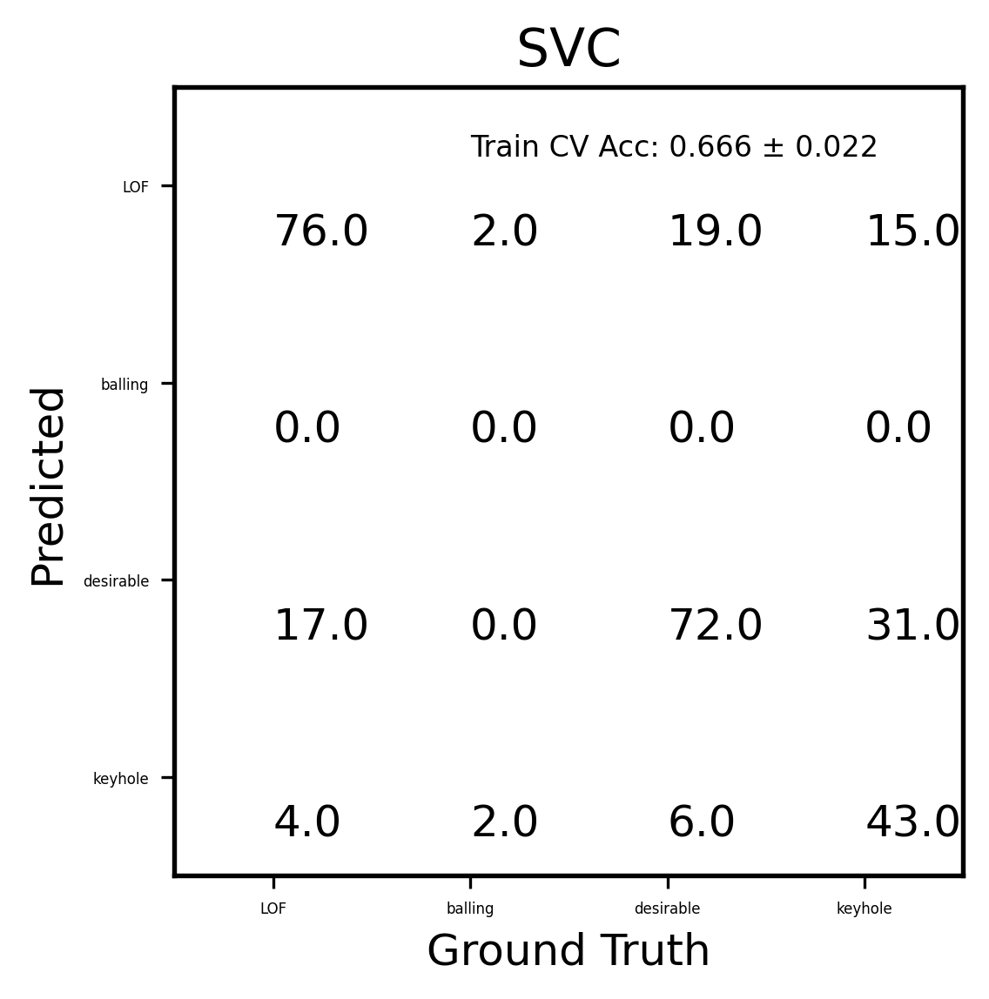

/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:259: RuntimeWarning: invalid value encountered in true_divide


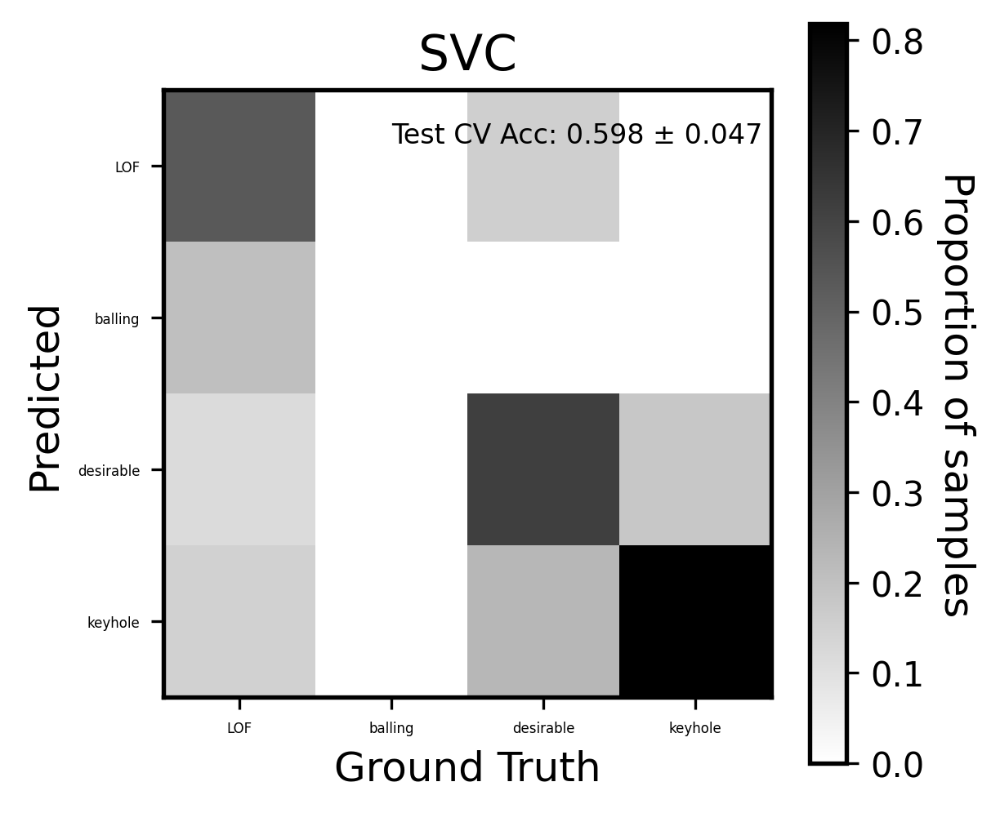

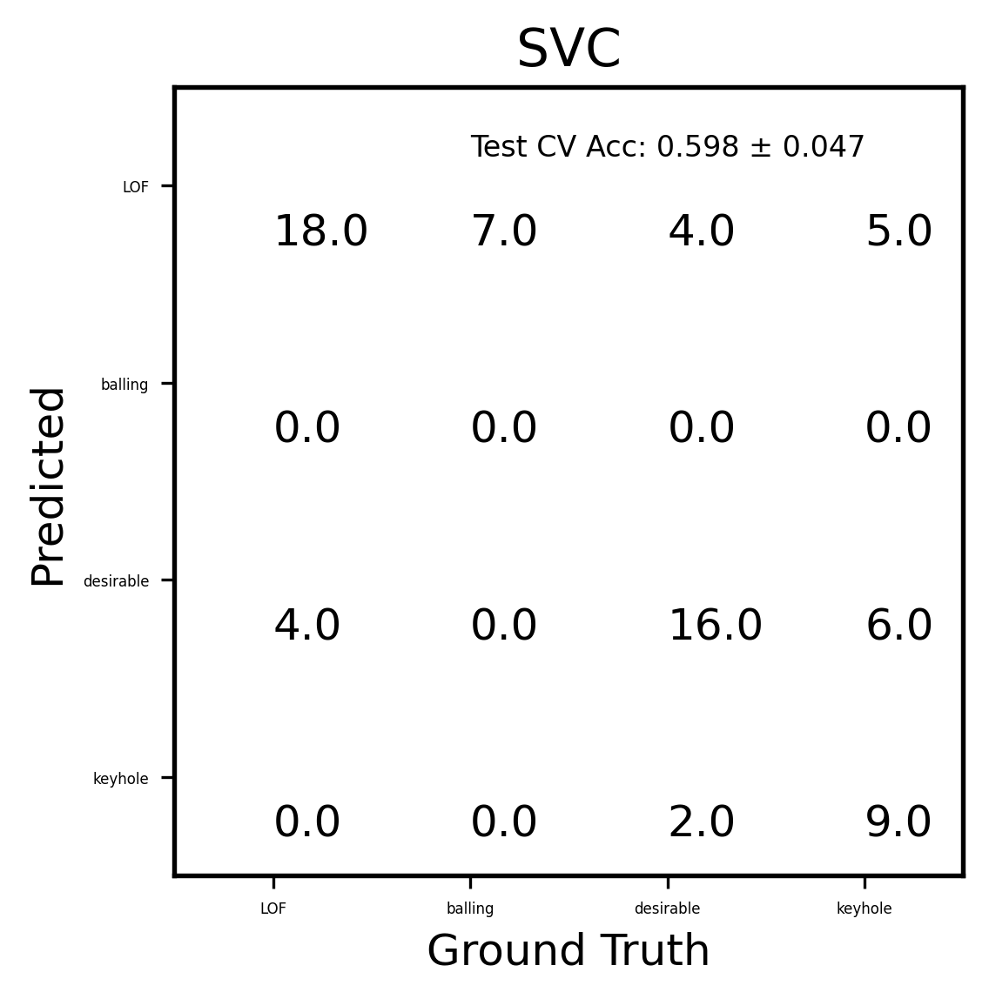

LogisticRegression(C=0.00045)
LogisticRegression(C=0.00045)
LogisticRegression(C=0.00045)
LogisticRegression(C=0.00045)
LogisticRegression(C=0.00045)
Logistic Regression Train Accuracy: 0.40293 ± 0.02075, Test Accuracy: 0.31585 ± 0.03215


/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:181: RuntimeWarning: invalid value encountered in true_divide


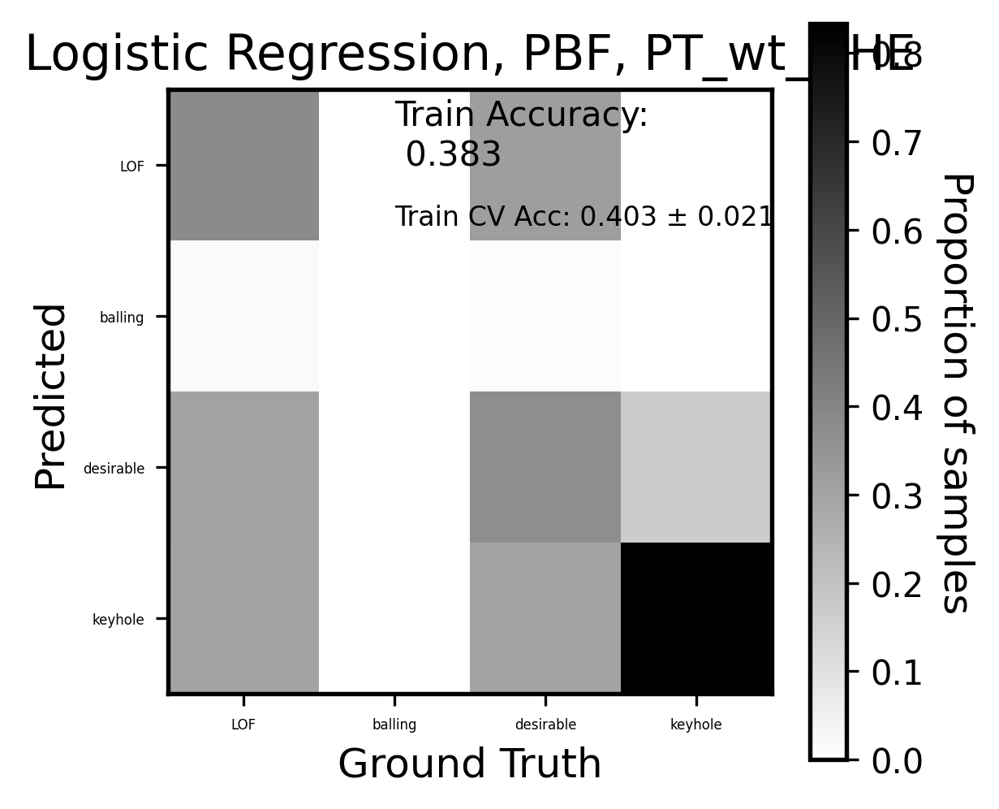

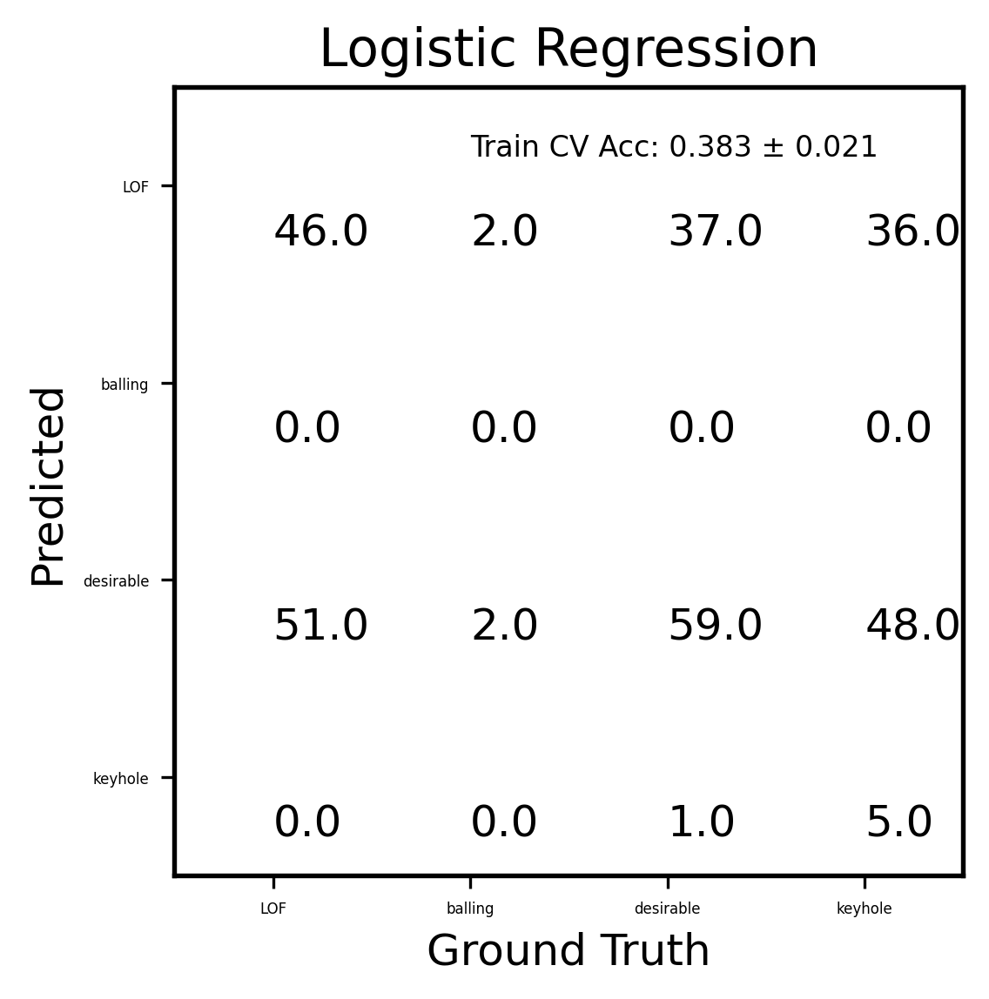

/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:259: RuntimeWarning: invalid value encountered in true_divide


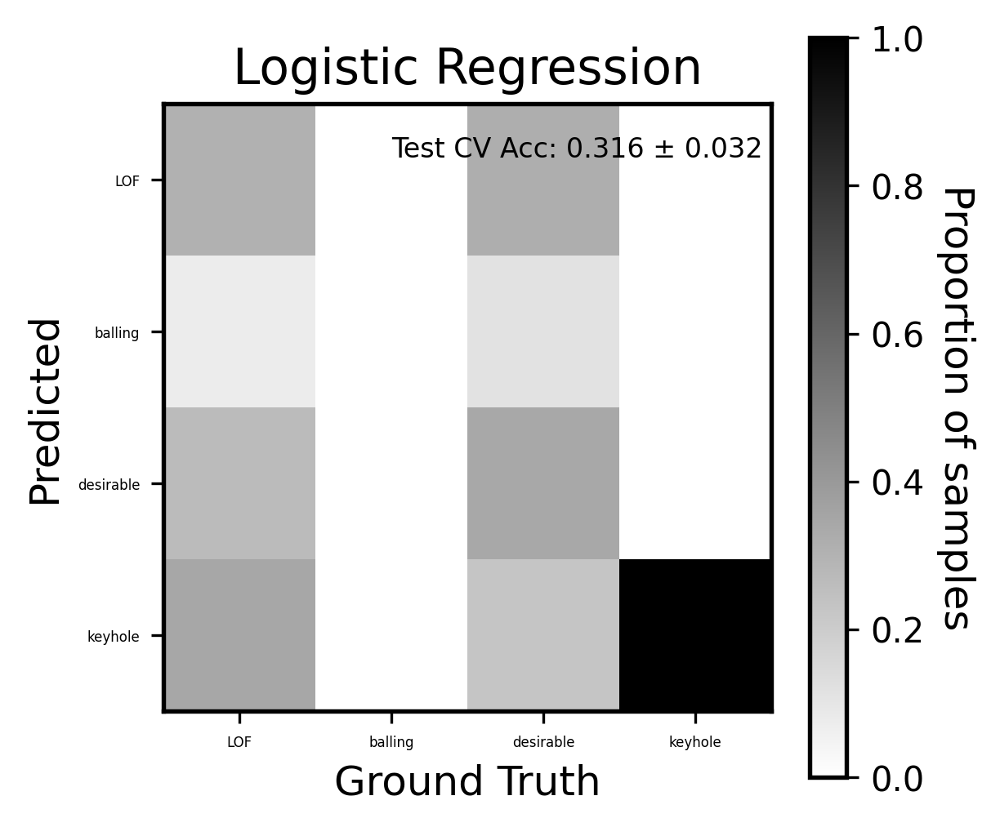

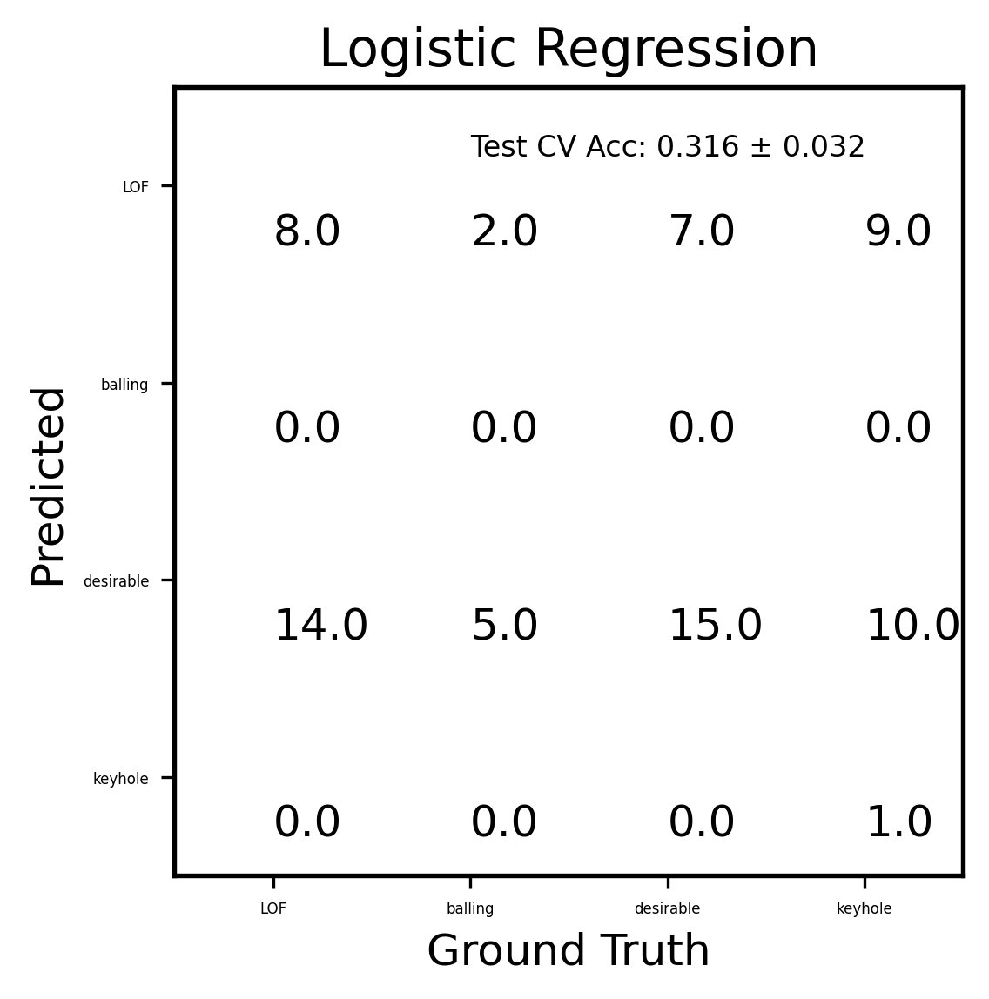

GradientBoostingClassifier()
GradientBoostingClassifier()
GradientBoostingClassifier()
GradientBoostingClassifier()
GradientBoostingClassifier()
GB Train Accuracy: 1.00000 ± 0.00000, Test Accuracy: 0.85728 ± 0.04189


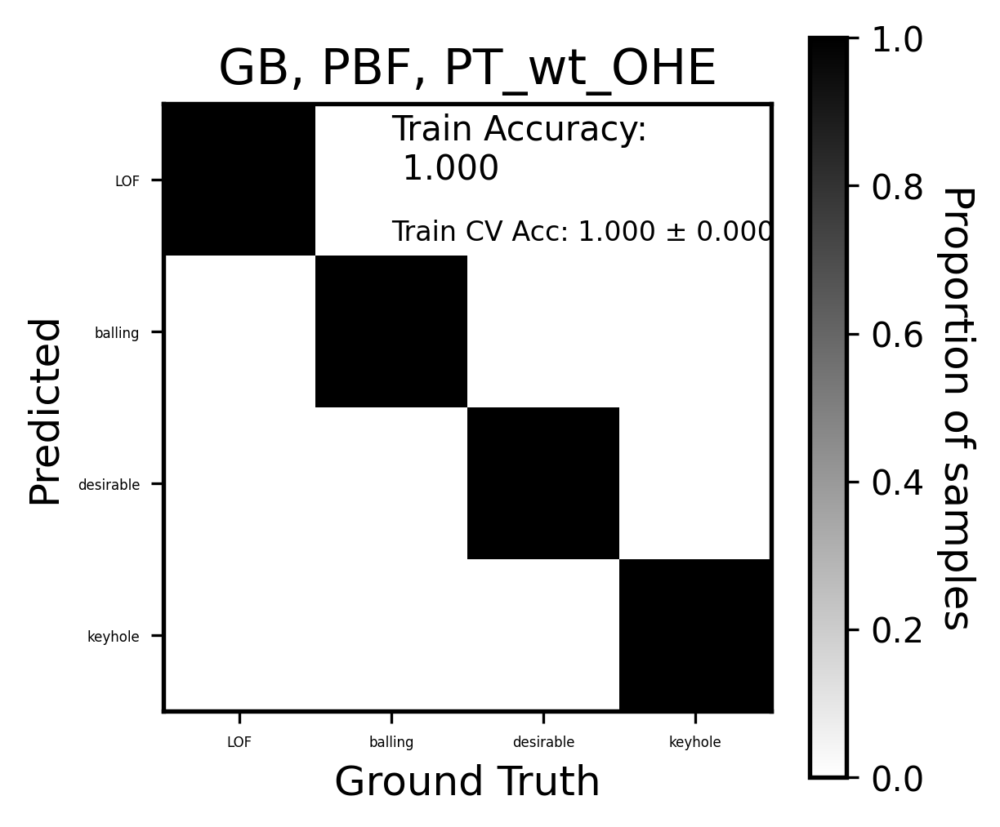

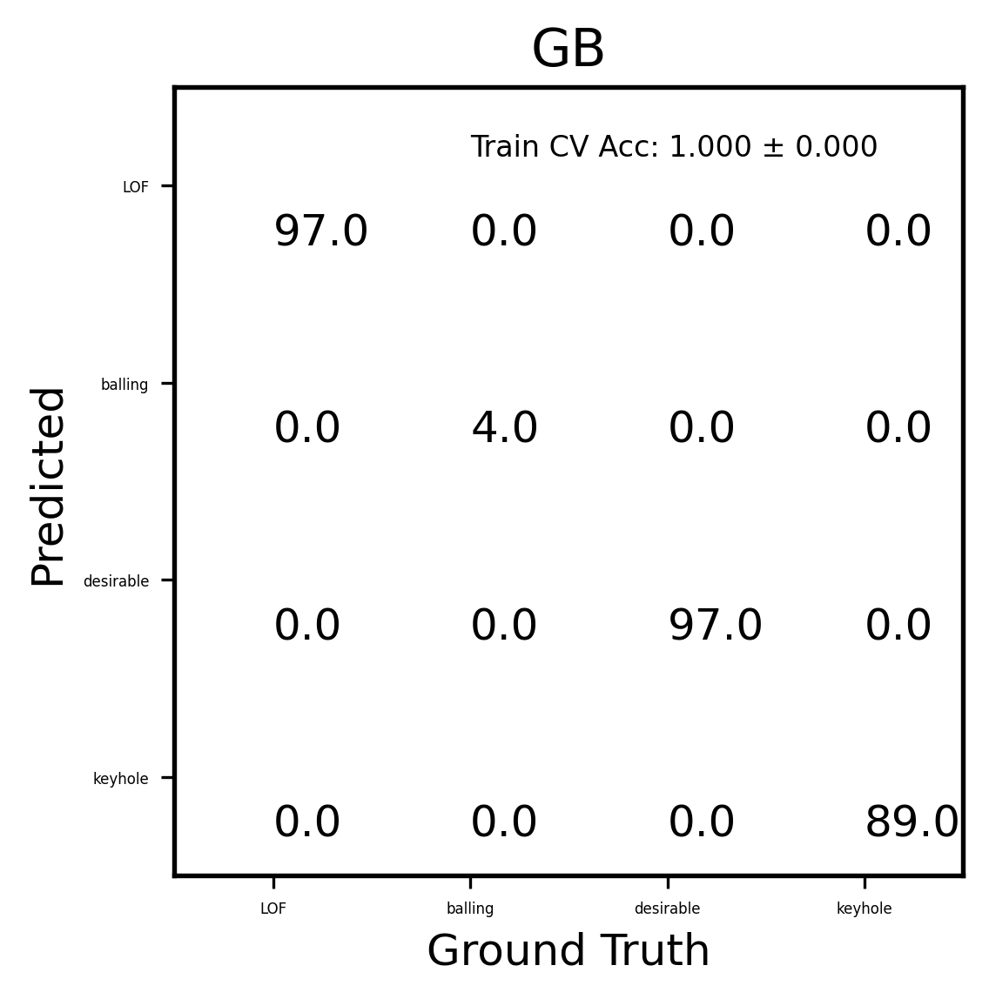

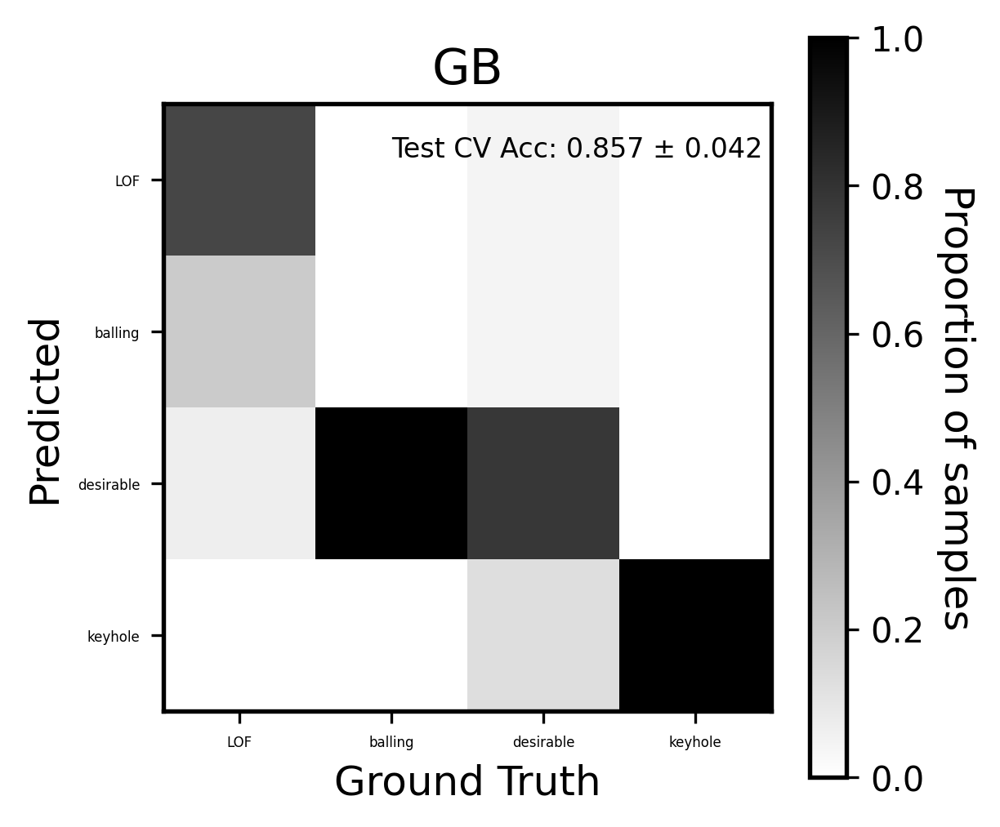

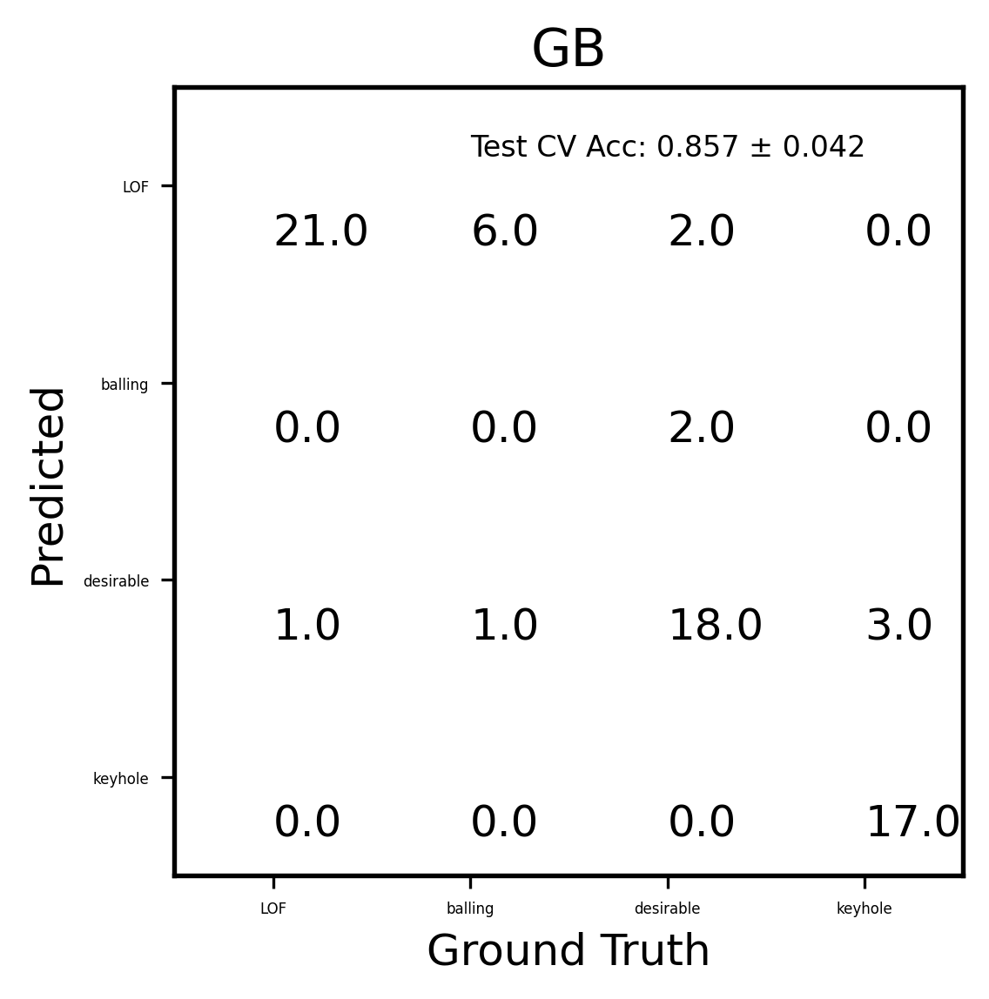

MLPClassifier(hidden_layer_sizes=(32, 64, 64), max_iter=20000)
MLPClassifier(hidden_layer_sizes=(32, 64, 64), max_iter=20000)
MLPClassifier(hidden_layer_sizes=(32, 64, 64), max_iter=20000)
MLPClassifier(hidden_layer_sizes=(32, 64, 64), max_iter=20000)
MLPClassifier(hidden_layer_sizes=(32, 64, 64), max_iter=20000)
NN Train Accuracy: 0.96230 ± 0.01018, Test Accuracy: 0.83228 ± 0.03906


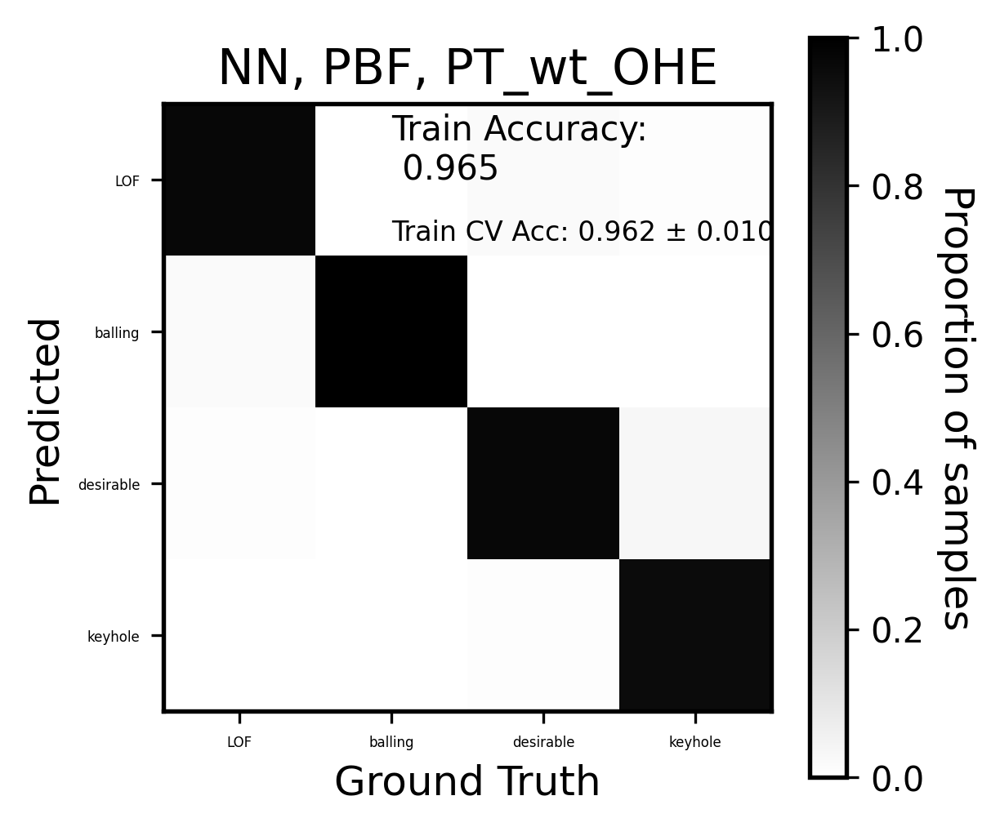

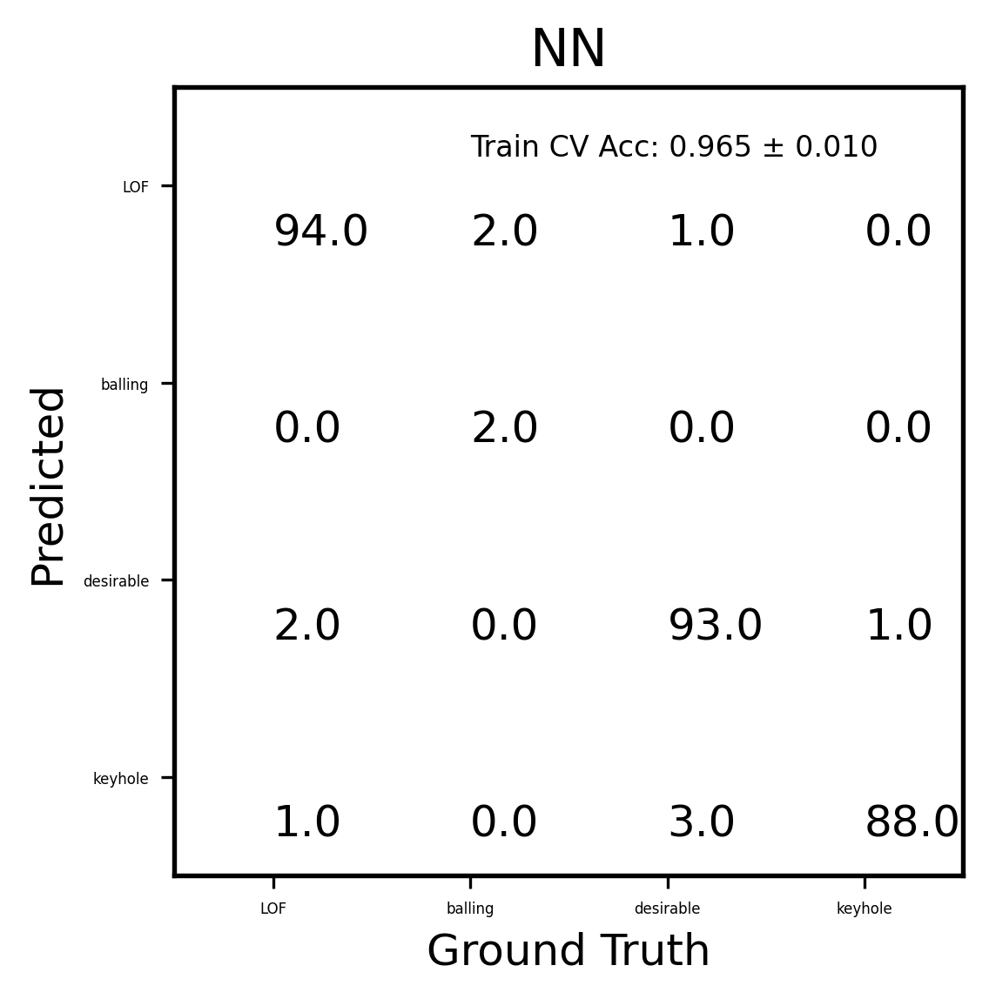

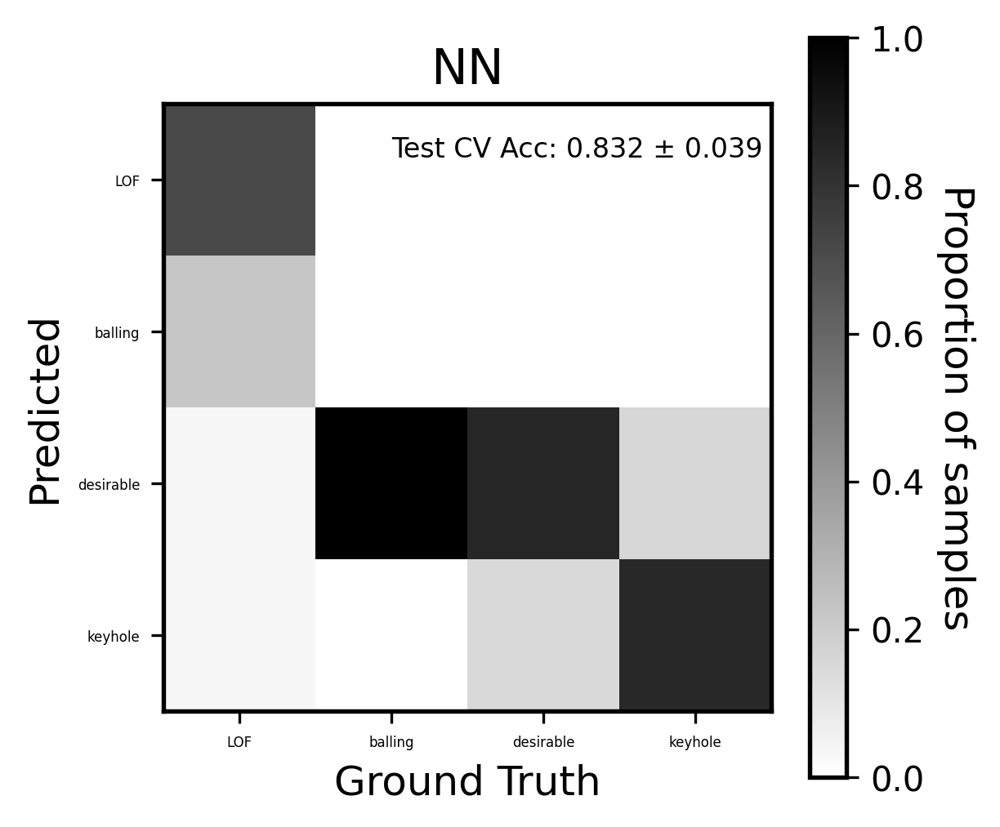

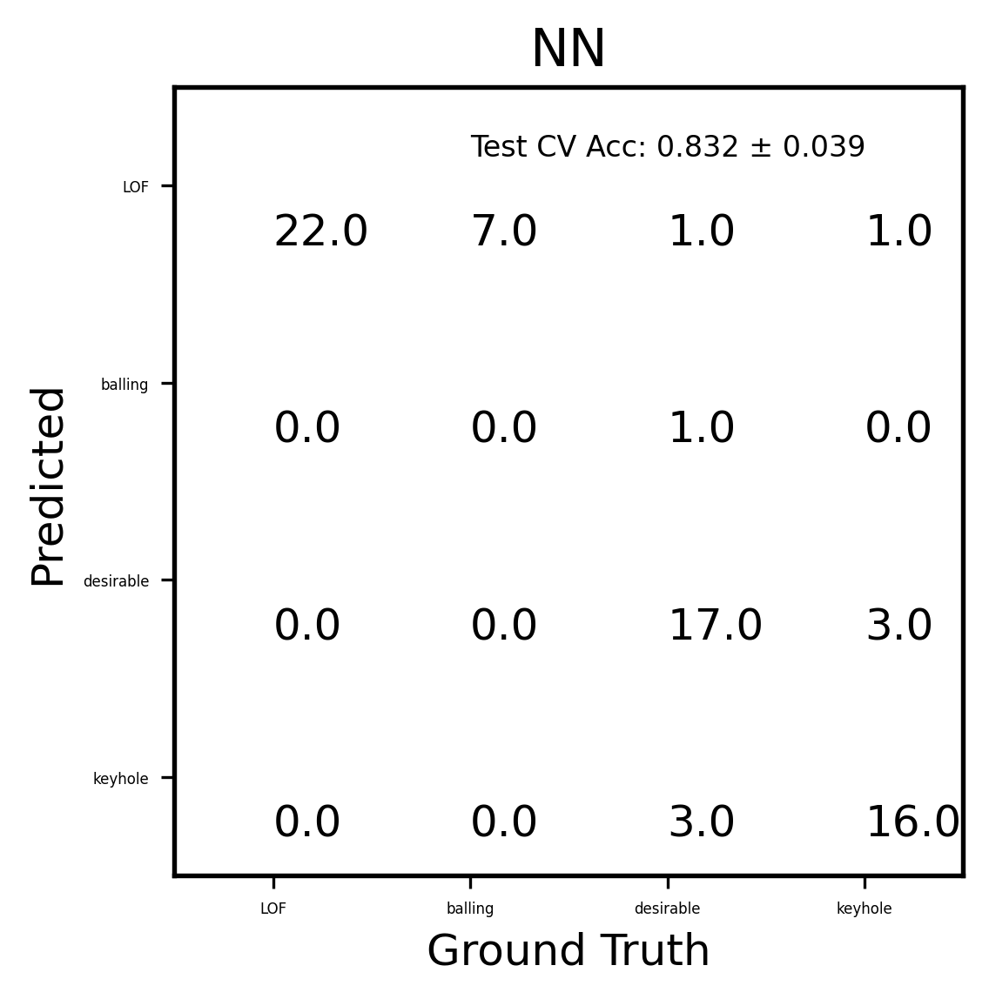

In [48]:
%matplotlib inline
# Define parameters that models will be trained on and value to be predicted
parameter_list = ['Power', 'Velocity', 'density', 'Cp', 'k' , 'beam D', 'melting T', 'layer thickness', 'absorption coefficient']
parameter_list.extend(atomic_features)
label_col = 'meltpool shape'


#new_csv = select_subset(new_csv, 'paper ID', 19)
#new_csv = select_material(new_csv, 'Ti6Al4V')

#Form dataset array from dataframe, given parameter_list, label_col
# function select_parameters() does this as well
data_list = []
label_list = []
materials_present = []

new_csv = select_process(class_csv, 'PBF')
#new_csv = select_material(new_csv, 'Ti-6Al-4V')
test = 0
for i in range(len(new_csv)):
    success, features, label = extract_features(new_csv.iloc[i], parameter_list, label_col)
    if success < 0:
      #  print("CONTINUE")
        continue
    else:
        test += 1
        data_list.append(features)
        label_list.append(label)
        materials_present.append(new_csv['Material'].iloc[i])

print('length in PBF data: ', len(new_csv))
print('Used data points: ', test)
X= np.array(np.squeeze(data_list))
labels = np.unique(label_list)

# Define labels from csv file
label_id = np.arange(len(labels))
class_labels = np.zeros(len(label_list))
for idx, sample in enumerate(label_list):
    for l_id, lbl in enumerate(labels):
        if lbl == sample:
            class_labels[idx] = l_id
y = np.array(class_labels)

# Define One Hot Encoding of materials
materials_ohe = [np.zeros(len(materials_present)) for key in materials.keys()]

materials_ohe = np.array(materials_ohe).T

#breakpoint()
#materials.keys()
print(len(materials_ohe))
material_pos = np.arange(len(materials.keys()))
for idx in range(len(materials_present)):
    for j_idx in range(len(material_pos)):
      #  breakpoint()
        if materials_present[idx] == materials.keys()[j_idx]:
            
            materials_ohe[idx,j_idx] = 1 
            #pass
# for i,j in zip(y_pos, materials.keys()):
    
#     print(i, j)
#breakpoint()
 
class_labels = np.array(class_labels,dtype = 'int')


fit_models_wtohe, train_accuracy_wtohe, train_accuracy_std_wtohe, test_accuracy_wtohe, test_accuracy_std_wtohe = classify_learn(X.reshape(-1, len(X[0])), y, labels, parameters = parameter_list, title = 'PBF, PT_wt_OHE', plot = True, prefix = 'classification')


In [49]:
pd.set_option("display.max_rows", None, "display.max_columns", None)
class_csv[class_csv['meltpool shape'] == 'spatter formation']

,Material,Process,Sub-process,Power,Velocity,Hatch spacing,depth of meltpool,width of melt pool,length of melt pool,d/l,d/w,l/w,E (J/mm),E (J/mm3),layer thickness,beam D,absorption coefficient,absorption coefficient 2,density,Cp,k,melting T,minimal absorptivity,meltpool shape,spatter,Y (wt%),Zn (wt%),Mg (wt%),Si (wt%),Al (wt%),Sn (wt%),Zr (wt%),W (wt%),Ti (wt%),V (wt%),Co (wt%),Cu (wt%),Ta (wt%),Nb (wt%),Ni (wt.%),Cr (wt.%),Fe (wt.%),Mn (wt%),Mo (wt.%),D10,D50,D90,paper ID,paper,porosity,relative density,comment,Unnamed: 52,energy density,Unnamed: 15,Zn,Sn,Zr
568,SS17-4PH,PBF,SLM,2700.0,1200.0,NaN,256.0,440.0,2680.0,5.12,0.5818181818,6.090909091,2.250000,NaN,50,240.0,NaN,0.468464,7750,460,17.9,1693.0,NaN,spatter formation,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.65,0.0,0.0,4.0,16.0,75.0,0.0,0.0,NaN,NaN,NaN,25,https://www.mdpi.com/2075-4701/8/7/537,NaN,NaN,NaN,1420.0,NaN,NaN,NaN,NaN,NaN
569,SS17-4PH,PBF,SLM,2700.0,1400.0,NaN,195.0,412.0,2683.0,3.90,0.4733009709,6.512135922,1.928571,NaN,50,240.0,NaN,0.478302,7750,460,17.9,1693.0,NaN,spatter formation,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.65,0.0,0.0,4.0,16.0,75.0,0.0,0.0,NaN,NaN,NaN,25,https://www.mdpi.com/2075-4701/8/7/538,NaN,NaN,NaN,1420.0,NaN,NaN,NaN,NaN,NaN
570,SS17-4PH,PBF,SLM,2700.0,1600.0,NaN,168.0,414.0,2686.0,3.36,0.4057971014,6.487922705,1.687500,NaN,50,240.0,NaN,0.550509,7750,460,17.9,1693.0,NaN,spatter formation,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.65,0.0,0.0,4.0,16.0,75.0,0.0,0.0,NaN,NaN,NaN,25,https://www.mdpi.com/2075-4701/8/7/539,NaN,NaN,NaN,1420.0,NaN,NaN,NaN,NaN,NaN
571,SS17-4PH,PBF,SLM,2700.0,1800.0,NaN,154.0,400.0,2690.0,3.08,0.385,6.725,1.500000,NaN,50,240.0,NaN,0.577328,7750,460,17.9,1693.0,NaN,spatter formation,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.65,0.0,0.0,4.0,16.0,75.0,0.0,0.0,NaN,NaN,NaN,25,https://www.mdpi.com/2075-4701/8/7/540,NaN,NaN,NaN,1420.0,NaN,NaN,NaN,NaN,NaN
572,SS17-4PH,PBF,SLM,2700.0,2000.0,NaN,138.0,372.0,2693.0,2.76,0.3709677419,7.239247312,1.350000,NaN,50,240.0,NaN,0.554521,7750,460,17.9,1693.0,NaN,spatter formation,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.65,0.0,0.0,4.0,16.0,75.0,0.0,0.0,NaN,NaN,NaN,25,https://www.mdpi.com/2075-4701/8/7/541,NaN,NaN,NaN,1420.0,NaN,NaN,NaN,NaN,NaN
573,SS17-4PH,PBF,SLM,2700.0,2200.0,NaN,122.0,350.0,2696.0,2.44,0.3485714286,7.702857143,1.227273,NaN,50,240.0,NaN,0.539673,7750,460,17.9,1693.0,NaN,spatter formation,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.65,0.0,0.0,4.0,16.0,75.0,0.0,0.0,NaN,NaN,NaN,25,https://www.mdpi.com/2075-4701/8/7/542,NaN,NaN,NaN,1420.0,NaN,NaN,NaN,NaN,NaN
574,SS17-4PH,PBF,SLM,2700.0,2400.0,NaN,115.0,335.0,2698.0,2.30,0.3432835821,8.053731343,1.125000,NaN,50,240.0,NaN,0.539005,7750,460,17.9,1693.0,NaN,spatter formation,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.65,0.0,0.0,4.0,16.0,75.0,0.0,0.0,NaN,NaN,NaN,25,https://www.mdpi.com/2075-4701/8/7/543,NaN,NaN,NaN,1420.0,NaN,NaN,NaN,NaN,NaN
575,SS17-4PH,PBF,SLM,2700.0,2600.0,NaN,100.0,320.0,2700.0,2.00,0.3125,8.4375,1.038462,NaN,50,240.0,NaN,0.532540,7750,460,17.9,1693.0,NaN,spatter formation,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.65,0.0,0.0,4.0,16.0,75.0,0.0,0.0,NaN,NaN,NaN,25,https://www.mdpi.com/2075-4701/8/7/544,NaN,NaN,NaN,1420.0,NaN,NaN,NaN,NaN,NaN


## Classification with PT and element features

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
length in PBF data:  2178
Used data points:  252
RandomForestClassifier()
RandomForestClassifier()
R

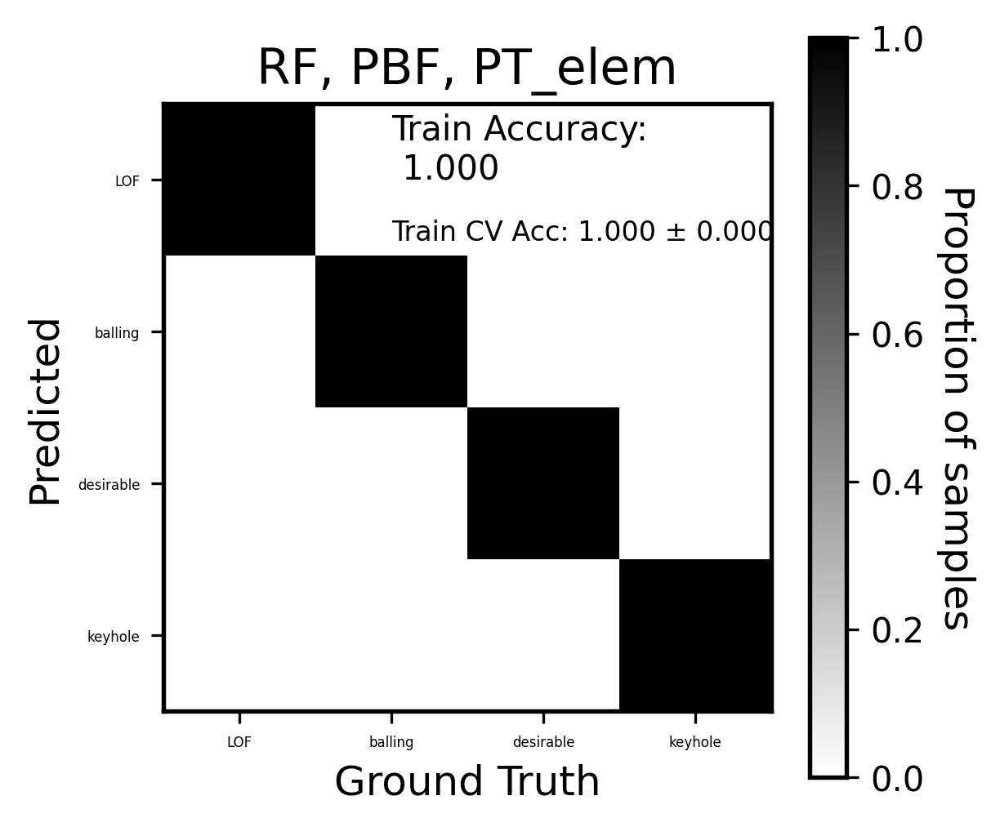

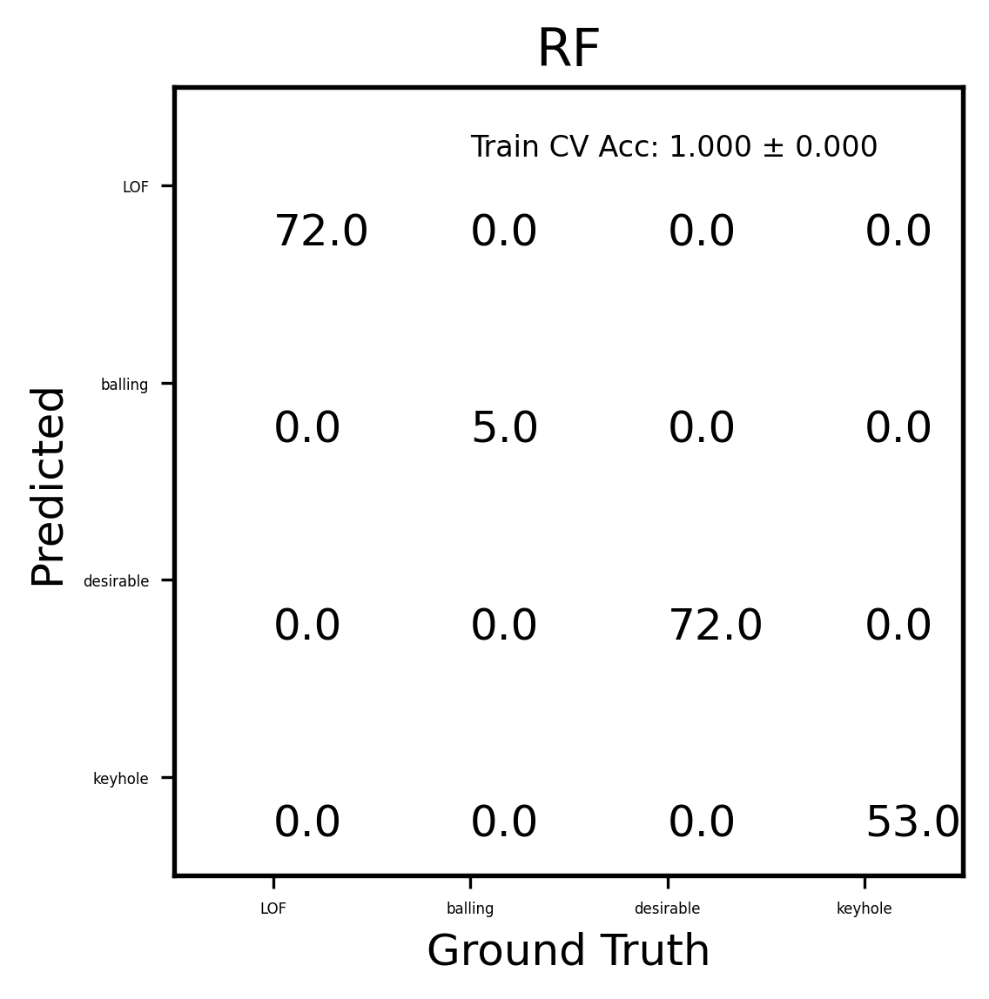

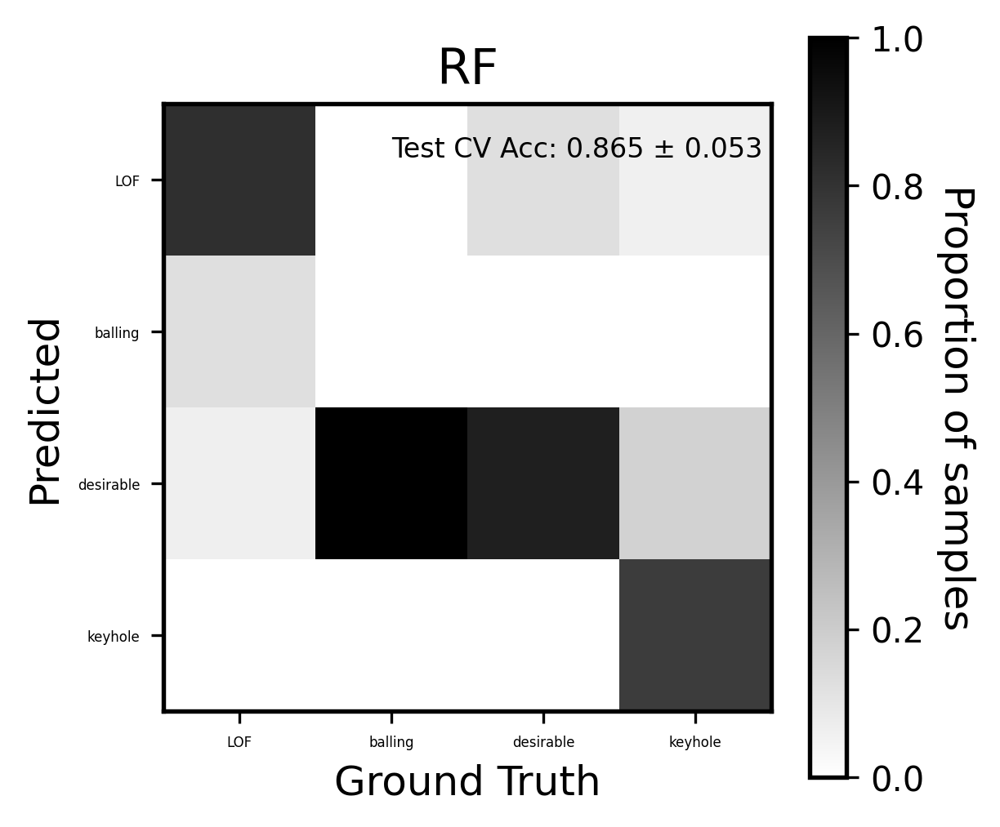

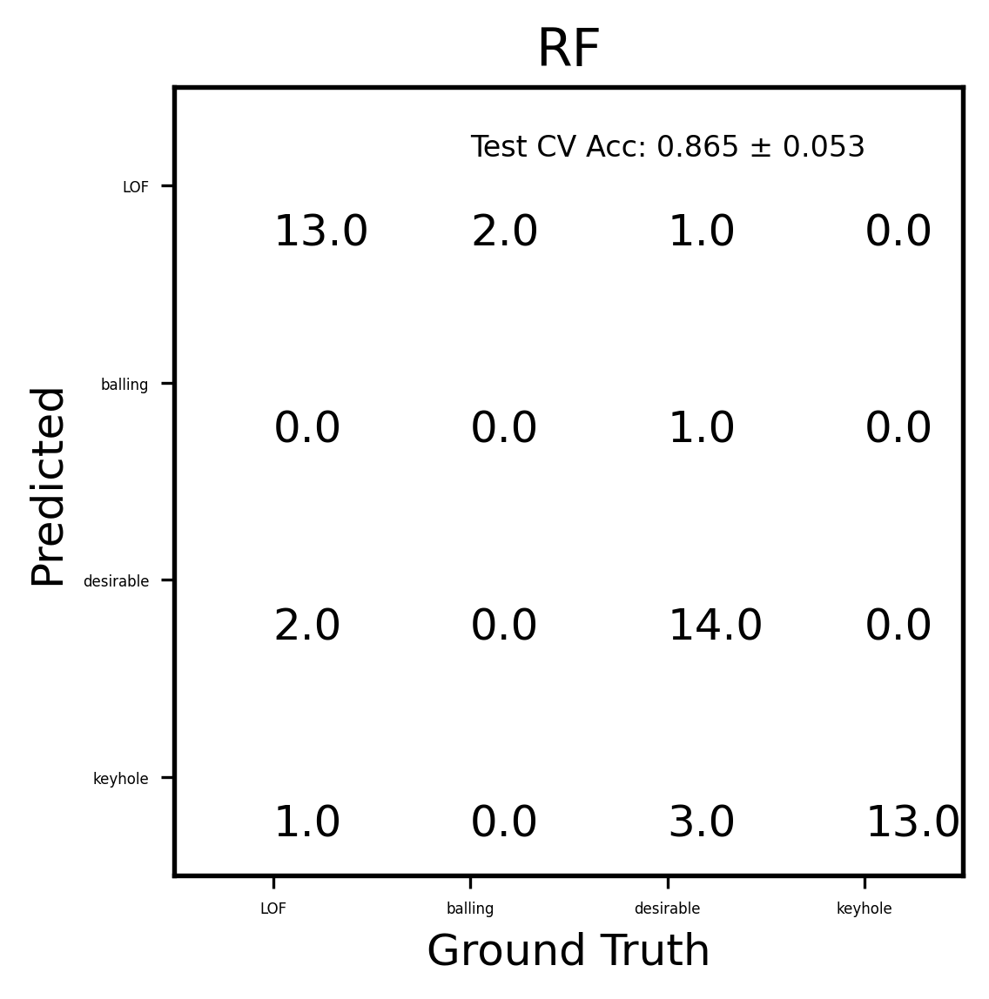

GaussianProcessClassifier()
GaussianProcessClassifier()
GaussianProcessClassifier()
GaussianProcessClassifier()
GaussianProcessClassifier()
GPC Train Accuracy: 0.84921 ± 0.00790, Test Accuracy: 0.73012 ± 0.05319


/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:181: RuntimeWarning: invalid value encountered in true_divide


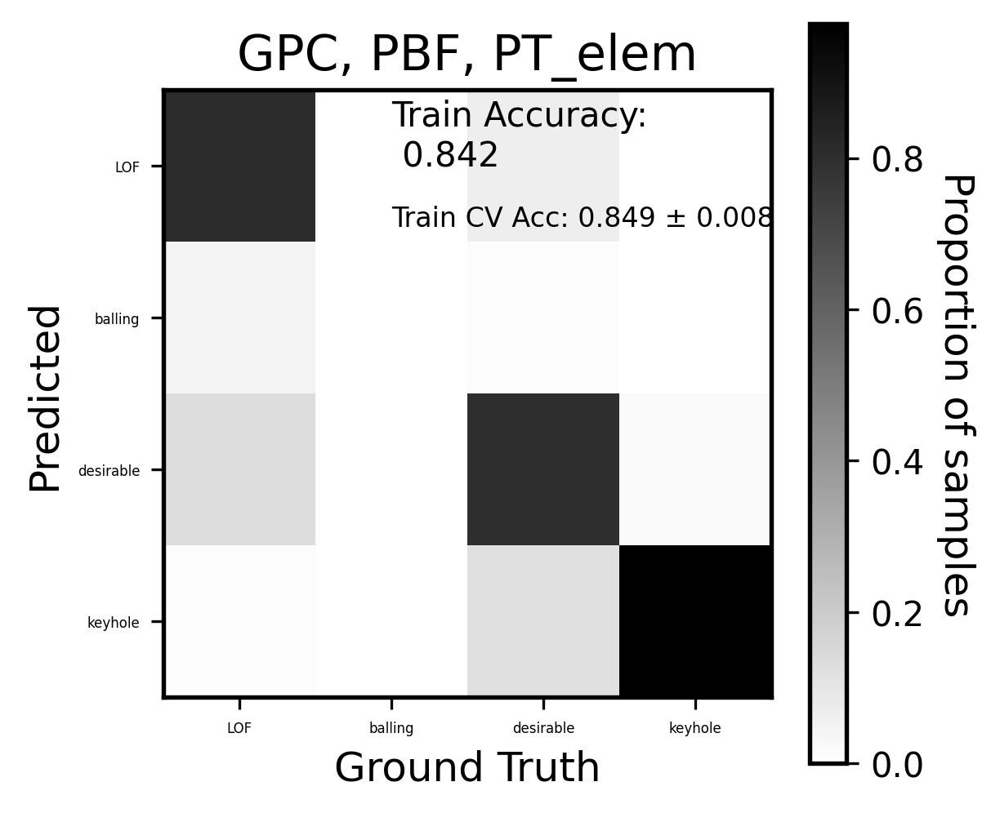

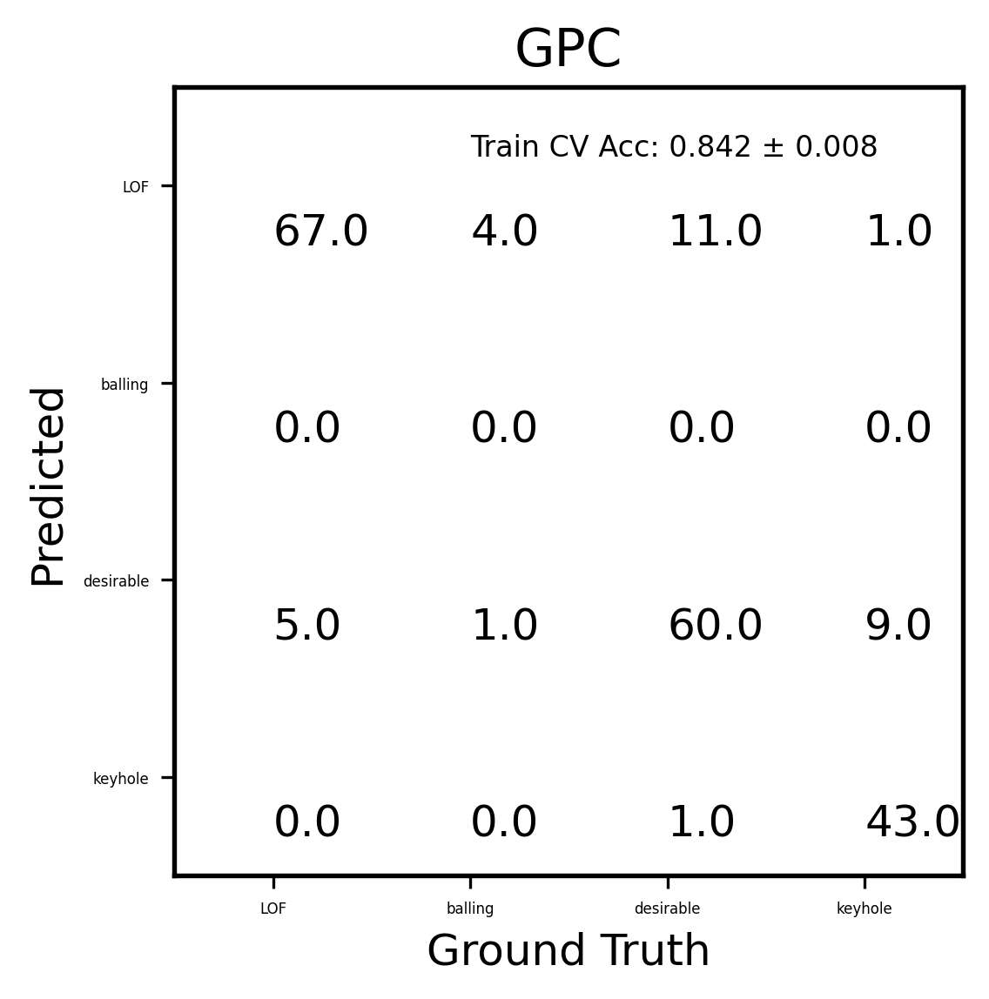

/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:259: RuntimeWarning: invalid value encountered in true_divide


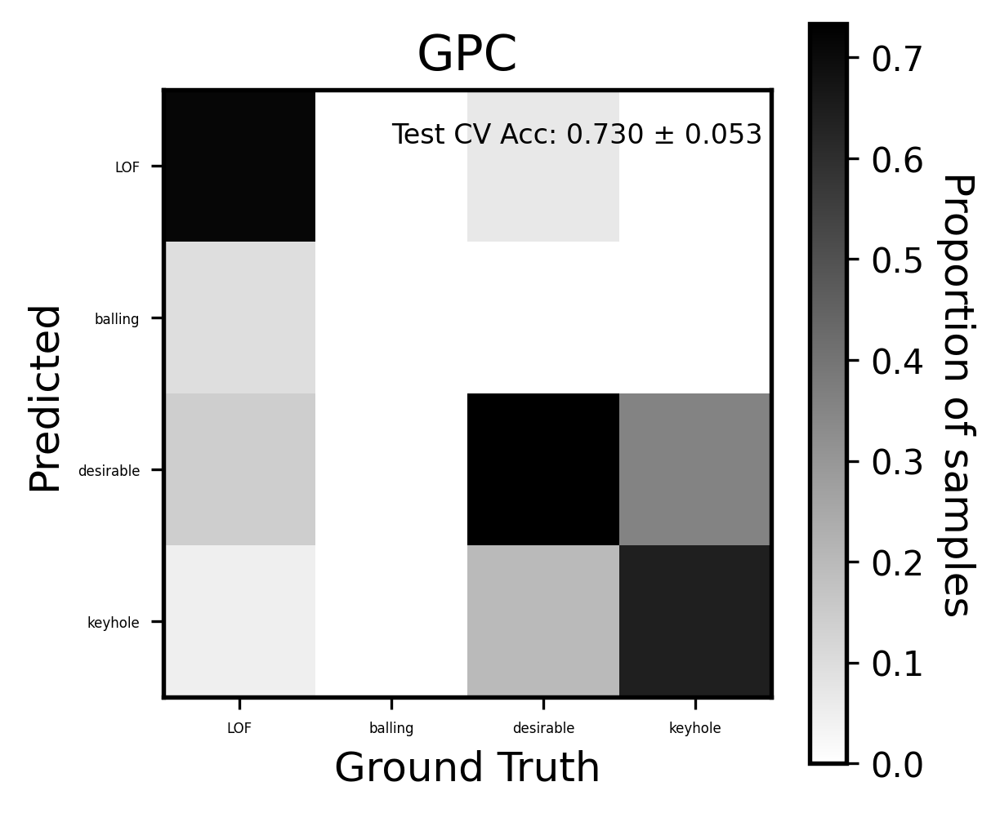

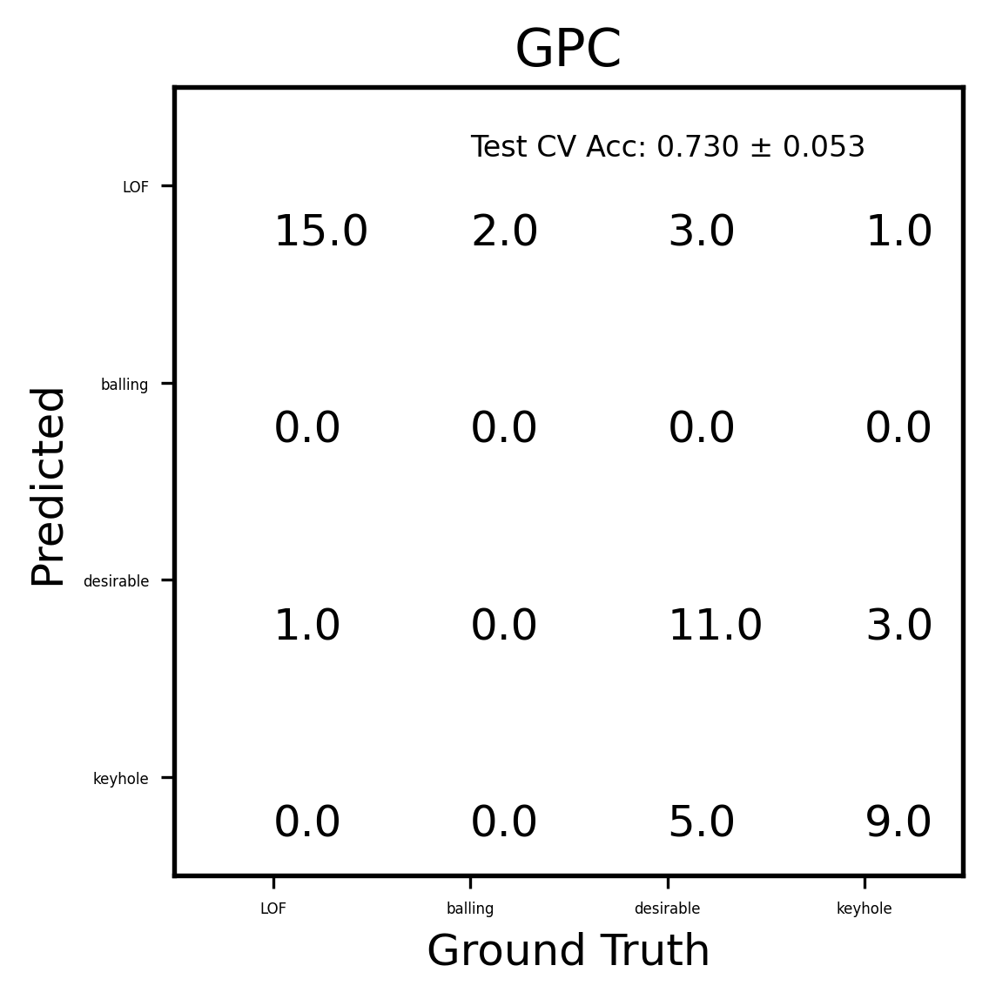

SVC()
SVC()
SVC()
SVC()
SVC()
SVC Train Accuracy: 0.71428 ± 0.01596, Test Accuracy: 0.64643 ± 0.09019


/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:181: RuntimeWarning: invalid value encountered in true_divide


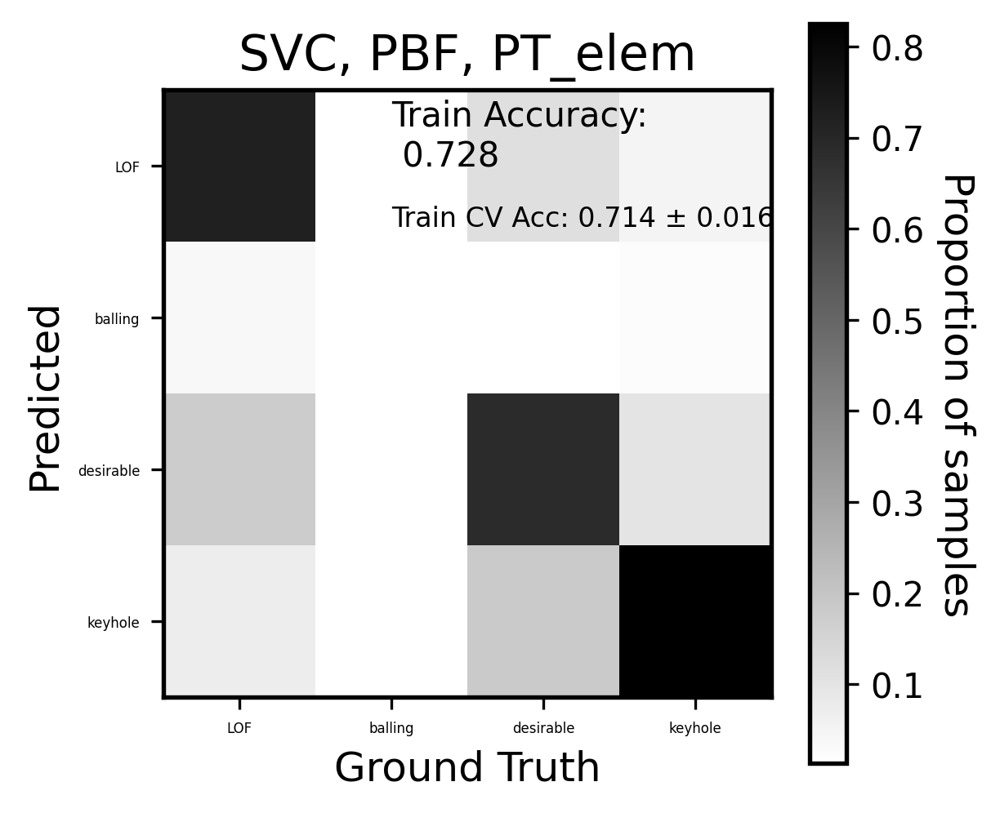

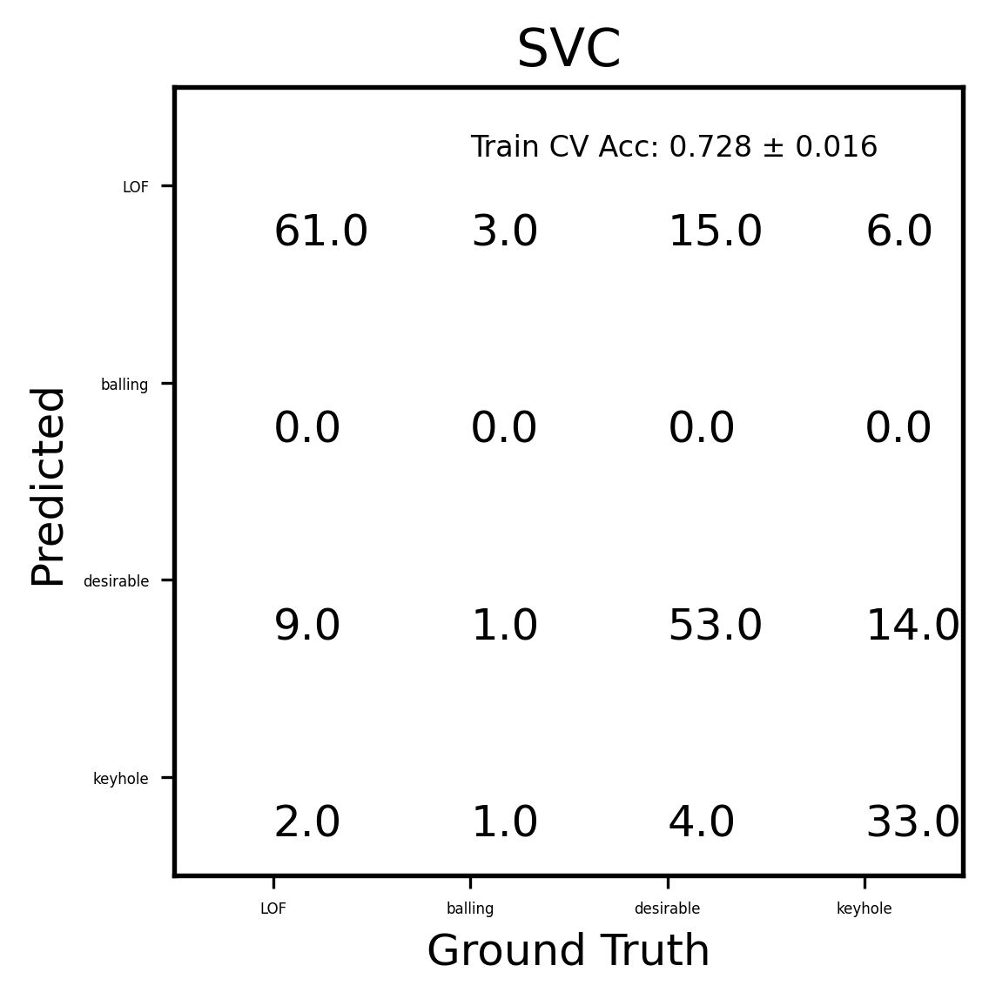

/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:259: RuntimeWarning: invalid value encountered in true_divide


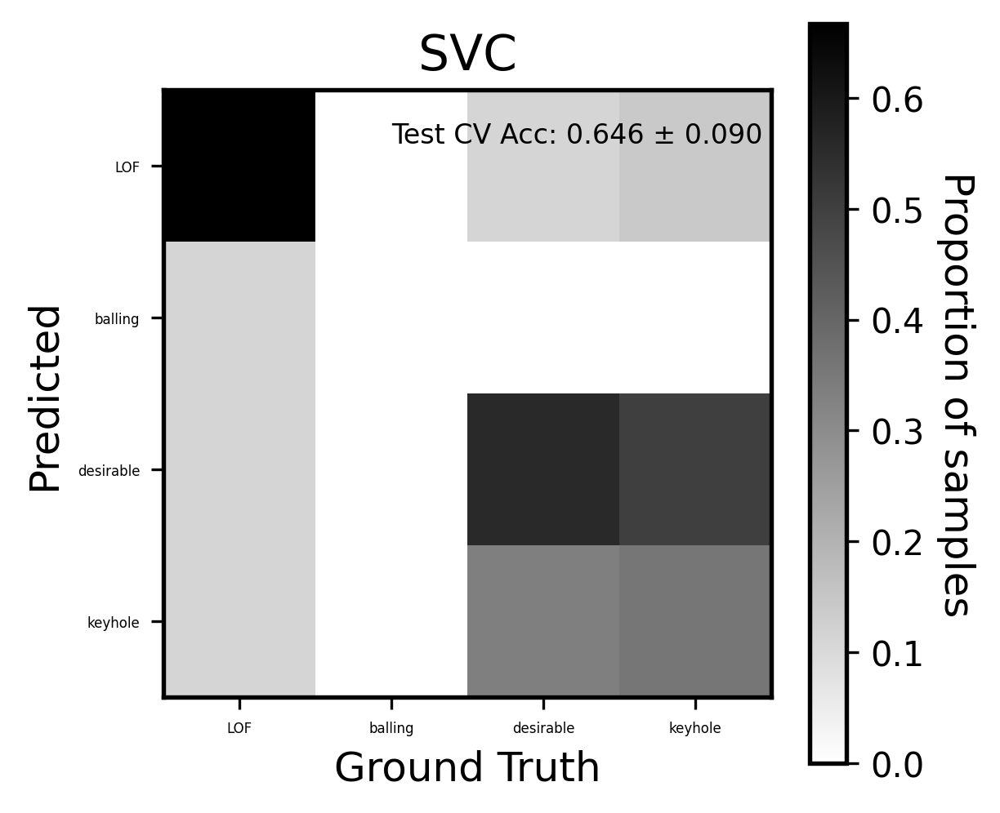

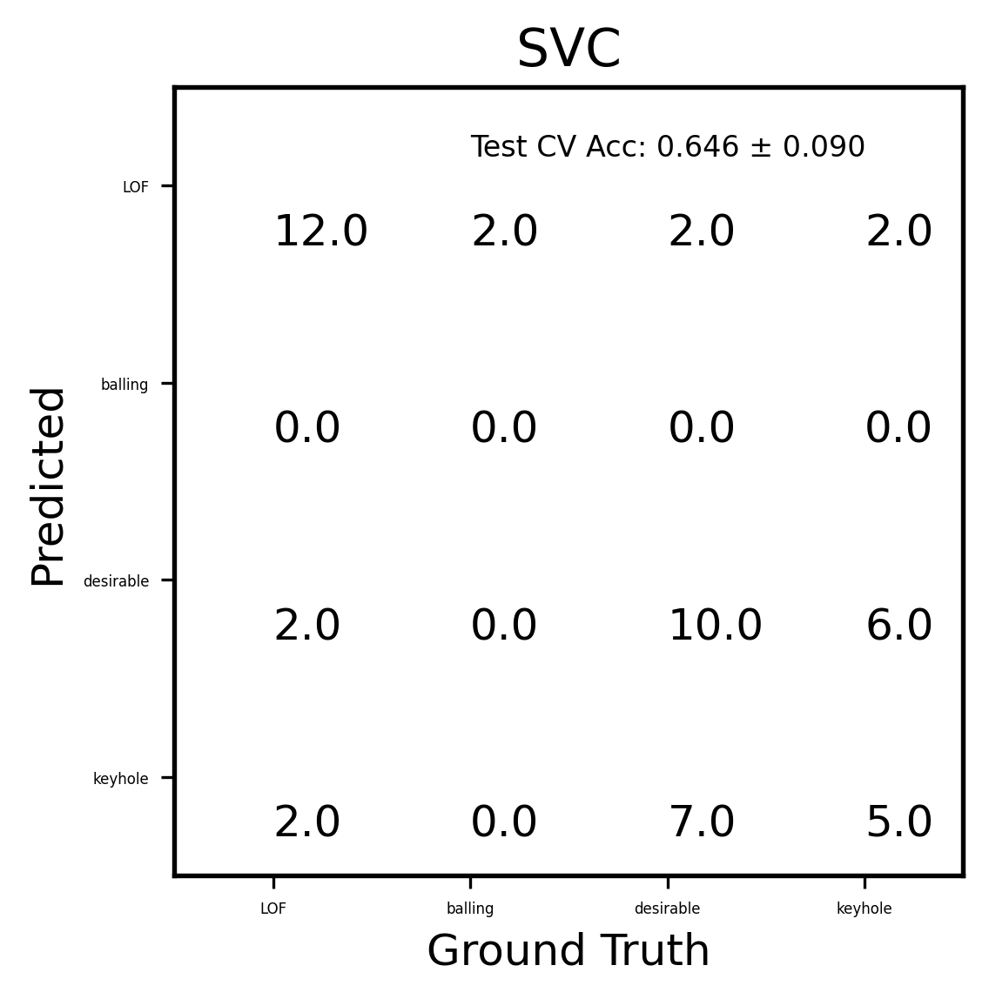

LogisticRegression(C=0.00045)
LogisticRegression(C=0.00045)
LogisticRegression(C=0.00045)
LogisticRegression(C=0.00045)
LogisticRegression(C=0.00045)
Logistic Regression Train Accuracy: 0.42256 ± 0.04710, Test Accuracy: 0.37349 ± 0.10166


/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:181: RuntimeWarning: invalid value encountered in true_divide


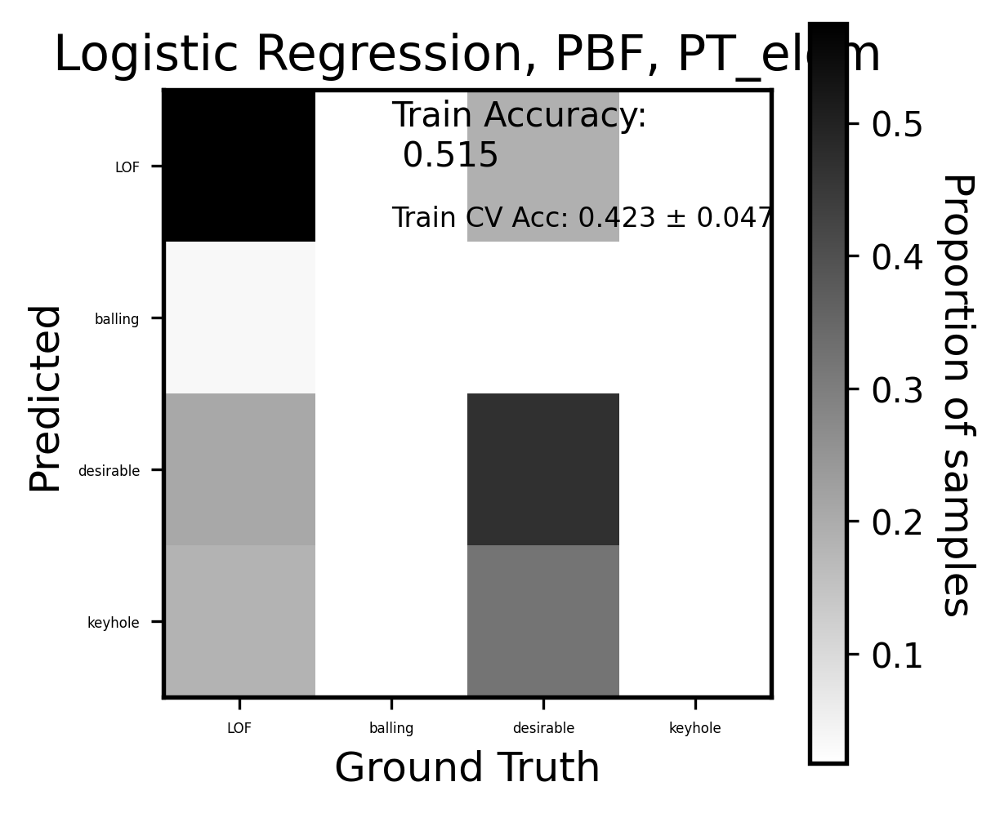

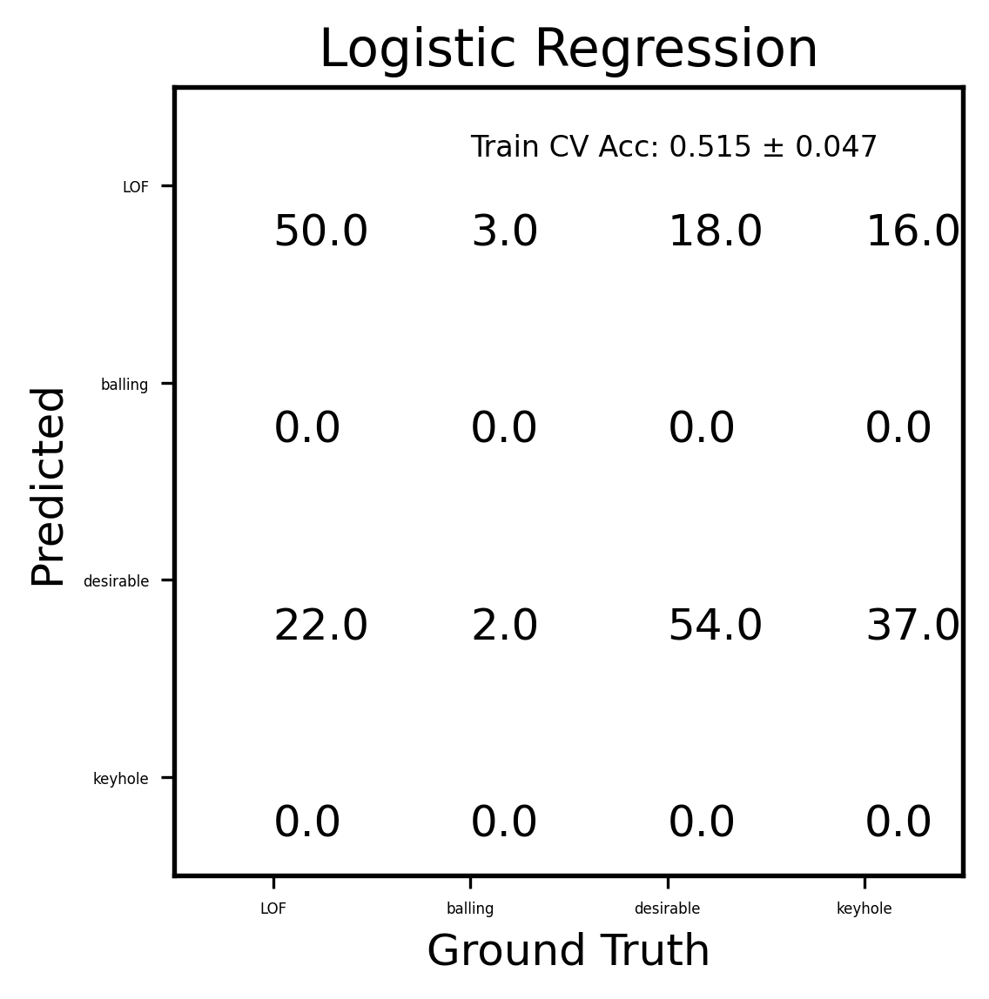

/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:259: RuntimeWarning: invalid value encountered in true_divide


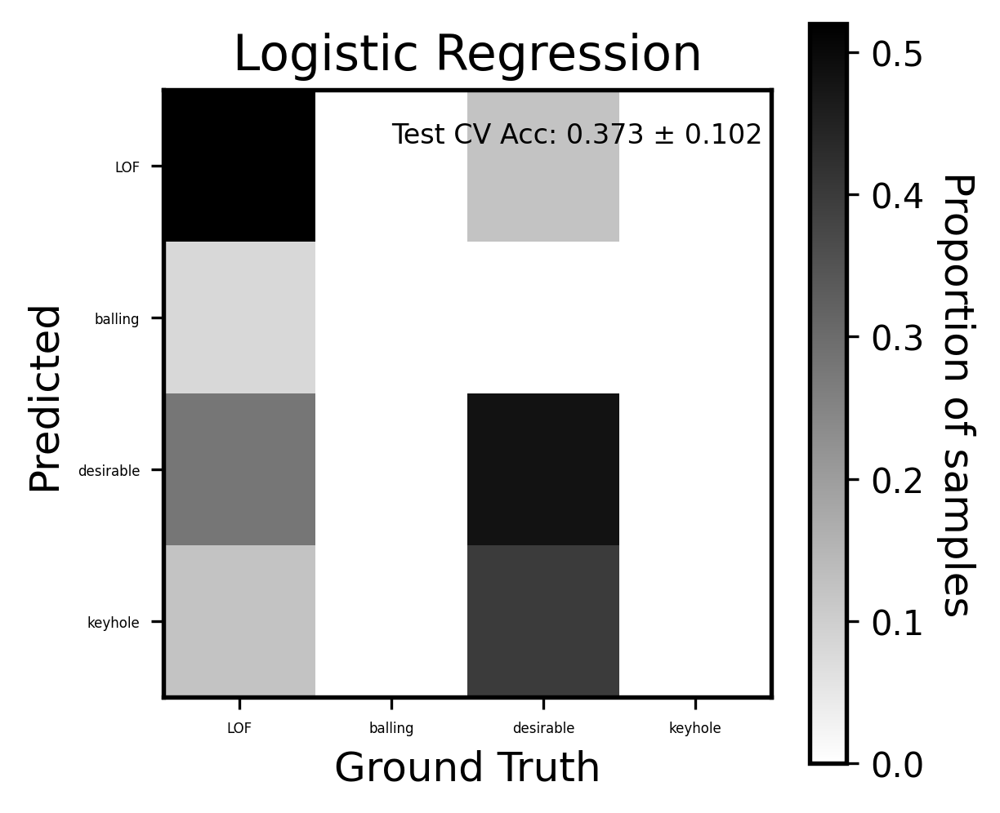

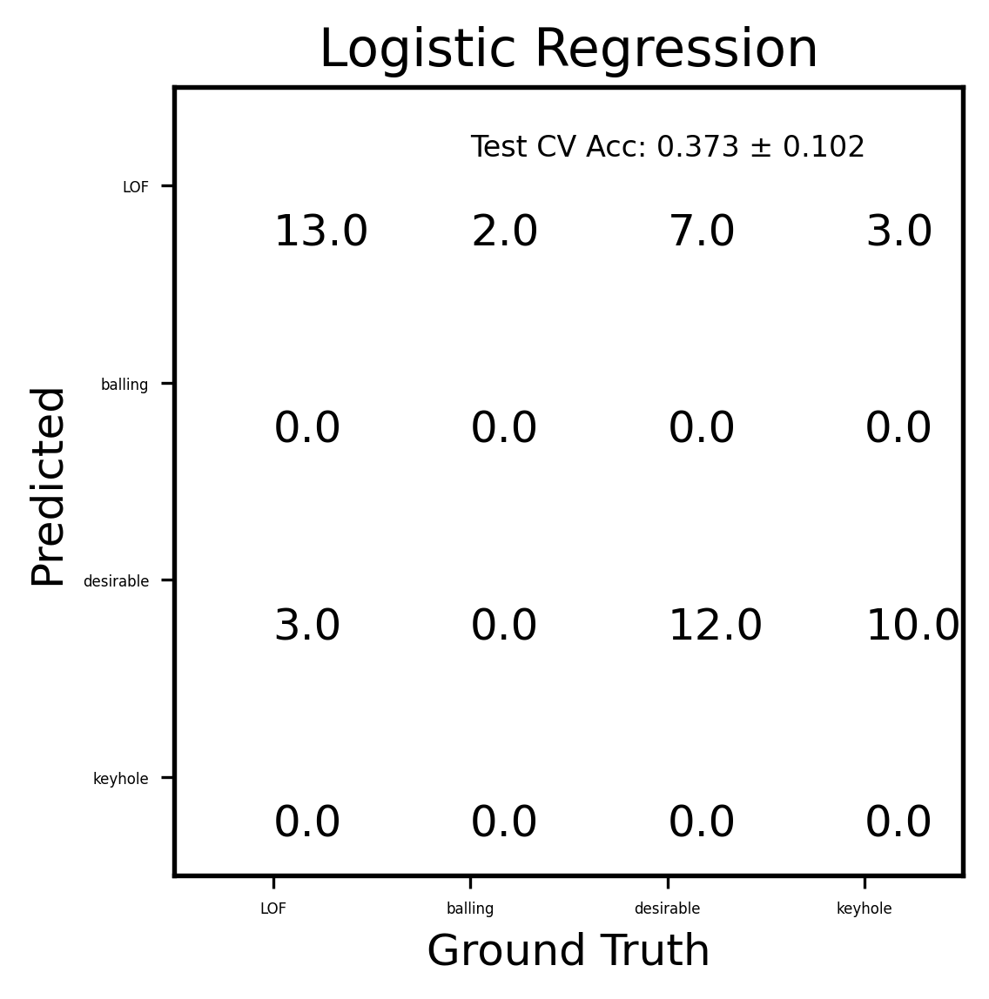

GradientBoostingClassifier()
GradientBoostingClassifier()
GradientBoostingClassifier()
GradientBoostingClassifier()
GradientBoostingClassifier()
GB Train Accuracy: 1.00000 ± 0.00000, Test Accuracy: 0.89655 ± 0.04313


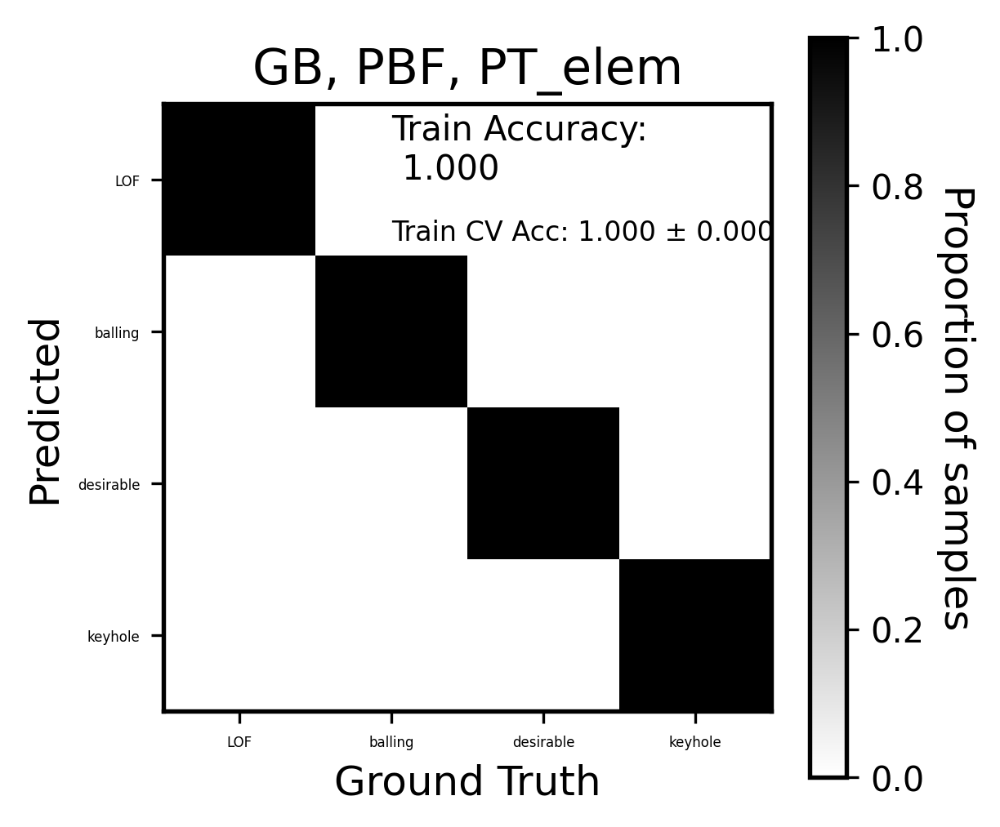

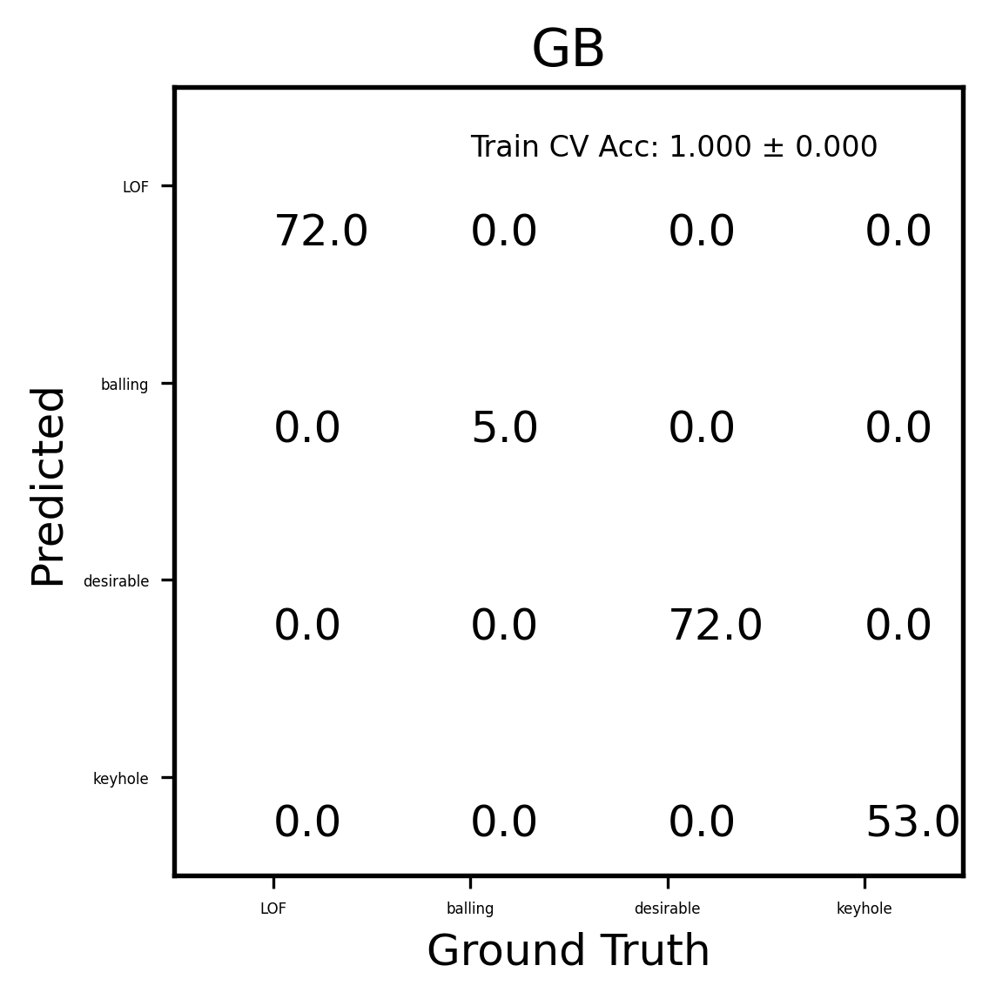

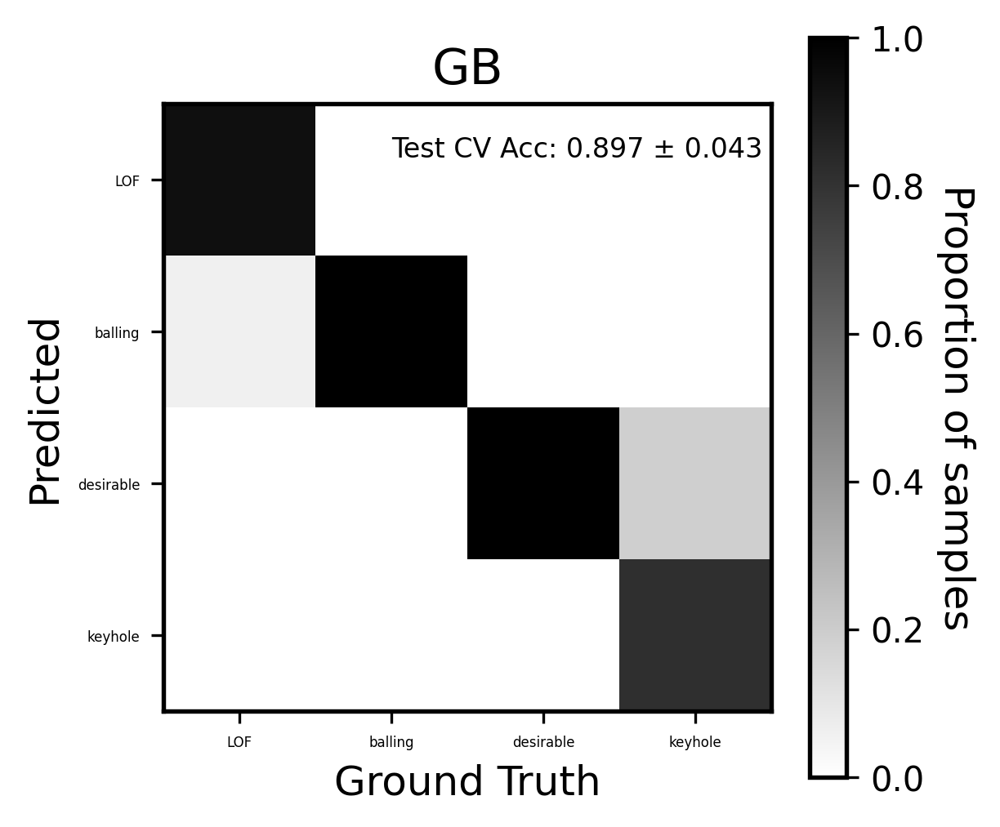

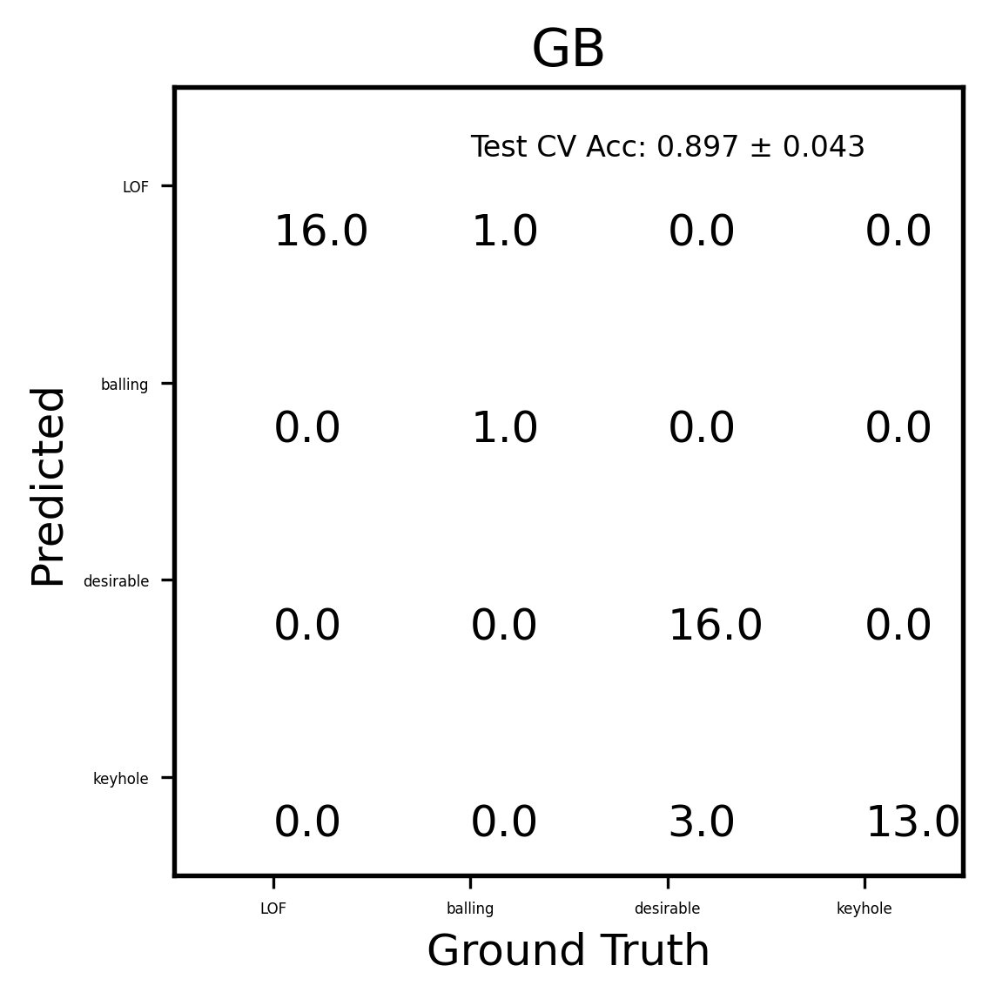

MLPClassifier(hidden_layer_sizes=(32, 64, 64), max_iter=20000)
MLPClassifier(hidden_layer_sizes=(32, 64, 64), max_iter=20000)
MLPClassifier(hidden_layer_sizes=(32, 64, 64), max_iter=20000)
MLPClassifier(hidden_layer_sizes=(32, 64, 64), max_iter=20000)
MLPClassifier(hidden_layer_sizes=(32, 64, 64), max_iter=20000)
NN Train Accuracy: 0.74193 ± 0.06589, Test Accuracy: 0.70635 ± 0.06362


/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:181: RuntimeWarning: invalid value encountered in true_divide


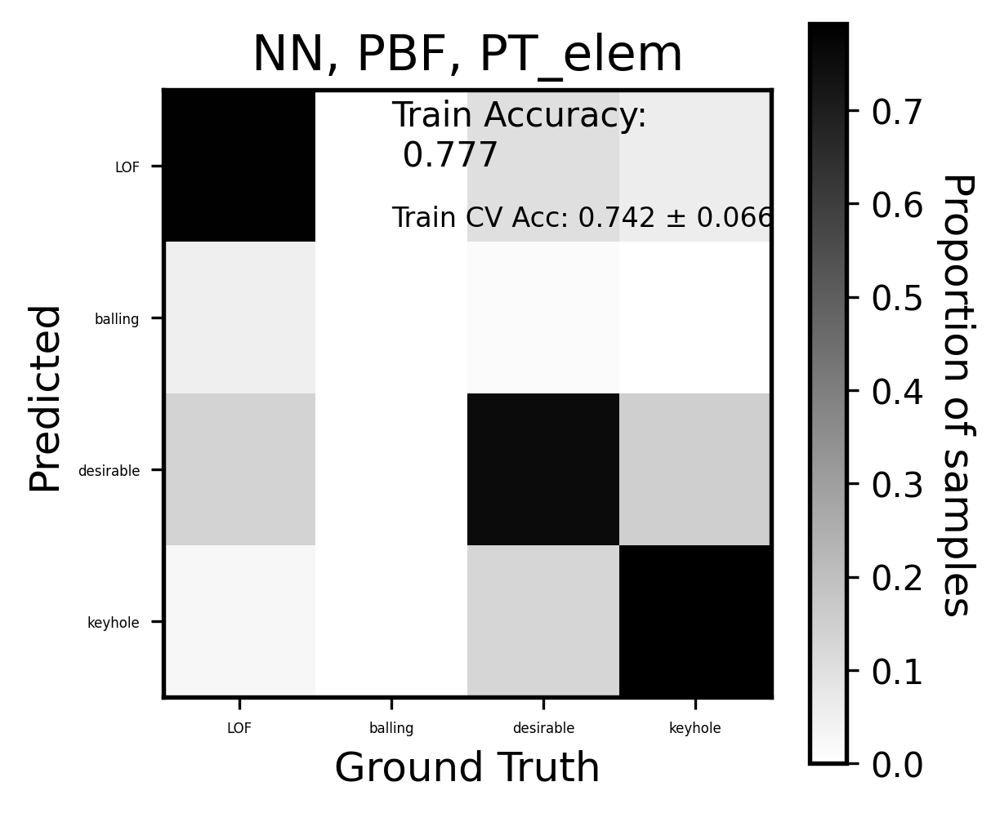

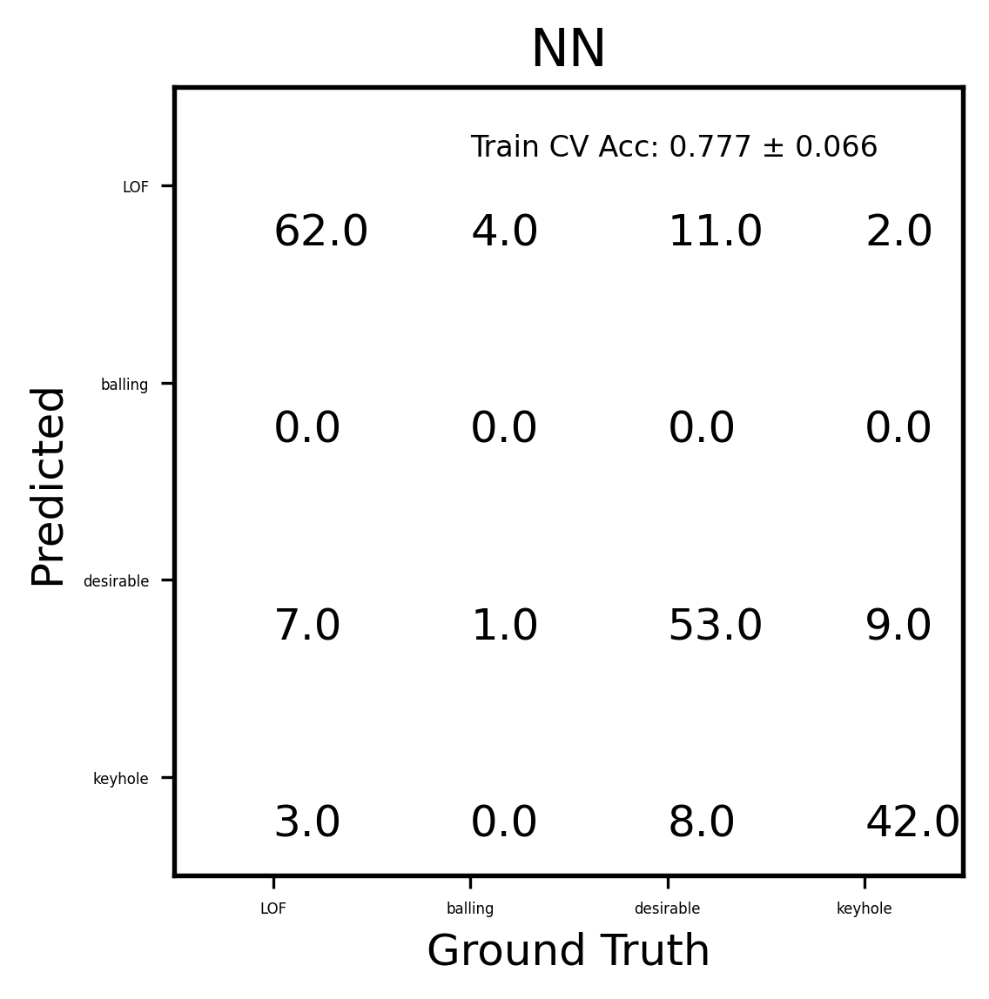

/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:259: RuntimeWarning: invalid value encountered in true_divide


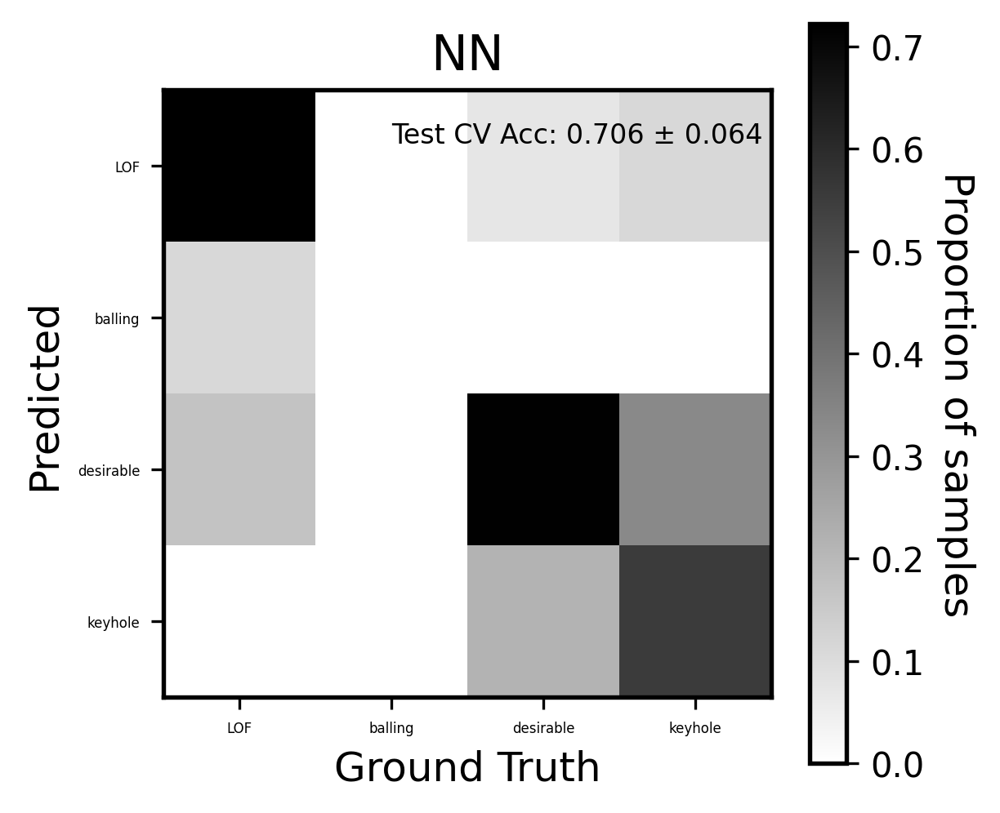

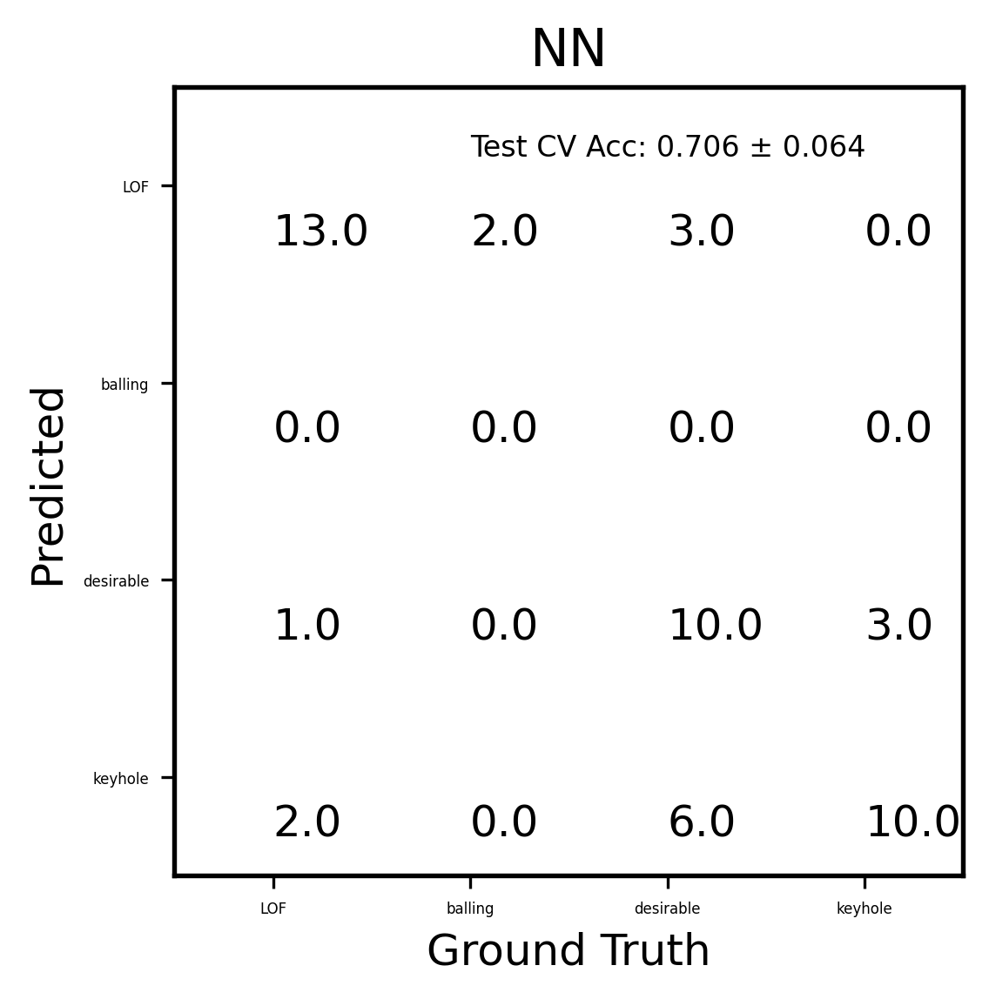

In [50]:
%matplotlib inline
# Define parameters that models will be trained on and value to be predicted
parameter_list = ['Power', 'Velocity', 'density', 'Cp', 'k' , 'beam D', 'melting T', 'layer thickness', 'absorption coefficient',  'absorption coefficient 2']

label_col = 'meltpool shape'


#new_csv = select_subset(new_csv, 'paper ID', 19)
#new_csv = select_material(new_csv, 'Ti6Al4V')

#Form dataset array from dataframe, given parameter_list, label_col
# function select_parameters() does this as well
data_list = []
label_list = []
elem_feature_list = []

new_csv = select_process(class_csv, 'PBF')
test = 0
for i in range(len(new_csv)):
    success, features, label = extract_features(new_csv.iloc[i], parameter_list, label_col)
    if success < 0:
      #  print("CONTINUE")
        continue
    else:
        test += 1
        print(test)
        data_list.append(features)
        label_list.append(label)
        current_elemental_features = featurize_datapoint(new_csv, i)
        elem_feature_list.append(current_elemental_features)
print('length in PBF data: ', len(new_csv))
print('Used data points: ', test)
X= np.array(np.squeeze(data_list))
labels = np.unique(label_list)

# Define labels from csv file
label_id = np.arange(len(labels))
class_labels = np.zeros(len(label_list))
for idx, sample in enumerate(label_list):
    for l_id, lbl in enumerate(labels):
        if lbl == sample:
            class_labels[idx] = l_id
y = np.array(class_labels)
 
class_labels = np.array(class_labels,dtype = 'int')
elemental_features = np.array(elem_feature_list)

fit_models_elem, train_accuracy_elem, train_accuracy_std_elem, test_accuracy_elem, test_accuracy_std_elem = classify_learn(X.reshape(-1, len(X[0])), y, labels, parameters = parameter_list, title = 'PBF, PT_elem', plot = True, prefix = 'classification', elemental_features = elemental_features)

## Sensitivity Analysis - Classification

In [51]:
%matplotlib inline
# Define parameters that models will be trained on and value to be predicted
train_accuracies = []
train_accuracies_std = []
test_accuracies = []
test_accuracies_std = []
total_list = ['Power', 'Velocity', 'density', 'Cp', 'k' , 'beam D', 'melting T', 'layer thickness' , 'absorption coefficient', 'minimal absorptivity']
label_col = 'meltpool shape'

prefix = total_list[0]
parameter_list = [total_list[0]]
# parameter_list.extend(atomic_features)

for parameter in total_list[1:]:
    parameter_list.append(parameter)
    
    prefix += parameter

    proc_list = []
    mat_list =[]
    
#Form dataset array from dataframe, given parameter_list, label_col
# function select_parameters() does this as well


    data_list = []
    label_list = []
    new_csv = select_subset(class_csv, 'Sub-process', 'SLM')

    test = 0
    for i in range(len(new_csv)):
        success, features, label = extract_features(csv.iloc[i], parameter_list, label_col)
        if success < 0:
            continue
        else:
            test += 1

            data_list.append(features)
            label_list.append(label)
            mat_list.append(new_csv.iloc[i]['Material'])
            proc_list.append(new_csv.iloc[i]['Process'])

    X_comp = np.array(np.squeeze(data_list))
    X = X_comp
    labels = np.unique(label_list)
    label_id = np.arange(len(labels))
    class_labels = np.zeros(len(label_list))
    for idx, sample in enumerate(label_list):
        for l_id, lbl in enumerate(labels):
            if lbl == sample:
                class_labels[idx] = l_id
    
    
    
    
    y = np.array(class_labels)


    class_labels = np.array(class_labels,dtype = 'int')
    print(len(class_labels), "LENGTH")
    
    label_id[-1]
    confusion = np.zeros((label_id[-1], label_id[-1]))
    scaler = StandardScaler()
    scaler.fit(X)
    X_rescale = scaler.transform(X)

    fit_models, train_accuracy, train_accuracy_std, test_accuracy, test_accuracy_std = classify_learn(X.reshape(-1, len(X[0])), y, labels, parameters = parameter_list, title = 'LPBF', prefix = prefix)
    train_accuracies.append(train_accuracy)
    train_accuracy_std.append(train_accuracy_std)
    test_accuracies.append(test_accuracy)
    test_accuracies_std.append(test_accuracy_std)
    print(parameter_list)

606 LENGTH
RandomForestClassifier()
RandomForestClassifier()
RandomForestClassifier()
RandomForestClassifier()
RandomForestClassifier()
RF Train Accuracy: 0.86964 ± 0.00659, Test Accuracy: 0.49179 ± 0.03218
GaussianProcessClassifier()
GaussianProcessClassifier()
GaussianProcessClassifier()
GaussianProcessClassifier()
GaussianProcessClassifier()
GPC Train Accuracy: 0.53300 ± 0.01575, Test Accuracy: 0.47857 ± 0.04483
SVC()
SVC()
SVC()
SVC()
SVC()
SVC Train Accuracy: 0.53340 ± 0.02595, Test Accuracy: 0.47028 ± 0.04794
LogisticRegression(C=0.00045)
LogisticRegression(C=0.00045)
LogisticRegression(C=0.00045)
LogisticRegression(C=0.00045)
LogisticRegression(C=0.00045)
Logistic Regression Train Accuracy: 0.34366 ± 0.01765, Test Accuracy: 0.28896 ± 0.06660
GradientBoostingClassifier()
GradientBoostingClassifier()
GradientBoostingClassifier()
GradientBoostingClassifier()
GradientBoostingClassifier()
GB Train Accuracy: 0.80528 ± 0.00687, Test Accuracy: 0.58903 ± 0.05763
MLPClassifier(hidden_laye

In [52]:
total_list = ['Power', 'Velocity', 'density', 'Cp', 'k' , 'beam D', 'melting T', 'layer thickness', 'absorption coefficient', 'minimal absorptivity']
label_col = 'meltpool shape'
prefix = total_list[0]
parameter_list = [total_list[0]]
c = 0
for parameter in total_list[1:]:
    parameter_list.append(parameter)
    prefix += parameter
    print(c, parameter_list) 
    c+=1 

0 ['Power', 'Velocity']
1 ['Power', 'Velocity', 'density']
2 ['Power', 'Velocity', 'density', 'Cp']
3 ['Power', 'Velocity', 'density', 'Cp', 'k']
4 ['Power', 'Velocity', 'density', 'Cp', 'k', 'beam D']
5 ['Power', 'Velocity', 'density', 'Cp', 'k', 'beam D', 'melting T']
6 ['Power', 'Velocity', 'density', 'Cp', 'k', 'beam D', 'melting T', 'layer thickness']
7 ['Power', 'Velocity', 'density', 'Cp', 'k', 'beam D', 'melting T', 'layer thickness', 'absorption coefficient']
8 ['Power', 'Velocity', 'density', 'Cp', 'k', 'beam D', 'melting T', 'layer thickness', 'absorption coefficient', 'minimal absorptivity']


[0.49178973 0.66153846 0.68547009 0.6974359  0.80775917 0.80780657
 0.82020202 0.82857143 0.82142857]
RF


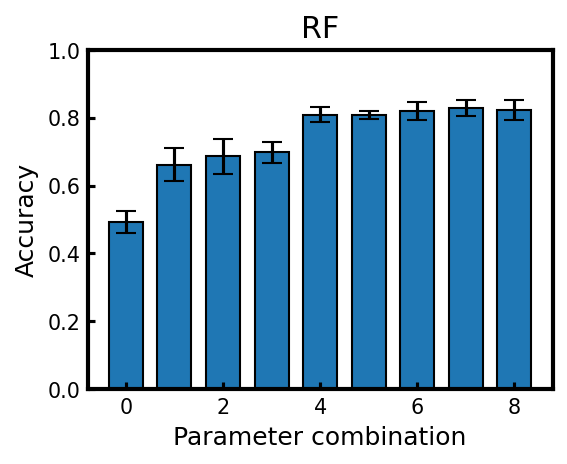

[0.47856659 0.55897436 0.56752137 0.56752137 0.60330278 0.60333439
 0.69292929 0.74285714 0.74642857]
GPC


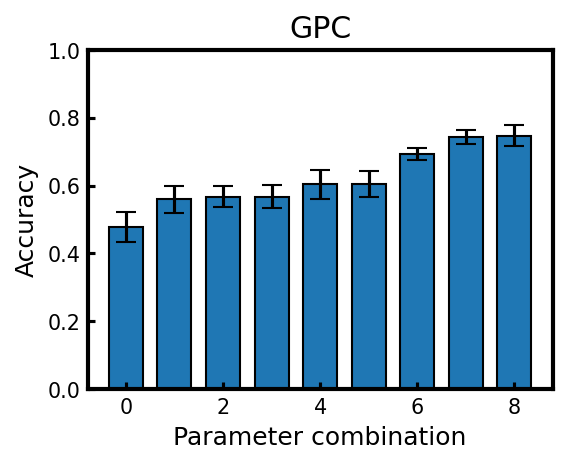

[0.47027503 0.56068376 0.56239316 0.55726496 0.54811947 0.55527813
 0.61414141 0.71785714 0.71785714]
SVC


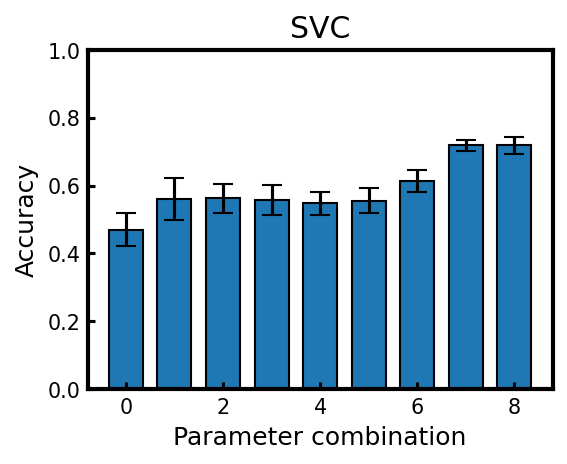

[0.28895814 0.34358974 0.34358974 0.34358974 0.35592604 0.35592604
 0.32323232 0.34285714 0.33928571]
Logistic Regression


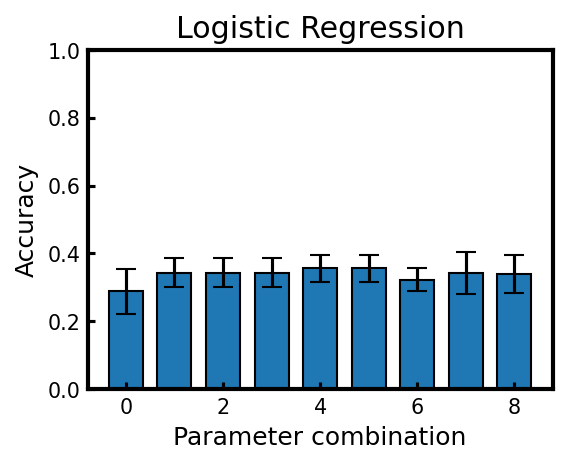

[0.58902588 0.68376068 0.68717949 0.69059829 0.78645702 0.78994943
 0.79191919 0.80714286 0.81428571]
GB


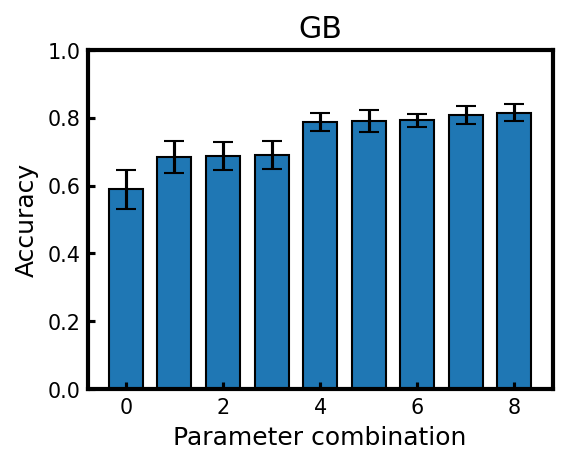

[0.46201057 0.58119658 0.64102564 0.64273504 0.70290771 0.71885272
 0.81616162 0.8        0.80357143]
NN


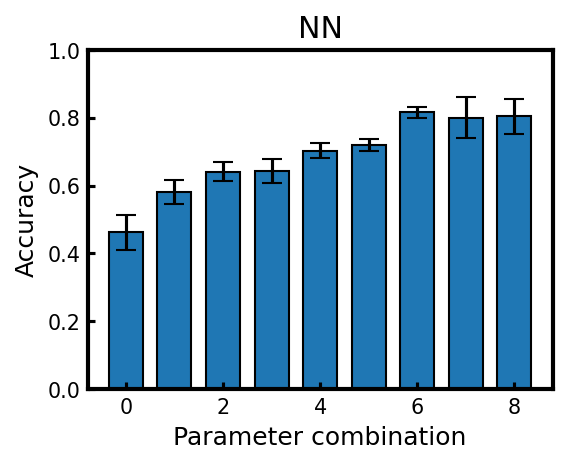

In [53]:
test_accuracies

# the x locations for the groups
width = 0.7         # the width of the bars

c = 0

arr_test = np.array(test_accuracies)
arr_test_std = np.array(test_accuracies_std)
for c in range(len(np.array(test_accuracies[0]))):
    fig = plt.figure(dpi = 150, figsize = [4,3])
    
    testR2 = arr_test[:, c]
    print(testR2)
    errortest = arr_test_std[:,c]
    ind = np.arange(len(arr_test[:,0]))    
    plt.bar(ind, testR2, width, yerr=errortest,  ecolor='black', capsize =5, edgecolor = 'k')
    models = ['RF', 'GPC', 'SVC', 'Logistic Regression', 'GB', 'NN']
    print(models[c])
    plt.title(models[c])
    plt.xlabel("Parameter combination")
    plt.ylabel('Accuracy')
    #c+=1
    plt.ylim(0,1)
    frame_tick()
#    plt.savefig('sensitivity'+ str(c)+".png")
    plt.show()

### Including atomic features and One-Hot Encoding: Classification

514
[ 1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  8
  8  8  8  8  8 19 19 19 19  2  2  2  2  2  2  2  2  2  8  8  8  8  8  8
  8  8  8  8  8  8  8  8  0  0  0  1  1  0  0  0  0  0  0  1  1  1  1  1
  1  1  1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  2  2  0  0  0  0  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1 13 13 13 13 13  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  2
  2  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 10 10 10 10 10
 10  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  0  0  0  0  0  0  0  0  0  0  0  0  1  1  1  1  1  1  1  1  1
  1  1  0  0  0  0  0  0  0  0  0  0  0  0  0  

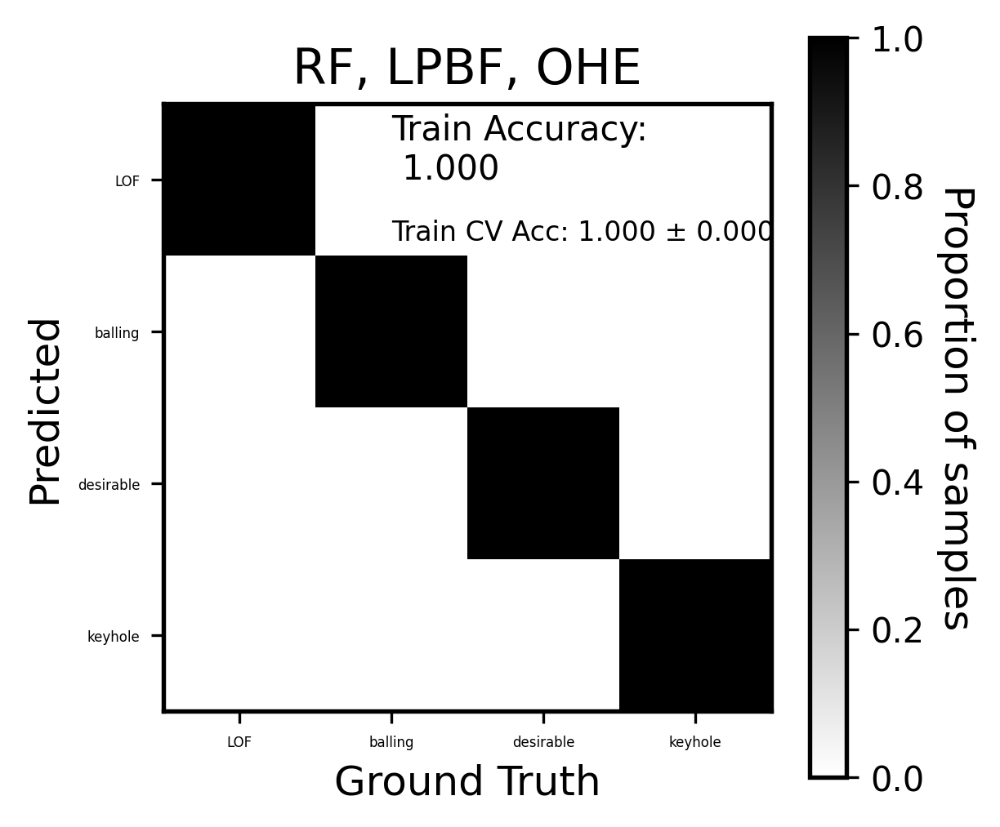

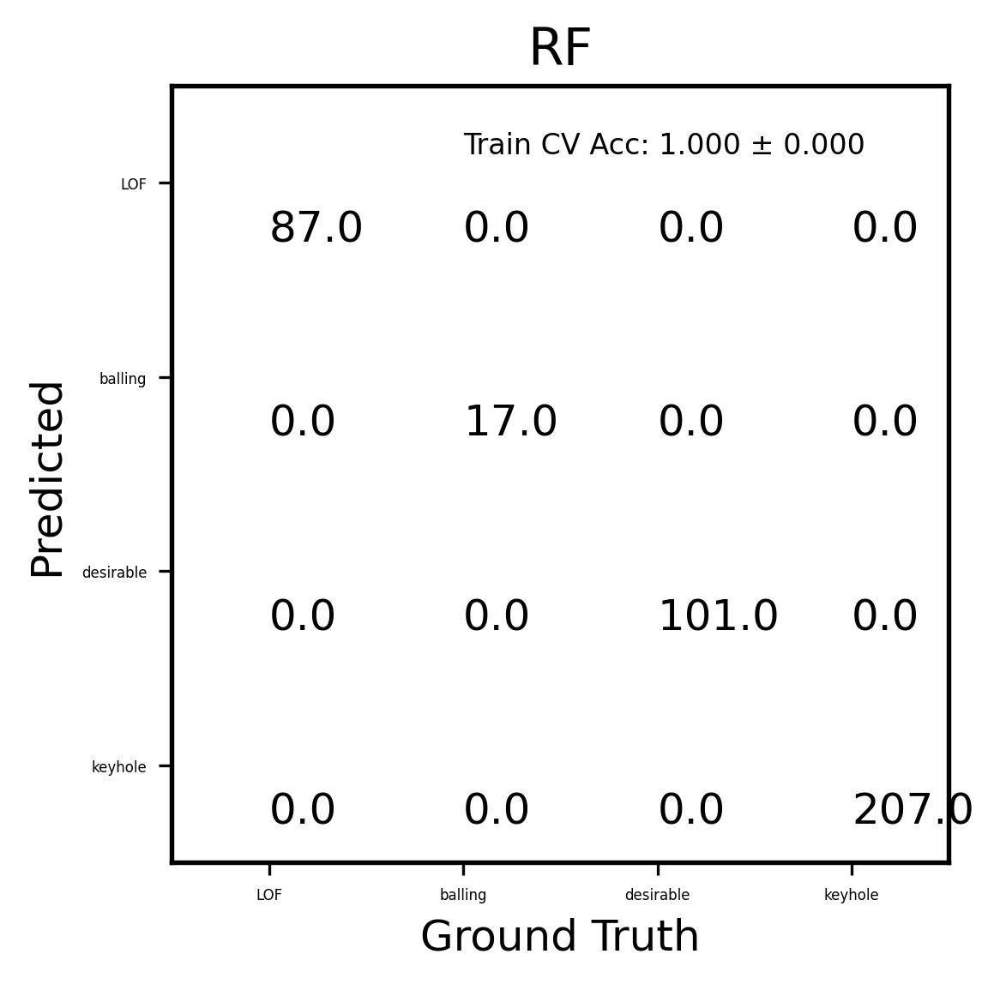

/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:259: RuntimeWarning: invalid value encountered in true_divide


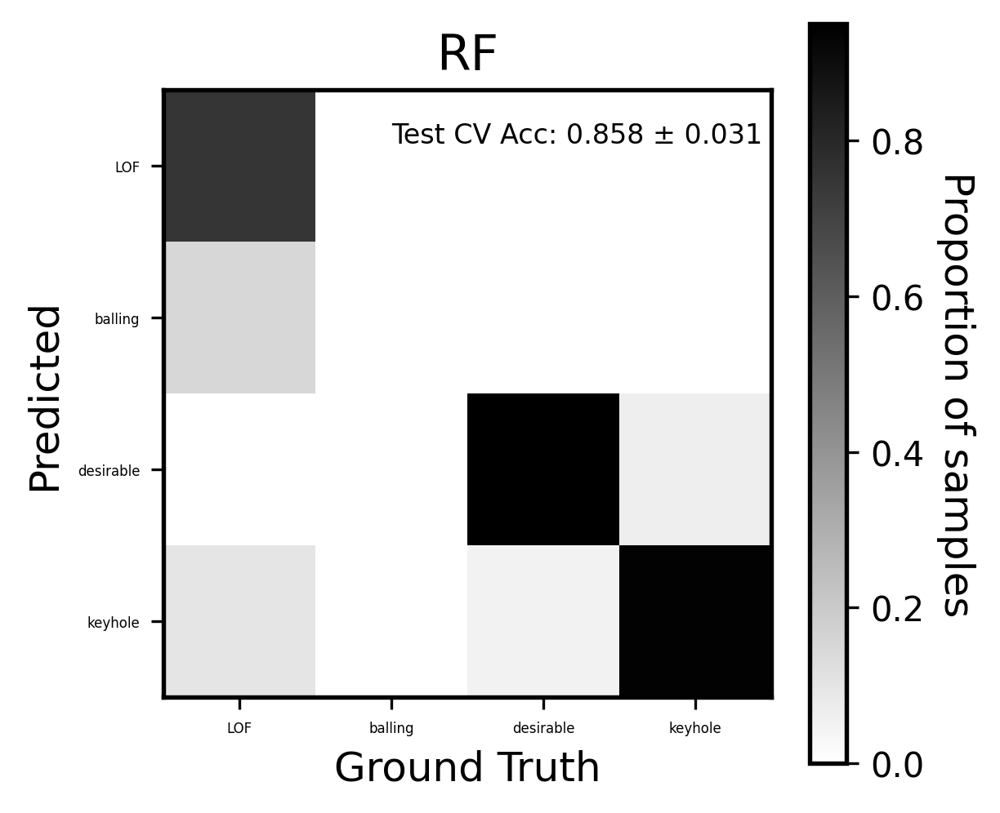

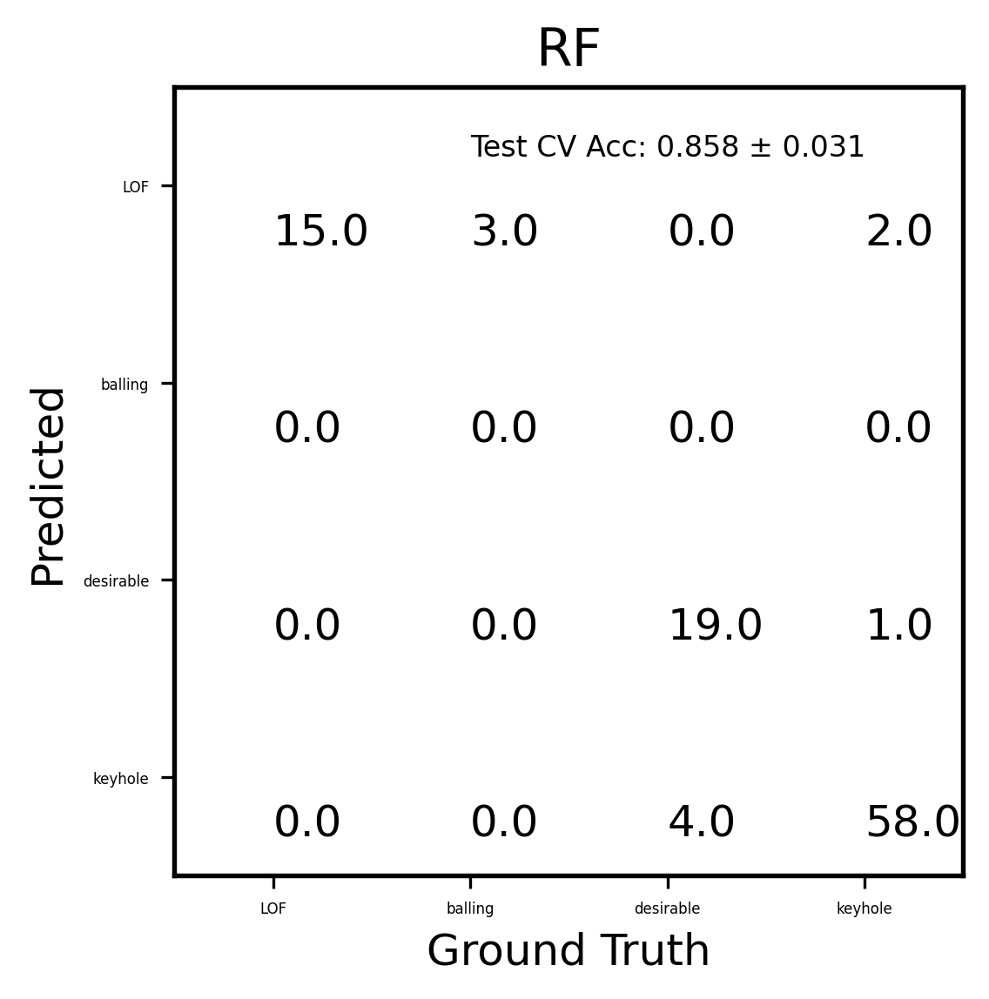

GaussianProcessClassifier()
GaussianProcessClassifier()
GaussianProcessClassifier()
GaussianProcessClassifier()
GaussianProcessClassifier()
GPC Train Accuracy: 0.76849 ± 0.00891, Test Accuracy: 0.69077 ± 0.02810


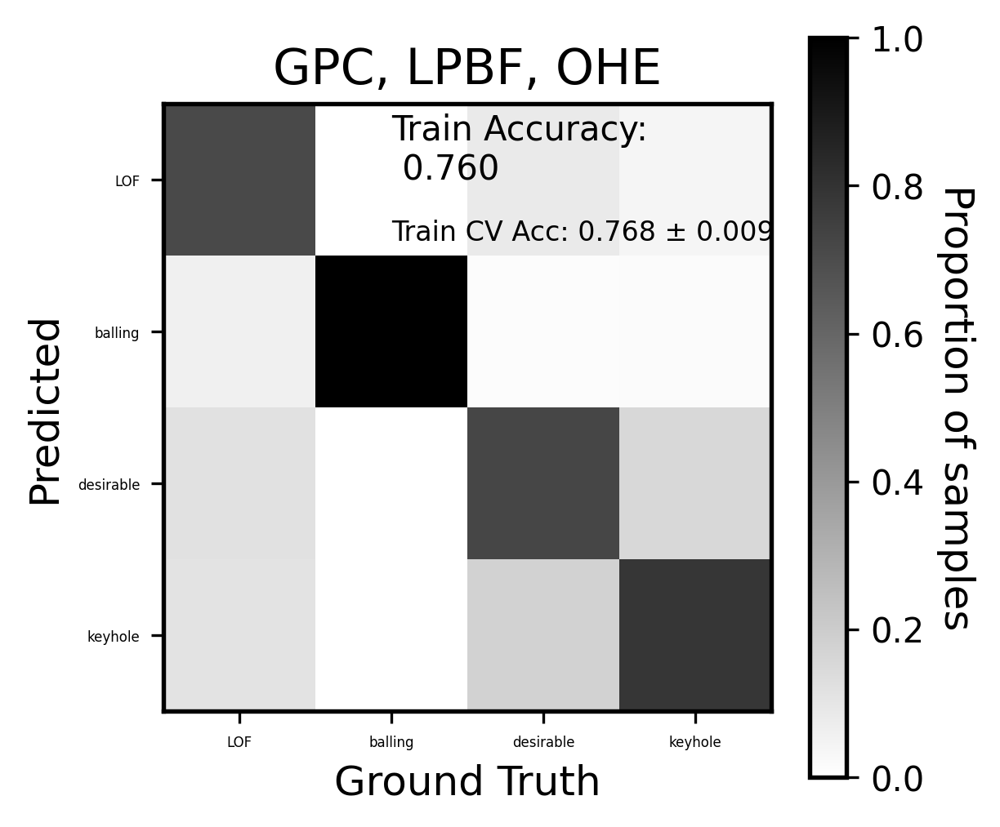

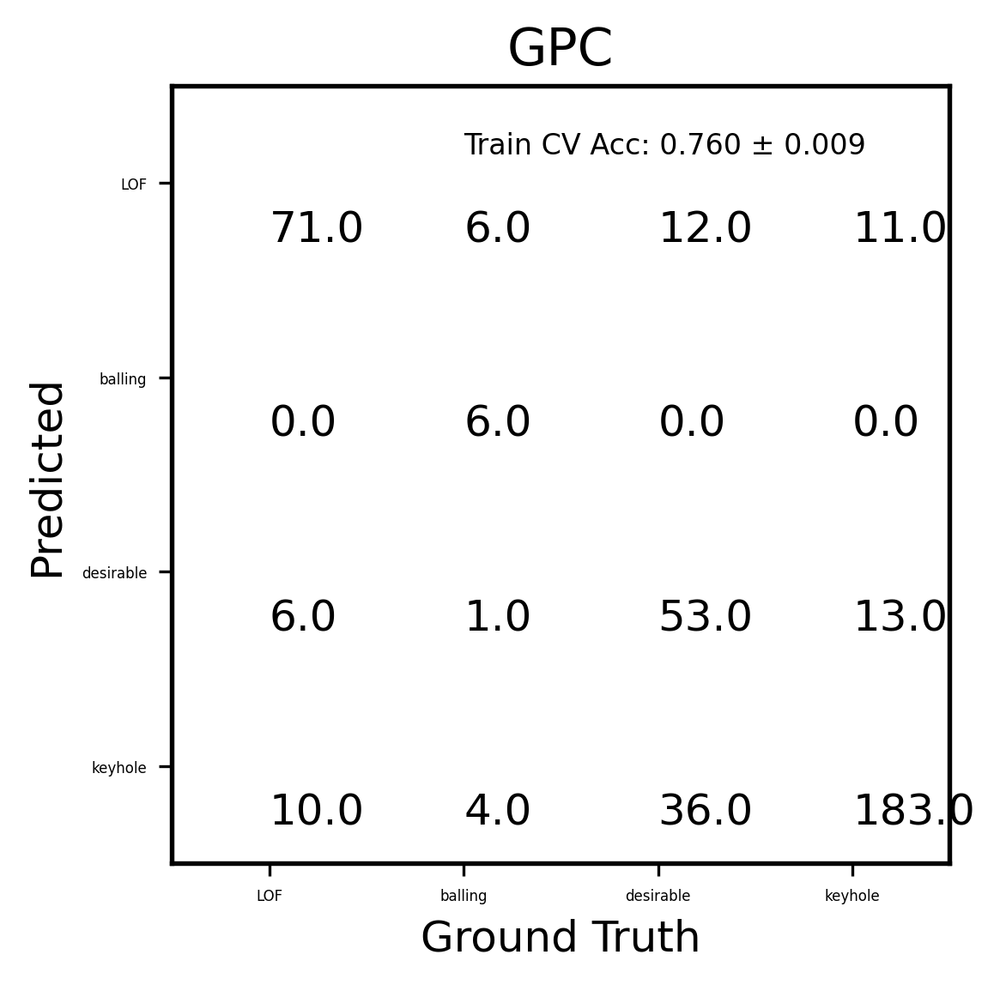

/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:259: RuntimeWarning: invalid value encountered in true_divide


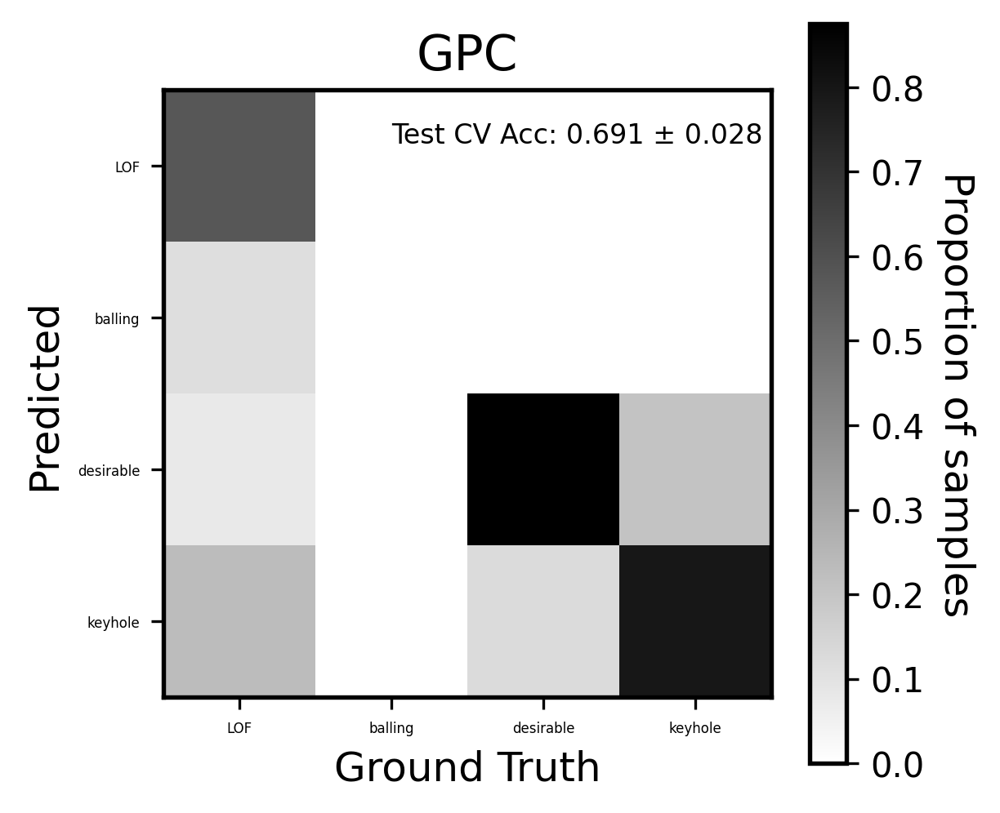

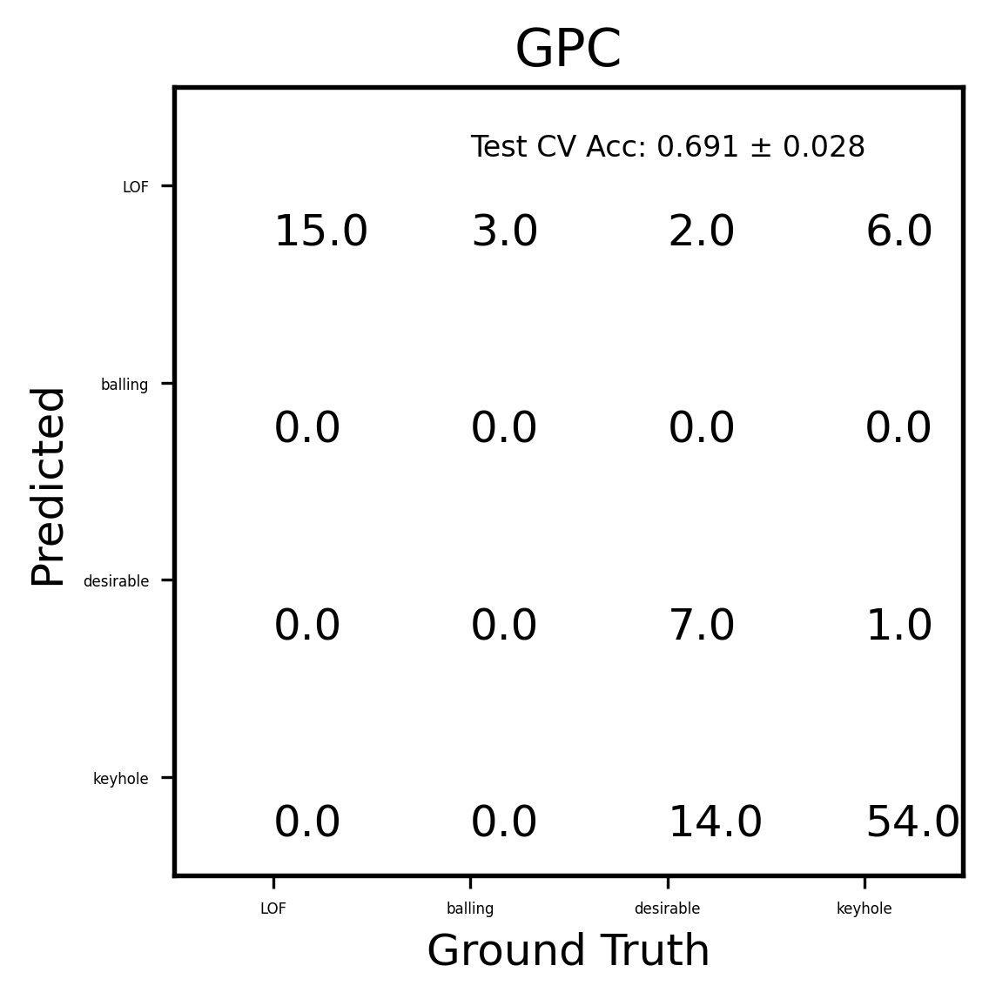

SVC()
SVC()
SVC()
SVC()
SVC()
SVC Train Accuracy: 0.65467 ± 0.00780, Test Accuracy: 0.62463 ± 0.03504


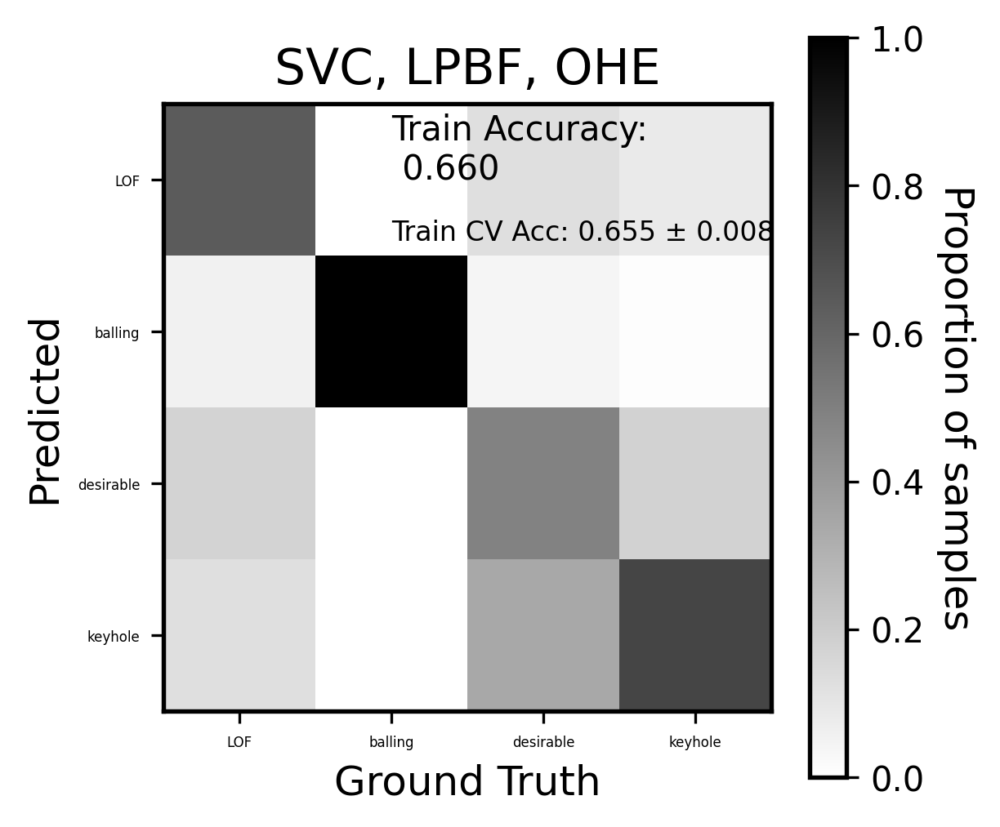

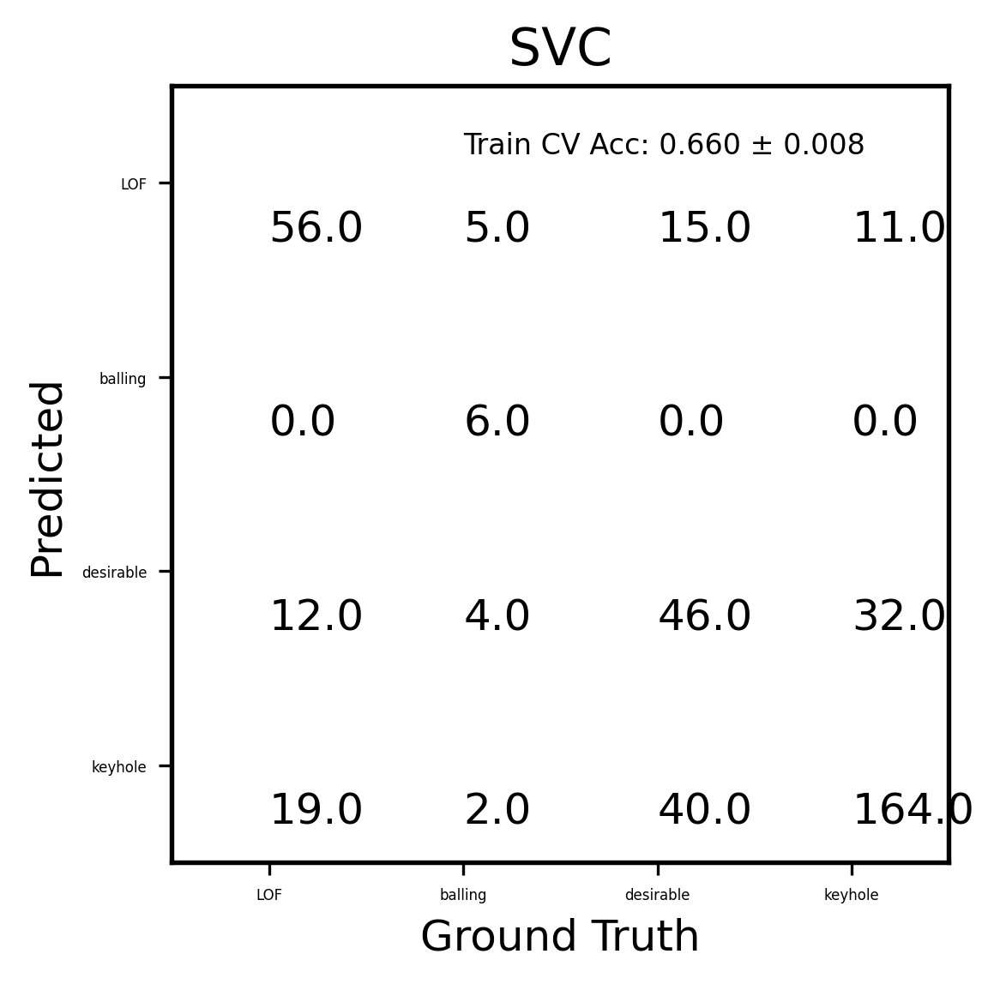

/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:259: RuntimeWarning: invalid value encountered in true_divide


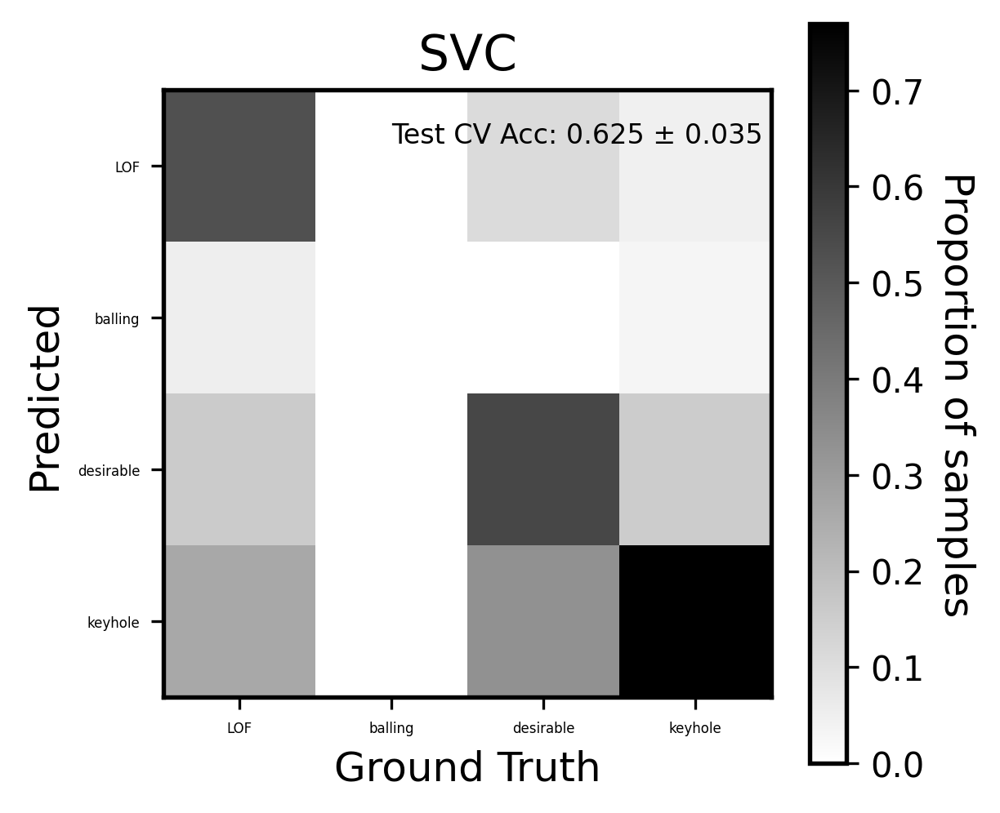

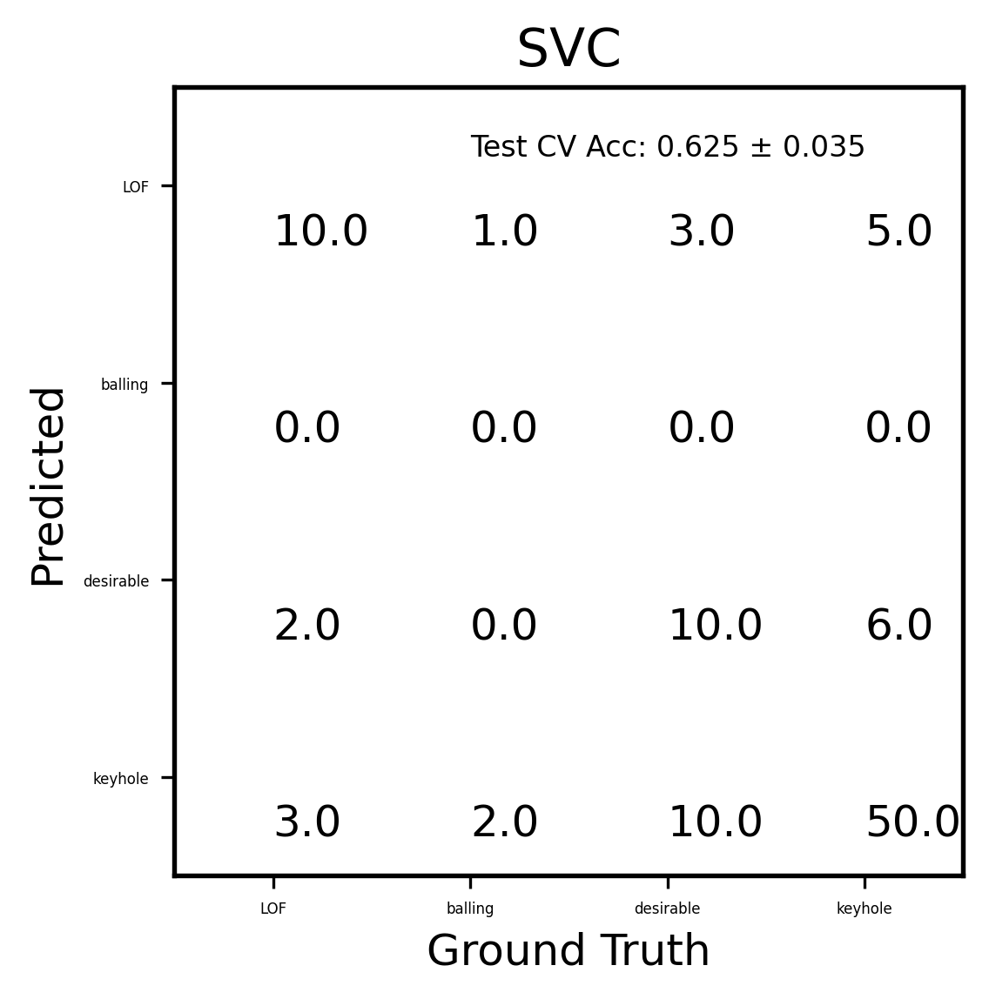

LogisticRegression(C=0.00045)
LogisticRegression(C=0.00045)
LogisticRegression(C=0.00045)
LogisticRegression(C=0.00045)
LogisticRegression(C=0.00045)
Logistic Regression Train Accuracy: 0.52141 ± 0.01146, Test Accuracy: 0.52155 ± 0.04602


/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:181: RuntimeWarning: invalid value encountered in true_divide


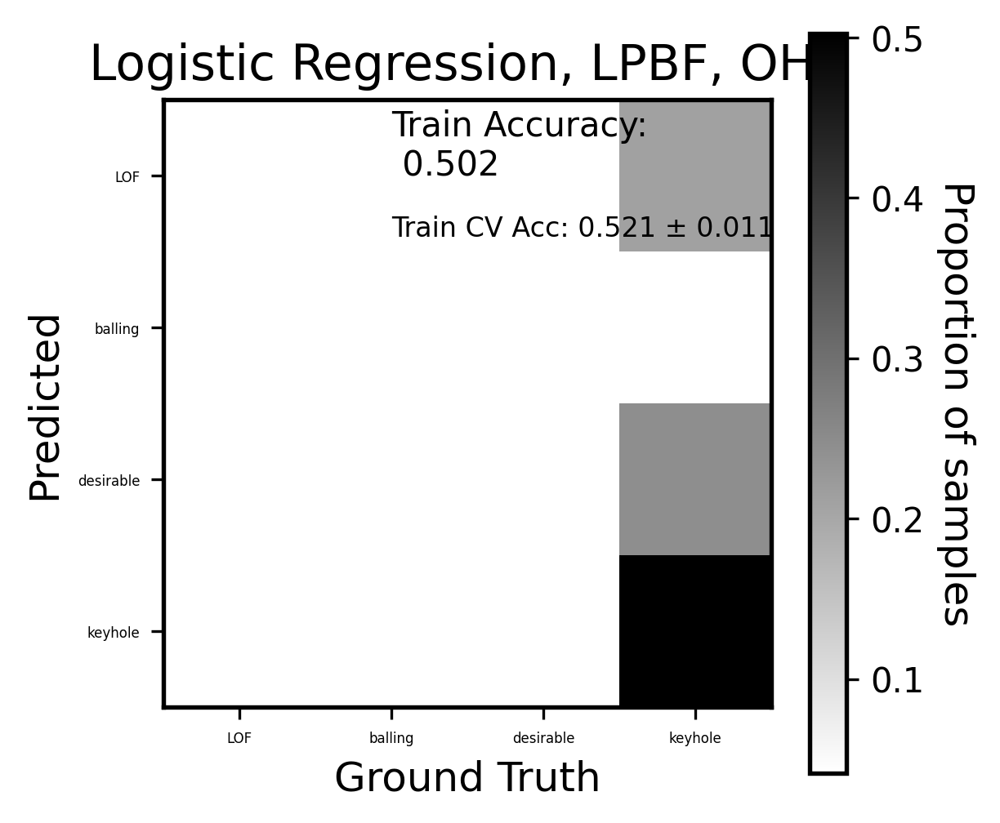

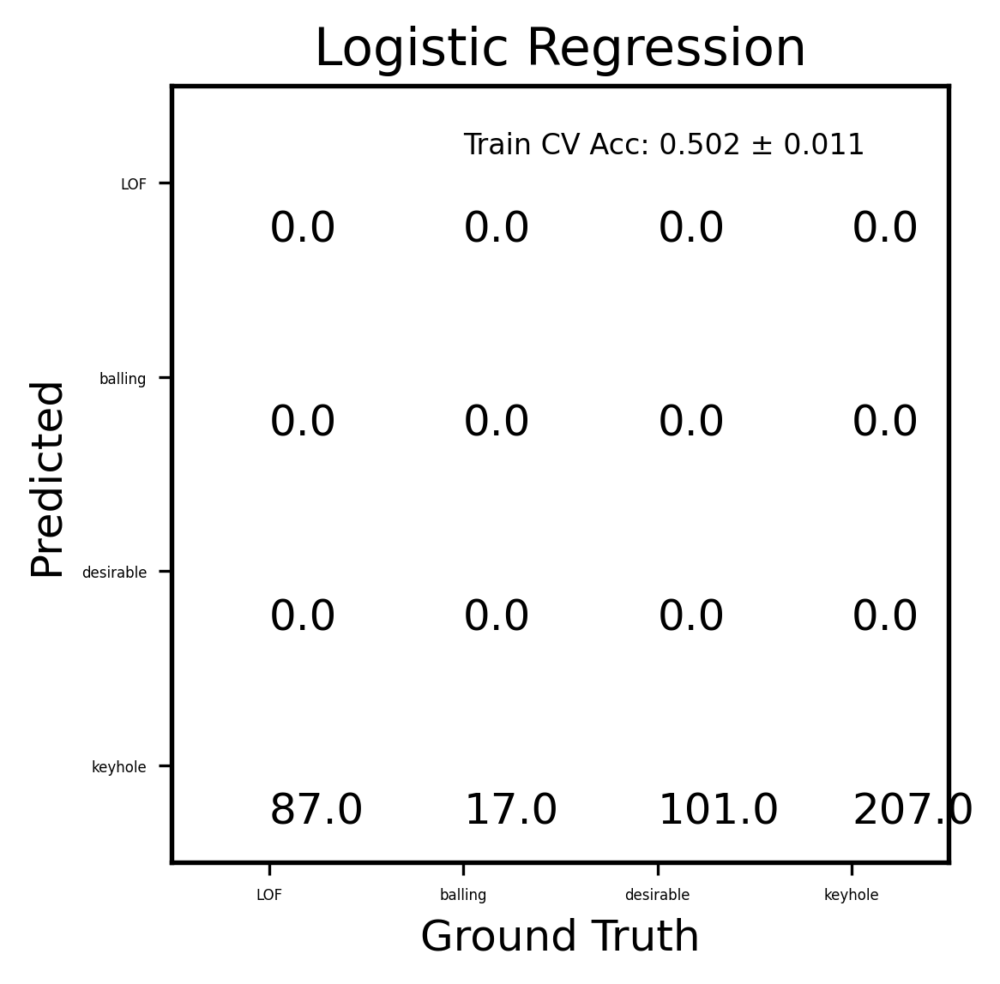

/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:259: RuntimeWarning: invalid value encountered in true_divide


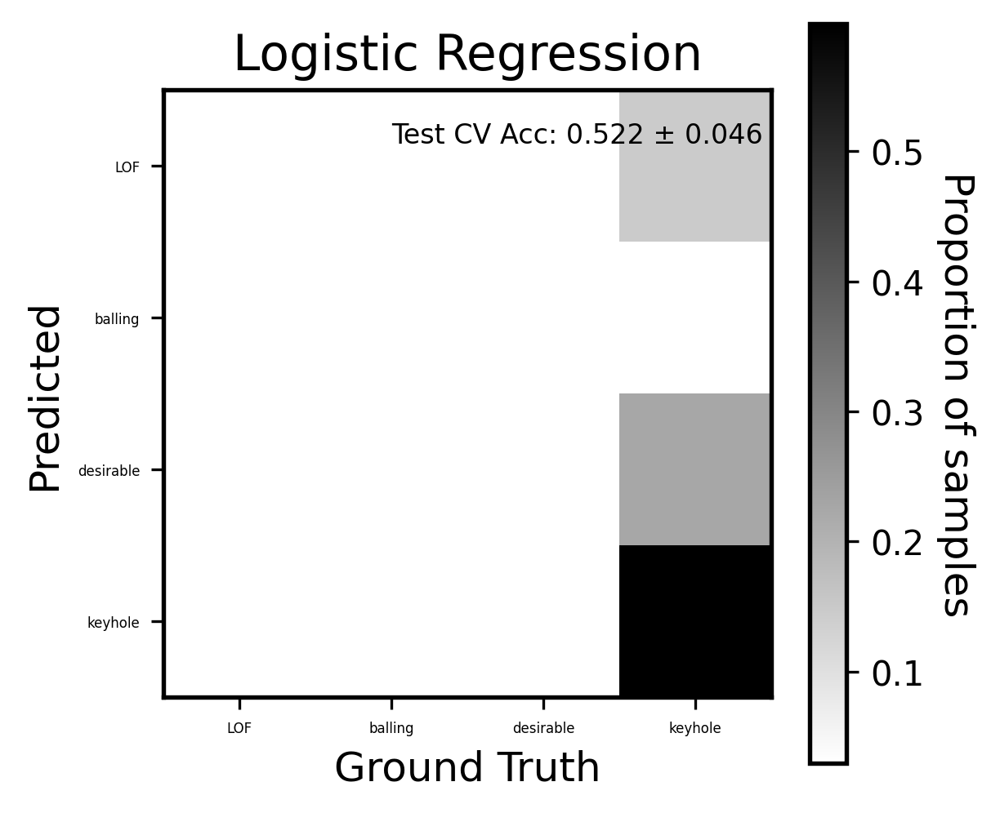

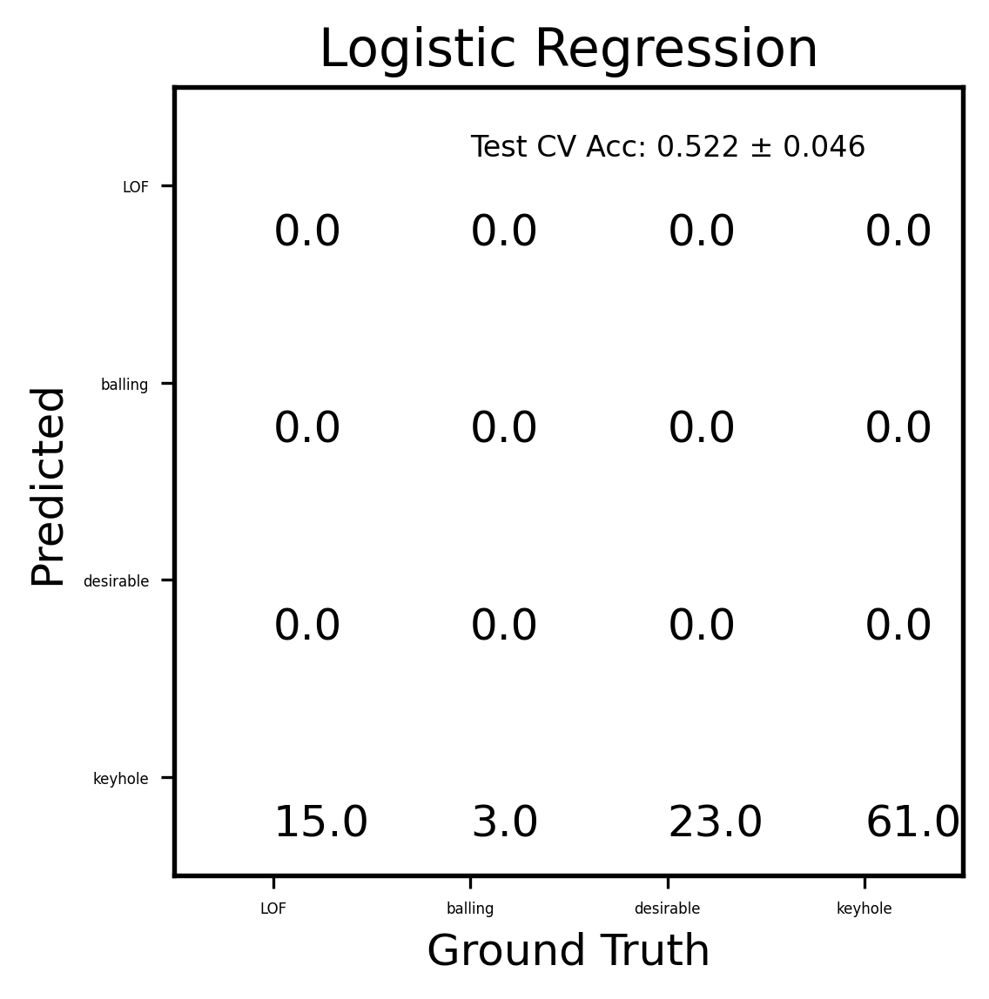

GradientBoostingClassifier()
GradientBoostingClassifier()
GradientBoostingClassifier()
GradientBoostingClassifier()
GradientBoostingClassifier()
GB Train Accuracy: 0.99805 ± 0.00097, Test Accuracy: 0.85606 ± 0.05634


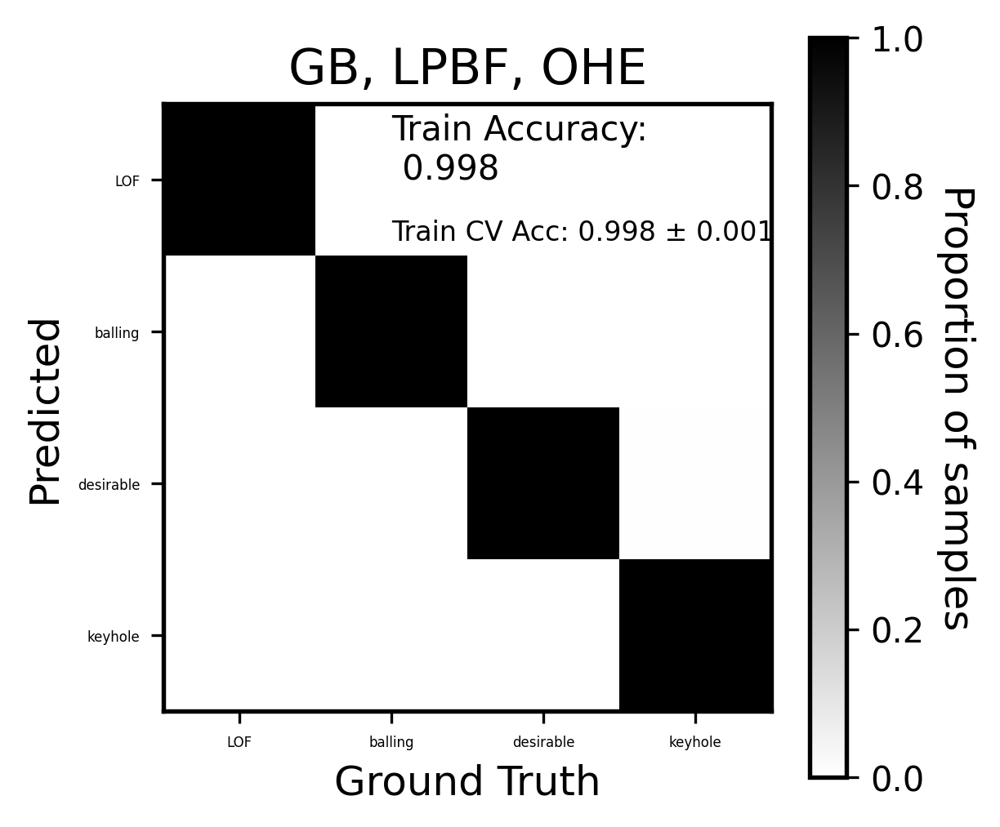

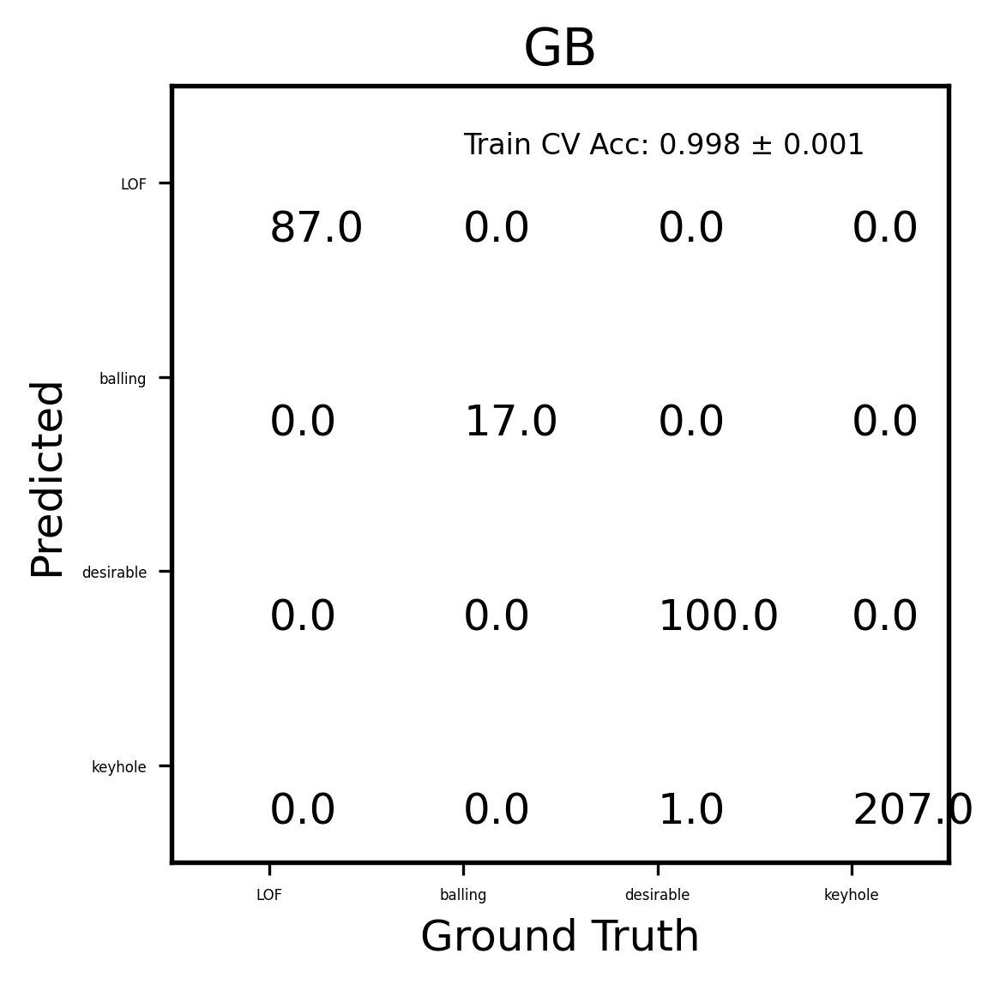

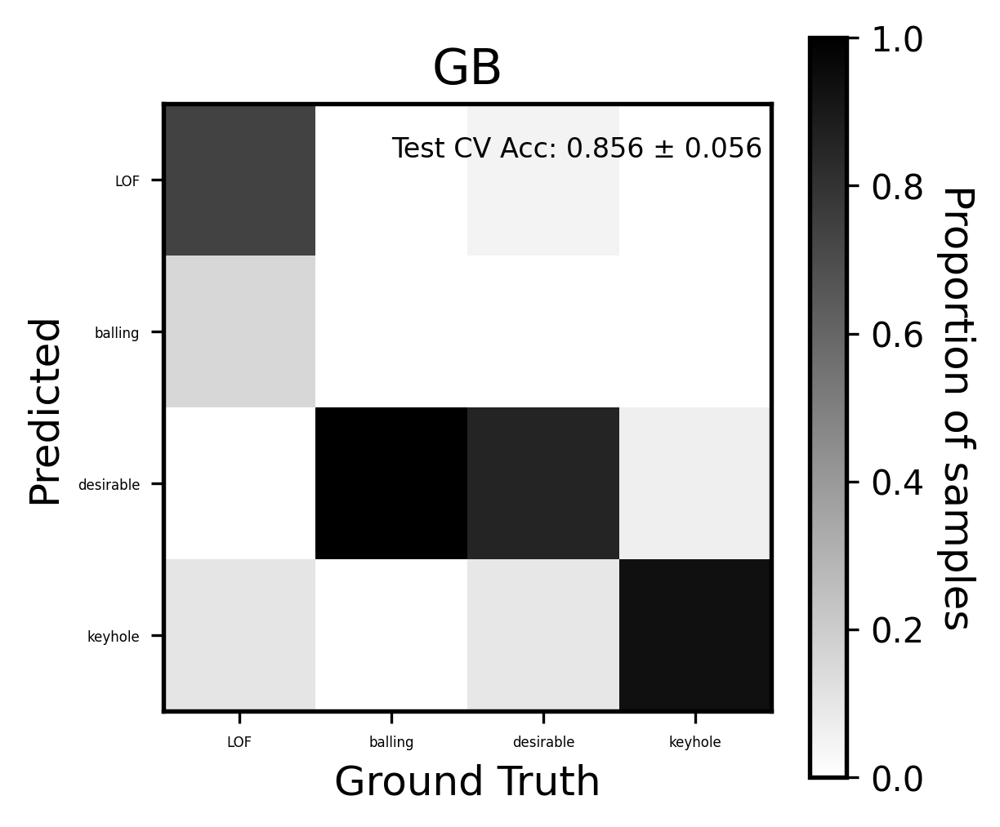

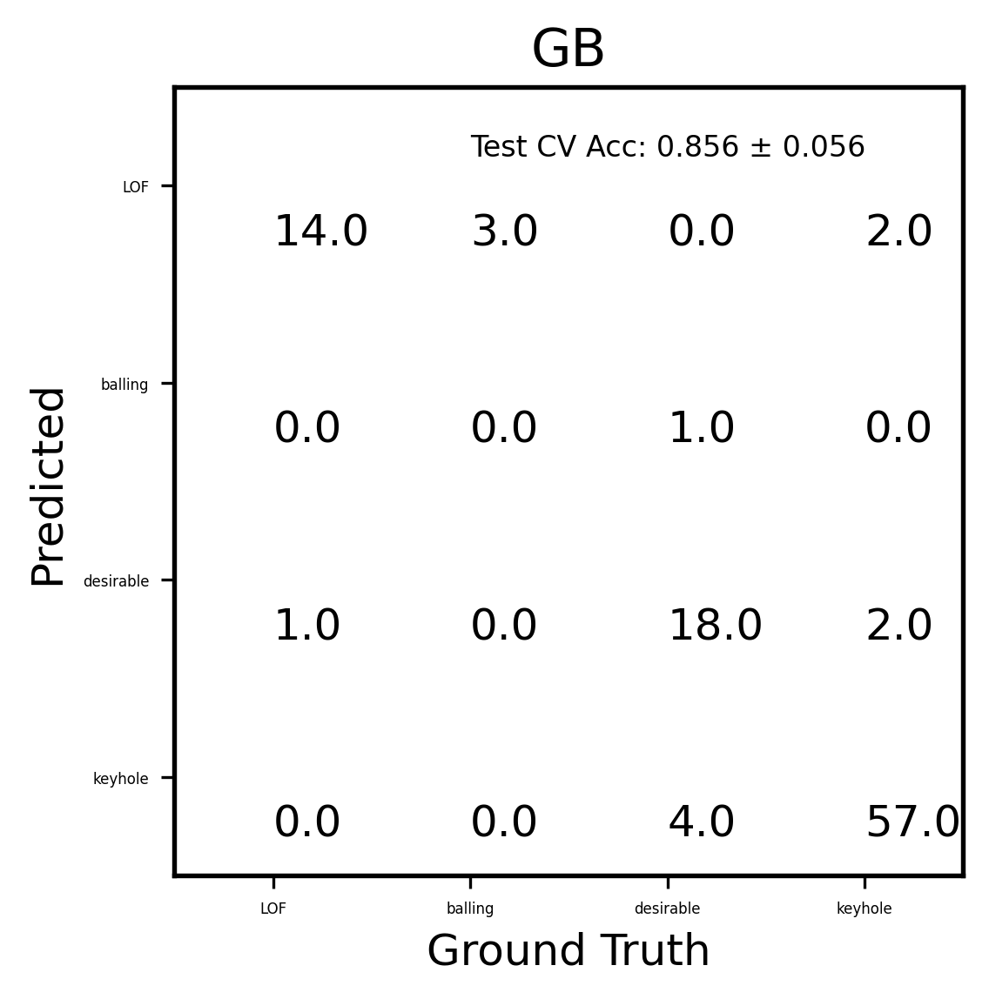

MLPClassifier(hidden_layer_sizes=(32, 64, 64), max_iter=20000)
MLPClassifier(hidden_layer_sizes=(32, 64, 64), max_iter=20000)
MLPClassifier(hidden_layer_sizes=(32, 64, 64), max_iter=20000)
MLPClassifier(hidden_layer_sizes=(32, 64, 64), max_iter=20000)
MLPClassifier(hidden_layer_sizes=(32, 64, 64), max_iter=20000)
NN Train Accuracy: 0.79911 ± 0.05316, Test Accuracy: 0.72570 ± 0.02387


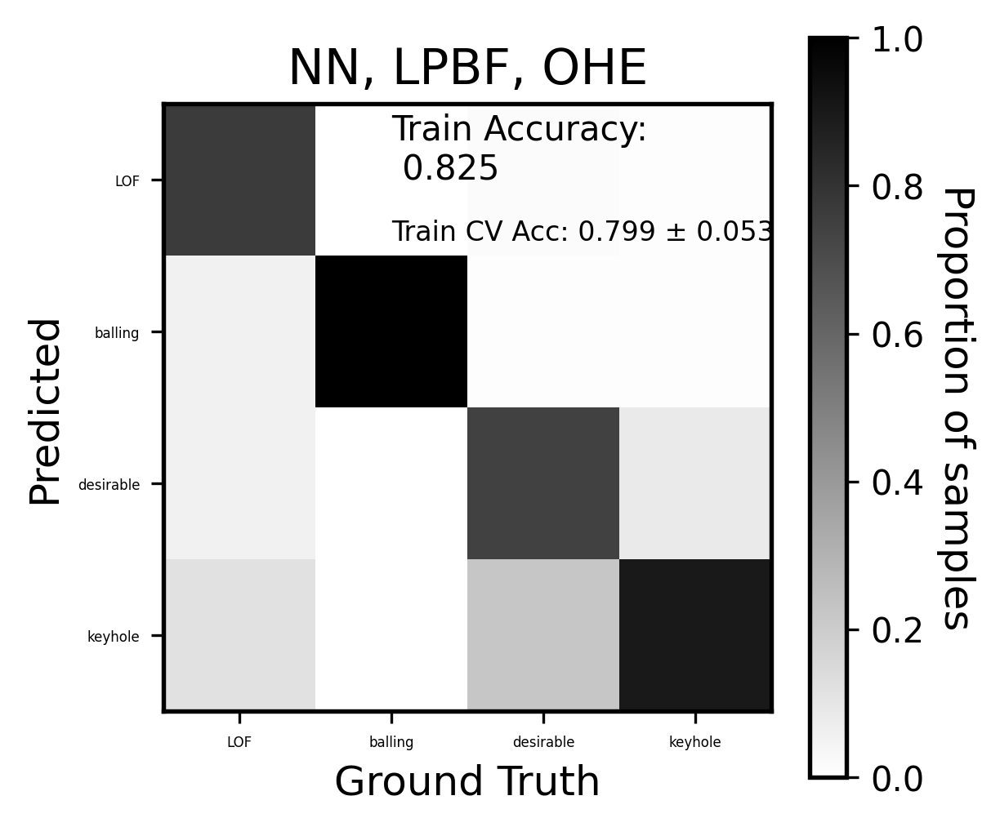

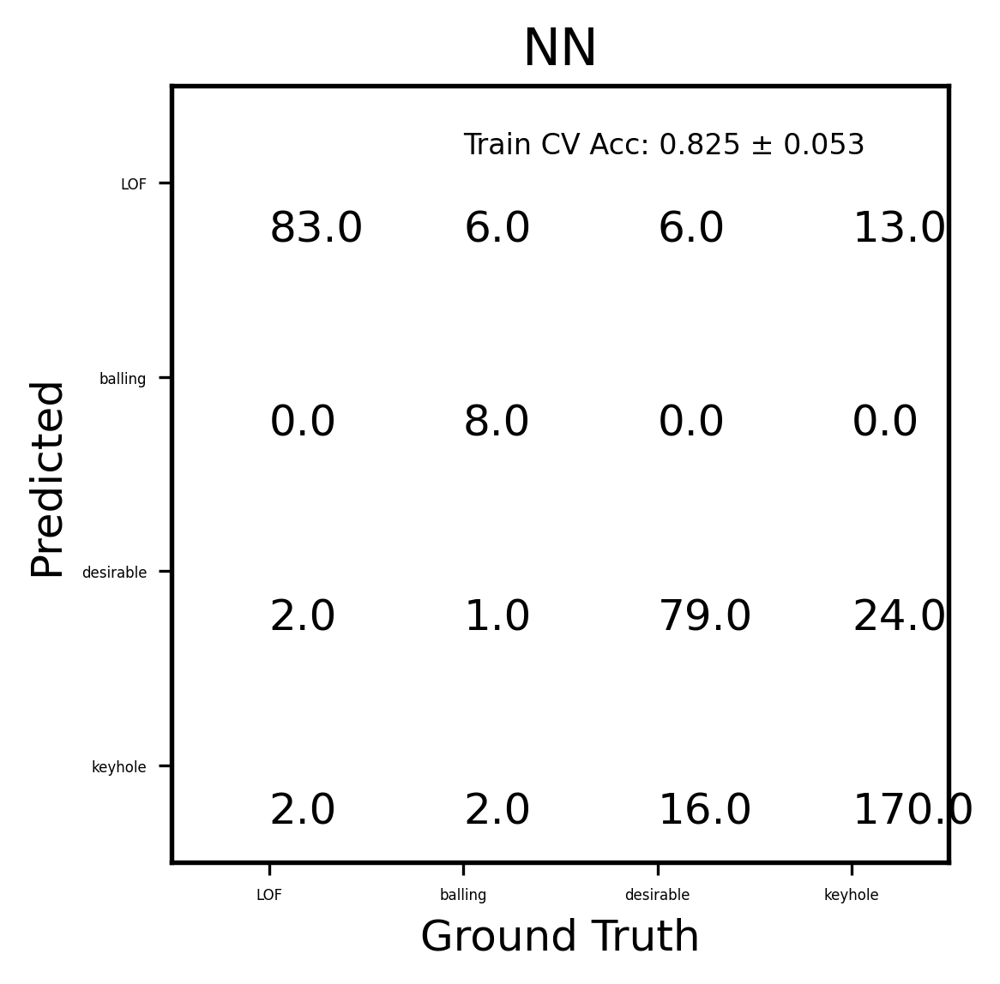

/home/cmu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:259: RuntimeWarning: invalid value encountered in true_divide


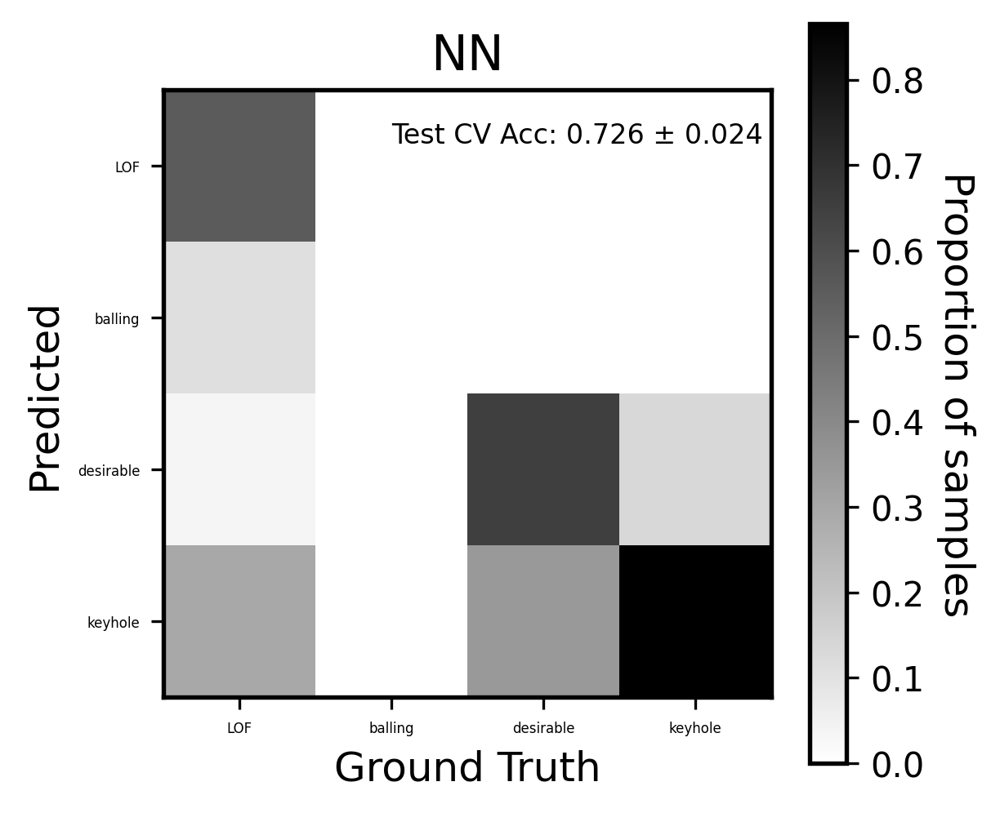

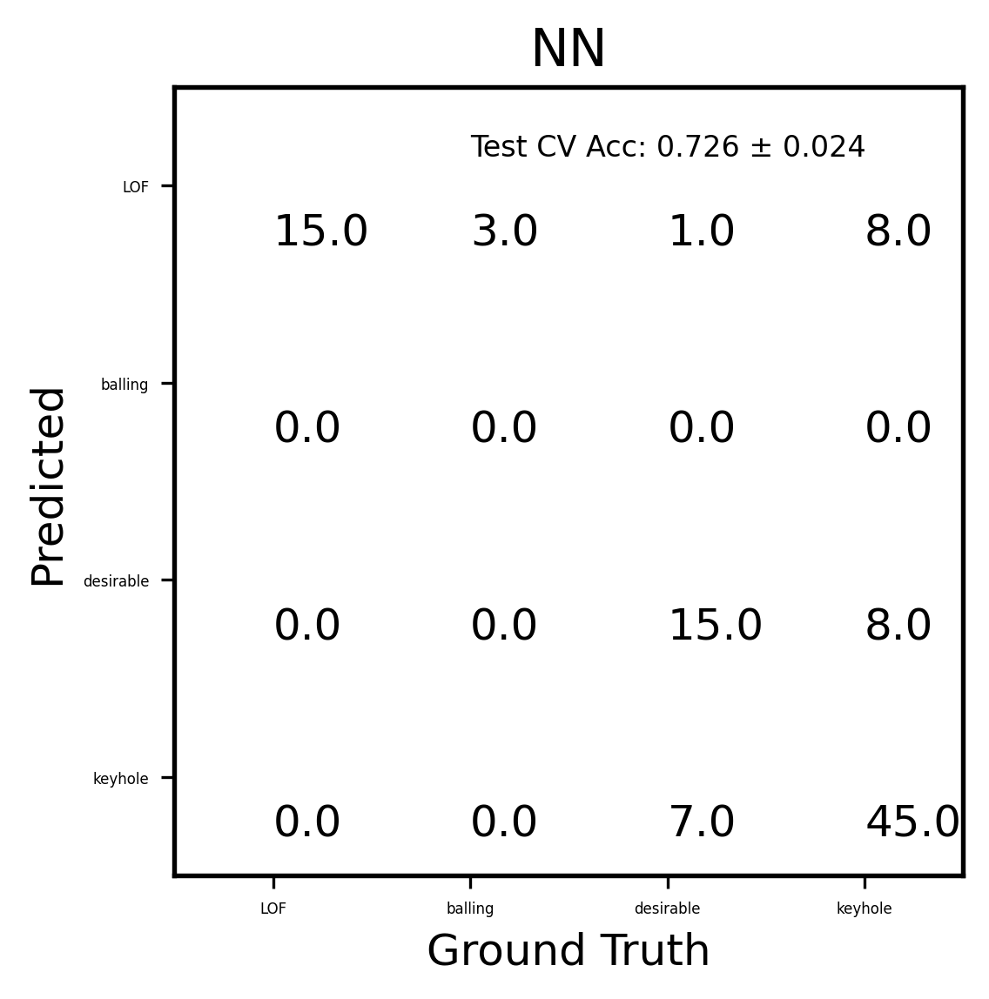

In [54]:

%matplotlib inline
# Define parameters that models will be trained on and value to be predicted
parameter_list = ['Power', 'Velocity', 'density', 'Cp', 'k' , 'beam D', 'melting T', 'absorption coefficient', 'minimal absorptivity']
parameter_list.extend(atomic_features)
label_col = 'meltpool shape'



#Form dataset array from dataframe, given parameter_list, label_col
# function select_parameters() does this as well
data_list = []
label_list = []
materials_present = []

new_csv = select_subset(class_csv, 'Sub-process', 'SLM')
test = 0
for i in range(len(new_csv)):
    success, features, label = extract_features(new_csv.iloc[i], parameter_list, label_col)
    if success < 0:
        continue
    else:
        test += 1
        data_list.append(features)
        label_list.append(label)
        materials_present.append(new_csv['Material'].iloc[i])
        
X= np.array(np.squeeze(data_list))
labels = np.unique(label_list)

# Define labels from csv file
label_id = np.arange(len(labels))
class_labels = np.zeros(len(label_list))
for idx, sample in enumerate(label_list):
    for l_id, lbl in enumerate(labels):
        if lbl == sample:
            class_labels[idx] = l_id
y = np.array(class_labels)

# Define One Hot Encoding of materials
materials_ohe = [np.zeros(len(materials_present)) for key in materials.keys()]
len(materials_ohe)
materials_ohe = np.array(materials_ohe).T




print(len(materials_ohe))
material_pos = np.arange(len(materials.keys()))
for idx in range(len(materials_present)):
    for j_idx in range(len(material_pos)):
      #  breakpoint()
        if materials_present[idx] == materials.keys()[j_idx]:
            
            materials_ohe[idx,j_idx] = 1 

print(np.argmax(materials_ohe, axis = 1))
 
class_labels = np.array(class_labels,dtype = 'int')


fit_models_ohe, train_accuracy_ohe, train_accuracy_std_ohe, test_accuracy_ohe, test_accuracy_std_ohe = classify_learn(X.reshape(-1, len(X[0])), y, labels, parameters = parameter_list, title = 'LPBF, OHE', plot = True, prefix = 'classification')

 



